In [ ]:
import pandas as pd

# Load the provided Excel file
file_path = '/content/Book5.xlsx'
excel_data = pd.read_excel(file_path)

# Display the first few rows of the data to understand its structure
excel_data.head()


,Timestamp,Sirifort_PM2.5,IHBAS_PM2.5,Sonia_Vihar_PM2.5,mandir_marg_PM2.5,Avg_PM2.5,Avg_PM10 (µg/m³),Avg_NO2 (µg/m³),Avg_AT (°C),Avg_VWS (m/s),Avg_O Xylene (µg/m³),Avg_SO2 (µg/m³),Avg_Eth-Benzene (µg/m³),Avg_CO (mg/m³),Avg_RH (%),Avg_Xylene (µg/m³),Avg_WD (deg),Avg_Toluene (µg/m³)
0,2017-01-01 00:00:00,272.83,115.87,NaN,227.83,205.510000,302.83,68.926667,12.890,0.35,NaN,14.080,NaN,3.88,92.500000,NaN,133.416667,12.82
1,2017-01-01 01:00:00,233.47,115.15,NaN,224.17,190.930000,255.00,56.870000,12.230,0.39,NaN,11.300,NaN,2.92,92.836667,NaN,105.013333,11.83
2,2017-01-01 02:00:00,206.17,116.53,NaN,200.50,174.400000,240.00,52.853333,12.065,0.37,NaN,7.050,NaN,1.08,93.656667,NaN,109.826667,8.95
3,2017-01-01 03:00:00,195.85,114.00,NaN,154.83,154.893333,211.67,44.416667,10.980,0.40,NaN,8.040,NaN,0.98,93.010000,NaN,129.800000,7.94
4,2017-01-01 04:00:00,186.70,113.70,NaN,164.00,154.800000,205.67,35.743333,10.170,0.39,NaN,10.925,NaN,1.42,93.703333,NaN,182.590000,7.98


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load data files
sirifort_df = pd.read_csv('/content/_Sirifort_Delhi 17-23.csv')
ihbas_df = pd.read_csv('/content/_IHBAS_Dilshad_Garden_Delhi_2017-23.csv')
sonia_vihar_df = pd.read_csv('/content/SONIA_VIHAR_DELHI.csv')
mandir_marg_df = pd.read_csv('/content/DATA_2017-2023_DATA_1.csv', encoding='latin1')

# Extract PM2.5 data and merge by Timestamp
sirifort_pm25 = sirifort_df[['Timestamp', 'PM2.5 (µg/m³)']].rename(columns={'PM2.5 (µg/m³)': 'Sirifort_PM2.5'})
ihbas_pm25 = ihbas_df[['Timestamp', 'PM2.5 (µg/m³)']].rename(columns={'PM2.5 (µg/m³)': 'IHBAS_PM2.5'})
sonia_vihar_pm25 = sonia_vihar_df[['Timestamp', 'PM2.5 (µg/m³)']].rename(columns={'PM2.5 (µg/m³)': 'Sonia_Vihar_PM2.5'})
mandir_marg_pm25 = mandir_marg_df[['Timestamp', 'PM2.5 (µg/m³)']].rename(columns={'PM2.5 (µg/m³)': 'Mandir_Marg_PM2.5'})

# Merge all data on 'Timestamp' to align rows by date and time
merged_df = sirifort_pm25.merge(ihbas_pm25, on='Timestamp', how='outer') \
                         .merge(sonia_vihar_pm25, on='Timestamp', how='outer') \
                         .merge(mandir_marg_pm25, on='Timestamp', how='outer')

# Calculate the average PM2.5 for each row, ignoring NaNs in the calculations
merged_df['Avg_PM2.5'] = merged_df[['Sirifort_PM2.5', 'IHBAS_PM2.5', 'Sonia_Vihar_PM2.5', 'Mandir_Marg_PM2.5']].mean(axis=1)

# Where all values are NaN, set the 'Avg_PM2.5' as 'NA'
merged_df['Avg_PM2.5'] = merged_df['Avg_PM2.5'].where(merged_df[['Sirifort_PM2.5', 'IHBAS_PM2.5', 'Sonia_Vihar_PM2.5', 'Mandir_Marg_PM2.5']].notna().any(axis=1), 'NA')

# Descriptive statistics excluding min and max
desc_stats = merged_df[['Sirifort_PM2.5', 'IHBAS_PM2.5', 'Sonia_Vihar_PM2.5', 'Mandir_Marg_PM2.5', 'Avg_PM2.5']].describe().drop(['min', 'max'])

# Plot descriptive statistics as a heatmap
plt.figure(figsize=(10, 4))
sns.heatmap(desc_stats, annot=True, fmt=".2f", cmap="coolwarm", cbar=True)
plt.title('Descriptive Statistics of PM2.5 Levels')
plt.tight_layout()

# Show the plot
plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/content/_Sirifort_Delhi 17-23.csv'

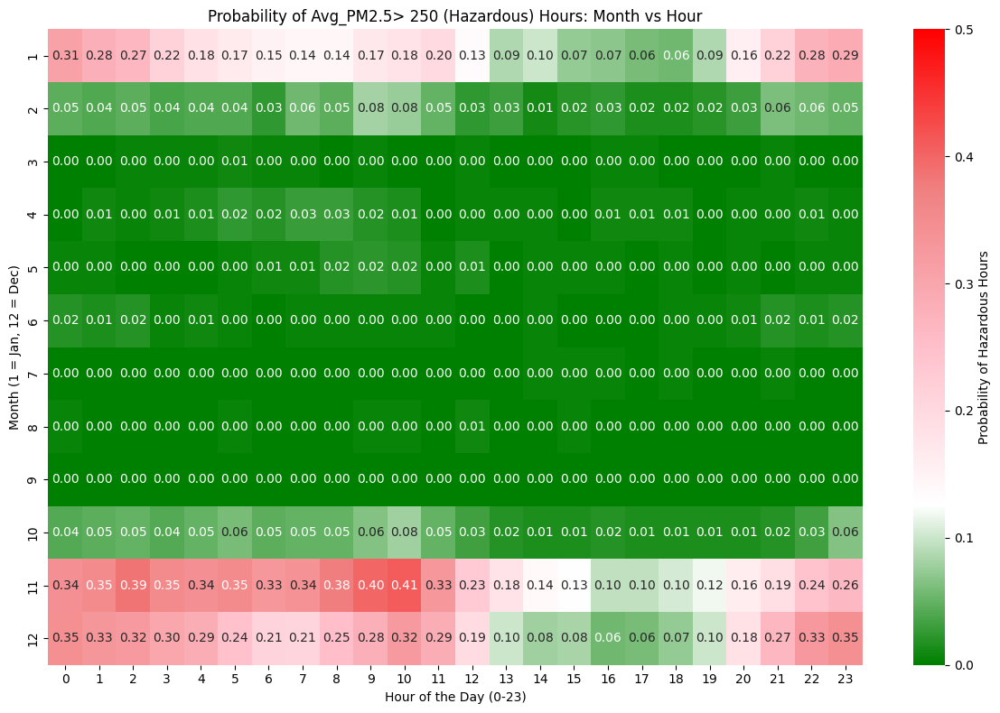

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Month,,,,,,,,,,,,,,,,,,,,,
1,0.308756,0.281106,0.267281,0.216590,0.184332,0.165899,0.152074,0.142857,0.142857,0.170507,...,0.101382,0.073733,0.069124,0.059908,0.055300,0.087558,0.156682,0.216590,0.276498,0.290323
2,0.045685,0.040609,0.045685,0.035533,0.040609,0.040609,0.025381,0.055838,0.045685,0.081218,...,0.010152,0.020305,0.025381,0.015228,0.015228,0.020305,0.030457,0.060914,0.055838,0.050761
3,0.000000,0.000000,0.004608,0.004608,0.004608,0.009217,0.004608,0.004608,0.000000,0.004608,...,0.000000,0.000000,0.004608,0.004608,0.000000,0.000000,0.000000,0.004608,0.000000,0.000000
4,0.000000,0.009524,0.004762,0.009524,0.014286,0.023810,0.019048,0.028571,0.028571,0.019048,...,0.004762,0.000000,0.009524,0.009524,0.009524,0.000000,0.004762,0.004762,0.009524,0.004762
5,0.004608,0.004608,0.000000,0.000000,0.000000,0.004608,0.009217,0.009217,0.018433,0.023041,...,0.004608,0.004608,0.004608,0.000000,0.004608,0.000000,0.004608,0.000000,0.004608,0.004608
6,0.019048,0.014286,0.019048,0.004762,0.009524,0.004762,0.000000,0.004762,0.004762,0.004762,...,0.004762,0.000000,0.000000,0.000000,0.004762,0.004762,0.009524,0.019048,0.014286,0.019048
7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.004608,0.004608,0.004608,0.000000,0.004608,0.000000,0.000000,0.004608,0.000000,0.000000
8,0.004608,0.000000,0.000000,0.000000,0.000000,0.004608,0.000000,0.000000,0.000000,0.004608,...,0.000000,0.004608,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [ ]:

import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap

# Load the dataset
# Load the dataset from an Excel file
file_path = '/content/Book5.xlsx'
df1 = pd.read_excel(file_path)


# Convert 'Timestamp' to datetime format for proper handling
df1['Timestamp'] = pd.to_datetime(df1['Timestamp'], format='%d-%m-%Y %H:%M', errors='coerce')


# Extract year, month, day, and hour from the 'Timestamp' column
df1['Year'] = df1['Timestamp'].dt.year
df1['Month'] = df1['Timestamp'].dt.month
df1['Day'] = df1['Timestamp'].dt.day
df1['Hour'] = df1['Timestamp'].dt.hour

# Calculate total hours for each month-hour combination
total_hours = df1.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Filter the data where PM2.5 concentration is greater than 250 (hazardous levels)
pm25_hazardous_250 = df1[df1['Avg_PM2.5'] > 250]

# Calculate the number of hazardous hours for each month-hour combination
hazardous_hours_250 = pm25_hazardous_250.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of hazardous hours by dividing hazardous hours by total hours
hazardous_probability_250 = hazardous_hours_250 / total_hours

# Fill in any NaN values (which represent missing data) with zeros
hazardous_probability_250 = hazardous_probability_250.fillna(0)

# Create a custom colormap that transitions from green, to white, to pink, and then to red
colors = [(0, "green"), (0.25, "white"), (0.5, "pink"), (0.75, "lightcoral"), (1, "red")]
custom_cmap = LinearSegmentedColormap.from_list("custom_coolwarm", colors)

# Plot the heatmap for the probability of PM2.5 > 250 (hazardous levels)
plt.figure(figsize=(12, 8))
sns.heatmap(hazardous_probability_250, cmap=custom_cmap, annot=True, fmt='.2f', cbar_kws={'label': 'Probability of Hazardous Hours'}, vmin=0, vmax=0.5)
plt.title('Probability of Avg_PM2.5> 250 (Hazardous) Hours: Month vs Hour')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month (1 = Jan, 12 = Dec)')
plt.tight_layout()
plt.show()

# Output the data used for the heatmap for verification
hazardous_probability_250


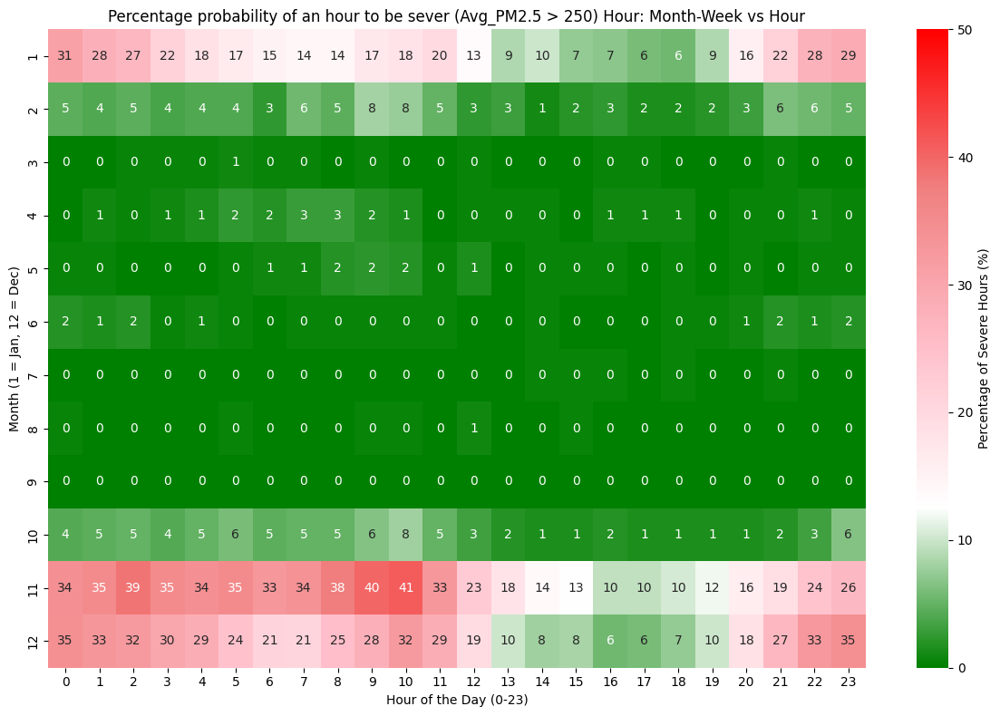

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Month,,,,,,,,,,,,,,,,,,,,,
1,30.875576,28.110599,26.728111,21.658986,18.433180,16.589862,15.207373,14.285714,14.285714,17.050691,...,10.138249,7.373272,6.912442,5.990783,5.529954,8.755760,15.668203,21.658986,27.649770,29.032258
2,4.568528,4.060914,4.568528,3.553299,4.060914,4.060914,2.538071,5.583756,4.568528,8.121827,...,1.015228,2.030457,2.538071,1.522843,1.522843,2.030457,3.045685,6.091371,5.583756,5.076142
3,0.000000,0.000000,0.460829,0.460829,0.460829,0.921659,0.460829,0.460829,0.000000,0.460829,...,0.000000,0.000000,0.460829,0.460829,0.000000,0.000000,0.000000,0.460829,0.000000,0.000000
4,0.000000,0.952381,0.476190,0.952381,1.428571,2.380952,1.904762,2.857143,2.857143,1.904762,...,0.476190,0.000000,0.952381,0.952381,0.952381,0.000000,0.476190,0.476190,0.952381,0.476190
5,0.460829,0.460829,0.000000,0.000000,0.000000,0.460829,0.921659,0.921659,1.843318,2.304147,...,0.460829,0.460829,0.460829,0.000000,0.460829,0.000000,0.460829,0.000000,0.460829,0.460829
6,1.904762,1.428571,1.904762,0.476190,0.952381,0.476190,0.000000,0.476190,0.476190,0.476190,...,0.476190,0.000000,0.000000,0.000000,0.476190,0.476190,0.952381,1.904762,1.428571,1.904762
7,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.460829,0.460829,0.460829,0.000000,0.460829,0.000000,0.000000,0.460829,0.000000,0.000000
8,0.460829,0.000000,0.000000,0.000000,0.000000,0.460829,0.000000,0.000000,0.000000,0.460829,...,0.000000,0.460829,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap

# Load the dataset from an Excel file
file_path = '/content/Book5.xlsx'
df1 = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime format for proper handling
df1['Timestamp'] = pd.to_datetime(df1['Timestamp'], format='%d-%m-%Y %H:%M', errors='coerce')

# Extract year, month, day, and hour from the 'Timestamp' column
df1['Year'] = df1['Timestamp'].dt.year
df1['Month'] = df1['Timestamp'].dt.month
df1['Day'] = df1['Timestamp'].dt.day
df1['Hour'] = df1['Timestamp'].dt.hour

# Calculate total hours for each month-hour combination
total_hours = df1.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Filter the data where PM2.5 concentration is greater than 250 (hazardous levels)
pm25_hazardous_250 = df1[df1['Avg_PM2.5'] > 250]

# Calculate the number of hazardous hours for each month-hour combination
hazardous_hours_250 = pm25_hazardous_250.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of hazardous hours by dividing hazardous hours by total hours
hazardous_probability_250 = hazardous_hours_250 / total_hours

# Fill in any NaN values (which represent missing data) with zeros
hazardous_probability_250 = hazardous_probability_250.fillna(0)

# Convert the probability to percentage
hazardous_probability_250_percentage = hazardous_probability_250 * 100

# Create a custom colormap that transitions from green, to white, to pink, and then to red
colors = [(0, "green"), (0.25, "white"), (0.5, "pink"), (0.75, "lightcoral"), (1, "red")]
custom_cmap = LinearSegmentedColormap.from_list("custom_coolwarm", colors)

# Plot the heatmap for the probability of PM2.5 > 250 (hazardous levels) in percentage as whole numbers
plt.figure(figsize=(12, 8))
sns.heatmap(hazardous_probability_250_percentage, cmap=custom_cmap, annot=True, fmt='.0f', cbar_kws={'label': 'Percentage of Severe Hours (%)'}, vmin=0, vmax=50)
plt.title('Percentage probability of an hour to be sever (Avg_PM2.5 > 250) Hour: Month-Week vs Hour')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month (1 = Jan, 12 = Dec)')
plt.tight_layout()
plt.show()

# Output the percentage data for verification
hazardous_probability_250_percentage


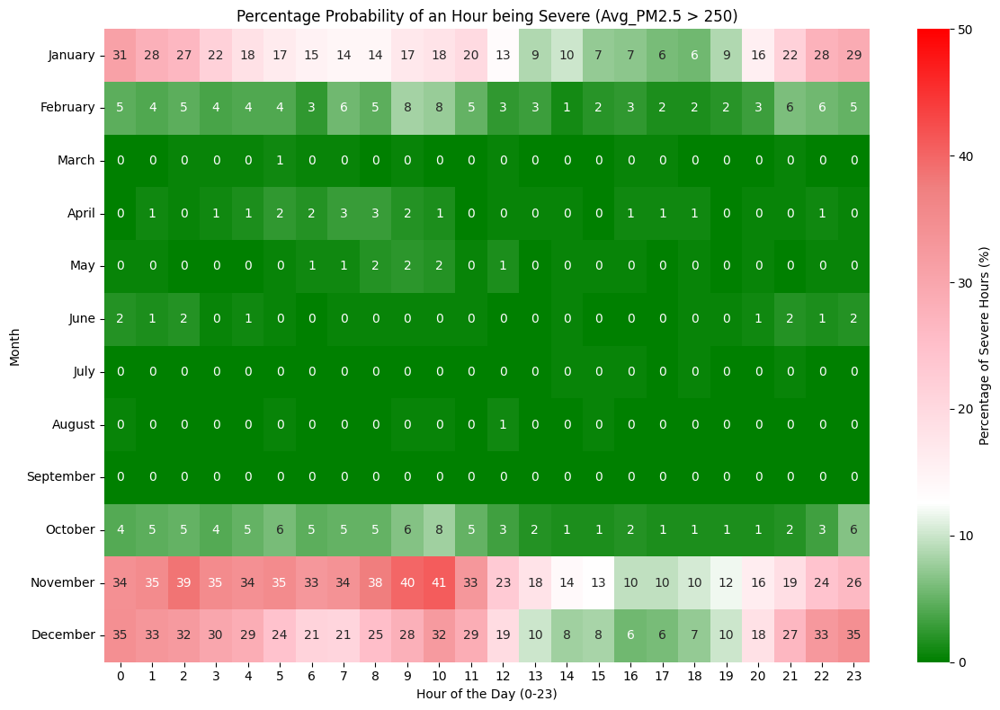

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap
import calendar

# Load the dataset from an Excel file
file_path = '/content/Book5.xlsx'
df1 = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime format for proper handling
df1['Timestamp'] = pd.to_datetime(df1['Timestamp'], format='%d-%m-%Y %H:%M', errors='coerce')

# Extract year, month, day, and hour from the 'Timestamp' column
df1['Year'] = df1['Timestamp'].dt.year
df1['Month'] = df1['Timestamp'].dt.month
df1['Day'] = df1['Timestamp'].dt.day
df1['Hour'] = df1['Timestamp'].dt.hour

# Calculate total hours for each month-hour combination
total_hours = df1.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Filter the data where PM2.5 concentration is greater than 250 (hazardous levels)
pm25_hazardous_250 = df1[df1['Avg_PM2.5'] > 250]

# Calculate the number of hazardous hours for each month-hour combination
hazardous_hours_250 = pm25_hazardous_250.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of hazardous hours by dividing hazardous hours by total hours
hazardous_probability_250 = hazardous_hours_250 / total_hours

# Fill in any NaN values (which represent missing data) with zeros
hazardous_probability_250 = hazardous_probability_250.fillna(0)

# Convert the probability to percentage
hazardous_probability_250_percentage = hazardous_probability_250 * 100

# Replace the numeric month index with month names
hazardous_probability_250_percentage.index = hazardous_probability_250_percentage.index.map(lambda x: calendar.month_name[x])

# Create a custom colormap that transitions from green, to white, to pink, and then to red
colors = [(0, "green"), (0.25, "white"), (0.5, "pink"), (0.75, "lightcoral"), (1, "red")]
custom_cmap = LinearSegmentedColormap.from_list("custom_coolwarm", colors)

# Plot the heatmap for the probability of PM2.5 > 250 (hazardous levels) in percentage as whole numbers
plt.figure(figsize=(12, 8))
sns.heatmap(hazardous_probability_250_percentage, cmap=custom_cmap, annot=True, fmt='.0f', cbar_kws={'label': 'Percentage of Severe Hours (%)'}, vmin=0, vmax=50)
plt.title('Percentage Probability of an Hour being Severe (Avg_PM2.5 > 250)')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month')
plt.tight_layout()
plt.show()


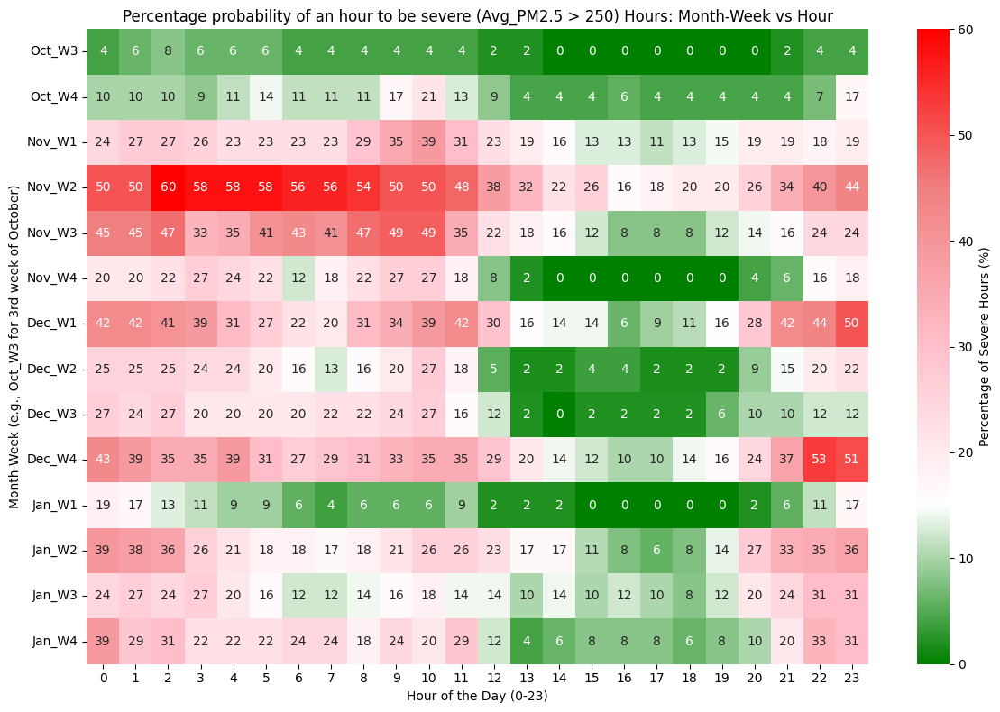

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Month-Week,,,,,,,,,,,,,,,,,,,,,
Oct_W3,4.081633,6.122449,8.163265,6.122449,6.122449,6.122449,4.081633,4.081633,4.081633,4.081633,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.040816,4.081633,4.081633
Oct_W4,10.000000,10.000000,10.000000,8.571429,11.428571,14.285714,11.428571,11.428571,11.428571,17.142857,...,4.285714,4.285714,5.714286,4.285714,4.285714,4.285714,4.285714,4.285714,7.142857,17.142857
Nov_W1,24.193548,27.419355,27.419355,25.806452,22.580645,22.580645,22.580645,22.580645,29.032258,35.483871,...,16.129032,12.903226,12.903226,11.290323,12.903226,14.516129,19.354839,19.354839,17.741935,19.354839
Nov_W2,50.000000,50.000000,60.000000,58.000000,58.000000,58.000000,56.000000,56.000000,54.000000,50.000000,...,22.000000,26.000000,16.000000,18.000000,20.000000,20.000000,26.000000,34.000000,40.000000,44.000000
Nov_W3,44.897959,44.897959,46.938776,32.653061,34.693878,40.816327,42.857143,40.816327,46.938776,48.979592,...,16.326531,12.244898,8.163265,8.163265,8.163265,12.244898,14.285714,16.326531,24.489796,24.489796
Nov_W4,20.408163,20.408163,22.448980,26.530612,24.489796,22.448980,12.244898,18.367347,22.448980,26.530612,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.081633,6.122449,16.326531,18.367347
Dec_W1,42.187500,42.187500,40.625000,39.062500,31.250000,26.562500,21.875000,20.312500,31.250000,34.375000,...,14.062500,14.062500,6.250000,9.375000,10.937500,15.625000,28.125000,42.187500,43.750000,50.000000
Dec_W2,25.454545,25.454545,25.454545,23.636364,23.636364,20.000000,16.363636,12.727273,16.363636,20.000000,...,1.818182,3.636364,3.636364,1.818182,1.818182,1.818182,9.090909,14.545455,20.000000,21.818182
Dec_W3,26.530612,24.489796,26.530612,20.408163,20.408163,20.408163,20.408163,22.448980,22.448980,24.489796,...,0.000000,2.040816,2.040816,2.040816,2.040816,6.122449,10.204082,10.204082,12.244898,12.244898


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

# Load the dataset
file_path = '/content/Book5.xlsx'
df1 = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime format for proper handling
df1['Timestamp'] = pd.to_datetime(df1['Timestamp'], format='%d-%m-%Y %H:%M', errors='coerce')

# Extract year, month, day, hour, and week from the 'Timestamp' column
df1['Year'] = df1['Timestamp'].dt.year
df1['Month'] = df1['Timestamp'].dt.month
df1['Day'] = df1['Timestamp'].dt.day
df1['Hour'] = df1['Timestamp'].dt.hour
df1['Week'] = df1['Timestamp'].dt.isocalendar().week

# Manually define the weeks for October based on the day ranges
oct_conditions = [
    (df1['Month'] == 10) & (df1['Day'] >= 15) & (df1['Day'] <= 21),  # 3rd week of October
    (df1['Month'] == 10) & (df1['Day'] >= 22) & (df1['Day'] <= 31)   # 4th week of October
]
oct_choices = ['Oct_W3', 'Oct_W4']

# Apply the week labels for October
df1['Month-Week'] = np.select(oct_conditions, oct_choices, default=None)

# Map other months (November, December, January) based on the week number within the month
month_map = {11: 'Nov', 12: 'Dec', 1: 'Jan'}
df1.loc[df1['Month'].isin([11, 12, 1]), 'Month-Week'] = df1.apply(
    lambda x: f"{month_map.get(x['Month'], '')}_W{((x['Week'] - x['Week'] // 4 * 4) + 1)}" if pd.isna(x['Month-Week']) else x['Month-Week'], axis=1)

# Filter data to include only October (weeks 3 and 4), November, December, and January
df_oct_nov_dec = df1[df1['Month-Week'].isin(['Oct_W3', 'Oct_W4',
                                             'Nov_W1', 'Nov_W2', 'Nov_W3', 'Nov_W4',
                                             'Dec_W1', 'Dec_W2', 'Dec_W3', 'Dec_W4',
                                             'Jan_W1', 'Jan_W2', 'Jan_W3', 'Jan_W4'])]

# Calculate total hours for each month-week-hour combination
total_hours = df_oct_nov_dec.groupby(['Month-Week', 'Hour']).size().unstack(fill_value=0)

# Filter the data where PM2.5 concentration is greater than 250 (hazardous levels)
pm25_hazardous_250 = df_oct_nov_dec[df_oct_nov_dec['Avg_PM2.5'] > 250]

# Calculate the number of hazardous hours for each month-week-hour combination
hazardous_hours_250 = pm25_hazardous_250.groupby(['Month-Week', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of hazardous hours by dividing hazardous hours by total hours
hazardous_probability_250 = hazardous_hours_250 / total_hours

# Fill in any NaN values with zeros
hazardous_probability_250 = hazardous_probability_250.fillna(0)

# Convert the probability to a percentage
hazardous_probability_250_percentage = hazardous_probability_250 * 100

# Reorder the index to start with October, followed by November, December, and then January
ordered_months = ['Oct_W3', 'Oct_W4',
                  'Nov_W1', 'Nov_W2', 'Nov_W3', 'Nov_W4',
                  'Dec_W1', 'Dec_W2', 'Dec_W3', 'Dec_W4',
                  'Jan_W1', 'Jan_W2', 'Jan_W3', 'Jan_W4']
hazardous_probability_250_percentage = hazardous_probability_250_percentage.reindex(ordered_months)

# Create a custom colormap that transitions from green, to white, to pink, and then to red
colors = [(0, "green"), (0.25, "white"), (0.5, "pink"), (0.75, "lightcoral"), (1, "red")]
custom_cmap = LinearSegmentedColormap.from_list("custom_coolwarm", colors)

# Plot the heatmap for the percentage of PM2.5 > 250 (hazardous levels)
plt.figure(figsize=(12, 8))
sns.heatmap(hazardous_probability_250_percentage, cmap=custom_cmap, annot=True, fmt='.0f', cbar_kws={'label': 'Percentage of Severe Hours (%)'}, vmin=0, vmax=60)
plt.title('Percentage probability of an hour to be severe (Avg_PM2.5 > 250) Hours: Month-Week vs Hour')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month-Week (e.g., Oct_W3 for 3rd week of October)')
plt.tight_layout()
plt.show()

# Output the percentage data for verification
hazardous_probability_250_percentage


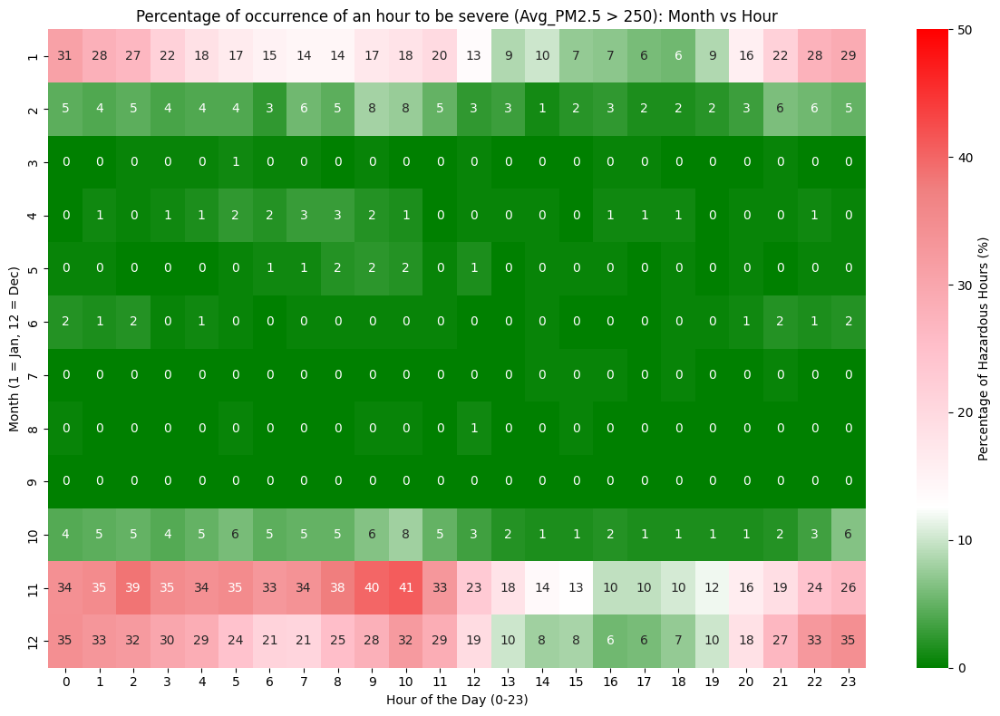

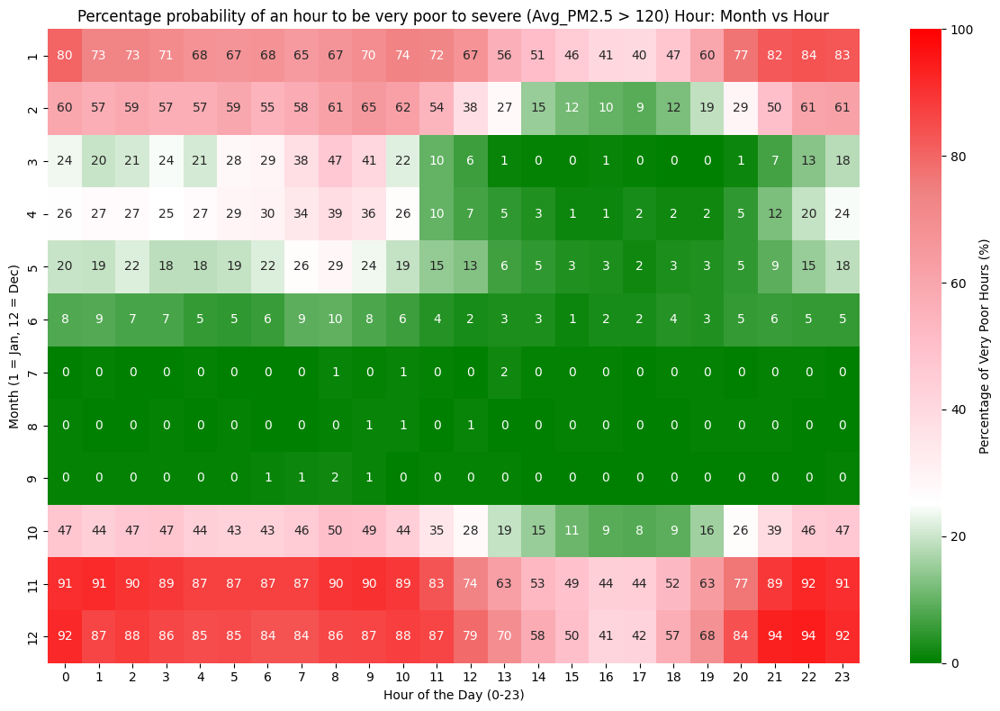

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Month,,,,,,,,,,,,,,,,,,,,,
1,80.184332,72.811060,72.811060,70.506912,67.741935,66.820276,67.741935,64.516129,66.820276,69.585253,...,51.152074,45.622120,40.552995,40.092166,47.465438,59.907834,76.958525,82.488479,83.870968,82.949309
2,59.898477,56.852792,58.883249,56.852792,56.852792,59.390863,54.822335,57.868020,61.421320,64.974619,...,15.228426,11.675127,10.152284,8.629442,12.182741,18.781726,29.441624,50.253807,60.913706,61.421320
3,23.502304,19.815668,20.737327,24.423963,20.737327,28.110599,29.493088,38.248848,46.543779,41.013825,...,0.460829,0.460829,0.921659,0.460829,0.000000,0.000000,1.382488,6.912442,13.364055,17.972350
4,25.714286,27.142857,27.142857,25.238095,27.142857,29.047619,30.000000,34.285714,38.571429,35.714286,...,3.333333,1.428571,1.428571,2.380952,1.904762,1.904762,4.761905,12.380952,19.523810,24.285714
5,19.815668,19.354839,21.658986,18.433180,18.433180,19.354839,21.658986,26.267281,28.571429,23.502304,...,5.069124,3.225806,2.764977,1.843318,2.764977,3.225806,5.069124,9.216590,15.207373,18.433180
6,8.095238,8.571429,7.142857,7.142857,5.238095,4.761905,5.714286,9.047619,9.523810,7.619048,...,2.857143,1.428571,2.380952,2.380952,3.809524,3.333333,5.238095,5.714286,5.238095,5.238095
7,0.000000,0.460829,0.000000,0.000000,0.460829,0.000000,0.000000,0.000000,0.921659,0.460829,...,0.460829,0.460829,0.460829,0.000000,0.460829,0.460829,0.000000,0.460829,0.460829,0.000000
8,0.460829,0.000000,0.000000,0.460829,0.000000,0.460829,0.000000,0.000000,0.460829,0.921659,...,0.000000,0.460829,0.460829,0.000000,0.000000,0.460829,0.460829,0.460829,0.000000,0.000000
9,0.476190,0.476190,0.476190,0.476190,0.476190,0.476190,0.952381,1.428571,1.904762,0.952381,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.476190


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib.colors import LinearSegmentedColormap

# Load the dataset from an Excel file
file_path = '/content/Book5.xlsx'
df1 = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime format for proper handling
df1['Timestamp'] = pd.to_datetime(df1['Timestamp'], format='%d-%m-%Y %H:%M', errors='coerce')

# Extract year, month, day, and hour from the 'Timestamp' column
df1['Year'] = df1['Timestamp'].dt.year
df1['Month'] = df1['Timestamp'].dt.month
df1['Day'] = df1['Timestamp'].dt.day
df1['Hour'] = df1['Timestamp'].dt.hour

# Calculate total hours for each month-hour combination
total_hours = df1.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Filter the data where PM2.5 concentration is greater than 250 (hazardous levels)
pm25_hazardous_250 = df1[df1['Avg_PM2.5'] > 250]

# Calculate the number of hazardous hours for each month-hour combination
hazardous_hours_250 = pm25_hazardous_250.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of hazardous hours by dividing hazardous hours by total hours
hazardous_probability_250 = hazardous_hours_250 / total_hours

# Fill in any NaN values (which represent missing data) with zeros
hazardous_probability_250 = hazardous_probability_250.fillna(0)

# Convert the probability to percentage
hazardous_probability_250_percentage = hazardous_probability_250 * 100

# Create a custom colormap that transitions from green, to white, to pink, and then to red
colors = [(0, "green"), (0.25, "white"), (0.5, "pink"), (0.75, "lightcoral"), (1, "red")]
custom_cmap = LinearSegmentedColormap.from_list("custom_coolwarm", colors)

# Plot the heatmap for the probability of PM2.5 > 250 (hazardous levels) in percentage as whole numbers
plt.figure(figsize=(12, 8))
sns.heatmap(hazardous_probability_250_percentage, cmap=custom_cmap, annot=True, fmt='.0f', cbar_kws={'label': 'Percentage of Hazardous Hours (%)'}, vmin=0, vmax=50)
plt.title('Percentage of occurrence of an hour to be severe (Avg_PM2.5 > 250): Month vs Hour')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month (1 = Jan, 12 = Dec)')
plt.tight_layout()
plt.show()

# Output the percentage data for verification
hazardous_probability_250_percentage

# Filter the data where PM2.5 concentration is greater than 120 (very poor levels)
pm25_very_poor_120 = df1[df1['Avg_PM2.5'] > 120]

# Calculate the number of very poor hours for each month-hour combination
very_poor_hours_120 = pm25_very_poor_120.groupby(['Month', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of very poor hours by dividing very poor hours by total hours
very_poor_probability_120 = very_poor_hours_120 / total_hours

# Fill in any NaN values with zeros
very_poor_probability_120 = very_poor_probability_120.fillna(0)

# Convert the probability to percentage
very_poor_probability_120_percentage = very_poor_probability_120 * 100

# Plot the heatmap for the probability of PM2.5 > 120 (very poor levels) in percentage as whole numbers
plt.figure(figsize=(12, 8))
sns.heatmap(very_poor_probability_120_percentage, cmap=custom_cmap, annot=True, fmt='.0f', cbar_kws={'label': 'Percentage of Very Poor Hours (%)'}, vmin=0, vmax=100)
plt.title('Percentage probability of an hour to be very poor to severe (Avg_PM2.5 > 120) Hour: Month vs Hour')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month (1 = Jan, 12 = Dec)')
plt.tight_layout()
plt.show()

# Output the percentage data for verification
very_poor_probability_120_percentage


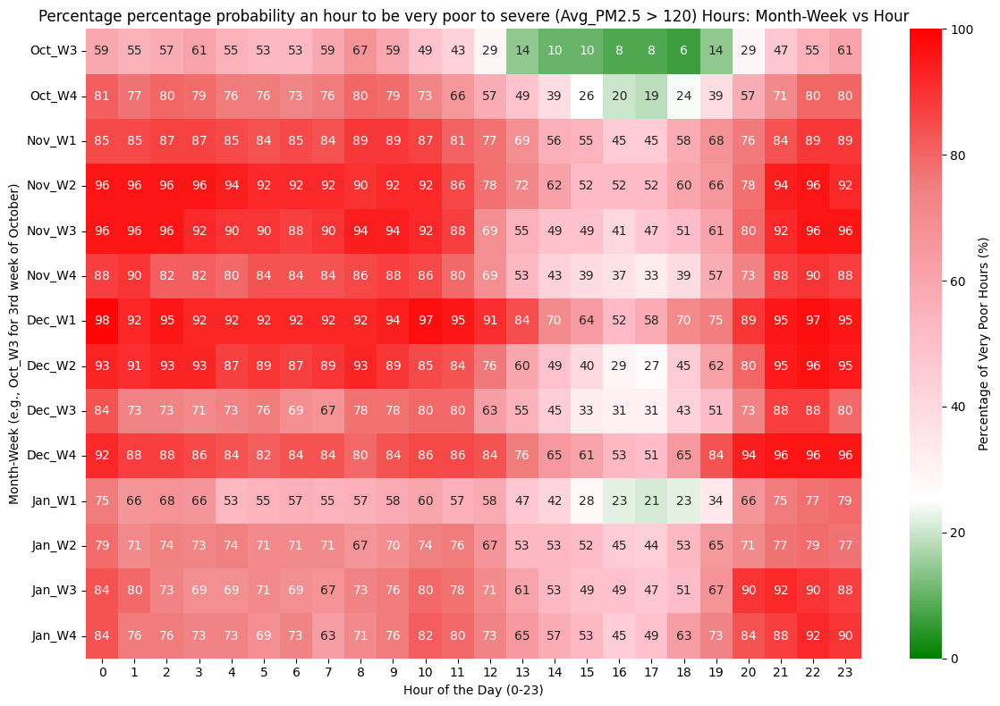

Hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
Month-Week,,,,,,,,,,,,,,,,,,,,,
Oct_W3,59.183673,55.102041,57.142857,61.224490,55.102041,53.061224,53.061224,59.183673,67.346939,59.183673,...,10.204082,10.204082,8.163265,8.163265,6.122449,14.285714,28.571429,46.938776,55.102041,61.224490
Oct_W4,81.428571,77.142857,80.000000,78.571429,75.714286,75.714286,72.857143,75.714286,80.000000,78.571429,...,38.571429,25.714286,20.000000,18.571429,24.285714,38.571429,57.142857,71.428571,80.000000,80.000000
Nov_W1,85.483871,85.483871,87.096774,87.096774,85.483871,83.870968,85.483871,83.870968,88.709677,88.709677,...,56.451613,54.838710,45.161290,45.161290,58.064516,67.741935,75.806452,83.870968,88.709677,88.709677
Nov_W2,96.000000,96.000000,96.000000,96.000000,94.000000,92.000000,92.000000,92.000000,90.000000,92.000000,...,62.000000,52.000000,52.000000,52.000000,60.000000,66.000000,78.000000,94.000000,96.000000,92.000000
Nov_W3,95.918367,95.918367,95.918367,91.836735,89.795918,89.795918,87.755102,89.795918,93.877551,93.877551,...,48.979592,48.979592,40.816327,46.938776,51.020408,61.224490,79.591837,91.836735,95.918367,95.918367
Nov_W4,87.755102,89.795918,81.632653,81.632653,79.591837,83.673469,83.673469,83.673469,85.714286,87.755102,...,42.857143,38.775510,36.734694,32.653061,38.775510,57.142857,73.469388,87.755102,89.795918,87.755102
Dec_W1,98.437500,92.187500,95.312500,92.187500,92.187500,92.187500,92.187500,92.187500,92.187500,93.750000,...,70.312500,64.062500,51.562500,57.812500,70.312500,75.000000,89.062500,95.312500,96.875000,95.312500
Dec_W2,92.727273,90.909091,92.727273,92.727273,87.272727,89.090909,87.272727,89.090909,92.727273,89.090909,...,49.090909,40.000000,29.090909,27.272727,45.454545,61.818182,80.000000,94.545455,96.363636,94.545455
Dec_W3,83.673469,73.469388,73.469388,71.428571,73.469388,75.510204,69.387755,67.346939,77.551020,77.551020,...,44.897959,32.653061,30.612245,30.612245,42.857143,51.020408,73.469388,87.755102,87.755102,79.591837


In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

# Load the dataset
file_path = '/content/Book5.xlsx'
df1 = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime format for proper handling
df1['Timestamp'] = pd.to_datetime(df1['Timestamp'], format='%d-%m-%Y %H:%M', errors='coerce')

# Extract year, month, day, hour, and week from the 'Timestamp' column
df1['Year'] = df1['Timestamp'].dt.year
df1['Month'] = df1['Timestamp'].dt.month
df1['Day'] = df1['Timestamp'].dt.day
df1['Hour'] = df1['Timestamp'].dt.hour
df1['Week'] = df1['Timestamp'].dt.isocalendar().week

# Manually define the weeks for October based on the day ranges
oct_conditions = [
    (df1['Month'] == 10) & (df1['Day'] >= 15) & (df1['Day'] <= 21),  # 3rd week of October
    (df1['Month'] == 10) & (df1['Day'] >= 22) & (df1['Day'] <= 31)   # 4th week of October
]
oct_choices = ['Oct_W3', 'Oct_W4']

# Apply the week labels for October
df1['Month-Week'] = np.select(oct_conditions, oct_choices, default=None)

# Map other months (November, December, January) based on the week number within the month
month_map = {11: 'Nov', 12: 'Dec', 1: 'Jan'}
df1.loc[df1['Month'].isin([11, 12, 1]), 'Month-Week'] = df1.apply(
    lambda x: f"{month_map.get(x['Month'], '')}_W{((x['Week'] - x['Week'] // 4 * 4) + 1)}" if pd.isna(x['Month-Week']) else x['Month-Week'], axis=1)

# Filter data to include only October (weeks 3 and 4), November, December, and January
df_oct_nov_dec = df1[df1['Month-Week'].isin(['Oct_W3', 'Oct_W4',
                                             'Nov_W1', 'Nov_W2', 'Nov_W3', 'Nov_W4',
                                             'Dec_W1', 'Dec_W2', 'Dec_W3', 'Dec_W4',
                                             'Jan_W1', 'Jan_W2', 'Jan_W3', 'Jan_W4'])]

# Calculate total hours for each month-week-hour combination
total_hours = df_oct_nov_dec.groupby(['Month-Week', 'Hour']).size().unstack(fill_value=0)

# Filter the data where PM2.5 concentration is greater than 120 (indicating very poor air quality)
pm25_very_poor_120 = df_oct_nov_dec[df_oct_nov_dec['Avg_PM2.5'] > 120]

# Calculate the number of very poor hours for each month-week-hour combination
very_poor_hours_120 = pm25_very_poor_120.groupby(['Month-Week', 'Hour']).size().unstack(fill_value=0)

# Calculate the probability of very poor hours by dividing very poor hours by total hours
very_poor_probability_120 = very_poor_hours_120 / total_hours

# Fill in any NaN values with zeros
very_poor_probability_120 = very_poor_probability_120.fillna(0)

# Convert the probability to a percentage
very_poor_probability_120_percentage = very_poor_probability_120 * 100

# Reorder the index to start with October, followed by November, December, and then January
ordered_months = ['Oct_W3', 'Oct_W4',
                  'Nov_W1', 'Nov_W2', 'Nov_W3', 'Nov_W4',
                  'Dec_W1', 'Dec_W2', 'Dec_W3', 'Dec_W4',
                  'Jan_W1', 'Jan_W2', 'Jan_W3', 'Jan_W4']
very_poor_probability_120_percentage = very_poor_probability_120_percentage.reindex(ordered_months)

# Create a custom colormap that transitions from green, to white, to pink, and then to red
colors = [(0, "green"), (0.25, "white"), (0.5, "pink"), (0.75, "lightcoral"), (1, "red")]
custom_cmap = LinearSegmentedColormap.from_list("custom_coolwarm", colors)

# Plot the heatmap for the percentage of PM2.5 > 120 (very poor air quality levels)
plt.figure(figsize=(12, 8))
sns.heatmap(very_poor_probability_120_percentage, cmap=custom_cmap, annot=True, fmt='.0f', cbar_kws={'label': 'Percentage of Very Poor Hours (%)'}, vmin=0, vmax=100)
plt.title('Percentage percentage probability an hour to be very poor to severe (Avg_PM2.5 > 120) Hours: Month-Week vs Hour')
plt.xlabel('Hour of the Day (0-23)')
plt.ylabel('Month-Week (e.g., Oct_W3 for 3rd week of October)')
plt.tight_layout()
plt.show()

# Output the percentage data for verification
very_poor_probability_120_percentage


<ipython-input-10-d11ad94f2820>:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap("RdYlGn_r")


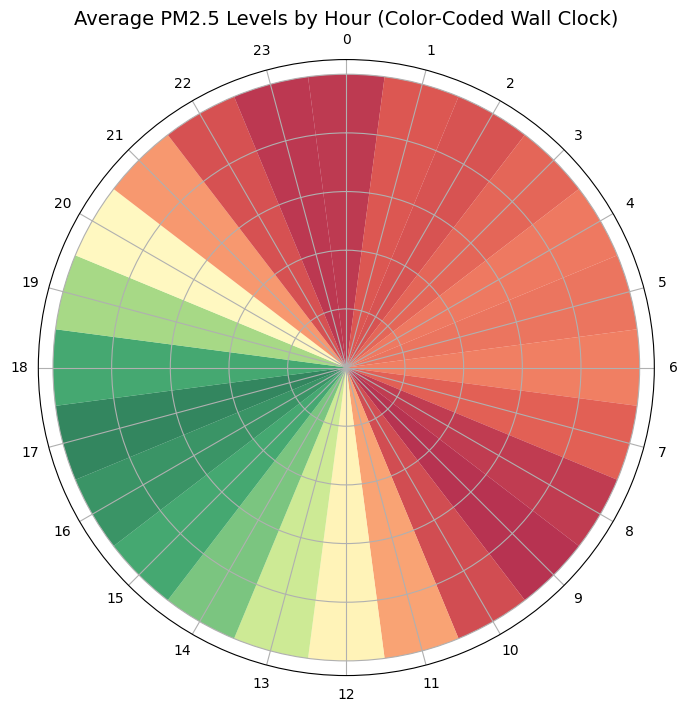

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm

# Load the dataset (adjust the path if needed)
file_path = '/content/Book5.xlsx'
data = pd.read_excel(file_path)

# Check if 'Timestamp' exists and convert it to datetime if necessary
if 'Timestamp' in data.columns:
    data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')

    # Extract the 'Hour' from the 'Timestamp' column
    data['Hour'] = data['Timestamp'].dt.hour
else:
    raise KeyError("The dataset does not contain a 'Timestamp' column.")

# Group by hour to get average PM2.5 levels for the polar plot
if 'Avg_PM2.5' in data.columns:
    hourly_aqi_avg = data.groupby('Hour')['Avg_PM2.5'].mean()
else:
    raise KeyError("The dataset does not contain 'Avg_PM2.5' column.")

# Set up the polar plot (starting at 0/24 o'clock at the top and going clockwise)
fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))

# Create a custom color map that transitions from green to red based on severity
norm = Normalize(vmin=hourly_aqi_avg.min(), vmax=hourly_aqi_avg.max())
cmap = cm.get_cmap("RdYlGn_r")

# Set up the labels for the hours of the day from 0 to 23
hours = np.arange(0, 24)
hour_labels = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11',
               '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23']

# Normalize the hourly AQI values to use in the colormap
for hour, pm_value in hourly_aqi_avg.items():
    color = cmap(norm(pm_value))
    # Adjust width to make the plot look like a traditional clock
    ax.bar(np.deg2rad(hour * 15), 1, width=np.deg2rad(15), color=color, alpha=0.8)

# Remove radial gridlines and labels for a cleaner look
ax.set_yticklabels([])

# Set the clock-like hour labels around the plot (from 0 to 23)
ax.set_xticks(np.linspace(0, 2 * np.pi, 24, endpoint=False))
ax.set_xticklabels(hour_labels)

# Rotate the plot so 0/24 is at the top
ax.set_theta_zero_location('N')
ax.set_theta_direction(-1)

# Add title
plt.title('Average PM2.5 Levels by Hour (Color-Coded Wall Clock)', size=14)

# Show plot
plt.show()


<ipython-input-13-0ff96f735755>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_data['Hour'] = filtered_data['Timestamp'].dt.hour


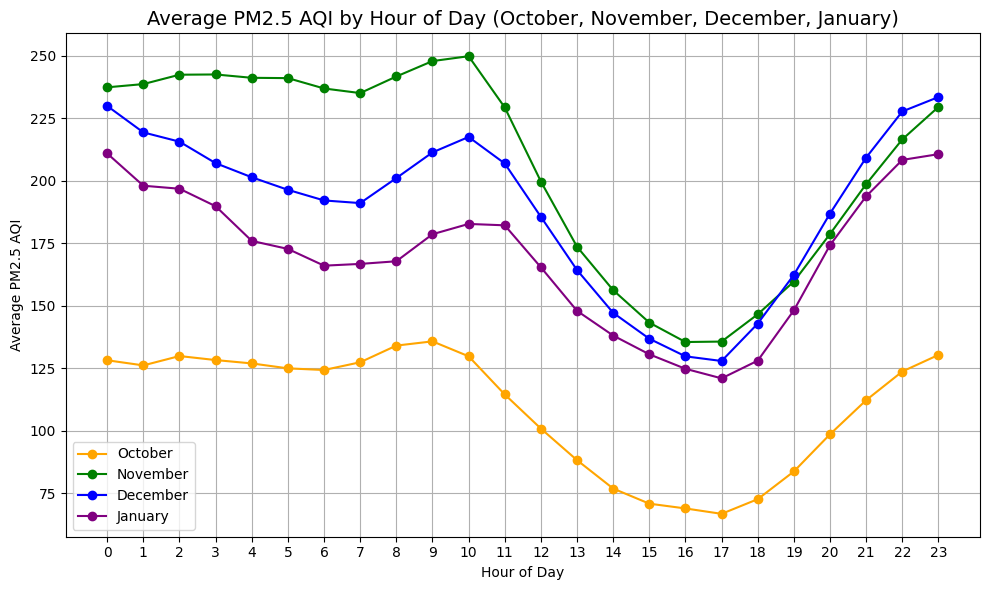

In [ ]:
# Assuming the 'Timestamp' column is already in datetime format, we will extract data for the specified months (October, November, December, and January) and plot their hourly average AQI on the same graph.

# Extract the months we are interested in
months = [10, 11, 12, 1]  # October, November, December, January
data['Month'] = data['Timestamp'].dt.month

# Filter the data for the specific months
filtered_data = data[data['Month'].isin(months)]

# Extract the hour from the timestamp for the hourly trend analysis
filtered_data['Hour'] = filtered_data['Timestamp'].dt.hour

# Group data by Month and Hour to calculate average AQI
hourly_avg_oct = filtered_data[filtered_data['Month'] == 10].groupby('Hour')['Avg_PM2.5'].mean()
hourly_avg_nov = filtered_data[filtered_data['Month'] == 11].groupby('Hour')['Avg_PM2.5'].mean()
hourly_avg_dec = filtered_data[filtered_data['Month'] == 12].groupby('Hour')['Avg_PM2.5'].mean()
hourly_avg_jan = filtered_data[filtered_data['Month'] == 1].groupby('Hour')['Avg_PM2.5'].mean()

# Plotting all months on the same graph
plt.figure(figsize=(10, 6))

# Plot for October
plt.plot(hourly_avg_oct.index, hourly_avg_oct, marker='o', label='October', color='orange')

# Plot for November
plt.plot(hourly_avg_nov.index, hourly_avg_nov, marker='o', label='November', color='green')

# Plot for December
plt.plot(hourly_avg_dec.index, hourly_avg_dec, marker='o', label='December', color='blue')

# Plot for January
plt.plot(hourly_avg_jan.index, hourly_avg_jan, marker='o', label='January', color='purple')

# Set plot labels and title
plt.title('Average PM2.5 AQI by Hour of Day (October, November, December, January)', size=14)
plt.xlabel('Hour of Day')
plt.ylabel('Average PM2.5 AQI')
plt.xticks(range(0, 24))
plt.grid(True)
plt.legend()

# Show plot
plt.tight_layout()
plt.show()


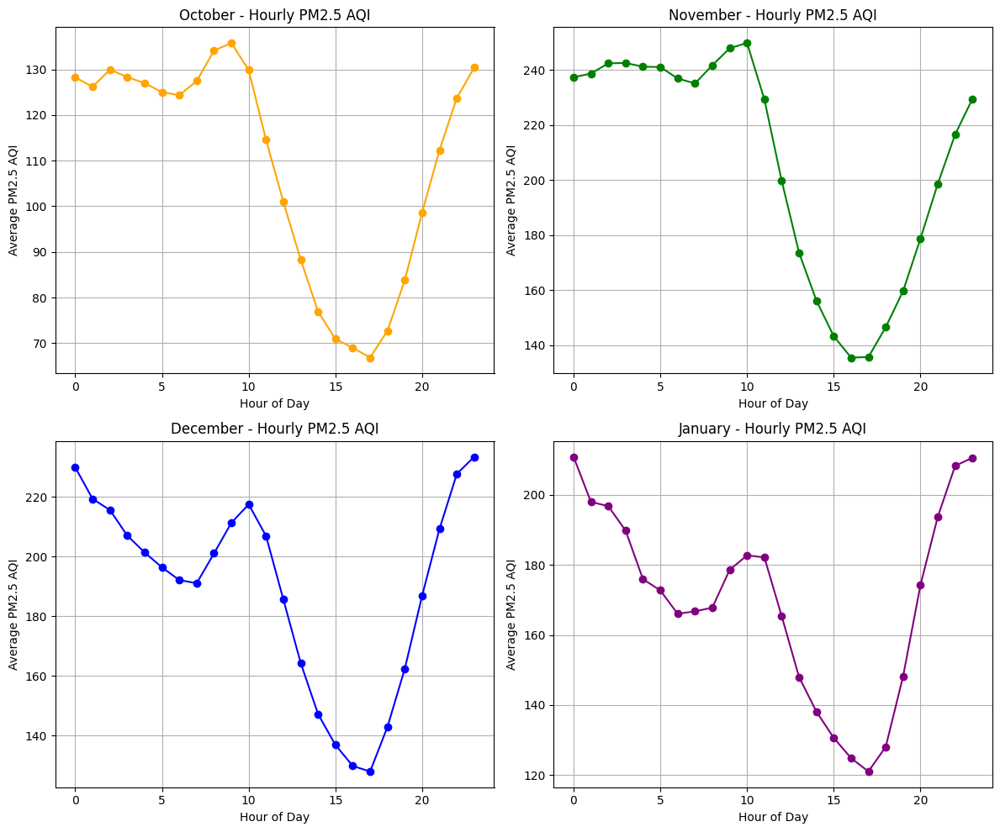

In [ ]:
# Creating a single figure with four subplots (one for each month) to show hourly AQI trends
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# Plotting October
axs[0, 0].plot(hourly_avg_oct.index, hourly_avg_oct, marker='o', color='orange')
axs[0, 0].set_title('October - Hourly PM2.5 AQI')
axs[0, 0].set_xlabel('Hour of Day')
axs[0, 0].set_ylabel('Average PM2.5 AQI')
axs[0, 0].grid(True)

# Plotting November
axs[0, 1].plot(hourly_avg_nov.index, hourly_avg_nov, marker='o', color='green')
axs[0, 1].set_title('November - Hourly PM2.5 AQI')
axs[0, 1].set_xlabel('Hour of Day')
axs[0, 1].set_ylabel('Average PM2.5 AQI')
axs[0, 1].grid(True)

# Plotting December
axs[1, 0].plot(hourly_avg_dec.index, hourly_avg_dec, marker='o', color='blue')
axs[1, 0].set_title('December - Hourly PM2.5 AQI')
axs[1, 0].set_xlabel('Hour of Day')
axs[1, 0].set_ylabel('Average PM2.5 AQI')
axs[1, 0].grid(True)

# Plotting January
axs[1, 1].plot(hourly_avg_jan.index, hourly_avg_jan, marker='o', color='purple')
axs[1, 1].set_title('January - Hourly PM2.5 AQI')
axs[1, 1].set_xlabel('Hour of Day')
axs[1, 1].set_ylabel('Average PM2.5 AQI')
axs[1, 1].grid(True)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


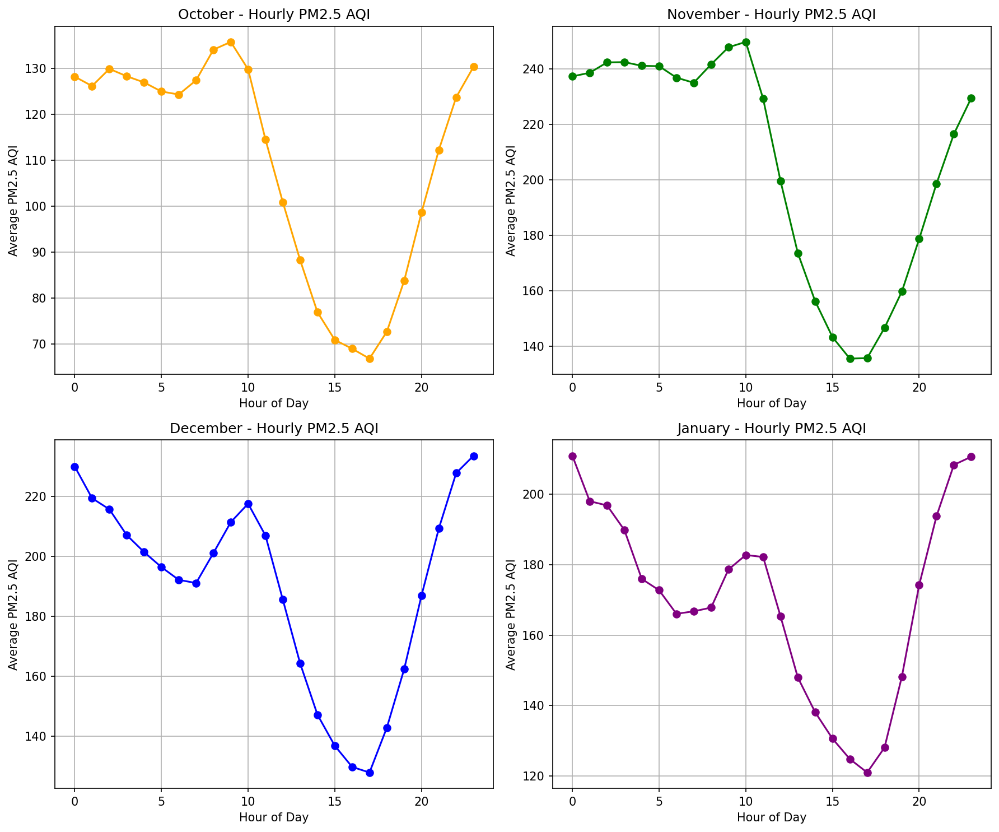

In [ ]:
# Re-plotting with higher resolution and improved formatting

# Increase figure DPI for better quality
fig, axs = plt.subplots(2, 2, figsize=(12, 10), dpi=150)

# Plotting October
axs[0, 0].plot(hourly_avg_oct.index, hourly_avg_oct, marker='o', color='orange')
axs[0, 0].set_title('October - Hourly PM2.5 AQI')
axs[0, 0].set_xlabel('Hour of Day')
axs[0, 0].set_ylabel('Average PM2.5 AQI')
axs[0, 0].grid(True)

# Plotting November
axs[0, 1].plot(hourly_avg_nov.index, hourly_avg_nov, marker='o', color='green')
axs[0, 1].set_title('November - Hourly PM2.5 AQI')
axs[0, 1].set_xlabel('Hour of Day')
axs[0, 1].set_ylabel('Average PM2.5 AQI')
axs[0, 1].grid(True)

# Plotting December
axs[1, 0].plot(hourly_avg_dec.index, hourly_avg_dec, marker='o', color='blue')
axs[1, 0].set_title('December - Hourly PM2.5 AQI')
axs[1, 0].set_xlabel('Hour of Day')
axs[1, 0].set_ylabel('Average PM2.5 AQI')
axs[1, 0].grid(True)

# Plotting January
axs[1, 1].plot(hourly_avg_jan.index, hourly_avg_jan, marker='o', color='purple')
axs[1, 1].set_title('January - Hourly PM2.5 AQI')
axs[1, 1].set_xlabel('Hour of Day')
axs[1, 1].set_ylabel('Average PM2.5 AQI')
axs[1, 1].grid(True)

# Adjust layout for better spacing and visual clarity
plt.tight_layout()

# Show the improved quality graph
plt.show()


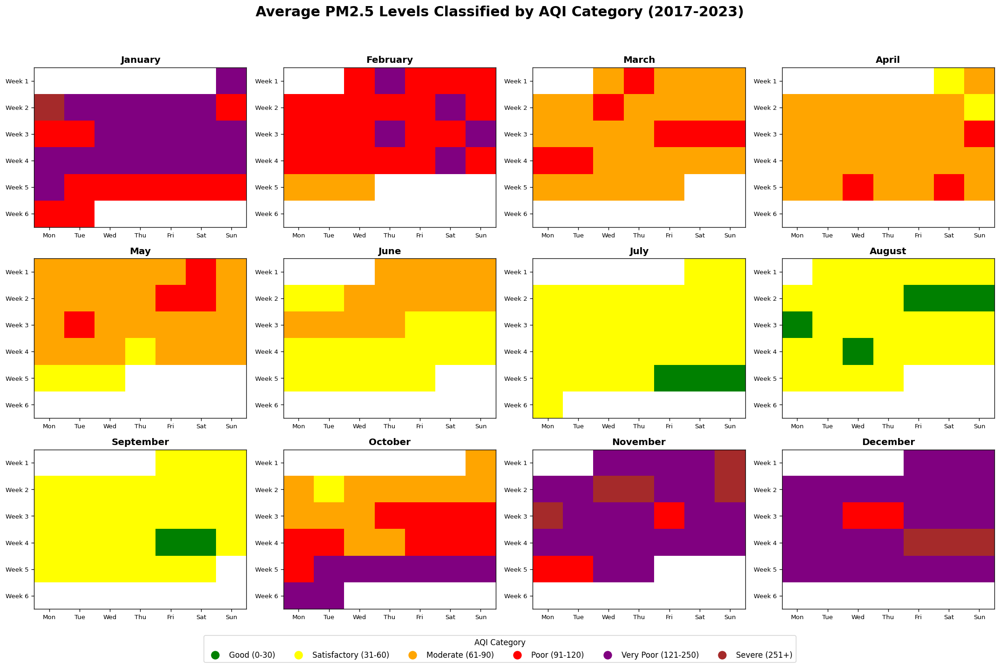

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap, BoundaryNorm
import calendar

# Load the dataset
data = pd.read_excel('/content/Book5.xlsx')  # Replace with the correct file path
data['Timestamp'] = pd.to_datetime(data['Timestamp'])
data.set_index('Timestamp', inplace=True)

# Resample data to get daily average PM2.5 levels
daily_avg_pm25 = data['Avg_PM2.5'].resample('D').mean()

# Define a function to categorize PM2.5 levels according to AQI standards
def pm25_aqi_category(pm25):
    if pm25 <= 30:
        return 1  # Good
    elif pm25 <= 60:
        return 2  # Satisfactory
    elif pm25 <= 90:
        return 3  # Moderate
    elif pm25 <= 120:
        return 4  # Poor
    elif pm25 <= 250:
        return 5  # Very Poor
    else:
        return 6  # Severe

# Apply the categorization function to the daily PM2.5 data
daily_aqi_category = daily_avg_pm25.apply(pm25_aqi_category)

# Calculate the average AQI category for each day of the year across 2017-2023
average_aqi_category = daily_aqi_category.groupby([daily_aqi_category.index.month, daily_aqi_category.index.day]).mean()

# Define colormap and normalization for AQI categories
cmap = ListedColormap(['green', 'yellow', 'orange', 'red', 'purple', 'brown'])
norm = BoundaryNorm([0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5], cmap.N)

# Create subplots for each month
fig, axs = plt.subplots(3, 4, figsize=(18, 12), dpi=120)
fig.suptitle('Average PM2.5 Levels Classified by AQI Category (2017-2023)', fontsize=18, fontweight='bold')

# Loop through each month and create a grid
for i, month in enumerate(range(1, 13)):
    # Filter data for the specific month and prepare a grid for the days
    month_data = average_aqi_category.loc[month]
    days_in_month = calendar.monthrange(2017, month)[1]

    # Create an empty matrix for the month's days (rows: weeks, cols: days of the week)
    month_matrix = np.zeros((6, 7)) * np.nan  # 6 weeks x 7 days (NaN for empty spaces)

    # Place the AQI category values in the matrix
    first_weekday = calendar.weekday(2017, month, 1)
    for day, value in enumerate(month_data, start=1):
        week = (first_weekday + day - 1) // 7
        day_of_week = (first_weekday + day - 1) % 7
        month_matrix[week, day_of_week] = value

    # Plot the matrix on the respective subplot
    ax = axs[i // 4, i % 4]
    im = ax.imshow(month_matrix, cmap=cmap, norm=norm, aspect='auto')
    ax.set_xticks(range(7))
    ax.set_xticklabels(['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'], fontsize=8)
    ax.set_yticks(range(6))
    ax.set_yticklabels([f'Week {w+1}' for w in range(6)], fontsize=8)

    # Set the title for each subplot
    ax.set_title(calendar.month_name[month], fontsize=12, fontweight='bold')

# Define more detailed AQI category labels with ranges
detailed_labels = [
    'Good (0-30)',
    'Satisfactory (31-60)',
    'Moderate (61-90)',
    'Poor (91-120)',
    'Very Poor (121-250)',
    'Severe (251+)'
]
colors = ['green', 'yellow', 'orange', 'red', 'purple', 'brown']
handles = [plt.Line2D([0], [0], color=color, marker='o', linestyle='', markersize=10) for color in colors]

# Add the legend below the colorbar
fig.legend(handles, detailed_labels, title='AQI Category', bbox_to_anchor=(0.5, 0.02), loc='center', fontsize=10, ncol=6)

# Adjust layout to fit title and legend
plt.tight_layout(rect=[0, 0.05, 1, 0.95])
plt.show()


In [ ]:
# Load the newly uploaded dataset to proceed with the analysis
file_path_new = '/content/Book5.xlsx'
new_data = pd.read_excel(file_path_new)

# Display the first few rows to understand the structure of the new dataset
new_data.head()


,Timestamp,Sirifort_PM2.5,IHBAS_PM2.5,Sonia_Vihar_PM2.5,mandir_marg_PM2.5,Avg_PM2.5,Avg_PM10 (µg/m³),Avg_NO2 (µg/m³),Avg_AT (°C),Avg_VWS (m/s),Avg_O Xylene (µg/m³),Avg_SO2 (µg/m³),Avg_Eth-Benzene (µg/m³),Avg_CO (mg/m³),Avg_RH (%),Avg_Xylene (µg/m³),Avg_WD (deg),Avg_Toluene (µg/m³)
0,2017-01-01 00:00:00,272.83,115.87,NaN,227.83,205.510000,302.83,68.926667,12.890,0.35,NaN,14.080,NaN,3.88,92.500000,NaN,133.416667,12.82
1,2017-01-01 01:00:00,233.47,115.15,NaN,224.17,190.930000,255.00,56.870000,12.230,0.39,NaN,11.300,NaN,2.92,92.836667,NaN,105.013333,11.83
2,2017-01-01 02:00:00,206.17,116.53,NaN,200.50,174.400000,240.00,52.853333,12.065,0.37,NaN,7.050,NaN,1.08,93.656667,NaN,109.826667,8.95
3,2017-01-01 03:00:00,195.85,114.00,NaN,154.83,154.893333,211.67,44.416667,10.980,0.40,NaN,8.040,NaN,0.98,93.010000,NaN,129.800000,7.94
4,2017-01-01 04:00:00,186.70,113.70,NaN,164.00,154.800000,205.67,35.743333,10.170,0.39,NaN,10.925,NaN,1.42,93.703333,NaN,182.590000,7.98


In [ ]:
import pandas as pd

# AQI calculation function
def calculate_aqi(concentration, breakpoints):
    for C_low, C_high, I_low, I_high in breakpoints:
        if C_low <= concentration <= C_high:
            return ((I_high - I_low) / (C_high - C_low)) * (concentration - C_low) + I_low
    return None  # Return None if the concentration doesn't fit any category

# Breakpoints for PM2.5 (µg/m³)
pm25_breakpoints = [
    (0, 30, 0, 50),
    (31, 60, 51, 100),
    (61, 90, 101, 200),
    (91, 120, 201, 300),
    (121, 250, 301, 400),
    (251, 500, 401, 500)
]

# Breakpoints for PM10 (µg/m³)
pm10_breakpoints = [
    (0, 50, 0, 50),
    (51, 100, 51, 100),
    (101, 250, 101, 200),
    (251, 350, 201, 300),
    (351, 430, 301, 400),
    (431, 500, 401, 500)
]

# Breakpoints for SO2 (µg/m³)
so2_breakpoints = [
    (0, 40, 0, 50),
    (41, 80, 51, 100),
    (81, 380, 101, 200),
    (381, 800, 201, 300),
    (801, 1600, 301, 400),
    (1601, 2100, 401, 500)
]

# Load your dataset (replace with the correct file path)
file_path = '/content/Book5.xlsx'  # Use the correct file path
data = pd.read_excel(file_path)

# Recalculate AQI for PM2.5, PM10, and SO2
data['PM2.5_AQI'] = data['Avg_PM2.5'].apply(lambda x: calculate_aqi(x, pm25_breakpoints))
data['PM10_AQI'] = data['Avg_PM10 (µg/m³)'].apply(lambda x: calculate_aqi(x, pm10_breakpoints))
data['SO2_AQI'] = data['Avg_SO2 (µg/m³)'].apply(lambda x: calculate_aqi(x, so2_breakpoints))

# Calculate the maximum AQI for each row based on the pollutants
data['Max_AQI'] = data[['PM2.5_AQI', 'PM10_AQI', 'SO2_AQI']].max(axis=1)

# Save the dataset with AQI calculations to a new file
output_file = 'aqi_calculated_dataset.xlsx'
data.to_excel(output_file, index=False)

print("AQI calculations completed and saved to:", output_file)


AQI calculations completed and saved to: aqi_calculated_dataset.xlsx


In [ ]:
pip install python-aqi


  Preparing metadata (setup.py) ... done
  Created wheel for python-aqi: filename=python_aqi-0.6.1-py3-none-any.whl size=9649 sha256=528b3b061698716a1162f15fbd139a7e7b2f6fc19d19e6cd6fce448e4ba44f4e
  Stored in directory: /root/.cache/pip/wheels/e9/d6/44/a99d668809df30b3958b40ca640b825a62be4f91880111dc8b
Successfully built python-aqi


In [ ]:
import pandas as pd
import numpy as np
import math

# Function to calculate AQI based on concentration using breakpoints
def calculate_aqi(concentration, breakpoints):
    for C_low, C_high, I_low, I_high in breakpoints:
        if C_low <= concentration <= C_high:
            return ((I_high - I_low) / (C_high - C_low)) * (concentration - C_low) + I_low
    return None  # Return None if the concentration doesn't fit any category

# Breakpoints for PM2.5 (µg/m³)
pm25_breakpoints = [
    (0, 30, 0, 50),
    (31, 60, 51, 100),
    (61, 90, 101, 200),
    (91, 120, 201, 300),
    (121, 250, 301, 400),
    (251, 500, 401, 500)
]

# Breakpoints for PM10 (µg/m³)
pm10_breakpoints = [
    (0, 50, 0, 50),
    (51, 100, 51, 100),
    (101, 250, 101, 200),
    (251, 350, 201, 300),
    (351, 430, 301, 400),
    (431, 500, 401, 500)
]

# Breakpoints for SO2 (µg/m³)
so2_breakpoints = [
    (0, 40, 0, 50),
    (41, 80, 51, 100),
    (81, 380, 101, 200),
    (381, 800, 201, 300),
    (801, 1600, 301, 400),
    (1601, 2100, 401, 500)
]

# Load the dataset (replace with the correct file path)
file_path = '/content/Book5.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Ensure the columns are numeric and handle non-numeric values
data['Avg_PM2.5'] = pd.to_numeric(data['Avg_PM2.5'], errors='coerce')
data['Avg_PM10 (µg/m³)'] = pd.to_numeric(data['Avg_PM10 (µg/m³)'], errors='coerce')
data['Avg_SO2 (µg/m³)'] = pd.to_numeric(data['Avg_SO2 (µg/m³)'], errors='coerce')

# Apply linear interpolation to fill missing values in PM2.5 and PM10
data['Avg_PM2.5'] = data['Avg_PM2.5'].interpolate(method='linear')
data['Avg_PM10 (µg/m³)'] = data['Avg_PM10 (µg/m³)'].interpolate(method='linear')

# Calculate AQI for PM2.5, PM10, and SO2
data['PM2.5_AQI'] = data['Avg_PM2.5'].apply(lambda x: calculate_aqi(x, pm25_breakpoints) if not math.isnan(x) else None)
data['PM10_AQI'] = data['Avg_PM10 (µg/m³)'].apply(lambda x: calculate_aqi(x, pm10_breakpoints) if not math.isnan(x) else None)
data['SO2_AQI'] = data['Avg_SO2 (µg/m³)'].apply(lambda x: calculate_aqi(x, so2_breakpoints) if not math.isnan(x) else None)

# Calculate the maximum AQI for each row based on PM2.5, PM10, and SO2
data['Max_AQI'] = data[['PM2.5_AQI', 'PM10_AQI', 'SO2_AQI']].max(axis=1)

# Save the dataset with AQI calculations to a new file
output_file = 'aqi_calculated_with_interpolation.xlsx'
data.to_excel(output_file, index=False)

print("AQI calculations completed and saved to:", output_file)


AQI calculations completed and saved to: aqi_calculated_with_interpolation.xlsx


In [ ]:
pip install pandas openpyxl


Percentage AQI governed by PM2.5: 49.27%
Percentage AQI governed by PM10: 50.57%
Percentage AQI governed by SO2: 0.15%


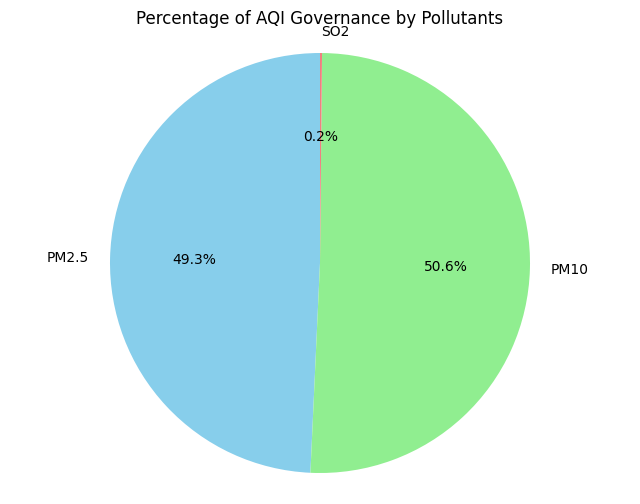

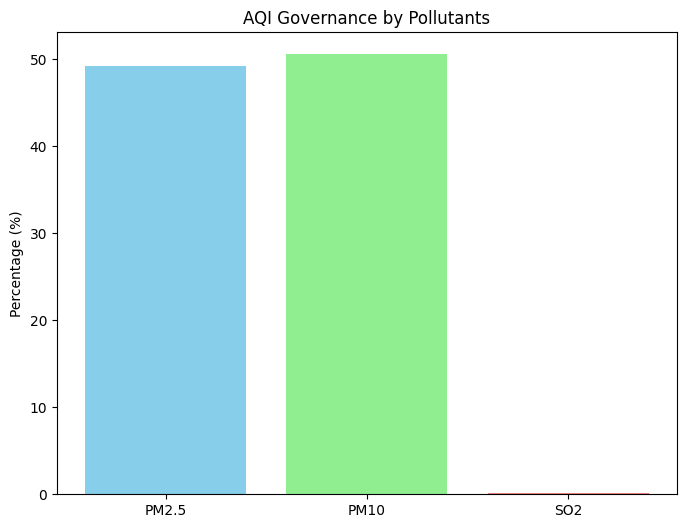

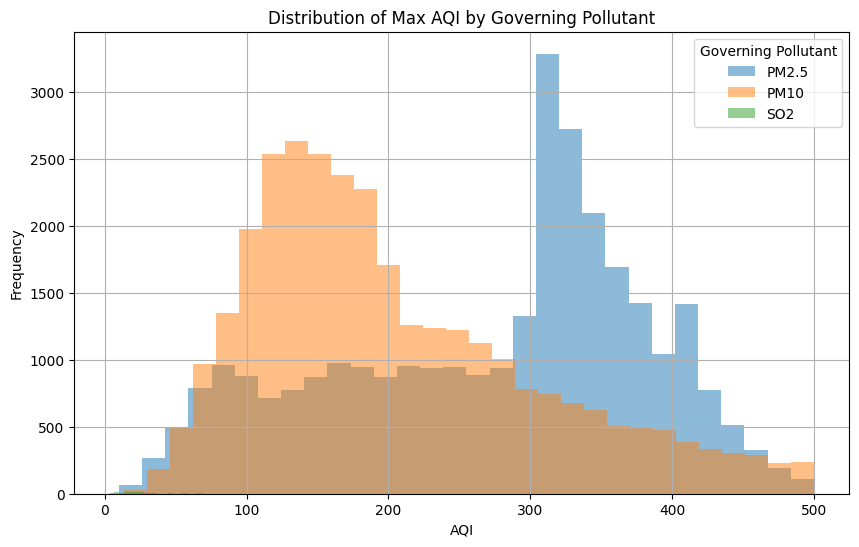

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    elif row['SO2_AQI'] == row['Max_AQI']:
        return 'SO2'
    return None

data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# Calculate percentages for each pollutant governing AQI
governed_by_pm25 = (data['Governing_Pollutant'] == 'PM2.5').sum() / len(data) * 100
governed_by_pm10 = (data['Governing_Pollutant'] == 'PM10').sum() / len(data) * 100
governed_by_so2 = (data['Governing_Pollutant'] == 'SO2').sum() / len(data) * 100

# Display the percentage results
print(f"Percentage AQI governed by PM2.5: {governed_by_pm25:.2f}%")
print(f"Percentage AQI governed by PM10: {governed_by_pm10:.2f}%")
print(f"Percentage AQI governed by SO2: {governed_by_so2:.2f}%")

# Visualization: Pie Chart of AQI Governance
labels = ['PM2.5', 'PM10', 'SO2']
sizes = [governed_by_pm25, governed_by_pm10, governed_by_so2]
colors = ['skyblue', 'lightgreen', 'lightcoral']
plt.figure(figsize=(8, 6))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=colors)
plt.title('Percentage of AQI Governance by Pollutants')
plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle.
plt.show()

# Visualization: Bar Plot of AQI Governance
plt.figure(figsize=(8, 6))
plt.bar(labels, sizes, color=colors)
plt.title('AQI Governance by Pollutants')
plt.ylabel('Percentage (%)')
plt.show()

# Visualization: Histogram of AQI Distribution by Governing Pollutant
plt.figure(figsize=(10, 6))
for pollutant in ['PM2.5', 'PM10', 'SO2']:
    data[data['Governing_Pollutant'] == pollutant]['Max_AQI'].hist(alpha=0.5, bins=30, label=pollutant)
plt.title('Distribution of Max AQI by Governing Pollutant')
plt.xlabel('AQI')
plt.ylabel('Frequency')
plt.legend(title='Governing Pollutant')
plt.show()


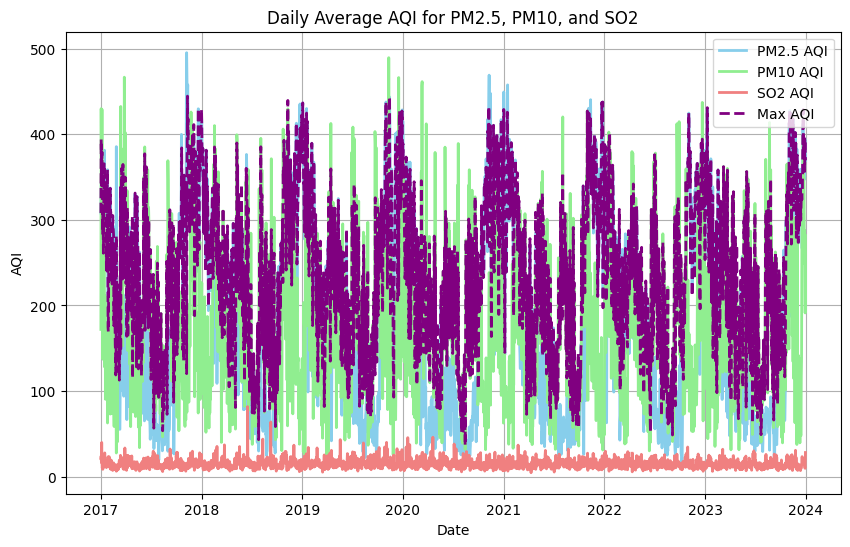

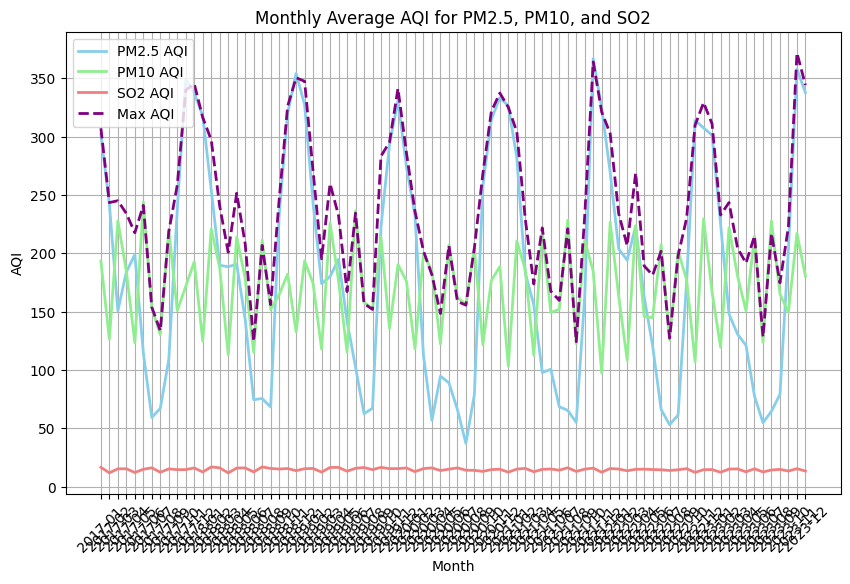

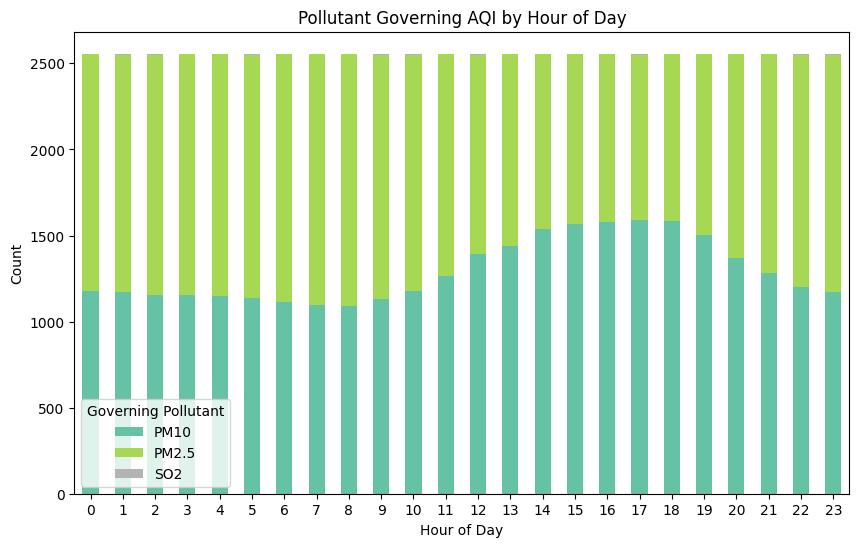

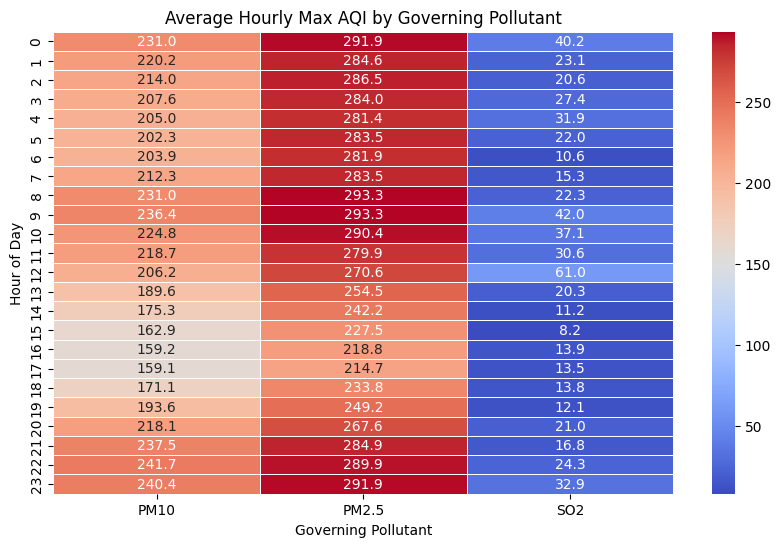

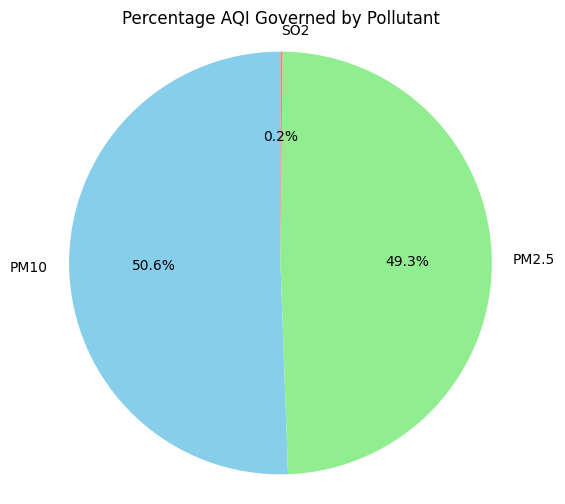

In [ ]:

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract Date and Time components
data['Date'] = data['Timestamp'].dt.date
data['Month'] = data['Timestamp'].dt.to_period('M')  # Monthly aggregation
data['Hour'] = data['Timestamp'].dt.hour

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    elif row['SO2_AQI'] == row['Max_AQI']:
        return 'SO2'
    return None

data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# Calculate daily and monthly averages for each pollutant
daily_avg = data.groupby('Date').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'SO2_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

monthly_avg = data.groupby('Month').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'SO2_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

# Calculate which pollutant governs the AQI at each hour (time of day analysis)
hourly_governing_pollutant = data.groupby('Hour')['Governing_Pollutant'].apply(lambda x: x.value_counts().idxmax())

# --- Visualization ---

# 1. Line Plot of Daily Averages of AQI for each pollutant
plt.figure(figsize=(10, 6))
plt.plot(daily_avg['Date'], daily_avg['PM2.5_AQI'], label='PM2.5 AQI', color='skyblue', linewidth=2)
plt.plot(daily_avg['Date'], daily_avg['PM10_AQI'], label='PM10 AQI', color='lightgreen', linewidth=2)
plt.plot(daily_avg['Date'], daily_avg['SO2_AQI'], label='SO2 AQI', color='lightcoral', linewidth=2)
plt.plot(daily_avg['Date'], daily_avg['Max_AQI'], label='Max AQI', color='purple', linewidth=2, linestyle='--')
plt.title('Daily Average AQI for PM2.5, PM10, and SO2')
plt.xlabel('Date')
plt.ylabel('AQI')
plt.legend()
plt.grid(True)
plt.show()

# 2. Line Plot of Monthly Averages of AQI for each pollutant
plt.figure(figsize=(10, 6))
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['PM2.5_AQI'], label='PM2.5 AQI', color='skyblue', linewidth=2)
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['PM10_AQI'], label='PM10 AQI', color='lightgreen', linewidth=2)
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['SO2_AQI'], label='SO2 AQI', color='lightcoral', linewidth=2)
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['Max_AQI'], label='Max AQI', color='purple', linewidth=2, linestyle='--')
plt.title('Monthly Average AQI for PM2.5, PM10, and SO2')
plt.xlabel('Month')
plt.ylabel('AQI')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

# 3. Bar Plot of AQI Governing Pollutant Distribution by Time of Day (Hour)
hourly_gov_pollutant_counts = data.groupby('Hour')['Governing_Pollutant'].value_counts().unstack().fillna(0)
hourly_gov_pollutant_counts.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Set2')
plt.title('Pollutant Governing AQI by Hour of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.legend(title='Governing Pollutant')
plt.show()

# 4. Heatmap of Hourly AQI for each pollutant
plt.figure(figsize=(10, 6))
heatmap_data = data.groupby(['Hour', 'Governing_Pollutant'])['Max_AQI'].mean().unstack()
sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt=".1f", linewidths=0.5)
plt.title('Average Hourly Max AQI by Governing Pollutant')
plt.xlabel('Governing Pollutant')
plt.ylabel('Hour of Day')
plt.show()

# 5. Pie Chart of Overall AQI Governance
governed_by_pollutant = data['Governing_Pollutant'].value_counts(normalize=True) * 100
plt.figure(figsize=(6, 6))
plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=['skyblue', 'lightgreen', 'lightcoral'], startangle=90)
plt.title('Percentage AQI Governed by Pollutant')
plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle
plt.show()


In [ ]:
pip install pandas matplotlib seaborn openpyxl


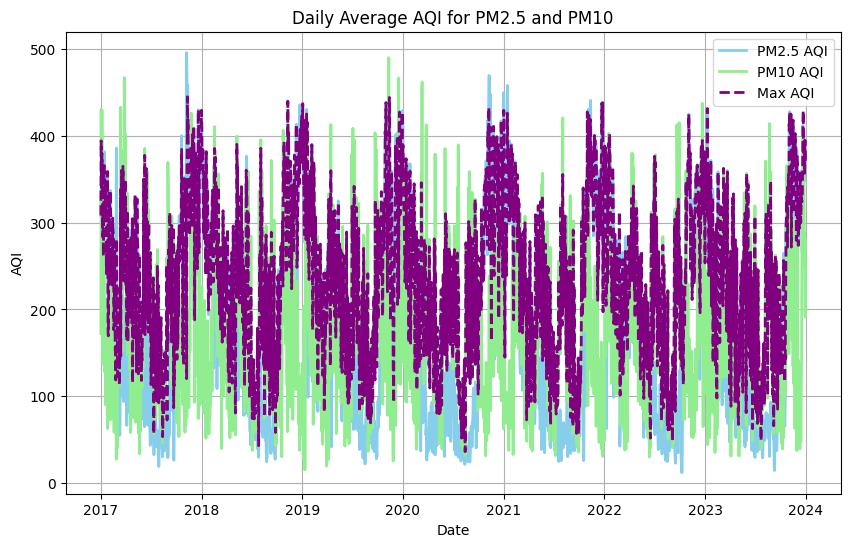

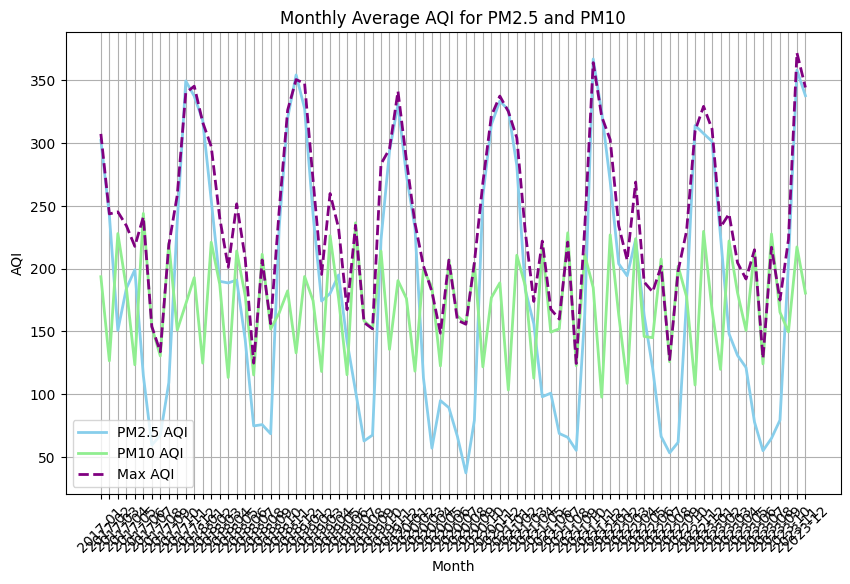

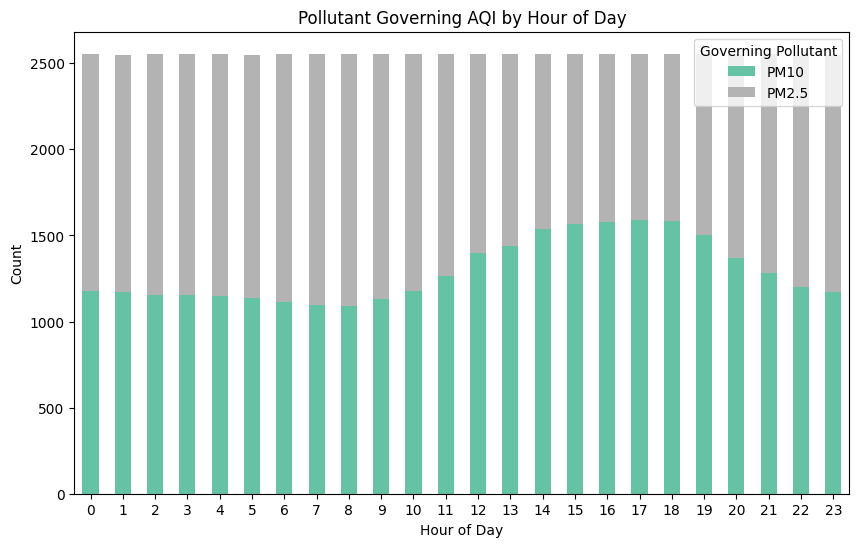

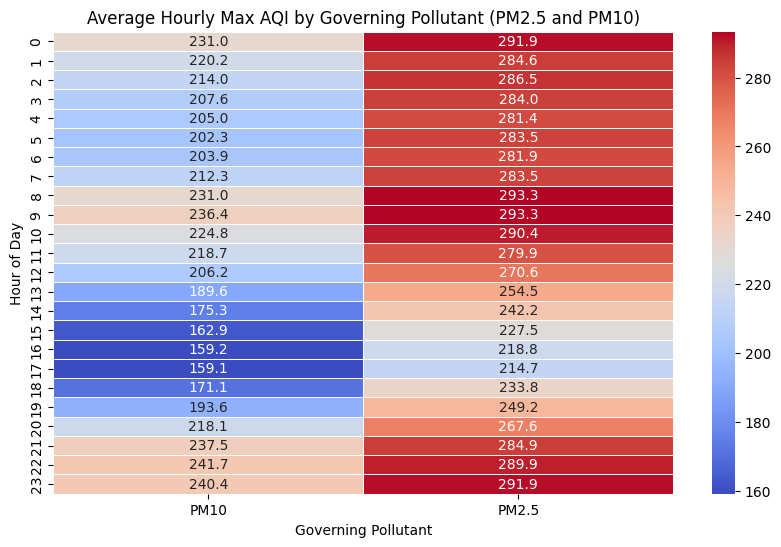

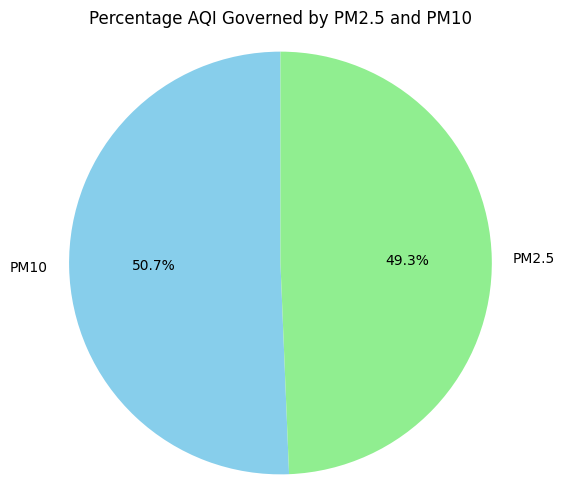

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract Date and Time components
data['Date'] = data['Timestamp'].dt.date
data['Month'] = data['Timestamp'].dt.to_period('M')  # Monthly aggregation
data['Hour'] = data['Timestamp'].dt.hour

# Create a new column that identifies which pollutant governs the AQI (PM2.5 or PM10)
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# Calculate daily and monthly averages for PM2.5 and PM10
daily_avg = data.groupby('Date').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

monthly_avg = data.groupby('Month').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

# Calculate which pollutant governs the AQI at each hour (time of day analysis)
hourly_governing_pollutant = data.groupby('Hour')['Governing_Pollutant'].apply(lambda x: x.value_counts().idxmax())

# --- Visualization ---

# 1. Line Plot of Daily Averages of AQI for PM2.5 and PM10
plt.figure(figsize=(10, 6))
plt.plot(daily_avg['Date'], daily_avg['PM2.5_AQI'], label='PM2.5 AQI', color='skyblue', linewidth=2)
plt.plot(daily_avg['Date'], daily_avg['PM10_AQI'], label='PM10 AQI', color='lightgreen', linewidth=2)
plt.plot(daily_avg['Date'], daily_avg['Max_AQI'], label='Max AQI', color='purple', linewidth=2, linestyle='--')
plt.title('Daily Average AQI for PM2.5 and PM10')
plt.xlabel('Date')
plt.ylabel('AQI')
plt.legend()
plt.grid(True)
plt.show()

# 2. Line Plot of Monthly Averages of AQI for PM2.5 and PM10
plt.figure(figsize=(10, 6))
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['PM2.5_AQI'], label='PM2.5 AQI', color='skyblue', linewidth=2)
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['PM10_AQI'], label='PM10 AQI', color='lightgreen', linewidth=2)
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['Max_AQI'], label='Max AQI', color='purple', linewidth=2, linestyle='--')
plt.title('Monthly Average AQI for PM2.5 and PM10')
plt.xlabel('Month')
plt.ylabel('AQI')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

# 3. Bar Plot of AQI Governing Pollutant Distribution by Time of Day (Hour)
hourly_gov_pollutant_counts = data.groupby('Hour')['Governing_Pollutant'].value_counts().unstack().fillna(0)
hourly_gov_pollutant_counts.plot(kind='bar', stacked=True, figsize=(10, 6), colormap='Set2')
plt.title('Pollutant Governing AQI by Hour of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.legend(title='Governing Pollutant')
plt.show()

# 4. Heatmap of Hourly AQI for each pollutant
plt.figure(figsize=(10, 6))
heatmap_data = data.groupby(['Hour', 'Governing_Pollutant'])['Max_AQI'].mean().unstack()
sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt=".1f", linewidths=0.5)
plt.title('Average Hourly Max AQI by Governing Pollutant (PM2.5 and PM10)')
plt.xlabel('Governing Pollutant')
plt.ylabel('Hour of Day')
plt.show()

# 5. Pie Chart of Overall AQI Governance between PM2.5 and PM10
governed_by_pollutant = data['Governing_Pollutant'].value_counts(normalize=True) * 100
plt.figure(figsize=(6, 6))
plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=['skyblue', 'lightgreen'], startangle=90)
plt.title('Percentage AQI Governed by PM2.5 and PM10')
plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle
plt.show()


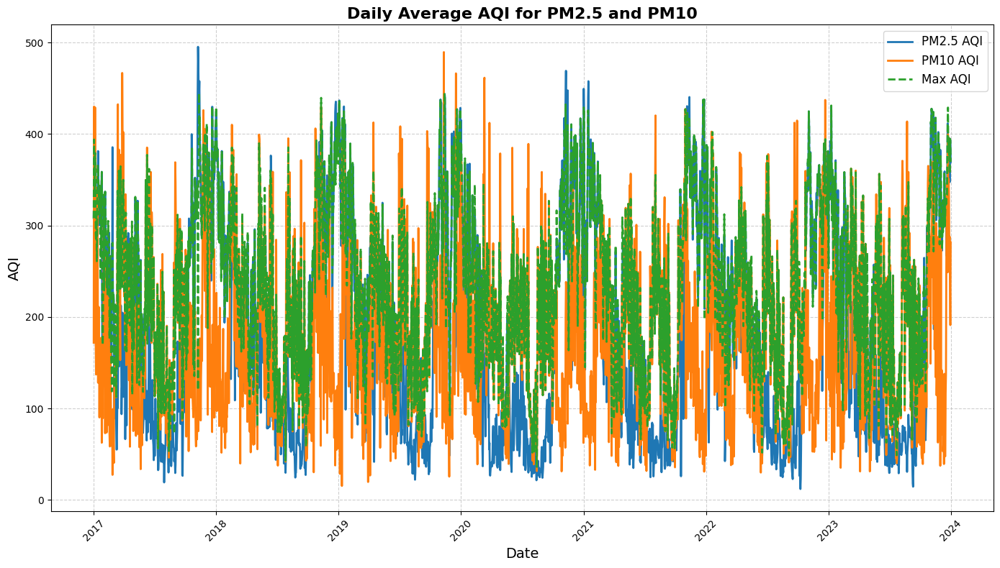

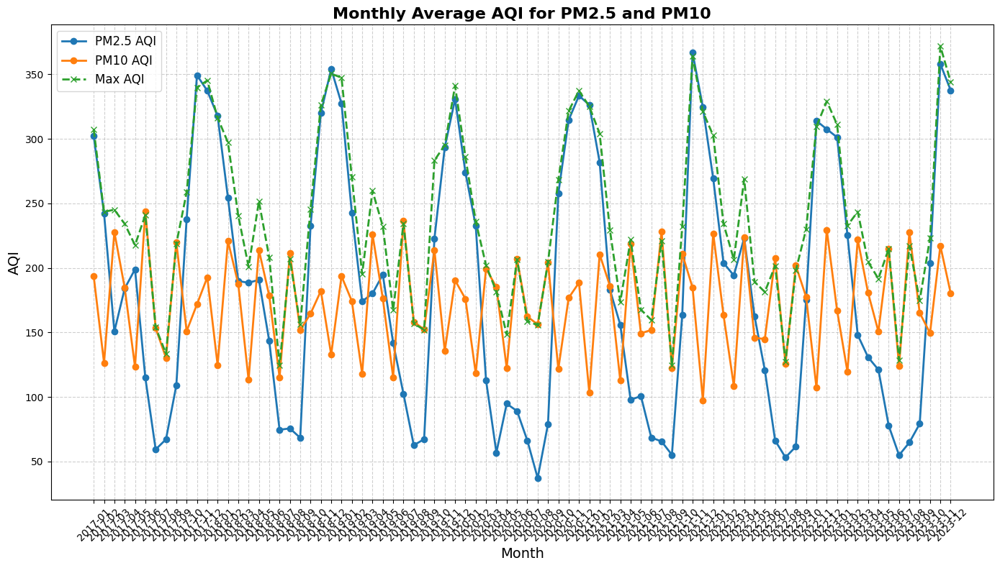

<Figure size 1200x800 with 0 Axes>

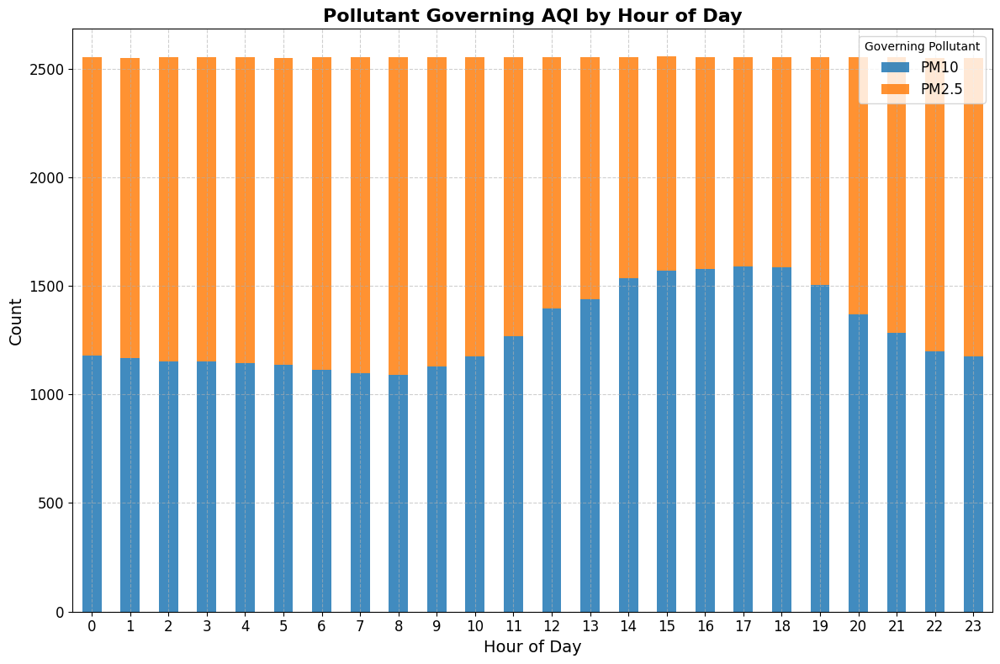

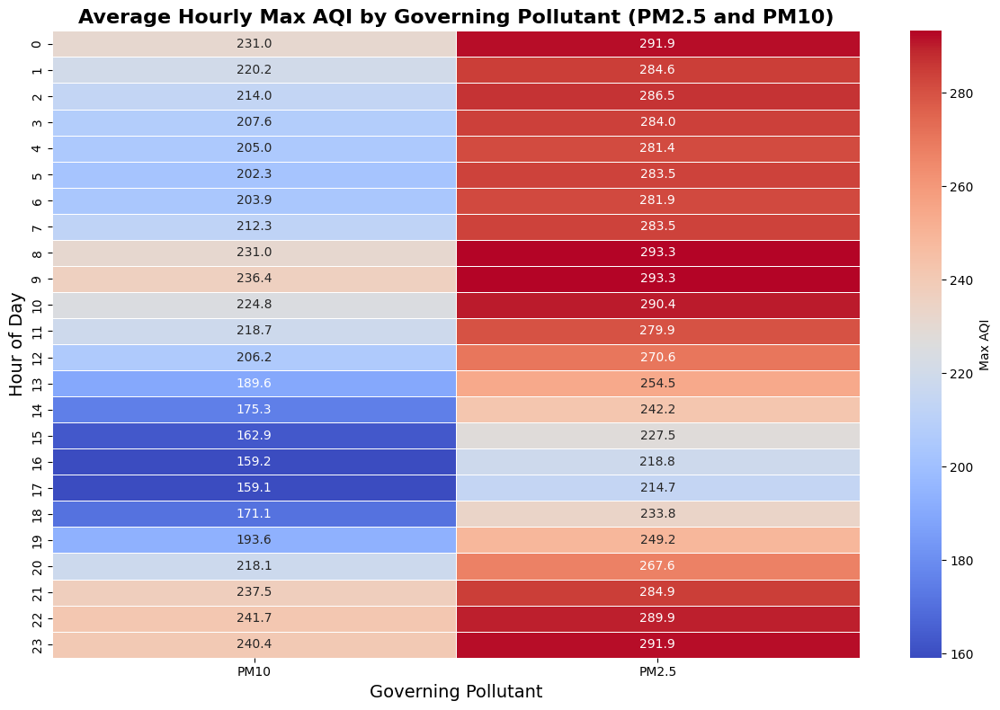

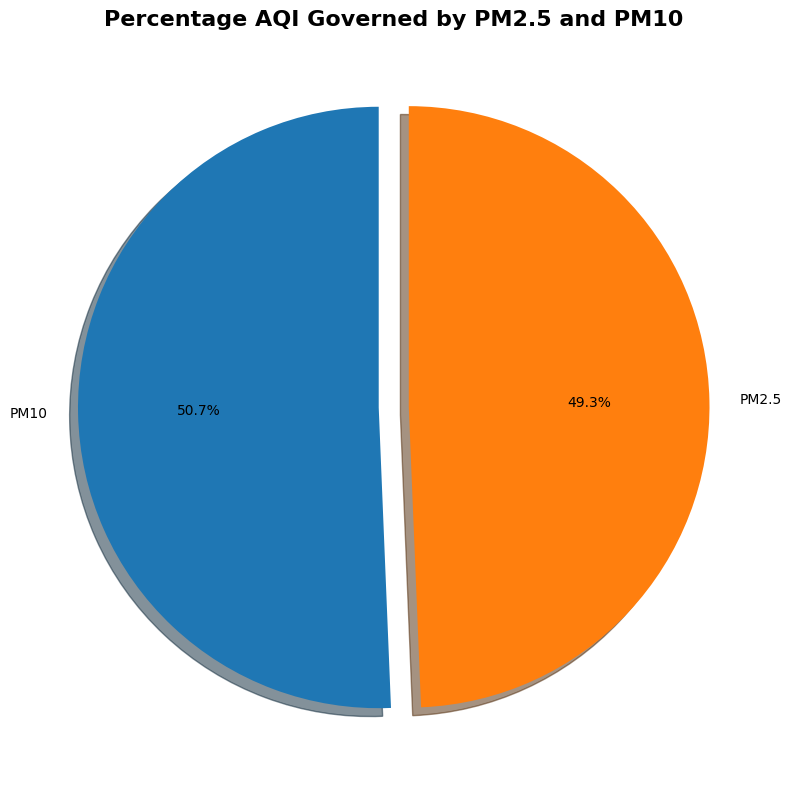

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract Date and Time components
data['Date'] = data['Timestamp'].dt.date
data['Month'] = data['Timestamp'].dt.to_period('M')  # Monthly aggregation
data['Hour'] = data['Timestamp'].dt.hour

# Create a new column that identifies which pollutant governs the AQI (PM2.5 or PM10)
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# Calculate daily and monthly averages for PM2.5 and PM10
daily_avg = data.groupby('Date').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

monthly_avg = data.groupby('Month').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

# Calculate which pollutant governs the AQI at each hour (time of day analysis)
hourly_governing_pollutant = data.groupby('Hour')['Governing_Pollutant'].apply(lambda x: x.value_counts().idxmax())

# --- Enhanced Visualization ---

# 1. Line Plot of Daily Averages of AQI for PM2.5 and PM10
plt.figure(figsize=(14, 8))
plt.plot(daily_avg['Date'], daily_avg['PM2.5_AQI'], label='PM2.5 AQI', color='#1f77b4', linewidth=2, linestyle='-')
plt.plot(daily_avg['Date'], daily_avg['PM10_AQI'], label='PM10 AQI', color='#ff7f0e', linewidth=2, linestyle='-')
plt.plot(daily_avg['Date'], daily_avg['Max_AQI'], label='Max AQI', color='#2ca02c', linewidth=2, linestyle='--')
plt.title('Daily Average AQI for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Date', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 2. Line Plot of Monthly Averages of AQI for PM2.5 and PM10
plt.figure(figsize=(14, 8))
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['PM2.5_AQI'], label='PM2.5 AQI', color='#1f77b4', linewidth=2, marker='o')
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['PM10_AQI'], label='PM10 AQI', color='#ff7f0e', linewidth=2, marker='o')
plt.plot(monthly_avg['Month'].astype(str), monthly_avg['Max_AQI'], label='Max AQI', color='#2ca02c', linewidth=2, linestyle='--', marker='x')
plt.title('Monthly Average AQI for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Month', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 3. Stacked Bar Plot of AQI Governing Pollutant Distribution by Time of Day (Hour)
plt.figure(figsize=(12, 8))
hourly_gov_pollutant_counts = data.groupby('Hour')['Governing_Pollutant'].value_counts().unstack().fillna(0)
hourly_gov_pollutant_counts.plot(kind='bar', stacked=True, figsize=(12, 8), color=['#1f77b4', '#ff7f0e'], alpha=0.85)
plt.title('Pollutant Governing AQI by Hour of Day', fontsize=16, fontweight='bold')
plt.xlabel('Hour of Day', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=0, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Governing Pollutant', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 4. Heatmap of Hourly AQI for each pollutant
plt.figure(figsize=(12, 8))
heatmap_data = data.groupby(['Hour', 'Governing_Pollutant'])['Max_AQI'].mean().unstack()
sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt=".1f", linewidths=0.5, cbar_kws={'label': 'Max AQI'})
plt.title('Average Hourly Max AQI by Governing Pollutant (PM2.5 and PM10)', fontsize=16, fontweight='bold')
plt.xlabel('Governing Pollutant', fontsize=14)
plt.ylabel('Hour of Day', fontsize=14)
plt.tight_layout()
plt.show()

# 5. Enhanced Pie Chart of Overall AQI Governance between PM2.5 and PM10
governed_by_pollutant = data['Governing_Pollutant'].value_counts(normalize=True) * 100
plt.figure(figsize=(8, 8))
plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=['#1f77b4', '#ff7f0e'], startangle=90, explode=(0.05, 0.05), shadow=True)
plt.title('Percentage AQI Governed by PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle
plt.tight_layout()
plt.show()


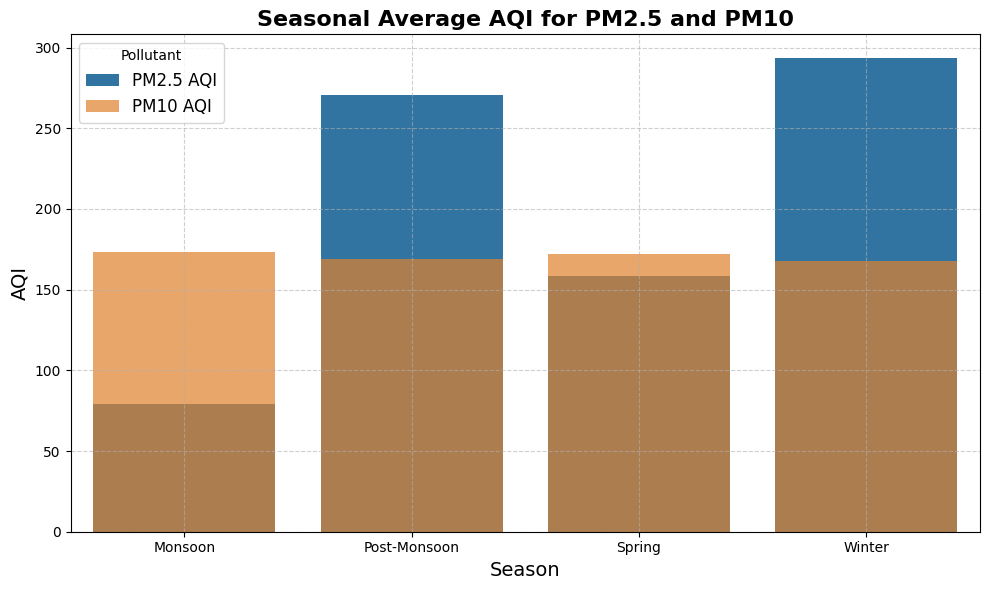

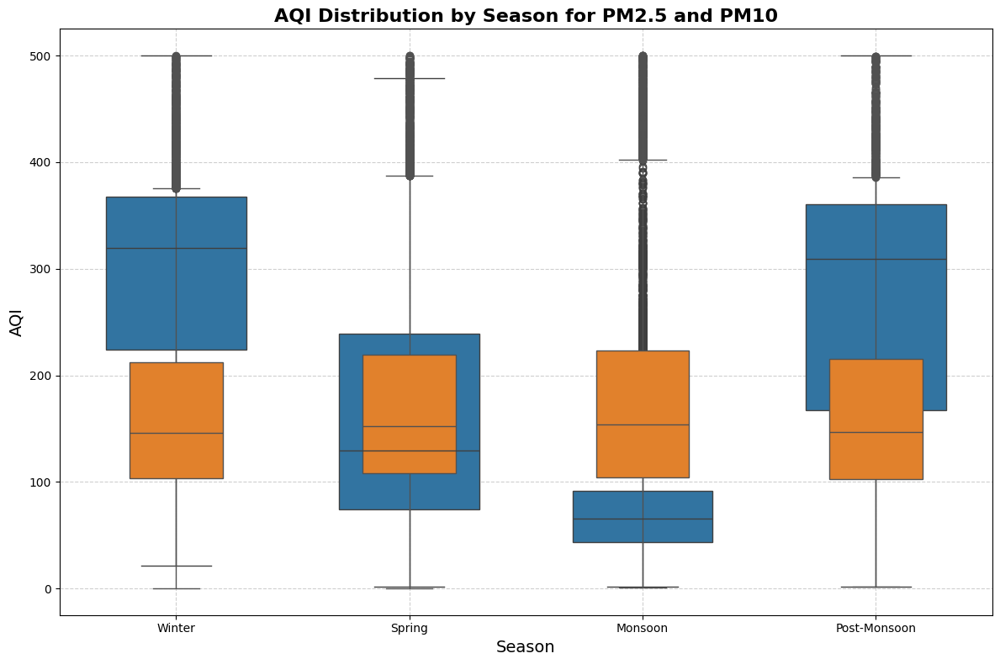

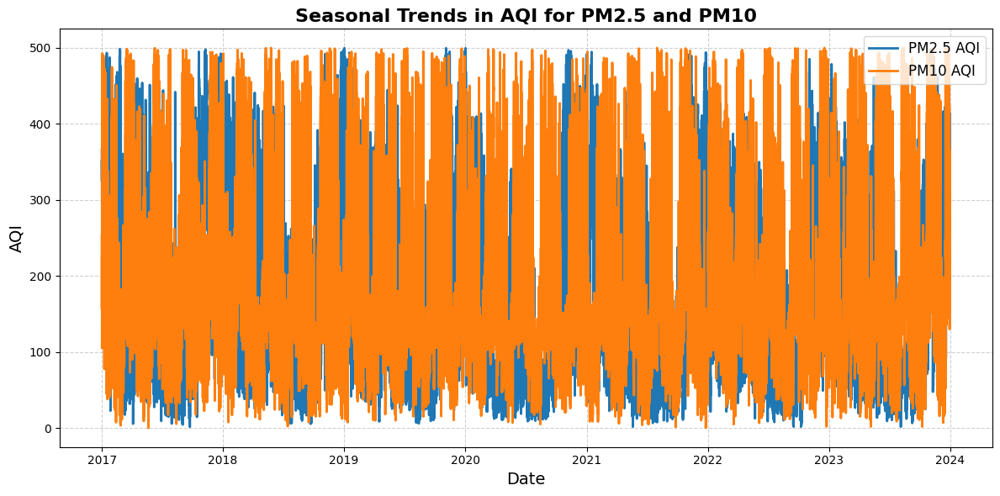

KeyError: 'Governing_Pollutant'

<Figure size 1200x600 with 0 Axes>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract Month and define the seasons
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8, 9]:
        return 'Monsoon'
    elif month in [10, 11]:
        return 'Post-Monsoon'

data['Season'] = data['Timestamp'].dt.month.apply(get_season)

# Calculate seasonal averages for PM2.5 and PM10
seasonal_avg = data.groupby('Season').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

# --- Seasonal Visualization ---

# 1. Bar Plot for Seasonal Average AQI for PM2.5 and PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Season', y='PM2.5_AQI', data=seasonal_avg, color='#1f77b4', label='PM2.5 AQI')
sns.barplot(x='Season', y='PM10_AQI', data=seasonal_avg, color='#ff7f0e', label='PM10 AQI', alpha=0.7)
plt.title('Seasonal Average AQI for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Season', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.legend(title='Pollutant', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 2. Box Plot to Show AQI Distribution by Season for PM2.5 and PM10
plt.figure(figsize=(12, 8))
sns.boxplot(x='Season', y='PM2.5_AQI', data=data, color='#1f77b4', width=0.6)
sns.boxplot(x='Season', y='PM10_AQI', data=data, color='#ff7f0e', width=0.4)
plt.title('AQI Distribution by Season for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Season', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 3. Line Plot to Show Seasonal Trends for PM2.5 and PM10 AQI
plt.figure(figsize=(12, 6))
sns.lineplot(x='Timestamp', y='PM2.5_AQI', data=data, label='PM2.5 AQI', color='#1f77b4', linewidth=2)
sns.lineplot(x='Timestamp', y='PM10_AQI', data=data, label='PM10 AQI', color='#ff7f0e', linewidth=2)
plt.title('Seasonal Trends in AQI for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Date', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 4. Pie Chart to Show Percentage of AQI Governance by Pollutant in Each Season
plt.figure(figsize=(12, 6))
for season in data['Season'].unique():
    season_data = data[data['Season'] == season]
    governed_by_pollutant = season_data['Governing_Pollutant'].value_counts(normalize=True) * 100
    plt.subplot(2, 2, list(data['Season'].unique()).index(season) + 1)
    plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=['#1f77b4', '#ff7f0e'], startangle=90)
    plt.title(f'{season} AQI Governance by Pollutant')
    plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle
plt.tight_layout()
plt.show()


In [ ]:
pip install pandas matplotlib seaborn openpyxl


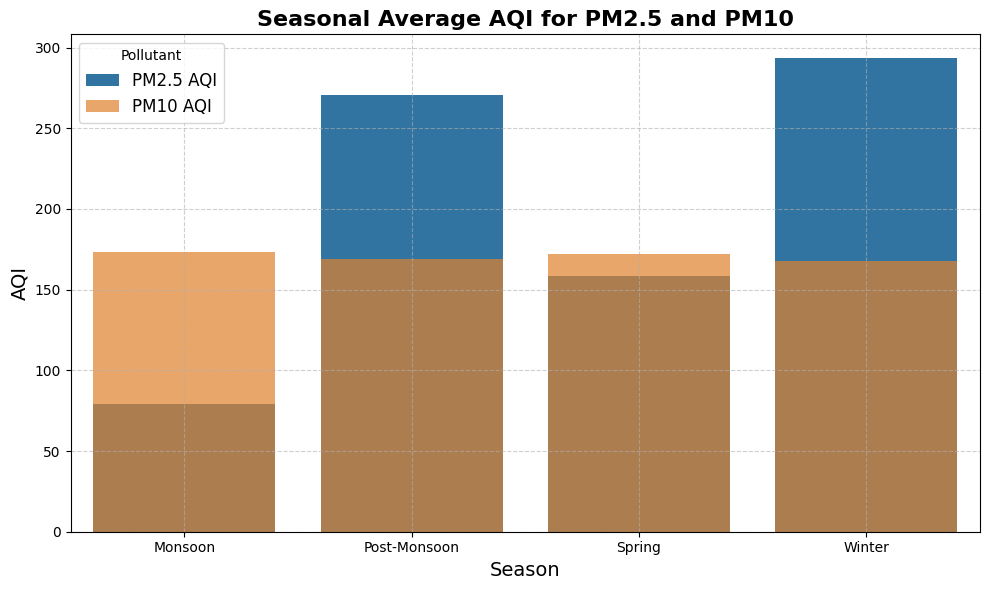

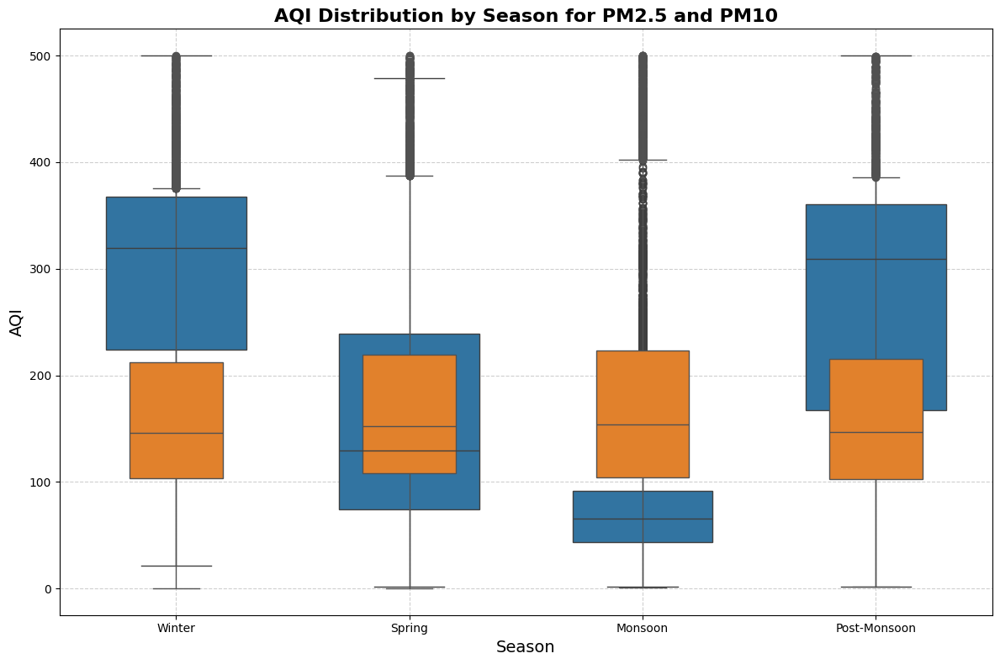

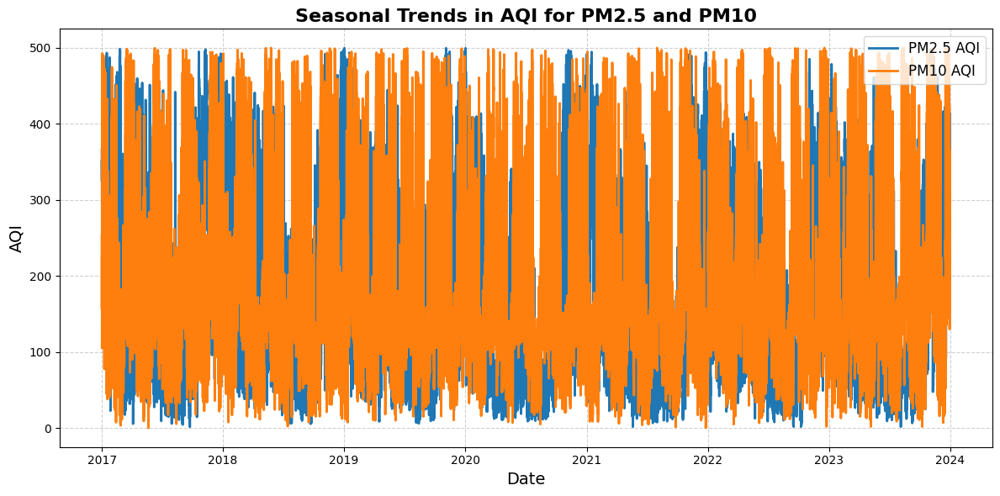

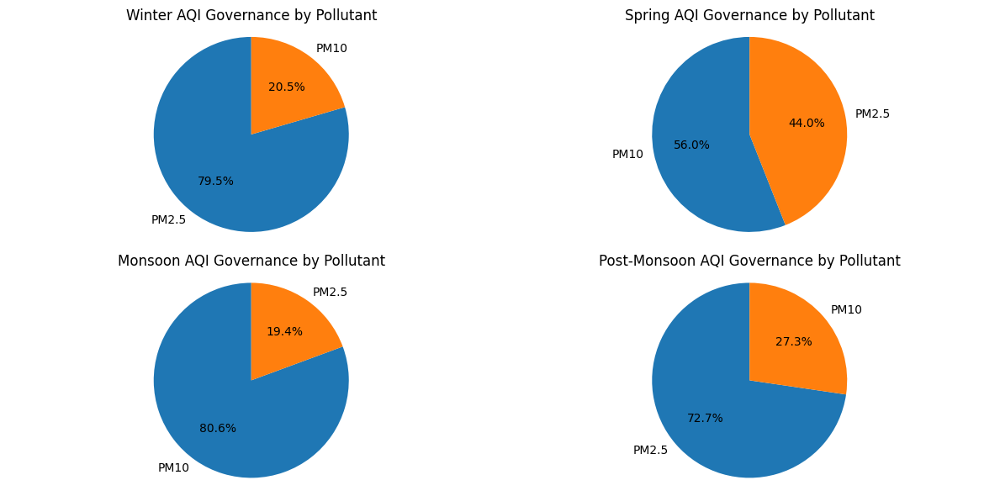

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract Date and Time components
data['Date'] = data['Timestamp'].dt.date
data['Month'] = data['Timestamp'].dt.to_period('M')  # Monthly aggregation
data['Hour'] = data['Timestamp'].dt.hour

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

# Apply the governing_pollutant function to create the 'Governing_Pollutant' column
data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# --- Seasonal Analysis ---

# Define the seasons
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8, 9]:
        return 'Monsoon'
    elif month in [10, 11]:
        return 'Post-Monsoon'

data['Season'] = data['Timestamp'].dt.month.apply(get_season)

# Calculate seasonal averages for PM2.5 and PM10
seasonal_avg = data.groupby('Season').agg({
    'PM2.5_AQI': 'mean',
    'PM10_AQI': 'mean',
    'Max_AQI': 'mean'
}).reset_index()

# --- Seasonal Visualization ---

# 1. Bar Plot for Seasonal Average AQI for PM2.5 and PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Season', y='PM2.5_AQI', data=seasonal_avg, color='#1f77b4', label='PM2.5 AQI')
sns.barplot(x='Season', y='PM10_AQI', data=seasonal_avg, color='#ff7f0e', label='PM10 AQI', alpha=0.7)
plt.title('Seasonal Average AQI for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Season', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.legend(title='Pollutant', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 2. Box Plot to Show AQI Distribution by Season for PM2.5 and PM10
plt.figure(figsize=(12, 8))
sns.boxplot(x='Season', y='PM2.5_AQI', data=data, color='#1f77b4', width=0.6)
sns.boxplot(x='Season', y='PM10_AQI', data=data, color='#ff7f0e', width=0.4)
plt.title('AQI Distribution by Season for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Season', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 3. Line Plot to Show Seasonal Trends for PM2.5 and PM10 AQI
plt.figure(figsize=(12, 6))
sns.lineplot(x='Timestamp', y='PM2.5_AQI', data=data, label='PM2.5 AQI', color='#1f77b4', linewidth=2)
sns.lineplot(x='Timestamp', y='PM10_AQI', data=data, label='PM10 AQI', color='#ff7f0e', linewidth=2)
plt.title('Seasonal Trends in AQI for PM2.5 and PM10', fontsize=16, fontweight='bold')
plt.xlabel('Date', fontsize=14)
plt.ylabel('AQI', fontsize=14)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

# 4. Pie Chart to Show Percentage of AQI Governance by Pollutant in Each Season
plt.figure(figsize=(12, 6))
for season in data['Season'].unique():
    season_data = data[data['Season'] == season]
    governed_by_pollutant = season_data['Governing_Pollutant'].value_counts(normalize=True) * 100
    plt.subplot(2, 2, list(data['Season'].unique()).index(season) + 1)
    plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=['#1f77b4', '#ff7f0e'], startangle=90)
    plt.title(f'{season} AQI Governance by Pollutant')
    plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle
plt.tight_layout()
plt.show()


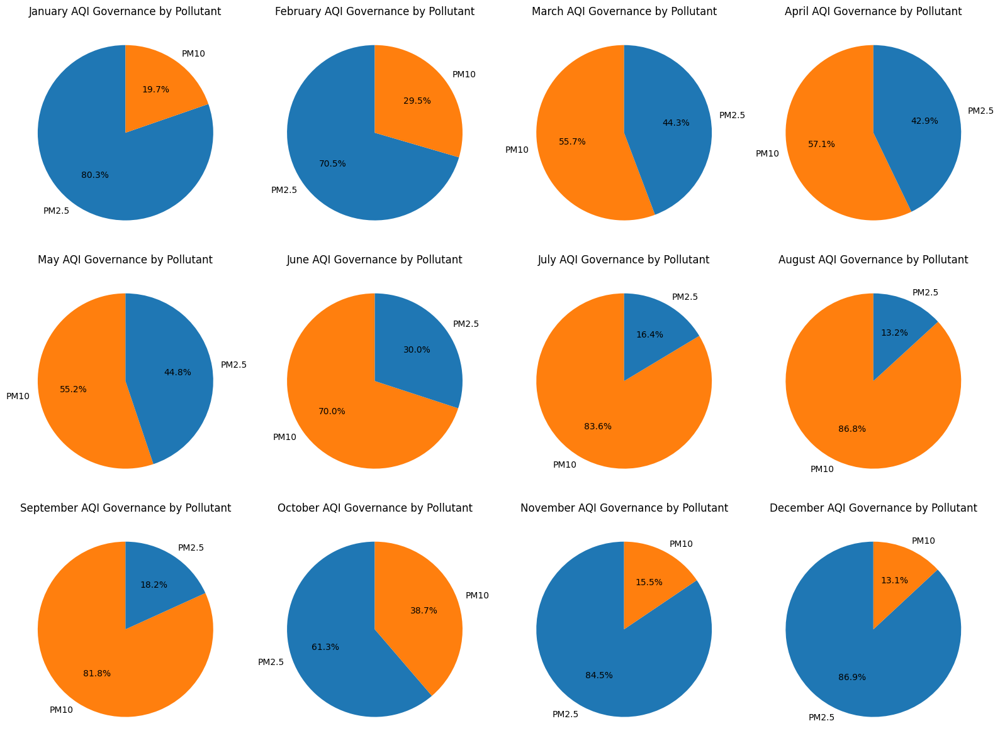

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract Month and Year
data['Month'] = data['Timestamp'].dt.strftime('%B')  # Get month name (January, February, etc.)
data['Year'] = data['Timestamp'].dt.year

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

# Apply the governing_pollutant function to create the 'Governing_Pollutant' column
data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# --- Monthly Pie Charts ---

# Define consistent colors for PM2.5 and PM10
colors_dict = {
    'PM2.5': '#1f77b4',  # Blue color for PM2.5
    'PM10': '#ff7f0e'    # Orange color for PM10
}

# Plot pie chart for each month
plt.figure(figsize=(16, 12))

for i, month in enumerate(data['Month'].unique()):
    month_data = data[data['Month'] == month]
    governed_by_pollutant = month_data['Governing_Pollutant'].value_counts(normalize=True) * 100

    # Get colors for the pie chart based on the pollutants in the current month
    colors = [colors_dict[pollutant] for pollutant in governed_by_pollutant.index]

    # Create a pie chart for each month
    plt.subplot(3, 4, i + 1)  # Create a 3x4 grid of subplots
    plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=colors, startangle=90)
    plt.title(f'{month} AQI Governance by Pollutant')
    plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle

# Adjust layout
plt.tight_layout()
plt.show()


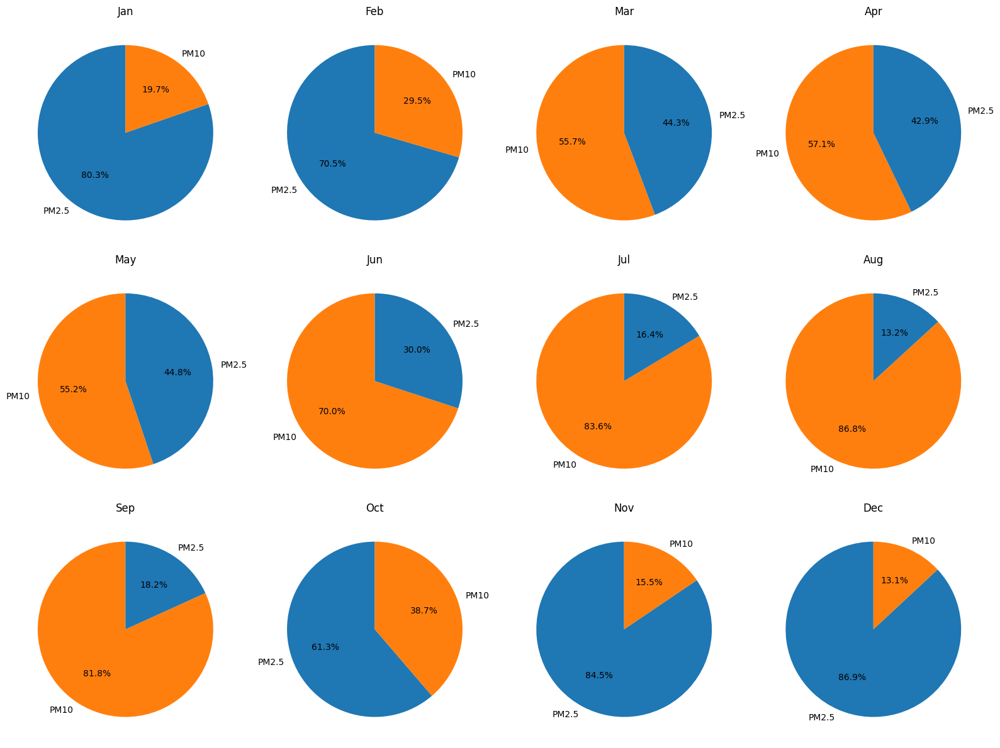

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract abbreviated month names
data['Month'] = data['Timestamp'].dt.strftime('%b')  # Abbreviated month names (e.g., Jan, Feb, etc.)
data['Year'] = data['Timestamp'].dt.year

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

# Apply the governing_pollutant function to create the 'Governing_Pollutant' column
data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# --- Monthly Pie Charts ---

# Define consistent colors for PM2.5 and PM10
colors_dict = {
    'PM2.5': '#1f77b4',  # Blue color for PM2.5
    'PM10': '#ff7f0e'    # Orange color for PM10
}

# Plot pie chart for each month
plt.figure(figsize=(16, 12))

for i, month in enumerate(data['Month'].unique()):
    month_data = data[data['Month'] == month]
    governed_by_pollutant = month_data['Governing_Pollutant'].value_counts(normalize=True) * 100

    # Get colors for the pie chart based on the pollutants in the current month
    colors = [colors_dict[pollutant] for pollutant in governed_by_pollutant.index]

    # Create a pie chart for each month
    plt.subplot(3, 4, i + 1)  # Create a 3x4 grid of subplots
    plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%', colors=colors, startangle=90)
    plt.title(month, fontsize=12)  # Display abbreviated month name (Jan, Feb, etc.) as the title
    plt.axis('equal')  # Equal aspect ratio ensures the pie is drawn as a circle

# Adjust layout
plt.tight_layout()
plt.show()


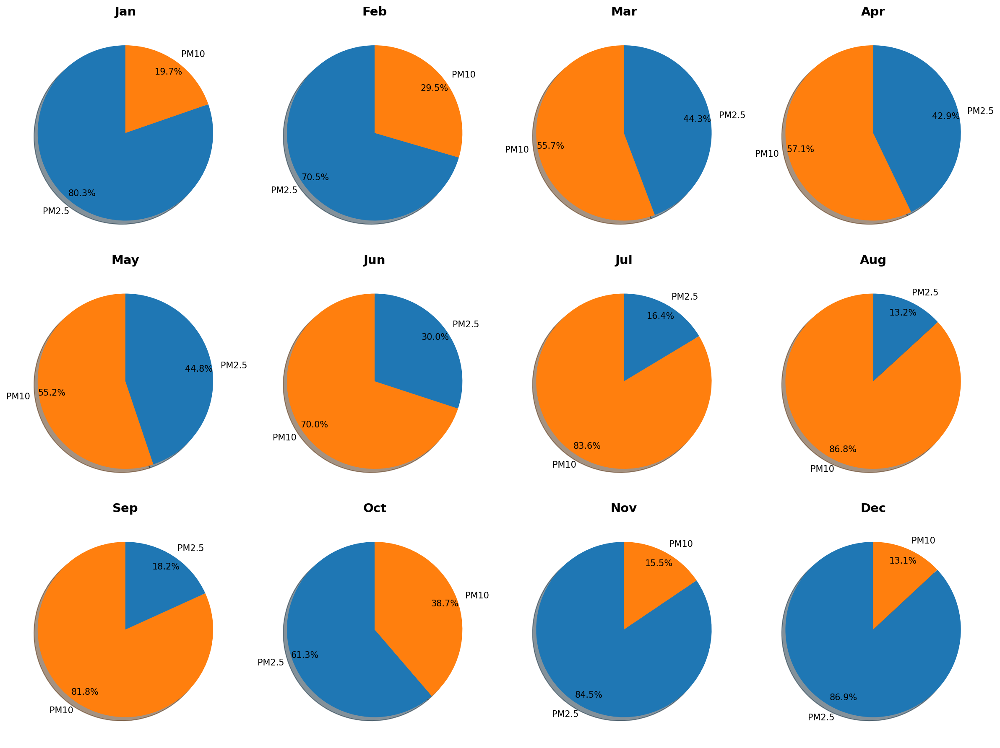

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract abbreviated month names
data['Month'] = data['Timestamp'].dt.strftime('%b')  # Abbreviated month names (e.g., Jan, Feb, etc.)
data['Year'] = data['Timestamp'].dt.year

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

# Apply the governing_pollutant function to create the 'Governing_Pollutant' column
data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# --- Monthly Pie Charts ---

# Define consistent colors for PM2.5 and PM10
colors_dict = {
    'PM2.5': '#1f77b4',  # Blue color for PM2.5
    'PM10': '#ff7f0e'    # Orange color for PM10
}

# Set up the figure size and DPI for higher quality
plt.figure(figsize=(16, 12), dpi=150)

# Loop through each month and generate a pie chart
for i, month in enumerate(data['Month'].unique()):
    month_data = data[data['Month'] == month]
    governed_by_pollutant = month_data['Governing_Pollutant'].value_counts(normalize=True) * 100

    # Get colors for the pie chart based on the pollutants in the current month
    colors = [colors_dict[pollutant] for pollutant in governed_by_pollutant.index]

    # Create a pie chart for each month
    plt.subplot(3, 4, i + 1)  # Create a 3x4 grid of subplots
    wedges, texts, autotexts = plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%',
                                       colors=colors, startangle=90, shadow=True, pctdistance=0.85)

    # Set font size for percentage labels
    for text in autotexts:
        text.set_fontsize(10)

    # Display abbreviated month name (Jan, Feb, etc.) as the title
    plt.title(month, fontsize=14, weight='bold')

    # Ensure the pie is drawn as a circle (equal aspect ratio)
    plt.axis('equal')

# Adjust the layout for better spacing between subplots
plt.tight_layout()

# Display the enhanced pie charts
plt.show()


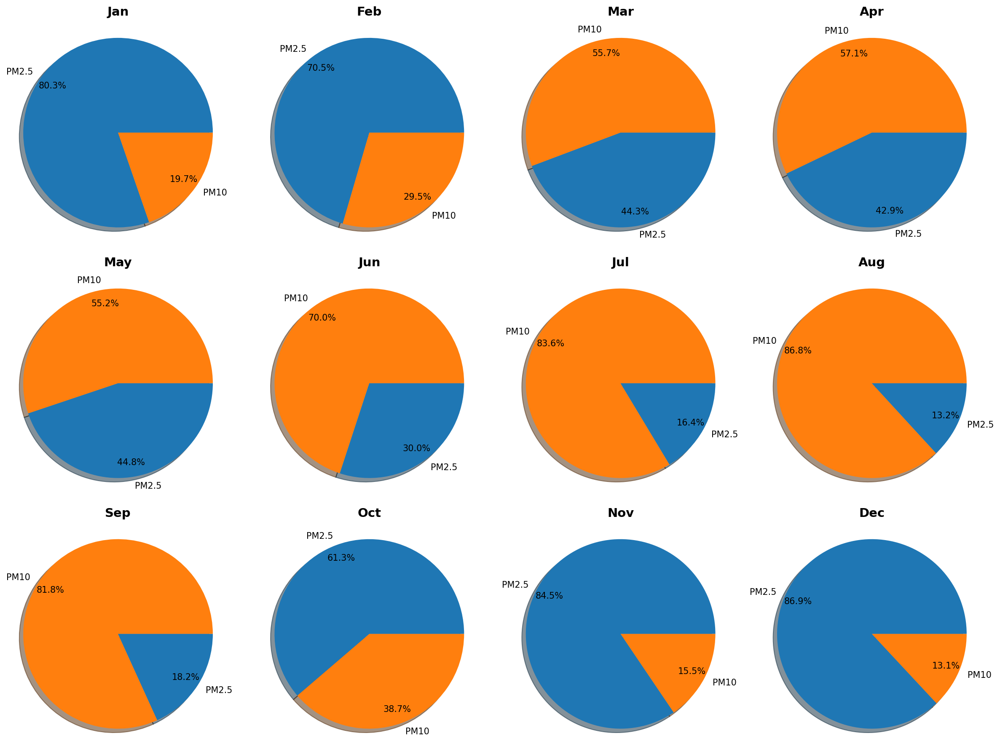

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract abbreviated month names
data['Month'] = data['Timestamp'].dt.strftime('%b')  # Abbreviated month names (e.g., Jan, Feb, etc.)
data['Year'] = data['Timestamp'].dt.year

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

# Apply the governing_pollutant function to create the 'Governing_Pollutant' column
data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# --- Monthly Pie Charts ---

# Define consistent colors for PM2.5 and PM10
colors_dict = {
    'PM2.5': '#1f77b4',  # Blue color for PM2.5
    'PM10': '#ff7f0e'    # Orange color for PM10
}

# Set up the figure size and DPI for higher quality
plt.figure(figsize=(16, 12), dpi=150)

# Loop through each month and generate a pie chart
for i, month in enumerate(data['Month'].unique()):
    month_data = data[data['Month'] == month]
    governed_by_pollutant = month_data['Governing_Pollutant'].value_counts(normalize=True) * 100

    # Get colors for the pie chart based on the pollutants in the current month
    colors = [colors_dict[pollutant] for pollutant in governed_by_pollutant.index]

    # Set startangle to ensure PM10 is on the right side
    if 'PM10' in governed_by_pollutant.index:
        start_angle = 0  # Start PM10 at the right side
    else:
        start_angle = 90  # Default start for PM2.5

    # Create a pie chart for each month
    plt.subplot(3, 4, i + 1)  # Create a 3x4 grid of subplots
    wedges, texts, autotexts = plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%',
                                       colors=colors, startangle=start_angle, shadow=True, pctdistance=0.85)

    # Set font size for percentage labels
    for text in autotexts:
        text.set_fontsize(10)

    # Display abbreviated month name (Jan, Feb, etc.) as the title
    plt.title(month, fontsize=14, weight='bold')

    # Ensure the pie is drawn as a circle (equal aspect ratio)
    plt.axis('equal')

# Adjust the layout for better spacing between subplots
plt.tight_layout()

# Display the enhanced pie charts
plt.show()


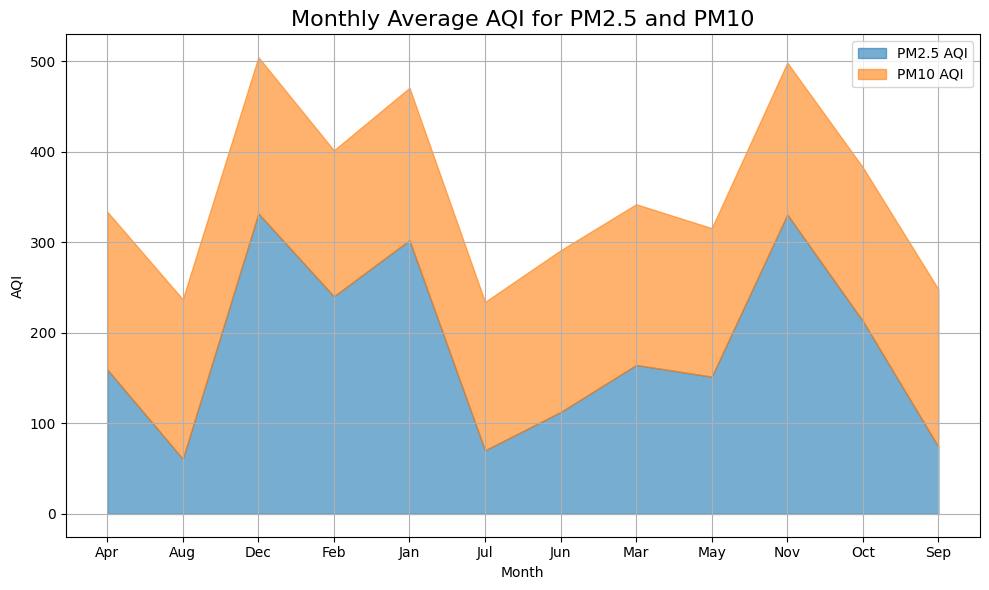

In [ ]:
# Group the data by month and calculate the average AQI for each month
monthly_avg = data.groupby('Month').agg({'PM2.5_AQI': 'mean', 'PM10_AQI': 'mean'}).reset_index()

# Plot a stacked area chart
plt.figure(figsize=(10, 6))
plt.fill_between(monthly_avg['Month'], monthly_avg['PM2.5_AQI'], label='PM2.5 AQI', color='#1f77b4', alpha=0.6)
plt.fill_between(monthly_avg['Month'], monthly_avg['PM2.5_AQI'], monthly_avg['PM2.5_AQI'] + monthly_avg['PM10_AQI'], label='PM10 AQI', color='#ff7f0e', alpha=0.6)
plt.title('Monthly Average AQI for PM2.5 and PM10', fontsize=16)
plt.xlabel('Month')
plt.ylabel('AQI')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


['Jan' 'Feb' 'Mar' 'Apr' 'May' 'Jun' 'Jul' 'Aug' 'Sep' 'Oct' 'Nov' 'Dec']


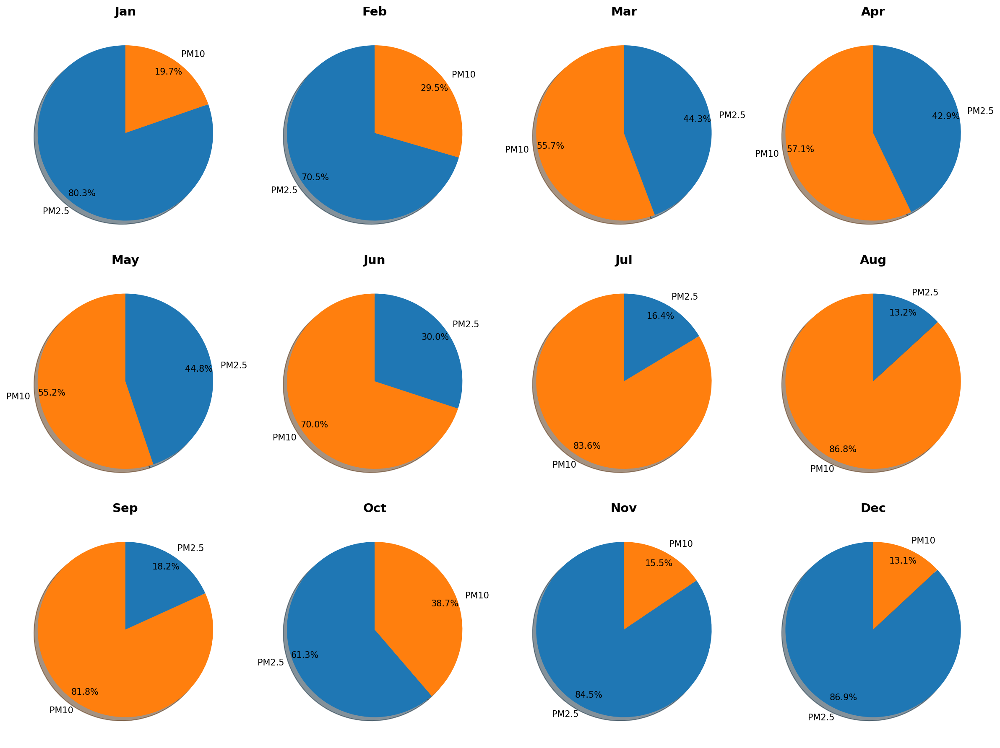

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Extract abbreviated month names and ensure no duplicated strings
data['Month'] = data['Timestamp'].dt.strftime('%b')  # Extract abbreviated month names (Jan, Feb, etc.)

# Check for any non-numeric values in the data (like duplicated month strings)
# Print the unique values in the 'Month' column to debug
print(data['Month'].unique())  # Make sure only month abbreviations are here (Jan, Feb, etc.)

# Check for issues where string concatenation or repetition might have occurred
# You can filter out invalid entries using a simple condition
valid_months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
data = data[data['Month'].isin(valid_months)]  # Filter out invalid months if any exist

# Create a new column that identifies which pollutant governs the AQI
def governing_pollutant(row):
    if row['PM2.5_AQI'] == row['Max_AQI']:
        return 'PM2.5'
    elif row['PM10_AQI'] == row['Max_AQI']:
        return 'PM10'
    return None

# Apply the governing_pollutant function to create the 'Governing_Pollutant' column
data['Governing_Pollutant'] = data.apply(governing_pollutant, axis=1)

# --- Monthly Pie Charts ---

# Define consistent colors for PM2.5 and PM10
colors_dict = {
    'PM2.5': '#1f77b4',  # Blue color for PM2.5
    'PM10': '#ff7f0e'    # Orange color for PM10
}

# Set up the figure size and DPI for higher quality
plt.figure(figsize=(16, 12), dpi=150)

# Loop through each month and generate a pie chart
for i, month in enumerate(data['Month'].unique()):
    month_data = data[data['Month'] == month]
    governed_by_pollutant = month_data['Governing_Pollutant'].value_counts(normalize=True) * 100

    # Get colors for the pie chart based on the pollutants in the current month
    colors = [colors_dict[pollutant] for pollutant in governed_by_pollutant.index]

    # Create a pie chart for each month
    plt.subplot(3, 4, i + 1)  # Create a 3x4 grid of subplots
    wedges, texts, autotexts = plt.pie(governed_by_pollutant, labels=governed_by_pollutant.index, autopct='%1.1f%%',
                                       colors=colors, startangle=90, shadow=True, pctdistance=0.85)

    # Set font size for percentage labels
    for text in autotexts:
        text.set_fontsize(10)

    # Display abbreviated month name (Jan, Feb, etc.) as the title
    plt.title(month, fontsize=14, weight='bold')

    # Ensure the pie is drawn as a circle (equal aspect ratio)
    plt.axis('equal')

# Adjust the layout for better spacing between subplots
plt.tight_layout()

# Display the enhanced pie charts
plt.show()


<ipython-input-41-1725c4bbc234>:19: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_ratio = data.resample('M', on='Timestamp')['PM2.5_PM10_Ratio'].mean()


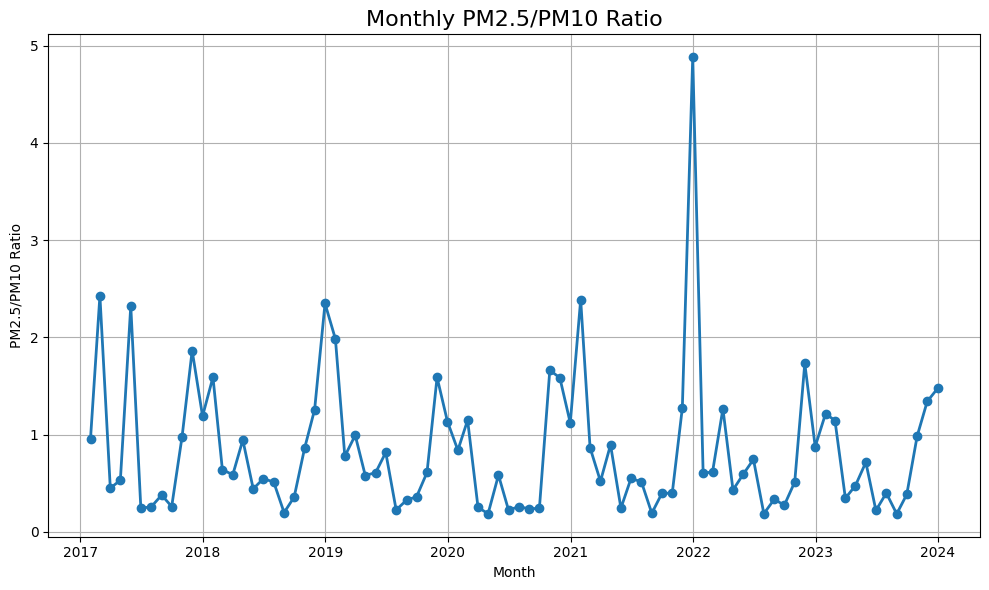

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset (replace with the correct file path)
file_path = '/content/Book5.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert Timestamp to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')

# Check if PM2.5 and PM10 columns are available
if 'Avg_PM2.5' in data.columns and 'Avg_PM10 (µg/m³)' in data.columns:
    # Calculate PM2.5/PM10 ratio
    data['PM2.5_PM10_Ratio'] = data['Avg_PM2.5'] / data['Avg_PM10 (µg/m³)']
else:
    raise KeyError("'Avg_PM2.5' or 'Avg_PM10 (µg/m³)' column not found in the dataset.")

# Resample data to calculate the monthly average PM2.5/PM10 ratio
monthly_ratio = data.resample('M', on='Timestamp')['PM2.5_PM10_Ratio'].mean()

# Plot the monthly PM2.5/PM10 ratio
plt.figure(figsize=(10, 6))
plt.plot(monthly_ratio.index, monthly_ratio.values, marker='o', color='#1f77b4', linewidth=2)
plt.title('Monthly PM2.5/PM10 Ratio', fontsize=16)
plt.xlabel('Month')
plt.ylabel('PM2.5/PM10 Ratio')
plt.grid(True)
plt.tight_layout()
plt.show()


<ipython-input-42-eb03bb0768db>:17: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg_pm25 = data.resample('M', on='Timestamp')['Avg_PM2.5'].mean()


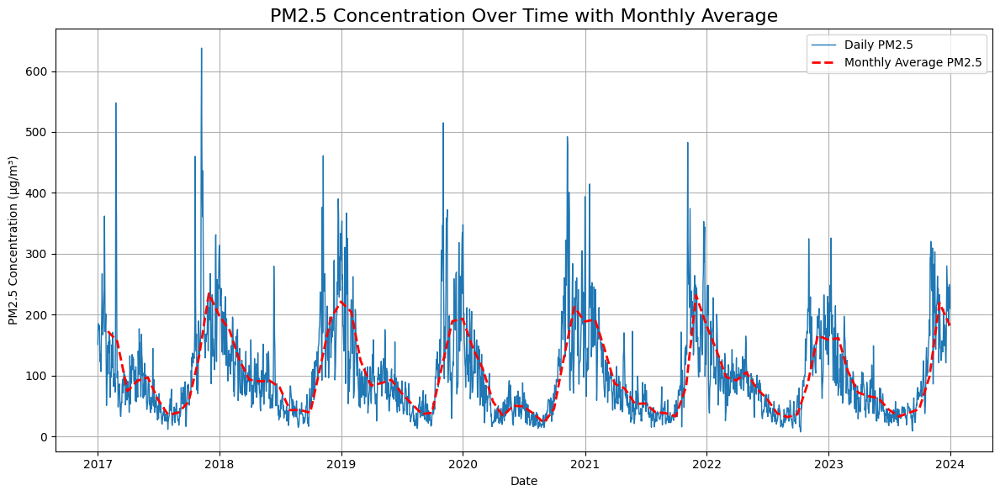

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset (replace with the correct file path)
file_path = 'aqi_calculated_with_interpolation.xlsx'  # Adjust path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime if it's not already
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')

# Filter for PM2.5 data
if 'Avg_PM2.5' in data.columns:
    # Resample data to daily averages for better visualization
    daily_avg_pm25 = data.resample('D', on='Timestamp')['Avg_PM2.5'].mean()

    # Resample data to calculate monthly average PM2.5
    monthly_avg_pm25 = data.resample('M', on='Timestamp')['Avg_PM2.5'].mean()
else:
    raise KeyError("'Avg_PM2.5' column not found in the dataset.")

# Plot the PM2.5 data with timestamp variation
plt.figure(figsize=(12, 6))

# Plot daily PM2.5 variation
plt.plot(daily_avg_pm25.index, daily_avg_pm25.values, label='Daily PM2.5', color='#1f77b4', linewidth=1)

# Plot monthly average PM2.5
plt.plot(monthly_avg_pm25.index, monthly_avg_pm25.values, label='Monthly Average PM2.5', color='red', linestyle='--', linewidth=2)

# Add labels and title
plt.title('PM2.5 Concentration Over Time with Monthly Average', fontsize=16)
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()

# Display grid and plot
plt.grid(True)
plt.tight_layout()
plt.show()


Linear Regression:
  R² Score: 0.9508
  Mean Squared Error: 338.2994
  Mean Absolute Error: 10.9001
  Root Mean Squared Error: 18.3929

Lasso Regression:
  R² Score: 0.9461
  Mean Squared Error: 370.4689
  Mean Absolute Error: 11.6107
  Root Mean Squared Error: 19.2476

Ridge Regression:
  R² Score: 0.9508
  Mean Squared Error: 338.3123
  Mean Absolute Error: 10.9013
  Root Mean Squared Error: 18.3933

Support Vector Regressor:
  R² Score: 0.8478
  Mean Squared Error: 1045.6989
  Mean Absolute Error: 14.4112
  Root Mean Squared Error: 32.3373

Random Forest Regressor:
  R² Score: 0.9632
  Mean Squared Error: 252.8634
  Mean Absolute Error: 9.1737
  Root Mean Squared Error: 15.9017

Gradient Boosting Regressor:
  R² Score: 0.9579
  Mean Squared Error: 289.2049
  Mean Absolute Error: 10.3087
  Root Mean Squared Error: 17.0060

K-Nearest Neighbors:
  R² Score: 0.9379
  Mean Squared Error: 427.0025
  Mean Absolute Error: 12.6183
  Root Mean Squared Error: 20.6640



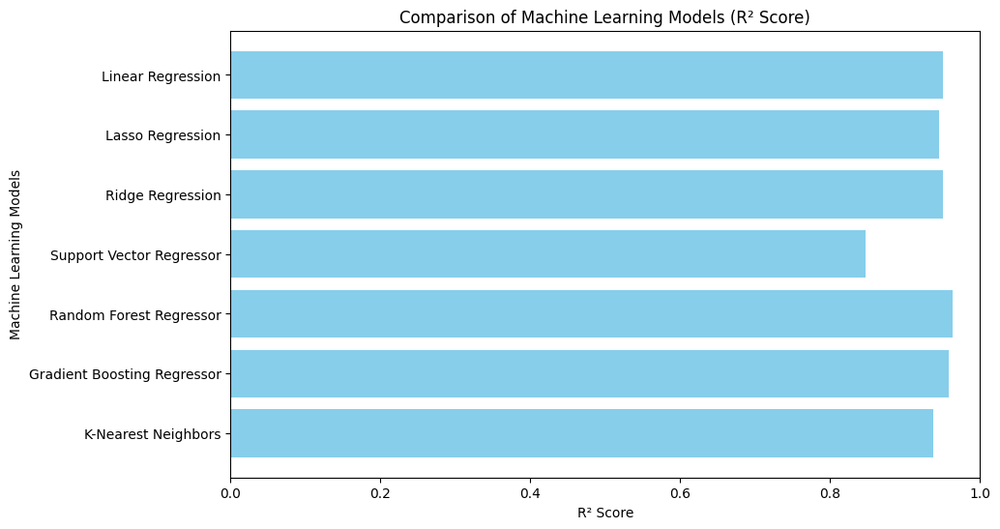

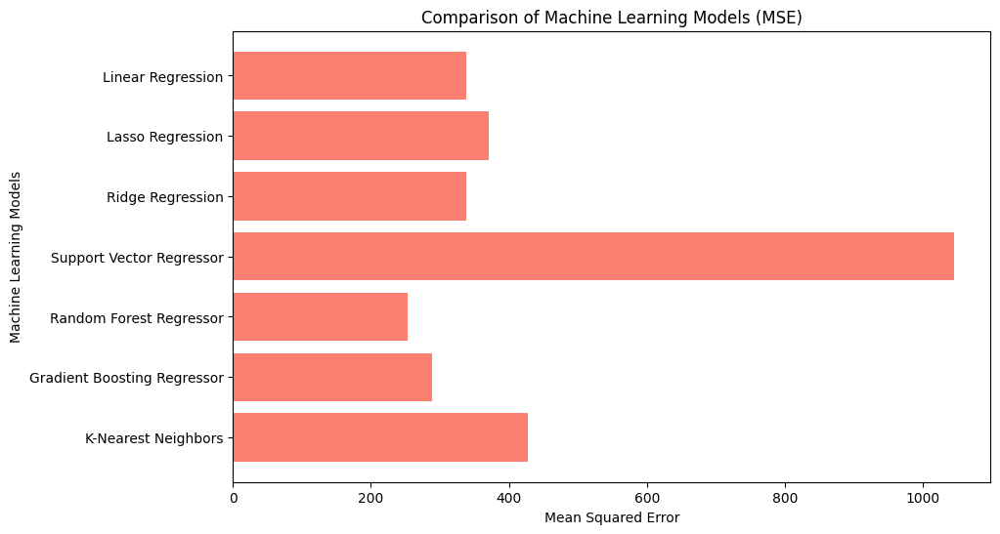

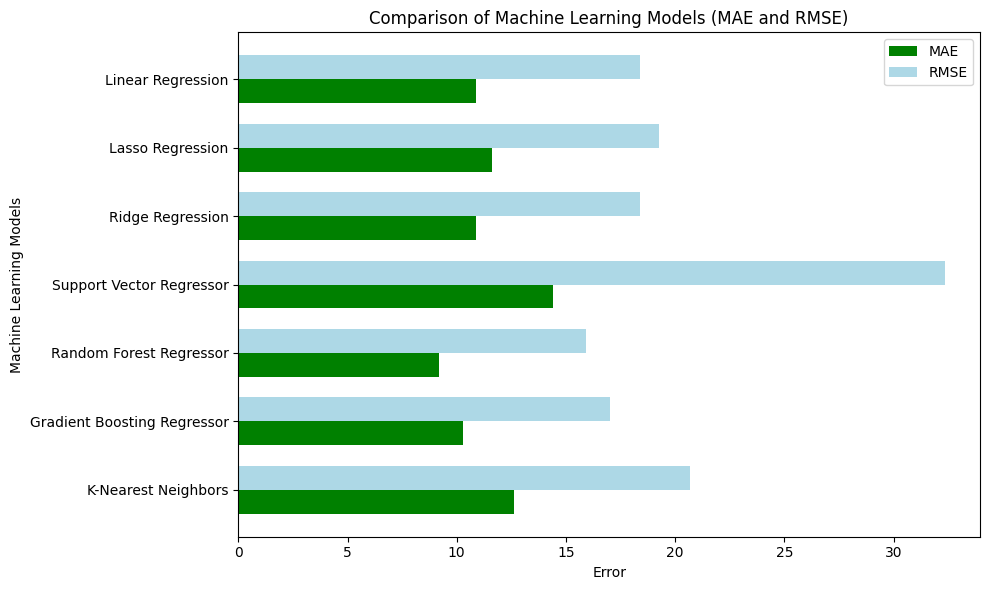

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Load the dataset
file_path = '/content/Book5.xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Extract relevant datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Apply linear interpolation to fill missing values in numeric columns
numeric_cols = data.select_dtypes(include=[np.number]).columns
data[numeric_cols] = data[numeric_cols].interpolate(method='linear')

# Create lag features for PM2.5
data['PM2.5_Lag1'] = data['Avg_PM2.5'].shift(1)
data['PM2.5_Lag2'] = data['Avg_PM2.5'].shift(2)

# Create rolling window features for PM2.5 (7-day rolling mean and std)
data['PM2.5_Rolling_Mean7'] = data['Avg_PM2.5'].rolling(window=7).mean()
data['PM2.5_Rolling_Std7'] = data['Avg_PM2.5'].rolling(window=7).std()

# Drop rows with NaN values (due to lag/rolling features)
data = data.dropna()

# Define features (X) and target variable (y)
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)',
          'PM2.5_Lag1', 'PM2.5_Lag2', 'PM2.5_Rolling_Mean7', 'PM2.5_Rolling_Std7']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define models
models = {
    'Linear Regression': LinearRegression(),
    'Lasso Regression': Lasso(),
    'Ridge Regression': Ridge(),
    'Support Vector Regressor': SVR(),
    'Random Forest Regressor': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting Regressor': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'K-Nearest Neighbors': KNeighborsRegressor(n_neighbors=5)
}

# Train and evaluate models
performance = {}
for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)

    # Calculate R², MSE, MAE, and RMSE
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)

    performance[name] = {'R²': r2, 'MSE': mse, 'MAE': mae, 'RMSE': rmse}

# Display performance metrics for each model
for model_name, metrics in performance.items():
    print(f"{model_name}:")
    print(f"  R² Score: {metrics['R²']:.4f}")
    print(f"  Mean Squared Error: {metrics['MSE']:.4f}")
    print(f"  Mean Absolute Error: {metrics['MAE']:.4f}")
    print(f"  Root Mean Squared Error: {metrics['RMSE']:.4f}")
    print()

# Prepare data for plotting (reverse the order for visualization)
model_names = list(performance.keys())[::-1]
r2_values = [metrics['R²'] for metrics in performance.values()][::-1]
mse_values = [metrics['MSE'] for metrics in performance.values()][::-1]
mae_values = [metrics['MAE'] for metrics in performance.values()][::-1]
rmse_values = [metrics['RMSE'] for metrics in performance.values()][::-1]

# Plot R² scores
plt.figure(figsize=(10, 6))
plt.barh(model_names, r2_values, color='skyblue')
plt.xlabel('R² Score')
plt.ylabel('Machine Learning Models')
plt.title('Comparison of Machine Learning Models (R² Score)')
plt.xlim(0, 1)
plt.show()

# Plot MSE scores
plt.figure(figsize=(10, 6))
plt.barh(model_names, mse_values, color='salmon')
plt.xlabel('Mean Squared Error')
plt.ylabel('Machine Learning Models')
plt.title('Comparison of Machine Learning Models (MSE)')
plt.show()

# Plot MAE and RMSE scores
width = 0.35
x = np.arange(len(model_names))

fig, ax = plt.subplots(figsize=(10, 6))
bars_mae = ax.barh(x - width / 2, mae_values, width, label='MAE', color='green')
bars_rmse = ax.barh(x + width / 2, rmse_values, width, label='RMSE', color='lightblue')

ax.set_xlabel('Error')
ax.set_ylabel('Machine Learning Models')
ax.set_title('Comparison of Machine Learning Models (MAE and RMSE)')
ax.set_yticks(x)
ax.set_yticklabels(model_names)
ax.legend()

plt.tight_layout()
plt.show()


In [ ]:
from sklearn.tree import DecisionTreeRegressor
from xgboost import XGBRegressor
from sklearn.ensemble import AdaBoostRegressor, ExtraTreesRegressor

# Define additional models
additional_models = {
    'Decision Tree Regressor': DecisionTreeRegressor(random_state=42),
    'XGBoost Regressor': XGBRegressor(n_estimators=100, random_state=42),
    'AdaBoost Regressor': AdaBoostRegressor(n_estimators=100, random_state=42),
    'Extra Trees Regressor': ExtraTreesRegressor(n_estimators=100, random_state=42)
}

# Combine with existing models
models.update(additional_models)

# Train and evaluate all models
performance = {}
for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)

    # Calculate R², MSE, MAE, and RMSE
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)

    performance[name] = {'R²': r2, 'MSE': mse, 'MAE': mae, 'RMSE': rmse}

# Print performance metrics for all models
print("Performance Metrics for Each Model:")
for model_name, metrics in performance.items():
    print(f"{model_name}:")
    print(f"  R² Score: {metrics['R²']:.4f}")
    print(f"  Mean Squared Error: {metrics['MSE']:.4f}")
    print(f"  Mean Absolute Error: {metrics['MAE']:.4f}")
    print(f"  Root Mean Squared Error: {metrics['RMSE']:.4f}")
    print()

# Proceed with visualizations as before


Performance Metrics for Each Model:
Linear Regression:
  R² Score: 0.9508
  Mean Squared Error: 338.2994
  Mean Absolute Error: 10.9001
  Root Mean Squared Error: 18.3929

Lasso Regression:
  R² Score: 0.9461
  Mean Squared Error: 370.4689
  Mean Absolute Error: 11.6107
  Root Mean Squared Error: 19.2476

Ridge Regression:
  R² Score: 0.9508
  Mean Squared Error: 338.3123
  Mean Absolute Error: 10.9013
  Root Mean Squared Error: 18.3933

Support Vector Regressor:
  R² Score: 0.8478
  Mean Squared Error: 1045.6989
  Mean Absolute Error: 14.4112
  Root Mean Squared Error: 32.3373

Random Forest Regressor:
  R² Score: 0.9632
  Mean Squared Error: 252.8634
  Mean Absolute Error: 9.1737
  Root Mean Squared Error: 15.9017

Gradient Boosting Regressor:
  R² Score: 0.9579
  Mean Squared Error: 289.2049
  Mean Absolute Error: 10.3087
  Root Mean Squared Error: 17.0060

K-Nearest Neighbors:
  R² Score: 0.9379
  Mean Squared Error: 427.0025
  Mean Absolute Error: 12.6183
  Root Mean Squared Error

R² Score: 0.8713
Mean Squared Error: 945.5694
Root Mean Squared Error: 30.7501


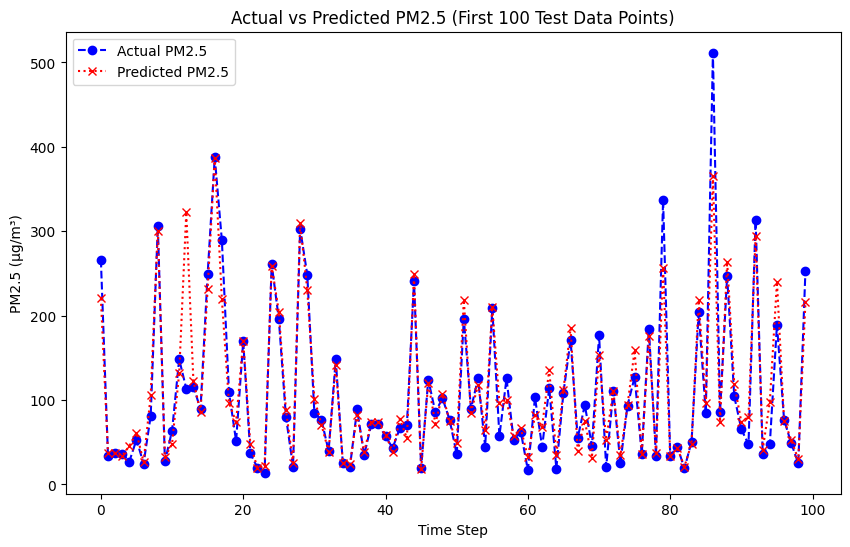

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Replace with your actual path
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Ensure all required columns are present
required_columns = ['Avg_PM2.5', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
missing_columns = [col for col in required_columns if col not in data.columns]

if missing_columns:
    raise ValueError(f"Missing columns in the dataset: {missing_columns}")

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
# Use .shift(365*24) to create 1 year lag features
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(365 * 24)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(365 * 24)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(365 * 24)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(365 * 24)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(365 * 24)

# Leave NaN values generated due to shifting for prediction; keep only valid rows for training
# Do not drop NaNs; use data interpolation
data = data.interpolate(method='linear')

# Check if there is enough data left after interpolating NaNs
if data.empty:
    raise ValueError("After lag feature creation, no data is left. Consider using a smaller lag value.")

# Define features and target variable (PM2.5)
X = data[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)', 'lag_1year_Avg_RH (%)',
          'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]
y = data['Avg_PM2.5']

# Split the data into train and test sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define and train a Random Forest model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = model.predict(X_test_scaled)

# Evaluate the model
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

print(f"R² Score: {r2:.4f}")
print(f"Mean Squared Error: {mse:.4f}")
print(f"Root Mean Squared Error: {rmse:.4f}")

# Plotting actual vs predicted PM2.5 levels
plt.figure(figsize=(10, 6))
plt.plot(y_test.values[:100], label='Actual PM2.5', color='blue', marker='o', linestyle='--')
plt.plot(y_pred[:100], label='Predicted PM2.5', color='red', marker='x', linestyle=':')
plt.title('Actual vs Predicted PM2.5 (First 100 Test Data Points)')
plt.xlabel('Time Step')
plt.ylabel('PM2.5 (µg/m³)')
plt.legend()
plt.show()


In [ ]:
import pandas as pd

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Replace with your actual path
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Debug: Check year distribution before lagging
print("Year distribution before lag feature creation:")
print(data['Year'].value_counts())

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
# Check if 2017 has valid data for creating lag
if data['Year'].min() > 2017:
    raise ValueError("Data for 2017 is required to create lag features for 2018 onwards.")

# Creating lag features for 1 year (shift by 365*24 hours)
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(365 * 24)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(365 * 24)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(365 * 24)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(365 * 24)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(365 * 24)

# Drop rows with NaN values after creating lag features (this will remove 2017 and earlier)
data = data.dropna()

# Debug: Check year distribution after lagging
print("Year distribution after lag feature creation:")
print(data['Year'].value_counts())

# Continue with the process (train-test split, model fitting, and prediction)...


Year distribution before lag feature creation:
Year
2020    8784
2017    8760
2018    8760
2019    8760
2021    8760
2022    8760
2023    8760
Name: count, dtype: int64
Year distribution after lag feature creation:
Series([], Name: count, dtype: int64)


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1).xlsx'
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Ensure all required columns are present
required_columns = ['Avg_PM2.5', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
missing_columns = [col for col in required_columns if col not in data.columns]

if missing_columns:
    raise ValueError(f"Missing columns in the dataset: {missing_columns}")

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
# Use .shift(365*24) to create 1 year lag features
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(365 * 24)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(365 * 24)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(365 * 24)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(365 * 24)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(365 * 24)

# Debugging: Print year distribution before and after lag creation
print("Year distribution before lag feature creation:")
print(data['Year'].value_counts())

# Remove data from 2017 because it will have NaN values after lag creation
data = data[data['Year'] > 2017]

# Drop NaN values after creating lag features
data = data.dropna()

# Debugging: Print year distribution after lag creation
print("Year distribution after lag feature creation:")
print(data['Year'].value_counts())

# Define features and target variable (PM2.5)
X = data[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)', 'lag_1year_Avg_RH (%)',
          'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]
y = data['Avg_PM2.5']

# Check if there's valid data before 2024
if X[X['Year'] < 2024].empty:
    raise ValueError("No valid data available before 2024 for training. Check the lag feature creation or data filtering steps.")

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X[X['Year'] < 2024], y[X['Year'] < 2024], test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define models
models = {
    'Linear Regression': LinearRegression(),
    'Lasso Regression': Lasso(),
    'Ridge Regression': Ridge(),
    'Support Vector Regressor': SVR(),
    'Random Forest Regressor': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting Regressor': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'K-Nearest Neighbors': KNeighborsRegressor(n_neighbors=5)
}

# Train and evaluate models
performance = {}
for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)

    # Calculate R², MSE, MAE, and RMSE
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)

    performance[name] = {'R²': r2, 'MSE': mse, 'MAE': mae, 'RMSE': rmse}

# Display performance metrics for each model
performance_df = pd.DataFrame(performance).T
performance_df.reset_index(inplace=True)
performance_df.columns = ['Model', 'R²', 'MSE', 'MAE', 'RMSE']

import ace_tools as tools; tools.display_dataframe_to_user(name="Model Performance Metrics", dataframe=performance_df)

# Forecasting PM2.5 for 2024 using the trained RandomForest model
X_2024 = X[X['Year'] == 2024]
y_2024_pred = models['Random Forest Regressor'].predict(scaler.transform(X_2024))

# Plot the forecasted PM2.5 values for 2024
plt.figure(figsize=(10, 6))
plt.plot(y_2024_pred, label='Forecasted PM2.5 for 2024', color='green', linestyle='-', marker='x')
plt.title('Forecasted PM2.5 Values for 2024')
plt.xlabel('Time Step')
plt.ylabel('PM2.5 (µg/m³)')
plt.legend()
plt.show()


Year distribution before lag feature creation:
Year
2020    8784
2017    8760
2018    8760
2019    8760
2021    8760
2022    8760
2023    8760
Name: count, dtype: int64
Year distribution after lag feature creation:
Series([], Name: count, dtype: int64)


ValueError: No valid data available before 2024 for training. Check the lag feature creation or data filtering steps.

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.impute import SimpleImputer
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/mnt/data/Book5 (1).xlsx'  # Update the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Sort the data by Timestamp to ensure correct ordering
data = data.sort_index()

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(365 * 24)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(365 * 24)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(365 * 24)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(365 * 24)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(365 * 24)

# Remove rows where lag values are NaN due to shift from 2017
data = data[data['Year'] >= 2018]  # Keep data from 2018 onwards

# Ensure the PM2.5 column exists
if 'PM2.5' not in data.columns:
    similar_columns = [col for col in data.columns if 'PM2.5' in col or 'pm2.5' in col or 'PM2_5' in col]
    if similar_columns:
        print(f"Using column '{similar_columns[0]}' instead of 'PM2.5'")
        data['PM2.5'] = data[similar_columns[0]]  # Create a 'PM2.5' column using the similar column
    else:
        raise KeyError("Column 'PM2.5' or similar not found. Please check your data source.")

# Define the features and target variable (PM2.5)
X = data[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)',
          'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
          'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]
y = data['PM2.5']

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=False)

# Impute missing values in y_train if any
if y_train.isnull().any():
    print("Warning: y_train contains NaN values. Imputing with mean.")
    # Impute the missing values with the mean
    imputer = SimpleImputer(strategy='mean')
    y_train = imputer.fit_transform(y_train.values.reshape(-1, 1)).ravel()

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train the Random Forest Regressor
model = RandomForestRegressor(random_state=42)
model.fit(X_train_scaled, y_train)

# Make predictions
y_pred = model.predict(X_test_scaled)

# Evaluate the model
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

print(f'R² Score: {r2}')
print(f'Mean Squared Error: {mse}')
print(f'Root Mean Squared Error: {rmse}')

# Plotting actual vs predicted PM2.5 levels
plt.figure(figsize=(10, 6))
plt.plot(y_test.values[:100], label='Actual PM2.5', color='blue', marker='o', linestyle='--')
plt.plot(y_pred[:100], label='Predicted PM2.5', color='red', marker='x', linestyle=':')
plt.title('Actual vs Predicted PM2.5 (First 100 Test Data Points)')
plt.xlabel('Time Step')
plt.ylabel('PM2.5 (µg/m³)')
plt.legend()
plt.show()



In [ ]:
# Check the distribution of years in the data
print("Year distribution in the dataset after lag feature creation:")
print(data['Year'].value_counts())


Year distribution in the dataset after lag feature creation:
Series([], Name: count, dtype: int64)


In [ ]:
# Check for missing values
print("Missing data summary:")
print(data.isnull().sum())


Missing data summary:
Sirifort_PM2.5              0
IHBAS_PM2.5                 0
Sonia_Vihar_PM2.5           0
mandir_marg_PM2.5           0
Avg_PM2.5                   0
Avg_PM10 (µg/m³)            0
Avg_NO2 (µg/m³)             0
Avg_AT (°C)                 0
Avg_VWS (m/s)               0
Avg_O Xylene (µg/m³)        0
Avg_SO2 (µg/m³)             0
Avg_Eth-Benzene (µg/m³)     0
Avg_CO (mg/m³)              0
Avg_RH (%)                  0
Avg_Xylene (µg/m³)          0
Avg_WD (deg)                0
Avg_Toluene (µg/m³)         0
Avg_SR (W/mt2)              0
Hour                        0
Day                         0
Month                       0
Year                        0
lag_1year_T (°C)            0
lag_1year_Avg_RH (%)        0
lag_1year_Avg_VWS (m/s)     0
lag_1year_Avg_WD (deg)      0
lag_1year_Avg_SR (W/mt2)    0
dtype: int64


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

# Define and train a Random Forest model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred = model.predict(X_test_scaled)

# Evaluate the model
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)

print(f"R² Score: {r2:.4f}")
print(f"Mean Squared Error: {mse:.4f}")
print(f"Root Mean Squared Error: {rmse:.4f}")


In [ ]:
# Filter data for 2024
X_2024 = X[X['Year'] == 2024]

# Standardize the features for 2024
X_2024_scaled = scaler.transform(X_2024)

# Predict PM2.5 for 2024
predicted_pm25_2024 = model.predict(X_2024_scaled)

# Add the predictions back to the original data
forecast_2024 = X_2024.copy()
forecast_2024['Predicted_PM2.5'] = predicted_pm25_2024

# Save the forecast for 2024
forecast_2024.to_excel('forecast_pm25_2024.xlsx')

print("Forecast for 2024 PM2.5 has been saved to 'forecast_pm25_2024.xlsx'.")


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Replace with your actual path
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Debug: Check year distribution before lagging
print("Year distribution before lag feature creation:")
print(data['Year'].value_counts())

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(365 * 24)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(365 * 24)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(365 * 24)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(365 * 24)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(365 * 24)

# Drop rows with NaN values after creating lag features
#data = data.dropna()

# Debug: Check year distribution after lagging
print("Year distribution after lag feature creation:")
print(data['Year'].value_counts())

# Include data from 2018 onwards
data = data[data['Year'] >= 2017]

print(data.columns)

if 'PM2.5' not in data.columns:
    similar_columns = [col for col in data.columns if 'PM2.5' in col or 'pm2.5' in col or 'PM2_5' in col]
    if similar_columns:
        print(f"Using column '{similar_columns[0]}' instead of 'PM2.5'")
        data['PM2.5'] = data[similar_columns[0]]  # Create a 'PM2.5' column using the similar column
    else:
        raise KeyError("Column 'PM2.5' or similar not found. Please check your data source.")

X = data[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)',
         'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
         'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]
y = data['PM2.5']

# Check if the DataFrame is empty after filtering
if data.empty:
    min_year = data['Year'].min()
    max_year = data['Year'].max()
    raise ValueError(f"No valid training data available for years >= 2018. "
                     f"Available data ranges from {min_year} to {max_year}. "
                     f"Please adjust your data source or filtering criteria.")

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=False)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

from sklearn.impute import SimpleImputer

if y_train.isnull().any():
    print("Warning: y_train contains NaN values. Imputing with mean.")
    # Create an imputer to replace NaNs with the mean
    imputer = SimpleImputer(strategy='mean')
    # Reshape y_train to a 2D array for imputation (required by SimpleImputer)
    y_train_reshaped = y_train.values.reshape(-1, 1)
    # Impute the missing values
    y_train_imputed = imputer.fit_transform(y_train_reshaped)
    # Convert back to a pandas Series
    y_train = pd.Series(y_train_imputed.flatten(), index=y_train.index)
else:
    print("y_train does not contain NaN values.")

# Train the Random Forest Regressor
model = RandomForestRegressor(random_state=42)
model.fit(X_train_scaled, y_train)

import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error

# Impute missing values in y_test if any
if y_test.isnull().any():
    print("Warning: y_test contains NaN values. Imputing with mean.")
    # Create an imputer to replace NaNs with the mean
    imputer = SimpleImputer(strategy='mean')
    # Reshape y_test to a 2D array for imputation (required by SimpleImputer)
    y_test_reshaped = y_test.values.reshape(-1, 1)
    # Impute the missing values
    y_test_imputed = imputer.fit_transform(y_test_reshaped)
    # Convert back to a pandas Series
    y_test = pd.Series(y_test_imputed.flatten(), index=y_test.index)
else:
    print("y_test does not contain NaN values.")

# Train the Random Forest Regressor
model = RandomForestRegressor(random_state=42)
model.fit(X_train_scaled, y_train) # The model needs to be trained before making predictions


# Make predictions
y_pred = model.predict(X_test_scaled)
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'R² Score: {r2}')
print(f'Mean Squared Error:{mse}')

Year distribution before lag feature creation:
Year
2020    8784
2017    8760
2018    8760
2019    8760
2021    8760
2022    8760
2023    8760
Name: count, dtype: int64
Year distribution after lag feature creation:
Year
2020    8784
2017    8760
2018    8760
2019    8760
2021    8760
2022    8760
2023    8760
Name: count, dtype: int64
Index(['Sirifort_PM2.5', 'IHBAS_PM2.5', 'Sonia_Vihar_PM2.5',
       'mandir_marg_PM2.5', 'Avg_PM2.5', 'Avg_PM10 (µg/m³)', 'Avg_NO2 (µg/m³)',
       'Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_O Xylene (µg/m³)',
       'Avg_SO2 (µg/m³)', 'Avg_Eth-Benzene (µg/m³)', 'Avg_CO (mg/m³)',
       'Avg_RH (%)', 'Avg_Xylene (µg/m³)', 'Avg_WD (deg)',
       'Avg_Toluene (µg/m³)', 'Avg_SR (W/mt2)', 'Hour', 'Day', 'Month', 'Year',
       'lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
       'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)'],
      dtype='object')
Using column 'Sirifort_PM2.5' instead of 'PM2.5'
R² Score: 0.3409431735003934
Mean Squa

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error
import numpy as np

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Replace with your actual path
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Debug: Check year distribution before lagging
print("Year distribution before lag feature creation:")
print(data['Year'].value_counts())

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
lag_hours = 365 * 24
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(lag_hours)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(lag_hours)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(lag_hours)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(lag_hours)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(lag_hours)

# Debug: Check year distribution after lagging
print("Year distribution after lag feature creation:")
print(data['Year'].value_counts())

# Include data from 2017 onwards to ensure consistency with the lag
data = data[data['Year'] >= 2017]

# Check if 'PM2.5' column exists, if not, attempt to find a similar column
if 'PM2.5' not in data.columns:
    similar_columns = [col for col in data.columns if 'PM2.5' in col or 'pm2.5' in col or 'PM2_5' in col]
    if similar_columns:
        print(f"Using column '{similar_columns[0]}' instead of 'PM2.5'")
        data['PM2.5'] = data[similar_columns[0]]  # Create a 'PM2.5' column using the similar column
    else:
        raise KeyError("Column 'PM2.5' or similar not found. Please check your data source.")

# Show missing values count per column
missing_values_count = data.isnull().sum()
print("\nMissing values per column:")
print(missing_values_count)

# Display the total number of missing data points
total_missing = data.isnull().sum().sum()
print(f"\nTotal missing data points: {total_missing}")

# Check the missing values in the lagged features specifically
lagged_columns = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                  'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

missing_in_lagged = data[lagged_columns].isnull().sum()
print("\nMissing values in lagged features:")
print(missing_in_lagged)

# You can proceed to split the data if needed, just don't drop or fill the missing values


Year distribution before lag feature creation:
Year
2020    8784
2017    8760
2018    8760
2019    8760
2021    8760
2022    8760
2023    8760
Name: count, dtype: int64
Year distribution after lag feature creation:
Year
2020    8784
2017    8760
2018    8760
2019    8760
2021    8760
2022    8760
2023    8760
Name: count, dtype: int64
Using column 'Sirifort_PM2.5' instead of 'PM2.5'

Missing values per column:
Sirifort_PM2.5               5868
IHBAS_PM2.5                  6621
Sonia_Vihar_PM2.5           11309
mandir_marg_PM2.5            3133
Avg_PM2.5                     142
Avg_PM10 (µg/m³)              941
Avg_NO2 (µg/m³)               299
Avg_AT (°C)                   559
Avg_VWS (m/s)               28979
Avg_O Xylene (µg/m³)        40346
Avg_SO2 (µg/m³)              1055
Avg_Eth-Benzene (µg/m³)     18204
Avg_CO (mg/m³)                705
Avg_RH (%)                    203
Avg_Xylene (µg/m³)          33580
Avg_WD (deg)                  958
Avg_Toluene (µg/m³)          1291
Avg_SR (

In [ ]:
# Let's first load the data from the uploaded Excel file and inspect the missing values.

import pandas as pd

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Path to the uploaded file
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
lag_hours = 365 * 24
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(lag_hours)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(lag_hours)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(lag_hours)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(lag_hours)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(lag_hours)

# Include data from 2017 onwards
data = data[data['Year'] >= 2017]

# Show missing values count per column
missing_values_count = data.isnull().sum()

# Display the total number of missing data points
total_missing = data.isnull().sum().sum()

# Check the missing values in the lagged features specifically
lagged_columns = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                  'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']
missing_in_lagged = data[lagged_columns].isnull().sum()

missing_values_count, total_missing, missing_in_lagged


(Sirifort_PM2.5               5868
 IHBAS_PM2.5                  6621
 Sonia_Vihar_PM2.5           11309
 mandir_marg_PM2.5            3133
 Avg_PM2.5                     142
 Avg_PM10 (µg/m³)              941
 Avg_NO2 (µg/m³)               299
 Avg_AT (°C)                   559
 Avg_VWS (m/s)               28979
 Avg_O Xylene (µg/m³)        40346
 Avg_SO2 (µg/m³)              1055
 Avg_Eth-Benzene (µg/m³)     18204
 Avg_CO (mg/m³)                705
 Avg_RH (%)                    203
 Avg_Xylene (µg/m³)          33580
 Avg_WD (deg)                  958
 Avg_Toluene (µg/m³)          1291
 Avg_SR (W/mt2)                 65
 Hour                            0
 Day                             0
 Month                           0
 Year                            0
 lag_1year_T (°C)             9212
 lag_1year_Avg_RH (%)         8896
 lag_1year_Avg_VWS (m/s)     33584
 lag_1year_Avg_WD (deg)       9531
 lag_1year_Avg_SR (W/mt2)     8823
 dtype: int64,
 224304,
 lag_1year_T (°C)             9

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Replace with your actual file path
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Create Hour, Day, Month, and Year columns
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Feature Engineering: Lag Features from 1 Year (365 * 24 = 1 year in hours for hourly data)
lag_hours = 365 * 24
data['lag_1year_T (°C)'] = data['Avg_AT (°C)'].shift(lag_hours)
data['lag_1year_Avg_RH (%)'] = data['Avg_RH (%)'].shift(lag_hours)
data['lag_1year_Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].shift(lag_hours)
data['lag_1year_Avg_WD (deg)'] = data['Avg_WD (deg)'].shift(lag_hours)
data['lag_1year_Avg_SR (W/mt2)'] = data['Avg_SR (W/mt2)'].shift(lag_hours)

# Filter the data from 2018 to 2023
data_2018_to_2023 = data[(data['Year'] >= 2018) & (data['Year'] <= 2023)]

# Select features and target for training
X = data_2018_to_2023[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)',
                       'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                       'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]
y = data_2018_to_2023['Avg_PM2.5']  # Assuming 'Avg_PM2.5' is the target variable for prediction

# Impute missing values using linear interpolation for both X and y
X_imputed = X.interpolate(method='linear', limit_direction='forward', axis=0)
y_imputed = y.interpolate(method='linear', limit_direction='forward', axis=0)

# Split the dataset into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X_imputed, y_imputed, test_size=0.2, random_state=42, shuffle=False)

# Train the Random Forest Regressor
model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)

print(f'R² Score: {r2}')
print(f'Mean Squared Error: {mse}')


R² Score: 0.3815816551012886
Mean Squared Error: 3785.2506736968303


In [ ]:
# First, let's ensure the lagged features for 2024 are correctly generated based on the data from 2023.

# Generate hourly timestamps for 2024
timestamp_2024 = pd.date_range(start='2024-01-01 00:00:00', end='2024-12-31 23:00:00', freq='H')

# Create a DataFrame for 2024
data_2024 = pd.DataFrame(index=timestamp_2024)

# Extract necessary features for the 2024 timestamp
data_2024['Hour'] = data_2024.index.hour
data_2024['Day'] = data_2024.index.day
data_2024['Month'] = data_2024.index.month
data_2024['Year'] = data_2024.index.year

# Extract 2023 data to create lagged features for 2024
data_2023 = data_full[data_full['Year'] == 2023]

# Shift 2023 data to create lag features for 2024 (365 days * 24 hours lag)
lag_hours = 365 * 24

data_2024['lag_1year_T (°C)'] = data_2023['Avg_AT (°C)'].shift(lag_hours)
data_2024['lag_1year_Avg_RH (%)'] = data_2023['Avg_RH (%)'].shift(lag_hours)
data_2024['lag_1year_Avg_VWS (m/s)'] = data_2023['Avg_VWS (m/s)'].shift(lag_hours)
data_2024['lag_1year_Avg_WD (deg)'] = data_2023['Avg_WD (deg)'].shift(lag_hours)
data_2024['lag_1year_Avg_SR (W/mt2)'] = data_2023['Avg_SR (W/mt2)'].shift(lag_hours)

# Check if the lag features are created correctly
data_2024.head()


<ipython-input-9-2fbc6d7bb955>:4: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  timestamp_2024 = pd.date_range(start='2024-01-01 00:00:00', end='2024-12-31 23:00:00', freq='H')


,Hour,Day,Month,Year,lag_1year_T (°C),lag_1year_Avg_RH (%),lag_1year_Avg_VWS (m/s),lag_1year_Avg_WD (deg),lag_1year_Avg_SR (W/mt2)
2024-01-01 00:00:00,0,1,1,2024,NaN,NaN,NaN,NaN,NaN
2024-01-01 01:00:00,1,1,1,2024,NaN,NaN,NaN,NaN,NaN
2024-01-01 02:00:00,2,1,1,2024,NaN,NaN,NaN,NaN,NaN
2024-01-01 03:00:00,3,1,1,2024,NaN,NaN,NaN,NaN,NaN
2024-01-01 04:00:00,4,1,1,2024,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Re-import necessary packages and re-load the dataset to continue from where we left off.
import pandas as pd
from sklearn.impute import SimpleImputer
from sklearn.ensemble import RandomForestRegressor

# Load the dataset for 2024 and 2023
file_path = '/mnt/data/full_lagged_data_till_2024.xlsx'
data_full = pd.read_excel(file_path, index_col=0)

# Separate the data into training (2018-2023) and prediction (2024) datasets
data_train = data_full[data_full['Year'] <= 2023]
data_2024 = data_full[data_full['Year'] == 2024]

# Select features for training from 2018 to 2023
X_train = data_train[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)',
                      'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                      'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]
y_train = data_train['Avg_PM2.5'].interpolate(method='linear', limit_direction='forward', axis=0)

# Impute missing values in X_train using mean imputation
imputer = SimpleImputer(strategy='mean')
X_train_imputed = imputer.fit_transform(X_train)

# Re-select features for 2024
X_2024 = data_2024[['Hour', 'Day', 'Month', 'Year', 'lag_1year_T (°C)',
                    'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                    'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]

# Apply imputation to the 2024 data
X_2024_imputed = imputer.transform(X_2024)

# Train the Random Forest Regressor using the imputed training data
model = RandomForestRegressor(random_state=42)
model.fit(X_train_imputed, y_train)

# Predict PM2.5 for 2024
y_pred_2024 = model.predict(X_2024_imputed)

# Save the predictions for 2024 into a new DataFrame
data_2024['Predicted_PM2.5'] = y_pred_2024

# Save the predictions into an Excel file
output_predictions_2024 = '/mnt/data/predicted_PM2_5_2024_final.xlsx'
data_2024.to_excel(output_predictions_2024)

output_predictions_2024


ValueError: Length of values (8760) does not match length of index (8784)

In [ ]:
import pandas as pd

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_uploaded = pd.read_excel('/content/full_lagged_data_till_2024_regenerated.xlsx')

# Convert index to datetime
data_uploaded.index = pd.to_datetime(data_uploaded.index)

# Filter data for the years 2018 to 2023
data_filtered = data_uploaded[(data_uploaded.index.year >= 2018) & (data_uploaded.index.year <= 2023)]

# Define the list of original and lagged features
features_comparison_extended = ['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
lagged_features_comparison_extended = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                       'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Create an empty dictionary to store the results
average_monthly_diff = {}

# Calculate the average monthly difference between original and lagged features
for original_feature, lagged_feature in zip(features_comparison_extended, lagged_features_comparison_extended):
    # Compute the difference between original and lagged
    data_filtered[f'diff_{original_feature}'] = data_filtered[original_feature] - data_filtered[lagged_feature]

    # Group by month and calculate the mean difference
    monthly_avg_diff = data_filtered.groupby(data_filtered.index.month)[f'diff_{original_feature}'].mean()

    # Store the results
    average_monthly_diff[original_feature] = monthly_avg_diff

# Convert the results dictionary into a DataFrame for easier display
average_monthly_diff_df = pd.DataFrame(average_monthly_diff)

# Plot separate graphs for each feature
for original_feature in features_comparison_extended:
    plt.figure(figsize=(10, 6))
    plt.bar(average_monthly_diff_df.index, average_monthly_diff_df[original_feature], color='blue', alpha=0.7)
    plt.title(f'Average Monthly Difference: {original_feature} (2018-2023)')
    plt.xlabel('Month')
    plt.ylabel('Average Difference')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


<ipython-input-4-3232279a9801>:14: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  timestamp_full = pd.date_range(start=data.index.min(), end='2024-12-31 23:00:00', freq='H')


'full_lagged_data_till_2024_regenerated.xlsx'

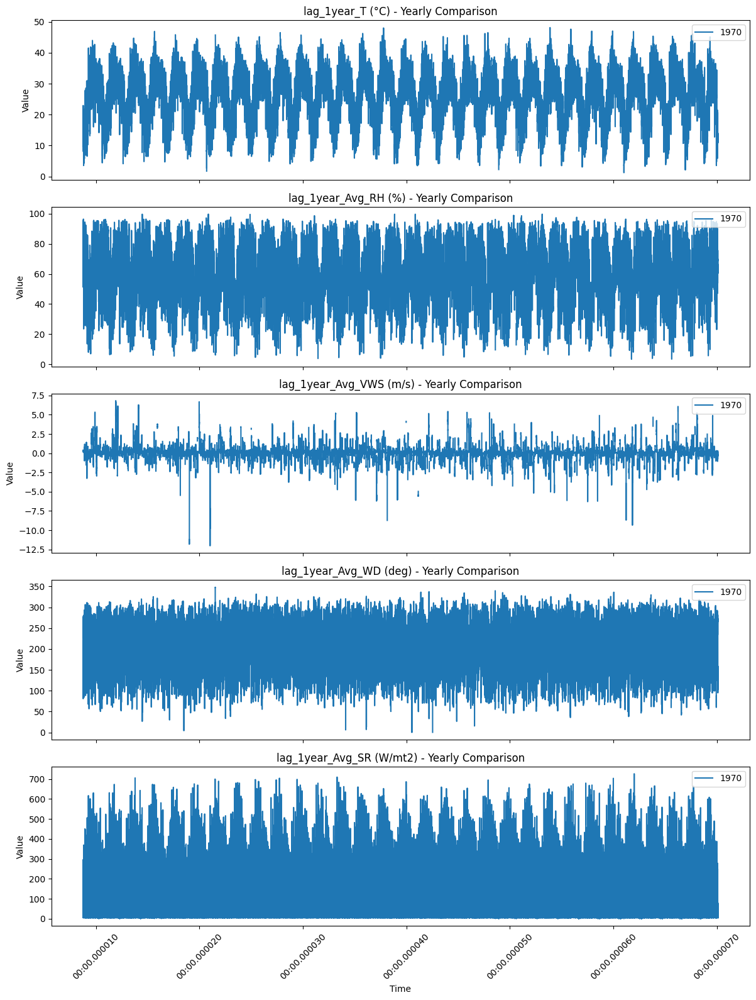

In [ ]:
# Extract the year from the index for grouping
data_uploaded['Year'] = pd.to_datetime(data_uploaded.index).year

# Set up the figure for subplots
fig, axes = plt.subplots(5, 1, figsize=(12, 16), sharex=True)

# List of features to plot
features = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
            'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Plot each feature in a separate subplot
for i, feature in enumerate(features):
    for year in data_uploaded['Year'].unique():
        # Plot the data for each year to show cyclic behavior
        axes[i].plot(data_uploaded[data_uploaded['Year'] == year].index,
                     data_uploaded[data_uploaded['Year'] == year][feature],
                     label=f'{year}')
    axes[i].set_title(f'{feature} - Yearly Comparison')
    axes[i].set_ylabel('Value')
    axes[i].legend(loc='upper right')

# Common x-label
plt.xlabel('Time')

# Rotate x-ticks for better readability
plt.xticks(rotation=45)

# Adjust layout to avoid overlap
plt.tight_layout()

# Display the plot
plt.show()


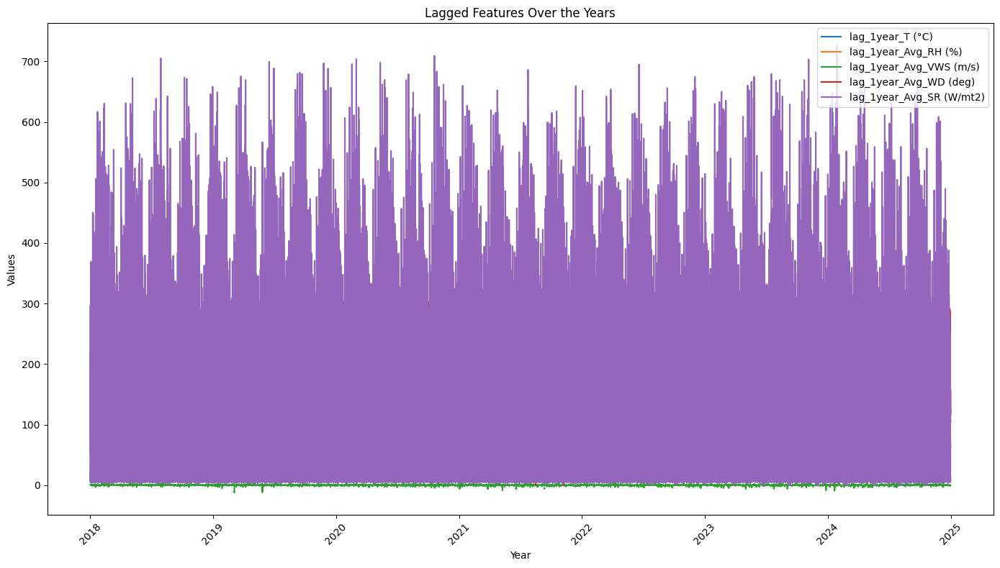

In [ ]:
# Re-import necessary packages and reload the uploaded dataset to proceed with the plotting of lagged features

import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset from the previously uploaded file
file_path = '/content/full_lagged_data_till_2024_regenerated.xlsx'
data_uploaded = pd.read_excel(file_path, index_col=0)

# Extract the lagged features over the years
lagged_features = data_uploaded[['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                 'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']]

# Plot the lagged features over time
plt.figure(figsize=(14, 8))

# Plot each lagged feature
for column in lagged_features.columns:
    plt.plot(lagged_features.index, lagged_features[column], label=column)

# Customize the plot
plt.title('Lagged Features Over the Years')
plt.xlabel('Year')
plt.ylabel('Values')
plt.legend(loc='upper right')
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_uploaded = pd.read_excel('/content/full_lagged_data_till_2024_regenerated.xlsx')

# Ensure the index is in datetime format
data_uploaded.index = pd.to_datetime(data_uploaded.index)

# Filter data for 20th February 2019
specific_date_2019_data = data_uploaded[(data_uploaded.index.year == 2019) & (data_uploaded.index.strftime('%m-%d') == '02-20')]

# Check if the filtered data is empty
if specific_date_2019_data.empty:
    print("No data available for 20th February 2019.")
else:
    # Define original and lagged features
    features_comparison_extended = ['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
    lagged_features_comparison_extended = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                           'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

    # Create subplots
    fig, axes = plt.subplots(3, 2, figsize=(14, 12))
    axes = axes.flatten()

    # Plot original vs lagged features for the specific date
    for i, (original_feature, lagged_feature) in enumerate(zip(features_comparison_extended, lagged_features_comparison_extended)):
        if original_feature in specific_date_2019_data.columns and lagged_feature in specific_date_2019_data.columns:
            axes[i].plot(specific_date_2019_data['Hour'], specific_date_2019_data[original_feature], label=f'Original {original_feature}', marker='o')
            axes[i].plot(specific_date_2019_data['Hour'], specific_date_2019_data[lagged_feature], label=f'Lagged {lagged_feature}', marker='x')
            axes[i].set_title(f'Original vs Lagged on 20th February 2019')
            axes[i].set_xlabel('Hour')
            axes[i].set_ylabel('Value')
            axes[i].grid(True)
            axes[i].legend()

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()


No data available for 20th February 2019.


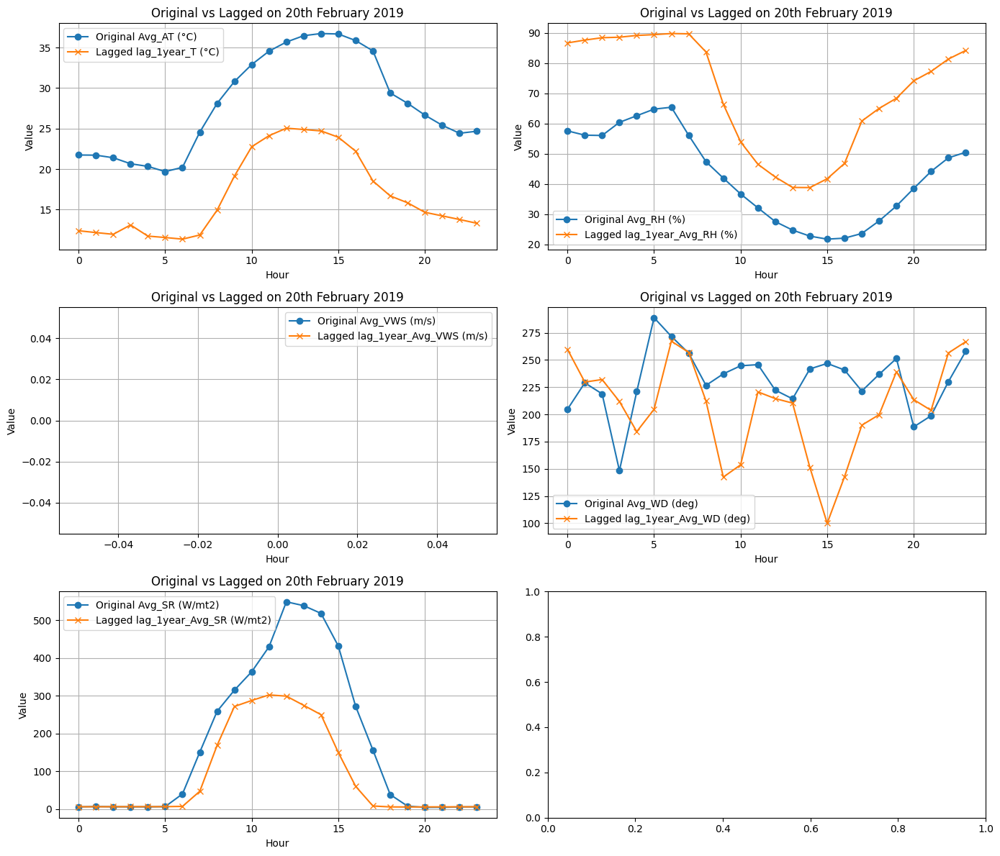

(                     Hour  Day  Month  Year  Sirifort_PM2.5  IHBAS_PM2.5  \
 Timestamp                                                                  
 2019-02-20 00:00:00     0   20      2  2019          239.75       212.92   
 2019-02-20 01:00:00     1   20      2  2019          204.50       188.30   
 2019-02-20 02:00:00     2   20      2  2019          181.25       153.33   
 2019-02-20 03:00:00     3   20      2  2019          158.25       159.43   
 2019-02-20 04:00:00     4   20      2  2019          133.25       133.18   
 
                      Sonia_Vihar_PM2.5  mandir_marg_PM2.5  Avg_PM2.5  \
 Timestamp                                                              
 2019-02-20 00:00:00             254.75             290.75   249.5425   
 2019-02-20 01:00:00             234.50             208.25   208.8875   
 2019-02-20 02:00:00             278.50             178.50   197.8950   
 2019-02-20 03:00:00             211.25             165.00   173.4825   
 2019-02-20 04:00:00 

In [ ]:
# Load the newly uploaded dataset
import pandas as pd
import matplotlib.pyplot as plt
file_path = '/content/Copy of lagged_till_2024(1)WITH_RAINFALL.xlsx'
data_uploaded = pd.read_excel(file_path, index_col=0)

# Convert index to datetime
data_uploaded.index = pd.to_datetime(data_uploaded.index)

# Filter data for 20th February 2019
specific_date_2019_data = data_uploaded[(data_uploaded.index.year == 2019) & (data_uploaded.index.strftime('%m-%d') == '02-20')]

# Check if the filtered data is empty
if specific_date_2019_data.empty:
    result = "No data available for 20th February 2019."
else:
    # Define original and lagged features
    features_comparison_extended = ['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
    lagged_features_comparison_extended = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                           'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)',"lag_1year_TOT-RF (mm)"]

    # Create subplots
    fig, axes = plt.subplots(3, 2, figsize=(14, 12))
    axes = axes.flatten()

    # Plot original vs lagged features for the specific date
    for i, (original_feature, lagged_feature) in enumerate(zip(features_comparison_extended, lagged_features_comparison_extended)):
        if original_feature in specific_date_2019_data.columns and lagged_feature in specific_date_2019_data.columns:
            axes[i].plot(specific_date_2019_data['Hour'], specific_date_2019_data[original_feature], label=f'Original {original_feature}', marker='o')
            axes[i].plot(specific_date_2019_data['Hour'], specific_date_2019_data[lagged_feature], label=f'Lagged {lagged_feature}', marker='x')
            axes[i].set_title(f'Original vs Lagged on 20th February 2019')
            axes[i].set_xlabel('Hour')
            axes[i].set_ylabel('Value')
            axes[i].grid(True)
            axes[i].legend()

    # Adjust layout and display the plot
    plt.tight_layout()
    plt.show()

specific_date_2019_data.head(), result if 'result' in locals() else "Data available for 20th February 2019"


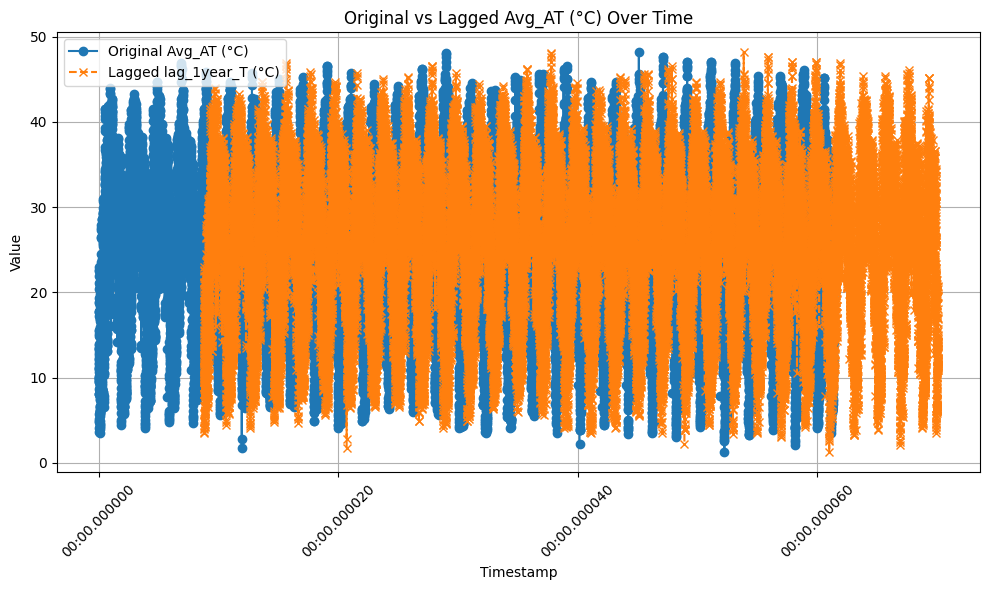

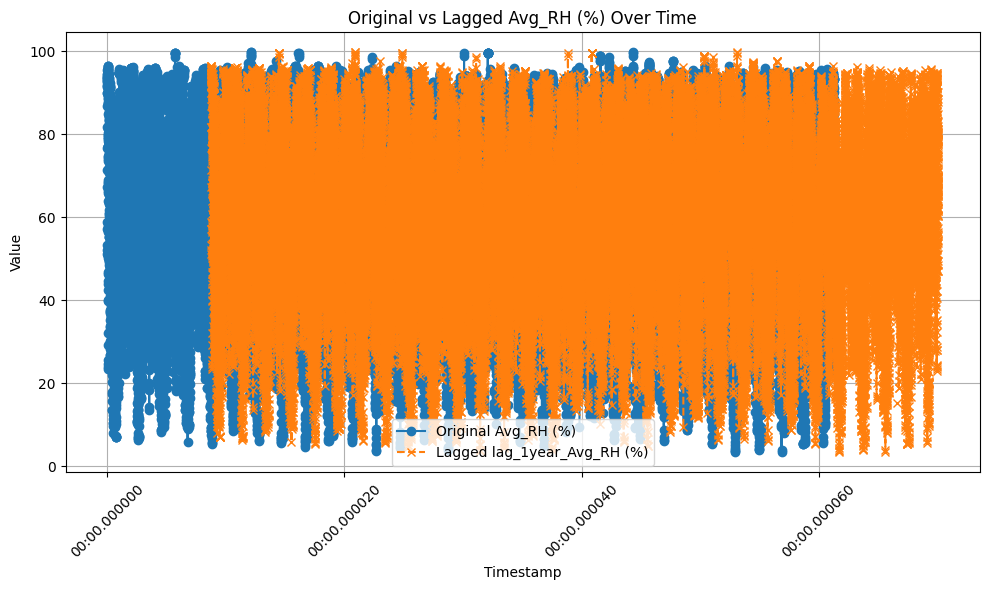

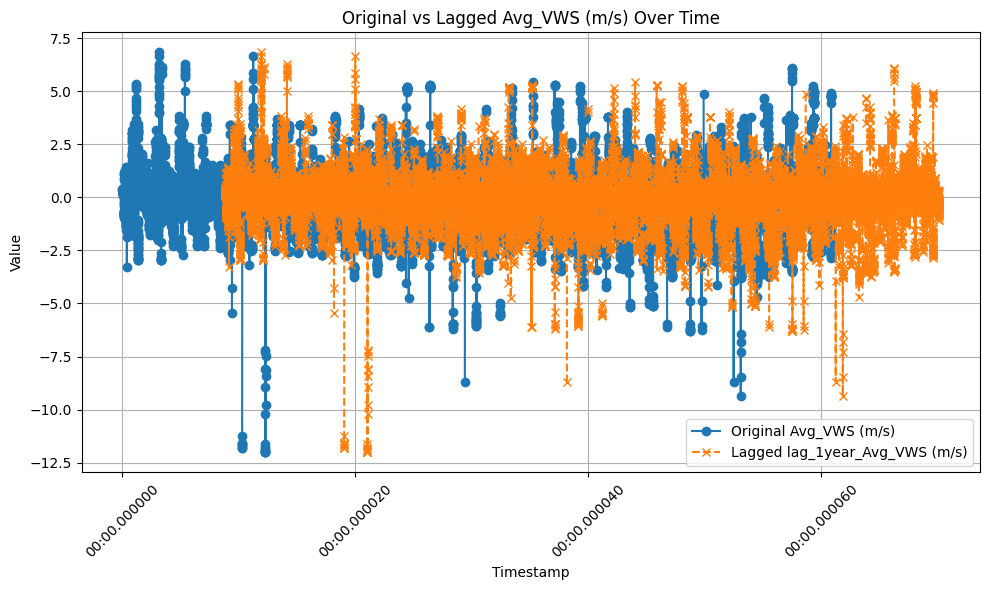

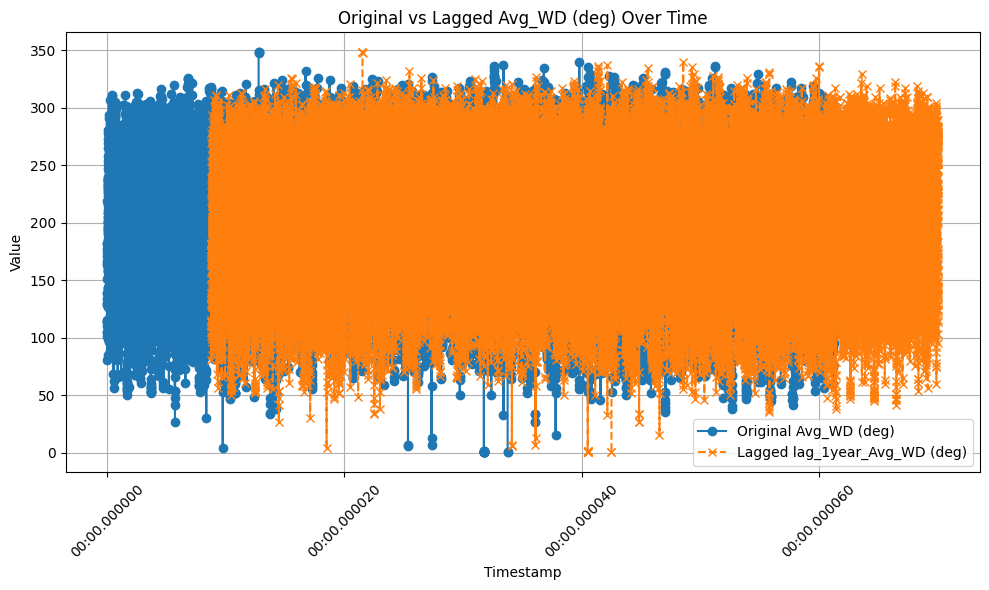

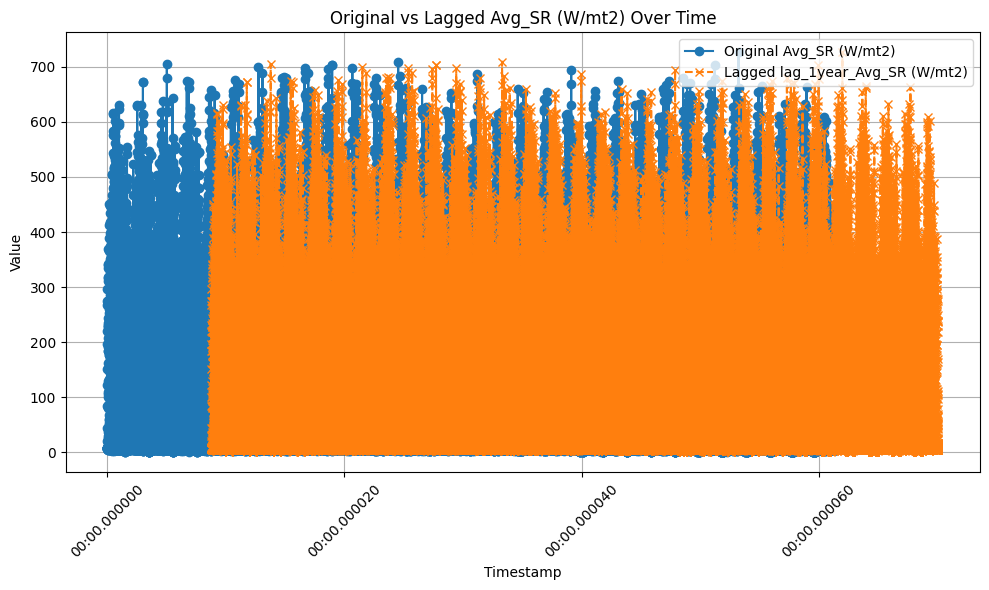

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_uploaded = pd.read_excel('/content/full_lagged_data_till_2024_regenerated.xlsx')

# Convert index to datetime if not already
data_uploaded.index = pd.to_datetime(data_uploaded.index)

# Define the list of original and lagged features
features_comparison_extended = ['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
lagged_features_comparison_extended = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                       'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Function to plot original vs lagged features with timestamp
def plot_lagged_features_with_timestamp(original_feature, lagged_feature):
    plt.figure(figsize=(10, 6))
    plt.plot(data_uploaded.index, data_uploaded[original_feature], label=f'Original {original_feature}', marker='o')
    plt.plot(data_uploaded.index, data_uploaded[lagged_feature], label=f'Lagged {lagged_feature}', marker='x', linestyle='--')
    plt.title(f'Original vs Lagged {original_feature} Over Time')
    plt.xlabel('Timestamp')
    plt.ylabel('Value')
    plt.xticks(rotation=45)  # Rotate the x-axis for better readability
    plt.grid(True)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()

# Plot each feature with timestamp
for original_feature, lagged_feature in zip(features_comparison_extended, lagged_features_comparison_extended):
    plot_lagged_features_with_timestamp(original_feature, lagged_feature)


NameError: name 'features_comparison' is not defined

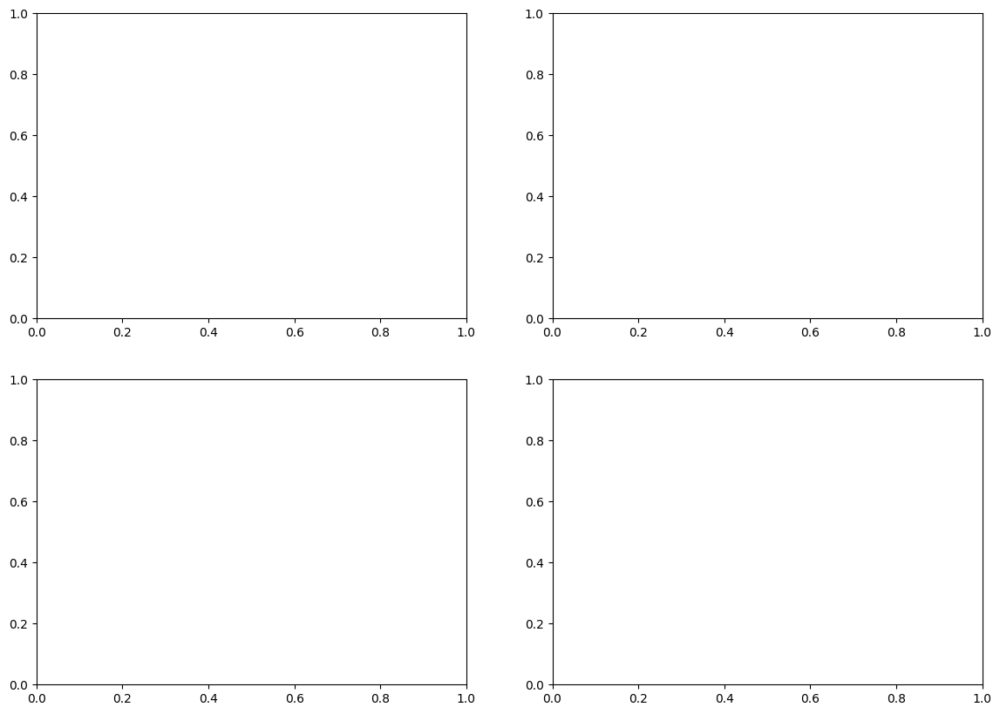

In [ ]:
# Filter data specifically for the year 2019 and the date 20th February
specific_date_2019_data = data_uploaded[(data_uploaded.index.year == 2019) & (data_uploaded.index.strftime('%m-%d') == '02-20')]

# Create a plot to show how the original and lagged features vary for 20th February 2019
fig, axes = plt.subplots(2, 2, figsize=(14, 10))

# Flatten the axes for easier access
axes = axes.flatten()

# Plot original vs lagged for the specific date (2019)
for i, (original_feature, lagged_feature) in enumerate(zip(features_comparison, lagged_features_comparison)):
    axes[i].plot(specific_date_2019_data['Hour'], specific_date_2019_data[original_feature], label=f'Original {original_feature}', marker='o')
    axes[i].plot(specific_date_2019_data['Hour'], specific_date_2019_data[lagged_feature], label=f'Lagged {lagged_feature}', marker='x')
    axes[i].set_title(f'Original vs Lagged on 20th February 2019')
    axes[i].set_xlabel('Hour')
    axes[i].set_ylabel('Value')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()


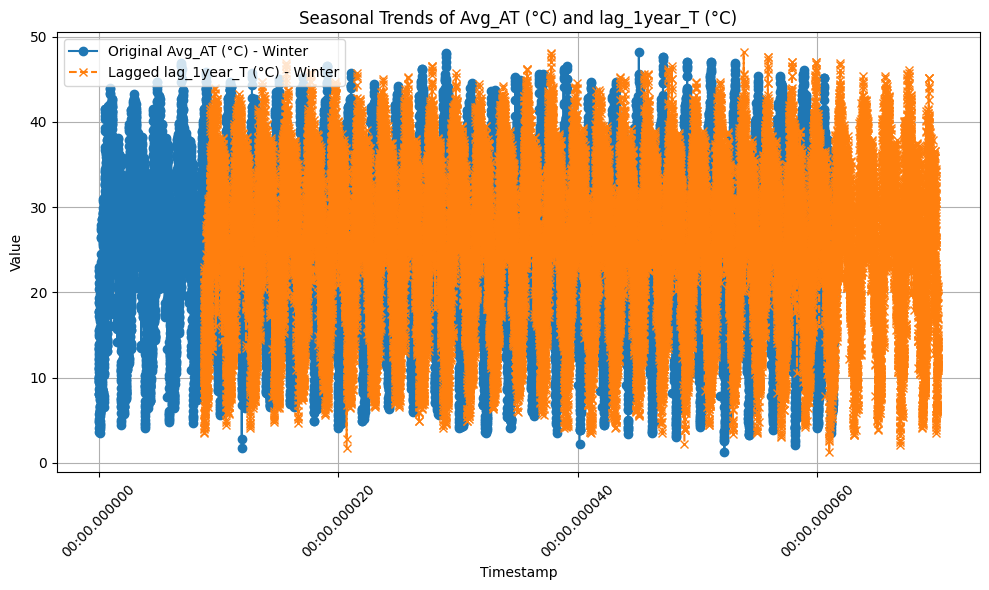

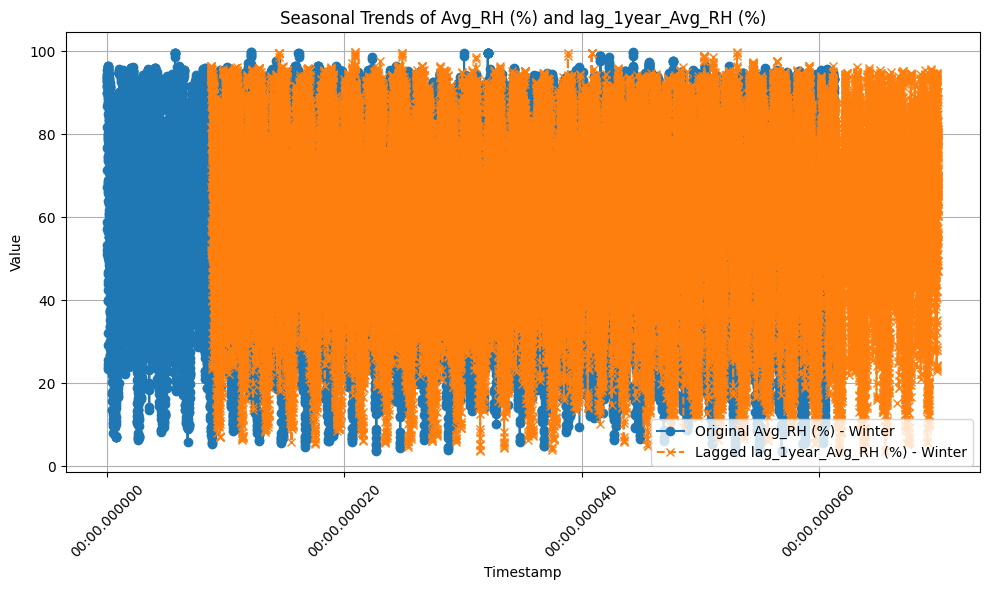

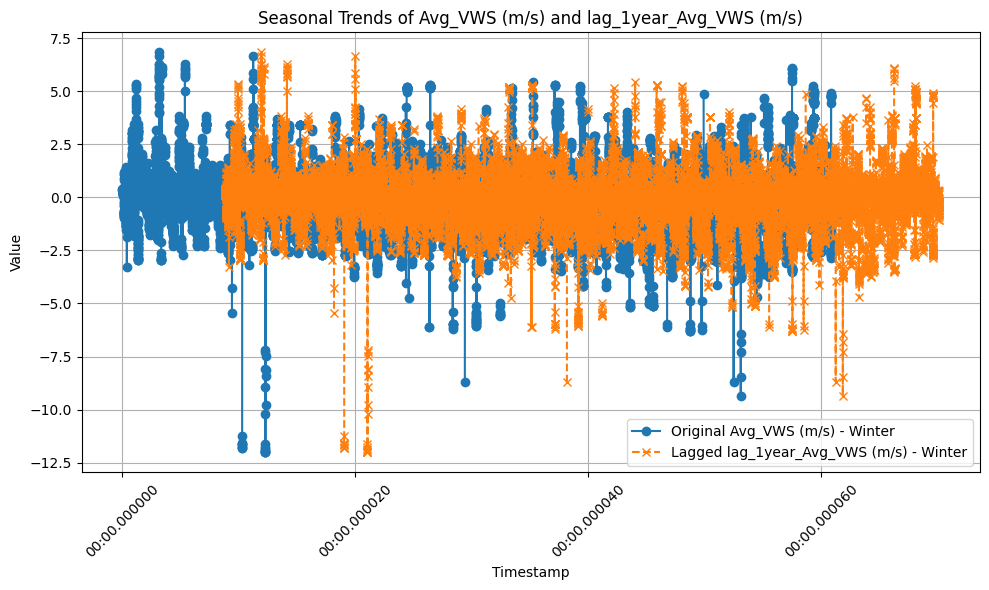

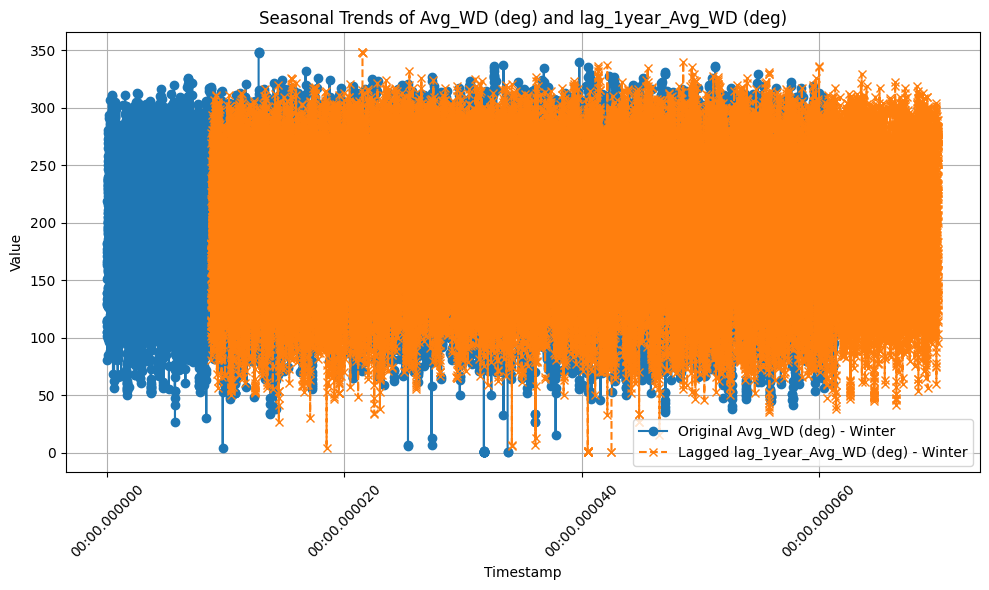

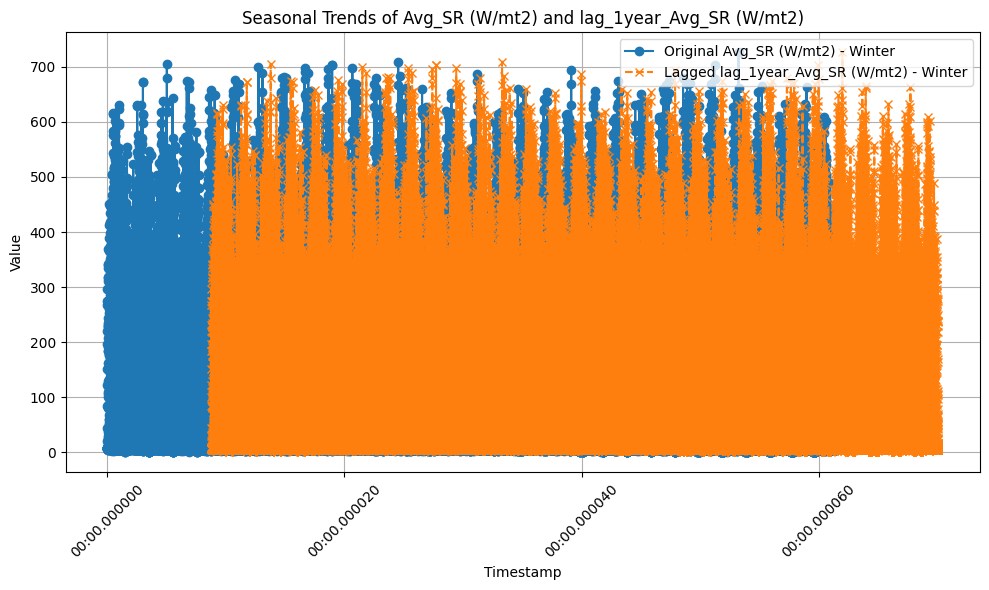

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_uploaded = pd.read_excel('/content/full_lagged_data_till_2024_regenerated.xlsx')

# Convert index to datetime if not already
data_uploaded.index = pd.to_datetime(data_uploaded.index)

# Define the function to assign seasons
def get_season(month):
    if month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Fall'
    else:
        return 'Winter'

# Add a 'Season' column to the dataset
data_uploaded['Season'] = data_uploaded.index.month.map(get_season)

# Define the list of original and lagged features
features_comparison_extended = ['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
lagged_features_comparison_extended = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                       'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Function to plot seasonal trends for each feature
def plot_seasonal_trends(original_feature, lagged_feature):
    plt.figure(figsize=(10, 6))
    for season in data_uploaded['Season'].unique():
        seasonal_data = data_uploaded[data_uploaded['Season'] == season]
        plt.plot(seasonal_data.index, seasonal_data[original_feature], label=f'Original {original_feature} - {season}', marker='o')
        plt.plot(seasonal_data.index, seasonal_data[lagged_feature], label=f'Lagged {lagged_feature} - {season}', marker='x', linestyle='--')
    plt.title(f'Seasonal Trends of {original_feature} and {lagged_feature}')
    plt.xlabel('Timestamp')
    plt.ylabel('Value')
    plt.xticks(rotation=45)  # Rotate the x-axis for better readability
    plt.grid(True)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()

# Plot each feature's seasonal trends
for original_feature, lagged_feature in zip(features_comparison_extended, lagged_features_comparison_extended):
    plot_seasonal_trends(original_feature, lagged_feature)


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
data_uploaded = pd.read_excel('/content/Copy of lagged_till_2024(1)WITH_RAINFALL.xlsx')

# Convert index to datetime
data_uploaded.index = pd.to_datetime(data_uploaded.index)

# Filter data for the years 2018 to 2023
data_filtered = data_uploaded[(data_uploaded.index.year >= 2018) & (data_uploaded.index.year <= 2023)]

# Define the list of original and lagged features
features_comparison_extended = ['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
lagged_features_comparison_extended = ['lag_1year_T (°C)', 'lag_1year_Avg_RH (%)', 'lag_1year_Avg_VWS (m/s)',
                                       'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Create an empty dictionary to store the results
average_monthly_diff = {}

# Calculate the average monthly difference between original and lagged features
for original_feature, lagged_feature in zip(features_comparison_extended, lagged_features_comparison_extended):
    # Compute the difference between original and lagged
    data_filtered[f'diff_{original_feature}'] = data_filtered[original_feature] - data_filtered[lagged_feature]

    # Group by month and calculate the mean difference
    monthly_avg_diff = data_filtered.groupby(data_filtered.index.month)[f'diff_{original_feature}'].mean()

    # Store the results
    average_monthly_diff[original_feature] = monthly_avg_diff

# Convert the results dictionary into a DataFrame for easier display
average_monthly_diff_df = pd.DataFrame(average_monthly_diff)

# Plot separate graphs for each feature
for original_feature in features_comparison_extended:
    plt.figure(figsize=(10, 6))
    plt.bar(average_monthly_diff_df.index, average_monthly_diff_df[original_feature], color='blue', alpha=0.7)
    plt.title(f'Average Monthly Difference: {original_feature} (2018-2023)')
    plt.xlabel('Month')
    plt.ylabel('Average Difference')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the dataset
df = pd.read_excel('/content/for_delhi_lagged.xlsx')


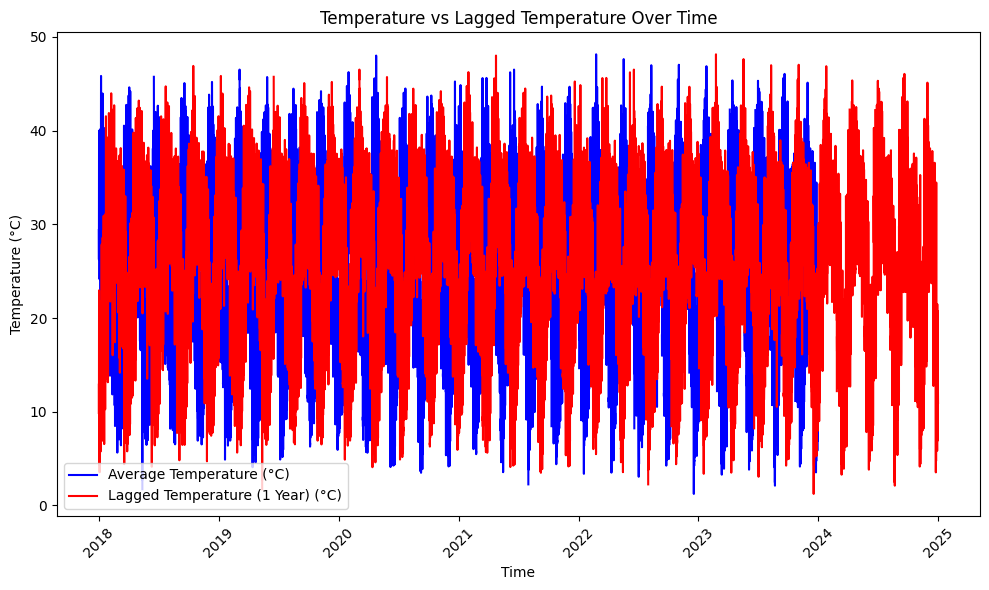

In [ ]:
import matplotlib.pyplot as plt

# Plotting Avg_AT (°C) and lag_1year_T (°C) over time
plt.figure(figsize=(10, 6))

# Plot Average Temperature (Avg_AT)
plt.plot(df['time stamp'], df['Avg_AT (°C)'], label='Average Temperature (°C)', color='blue')

# Plot Lagged Temperature (lag_1year_T)
plt.plot(df['time stamp'], df['lag_1year_T (°C)'], label='Lagged Temperature (1 Year) (°C)', color='red')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Temperature (°C)')
plt.title('Temperature vs Lagged Temperature Over Time')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


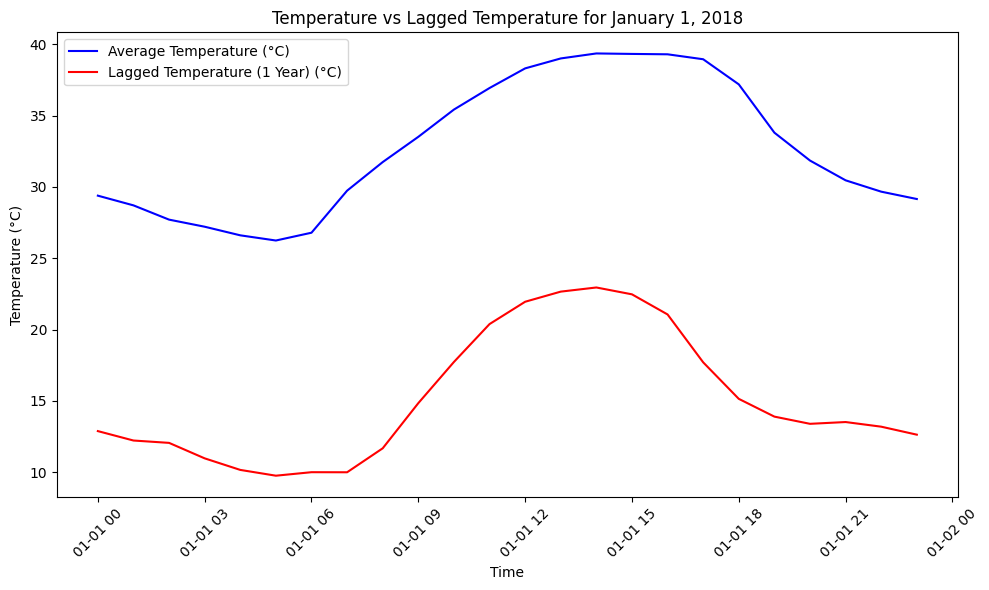

In [ ]:
# Filtering the data for a single day
one_day_data = df[df['time stamp'].dt.date == pd.Timestamp('2018-01-01').date()]

# Plotting for a single day
plt.figure(figsize=(10, 6))

# Plot Average Temperature (Avg_AT) for the selected day
plt.plot(one_day_data['time stamp'], one_day_data['Avg_AT (°C)'], label='Average Temperature (°C)', color='blue')

# Plot Lagged Temperature (lag_1year_T) for the selected day
plt.plot(one_day_data['time stamp'], one_day_data['lag_1year_T (°C)'], label='Lagged Temperature (1 Year) (°C)', color='red')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Temperature (°C)')
plt.title('Temperature vs Lagged Temperature for January 1, 2018')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


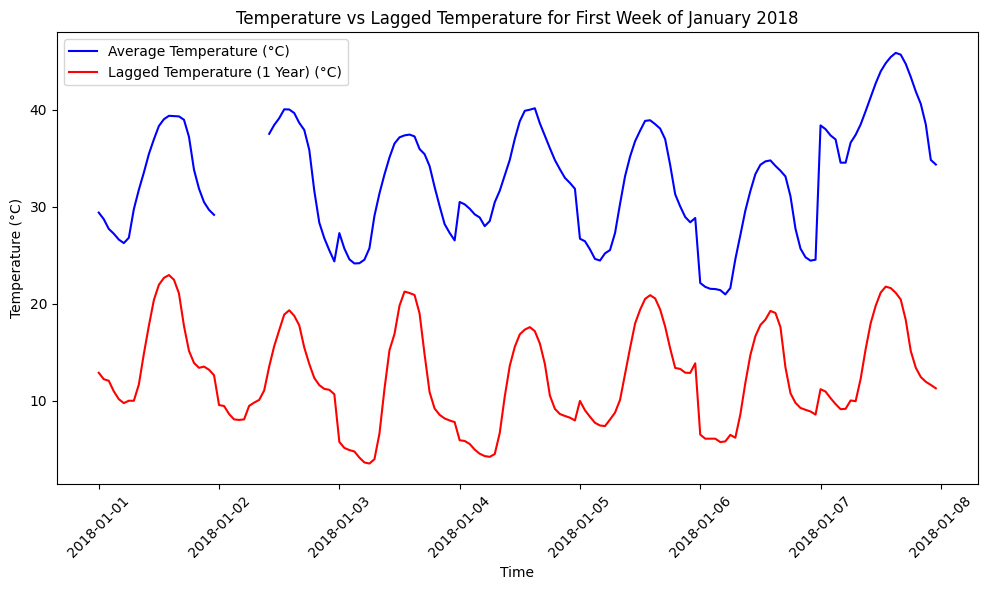

In [ ]:
# Selecting data for multiple days (e.g., the first week of January 2018)
multiple_days_data = df[(df['time stamp'] >= '2018-01-01') & (df['time stamp'] < '2018-01-08')]

# Plotting for multiple days
plt.figure(figsize=(10, 6))

# Plot Average Temperature (Avg_AT) for the selected range
plt.plot(multiple_days_data['time stamp'], multiple_days_data['Avg_AT (°C)'], label='Average Temperature (°C)', color='blue')

# Plot Lagged Temperature (lag_1year_T) for the selected range
plt.plot(multiple_days_data['time stamp'], multiple_days_data['lag_1year_T (°C)'], label='Lagged Temperature (1 Year) (°C)', color='red')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Temperature (°C)')
plt.title('Temperature vs Lagged Temperature for First Week of January 2018')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


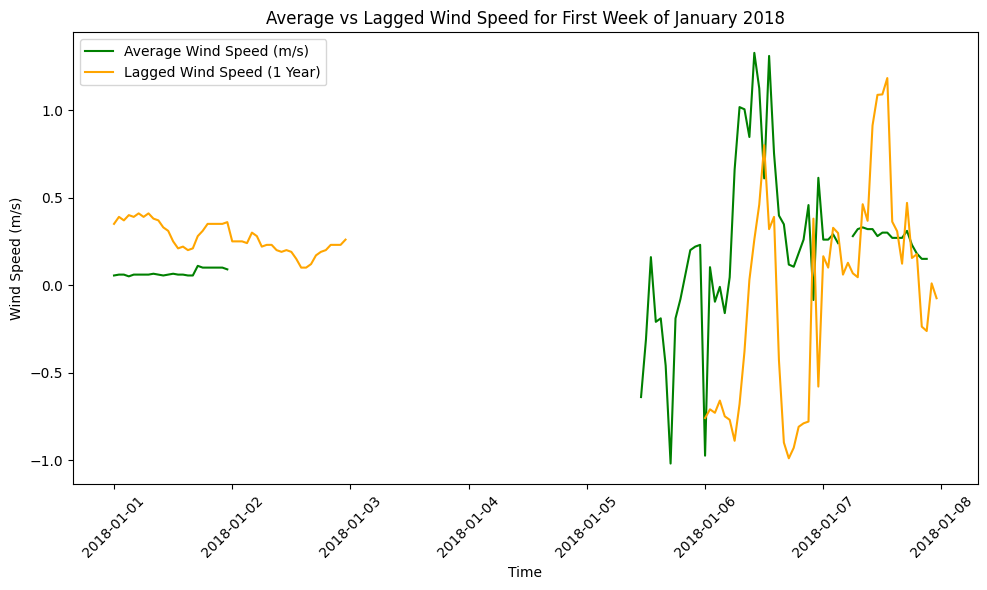

In [ ]:
# Plotting both Average Wind Speed and Lagged Wind Speed for the first week of January 2018

plt.figure(figsize=(10, 6))

# Plot Average Wind Speed for the selected range
plt.plot(multiple_days_data['time stamp'], multiple_days_data['Avg_VWS (m/s)'], label='Average Wind Speed (m/s)', color='green')

# Plot Lagged Wind Speed for the selected range
plt.plot(multiple_days_data['time stamp'], multiple_days_data['lag_1year_Avg_VWS (m/s)'], label='Lagged Wind Speed (1 Year)', color='orange')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Wind Speed (m/s)')
plt.title('Average vs Lagged Wind Speed for First Week of January 2018')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


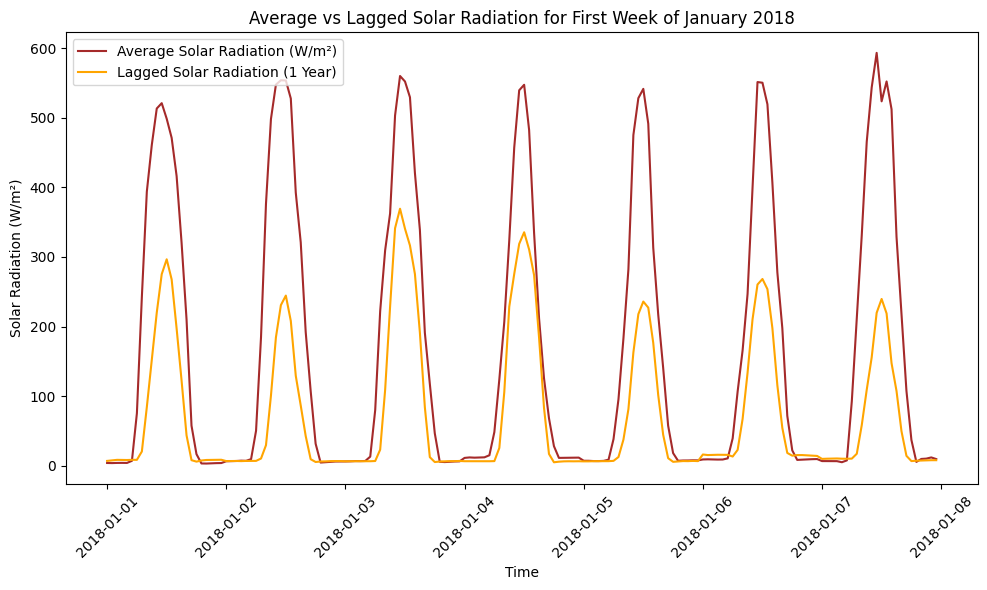

In [ ]:
# Plotting both Average and Lagged Solar Radiation for the first week of January 2018

plt.figure(figsize=(10, 6))

# Plot Average Solar Radiation
plt.plot(multiple_days_data['time stamp'], multiple_days_data['Avg_SR (W/mt2)'], label='Average Solar Radiation (W/m²)', color='brown')

# Plot Lagged Solar Radiation for the selected range (assuming a lagged solar radiation column exists)
plt.plot(multiple_days_data['time stamp'], multiple_days_data['lag_1year_Avg_SR (W/mt2)'], label='Lagged Solar Radiation (1 Year)', color='orange')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Solar Radiation (W/m²)')
plt.title('Average vs Lagged Solar Radiation for First Week of January 2018')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


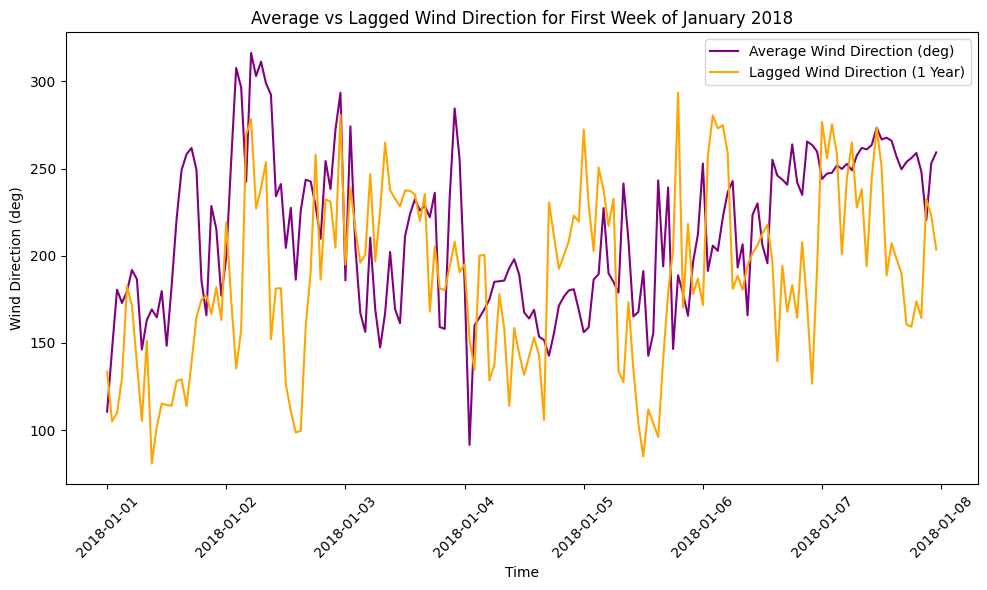

In [ ]:
# Plotting both Average and Lagged Wind Direction for the first week of January 2018

plt.figure(figsize=(10, 6))

# Plot Average Wind Direction
plt.plot(multiple_days_data['time stamp'], multiple_days_data['Avg_WD (deg)'], label='Average Wind Direction (deg)', color='purple')

# Plot Lagged Wind Direction
plt.plot(multiple_days_data['time stamp'], multiple_days_data['lag_1year_Avg_WD (deg)'], label='Lagged Wind Direction (1 Year)', color='orange')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Wind Direction (deg)')
plt.title('Average vs Lagged Wind Direction for First Week of January 2018')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


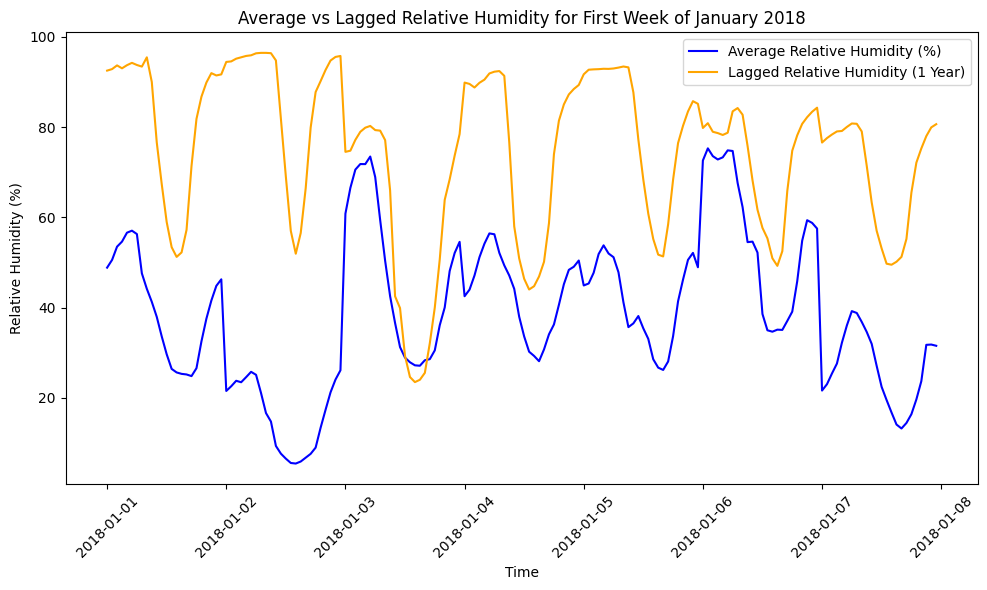

In [ ]:
# Plotting both Average and Lagged Relative Humidity for the first week of January 2018

plt.figure(figsize=(10, 6))

# Plot Average Relative Humidity
plt.plot(multiple_days_data['time stamp'], multiple_days_data['Avg_RH (%)'], label='Average Relative Humidity (%)', color='blue')

# Plot Lagged Relative Humidity
plt.plot(multiple_days_data['time stamp'], multiple_days_data['lag_1year_Avg_RH (%)'], label='Lagged Relative Humidity (1 Year)', color='orange')

# Add labels and title
plt.xlabel('Time')
plt.ylabel('Relative Humidity (%)')
plt.title('Average vs Lagged Relative Humidity for First Week of January 2018')
plt.legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


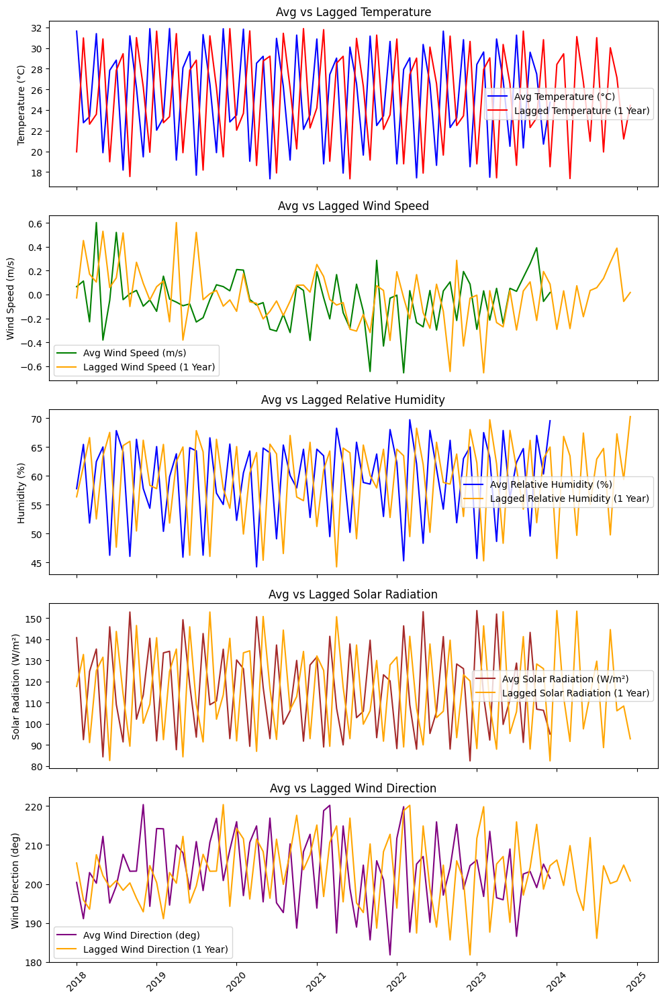

In [ ]:
# Grouping data by Month to calculate the monthly averages
monthly_data = df.groupby(df['time stamp'].dt.to_period('M')).mean()

# Plotting Monthly Averages for all the parameters

fig, axs = plt.subplots(5, 1, figsize=(10, 15), sharex=True)

# Plot Average Temperature and Lagged Temperature
axs[0].plot(monthly_data.index.to_timestamp(), monthly_data['Avg_AT (°C)'], label='Avg Temperature (°C)', color='blue')
axs[0].plot(monthly_data.index.to_timestamp(), monthly_data['lag_1year_T (°C)'], label='Lagged Temperature (1 Year)', color='red')
axs[0].set_ylabel('Temperature (°C)')
axs[0].set_title('Avg vs Lagged Temperature')
axs[0].legend()

# Plot Average Wind Speed and Lagged Wind Speed
axs[1].plot(monthly_data.index.to_timestamp(), monthly_data['Avg_VWS (m/s)'], label='Avg Wind Speed (m/s)', color='green')
axs[1].plot(monthly_data.index.to_timestamp(), monthly_data['lag_1year_Avg_VWS (m/s)'], label='Lagged Wind Speed (1 Year)', color='orange')
axs[1].set_ylabel('Wind Speed (m/s)')
axs[1].set_title('Avg vs Lagged Wind Speed')
axs[1].legend()

# Plot Average Relative Humidity and Lagged Relative Humidity
axs[2].plot(monthly_data.index.to_timestamp(), monthly_data['Avg_RH (%)'], label='Avg Relative Humidity (%)', color='blue')
axs[2].plot(monthly_data.index.to_timestamp(), monthly_data['lag_1year_Avg_RH (%)'], label='Lagged Relative Humidity (1 Year)', color='orange')
axs[2].set_ylabel('Humidity (%)')
axs[2].set_title('Avg vs Lagged Relative Humidity')
axs[2].legend()

# Plot Average Solar Radiation and Lagged Solar Radiation
axs[3].plot(monthly_data.index.to_timestamp(), monthly_data['Avg_SR (W/mt2)'], label='Avg Solar Radiation (W/m²)', color='brown')
axs[3].plot(monthly_data.index.to_timestamp(), monthly_data['lag_1year_Avg_SR (W/mt2)'], label='Lagged Solar Radiation (1 Year)', color='orange')
axs[3].set_ylabel('Solar Radiation (W/m²)')
axs[3].set_title('Avg vs Lagged Solar Radiation')
axs[3].legend()

# Plot Average Wind Direction and Lagged Wind Direction
axs[4].plot(monthly_data.index.to_timestamp(), monthly_data['Avg_WD (deg)'], label='Avg Wind Direction (deg)', color='purple')
axs[4].plot(monthly_data.index.to_timestamp(), monthly_data['lag_1year_Avg_WD (deg)'], label='Lagged Wind Direction (1 Year)', color='orange')
axs[4].set_ylabel('Wind Direction (deg)')
axs[4].set_title('Avg vs Lagged Wind Direction')
axs[4].legend()

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
import numpy as np

# Step 1: Data Preparation

# Selecting relevant columns as features
features = ['Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_RH (%)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)',
            'lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
            'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Ensure there are no missing values in the selected features
df_cleaned = df.dropna(subset=features + ['Avg_PM2.5'])

# Split the data into features (X) and target (y)
X = df_cleaned[features]
y = df_cleaned['Avg_PM2.5']

# Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 2: Train the Random Forest Model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Step 3: Generate new timestamps for 2024
# Create a range of timestamps for 2024 (hourly data for the whole year)
dates_2024 = pd.date_range(start="2024-01-01", end="2024-12-31 23:00:00", freq='H')

# For simplicity, we'll assume similar meteorological data (use average of the last year for features)
avg_values_2023 = df_cleaned[df_cleaned['Year'] == 2023][features].mean()

# Create a DataFrame with the average values repeated for 2024
X_2024 = pd.DataFrame([avg_values_2023] * len(dates_2024), columns=features)
X_2024['time stamp'] = dates_2024

# Step 4: Predict PM2.5 values for 2024 using the trained Random Forest model
predicted_pm25_2024 = rf_model.predict(X_2024[features])

# Add predictions to the DataFrame for 2024
X_2024['Predicted_PM2.5'] = predicted_pm25_2024

# Correcting the date range generation
dates_2024 = pd.date_range(start="2024-01-01", end="2024-12-31 23:00:00", freq='h')

# Assuming the rest of the code remains the same for predictions and data display
# After generating predictions, you can display them using:
X_2024['Predicted_PM2.5'] = predicted_pm25_2024
print(X_2024.head())  # Display the first few rows of the predictions for 2024



   Avg_AT (°C)  Avg_VWS (m/s)  Avg_RH (%)  Avg_WD (deg)  Avg_SR (W/mt2)  \
0    25.257988      -0.006144   60.982838    195.435171      116.004316   
1    25.257988      -0.006144   60.982838    195.435171      116.004316   
2    25.257988      -0.006144   60.982838    195.435171      116.004316   
3    25.257988      -0.006144   60.982838    195.435171      116.004316   
4    25.257988      -0.006144   60.982838    195.435171      116.004316   

   lag_1year_T (°C)  lag_1year_Avg_VWS (m/s)  lag_1year_Avg_RH (%)  \
0         24.200857                -0.130018             60.472553   
1         24.200857                -0.130018             60.472553   
2         24.200857                -0.130018             60.472553   
3         24.200857                -0.130018             60.472553   
4         24.200857                -0.130018             60.472553   

   lag_1year_Avg_WD (deg)  lag_1year_Avg_SR (W/mt2)          time stamp  \
0              202.019095                 108.24632 2

<ipython-input-49-a93eb64c025e>:28: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  dates_2024 = pd.date_range(start="2024-01-01", end="2024-12-31 23:00:00", freq='H')


In [ ]:
pip install ace_tools

In [ ]:
import pandas as pd
import joblib
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

# Step 1: Load the dataset
# Replace 'your_file.xlsx' with the actual path to your dataset
df = pd.read_excel('/content/for_delhi_lagged.xlsx')

# Step 2: Prepare lagged features (assuming the data has these columns)
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']

# Dropping rows with missing PM2.5 values
df_cleaned = df.dropna(subset=['Avg_PM2.5'])

# Prepare the features and target
X = df_cleaned[lagged_features]  # Use only the lagged features
y = df_cleaned['Avg_PM2.5']  # Target is PM2.5

# Step 3: Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train the Random Forest model
rf_model_lagged = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_lagged.fit(X_train, y_train)

# Step 5: Save the model to a file for later use
joblib.dump(rf_model_lagged, 'rf_model_lagged_pm25.pkl')

# Step 6: Load the model (for inference or further use)
rf_model_lagged = joblib.load('rf_model_lagged_pm25.pkl')

# Step 7: Predict PM2.5 using the test set (or new data)
y_pred = rf_model_lagged.predict(X_test)

# Example: To predict for a new dataset with lagged features
# Load or prepare the new data with lagged features (replace 'new_data.xlsx')
new_data = pd.read_excel('new_data.xlsx')

# Interpolate missing values in the lagged features
X_new_lagged = new_data[lagged_features].interpolate(method='linear')

# Predict PM2.5 for the new data
predicted_pm25_new = rf_model_lagged.predict(X_new_lagged)

# Print the predictions
print(predicted_pm25_new)


FileNotFoundError: [Errno 2] No such file or directory: 'new_data.xlsx'

In [ ]:
# Step 1: Filter the data for the years 2018 to 2023 for training and testing
df_filtered = df[(df['Year'] >= 2018) & (df['Year'] <= 2023)]

# Dropping rows with missing PM2.5 values for training
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])

# Step 2: Prepare lagged features and target
X_train_lagged = df_filtered_cleaned[lagged_features]  # Use only the lagged features
y_train = df_filtered_cleaned['Avg_PM2.5']  # Target is PM2.5

# Step 3: Filter the data for 2024 to use it for prediction (only lagged features)
df_2024 = df[df['Year'] == 2024]

# Applying linear interpolation to fill missing values in the lagged features for 2024
X_2024_lagged_interpolated = df_2024[lagged_features].interpolate(method='linear')

# Step 4: Train the Random Forest model using 2018-2023 data
rf_model_lagged = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_lagged.fit(X_train_lagged, y_train)

# Step 5: Predict PM2.5 for 2024 using the lagged features
predicted_pm25_2024 = rf_model_lagged.predict(X_2024_lagged_interpolated)

# Adding the predicted PM2.5 values to the 2024 dataset
df_2024['Predicted_PM2.5'] = predicted_pm25_2024

# Display the first few rows of the predicted PM2.5 values for 2024
print(df_2024[['time stamp', 'Predicted_PM2.5']].head())

# Alternatively, if you want to save the results to a CSV file for further use:
df_2024[['time stamp', 'Predicted_PM2.5']].to_csv('predicted_pm25_2024.csv', index=False)
print("The predicted PM2.5 values for 2024 have been saved to 'predicted_pm25_2024.csv'.")



               time stamp  Predicted_PM2.5
52584 2024-01-01 00:00:00       100.015869
52585 2024-01-01 01:00:00        97.590386
52586 2024-01-01 02:00:00       104.808262
52587 2024-01-01 03:00:00       104.369054
52588 2024-01-01 04:00:00       114.240200
The predicted PM2.5 values for 2024 have been saved to 'predicted_pm25_2024.csv'.


<ipython-input-52-8b92cc79fa82>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2024['Predicted_PM2.5'] = predicted_pm25_2024


In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import numpy as np

# Step 1: Filter the data for the years 2018 to 2023
df_filtered = df[(df['Year'] >= 2018) & (df['Year'] <= 2023)]

# Dropping rows with missing PM2.5 values for training and testing
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])

# Step 2: Prepare lagged features and target
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']
X = df_filtered_cleaned[lagged_features]  # Use only lagged features
y = df_filtered_cleaned['Avg_PM2.5']  # Target is PM2.5

# Step 3: Split data into training and testing sets (e.g., 80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train the Random Forest model on the training set
rf_model_lagged = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_lagged.fit(X_train, y_train)

# Step 5: Predict PM2.5 on the test set
y_pred = rf_model_lagged.predict(X_test)

# Step 6: Calculate accuracy metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print the accuracy metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)


Mean Absolute Error (MAE): 58.673102609874626
Mean Squared Error (MSE): 6440.538905115121
Root Mean Squared Error (RMSE): 80.25296820127666
R² Score: 0.11518727337536405


Mean Absolute Error (MAE): 17.603367340427848
Mean Squared Error (MSE): 952.9493823392551
Root Mean Squared Error (RMSE): 30.869878236547276
R² Score: 0.8690821135086696


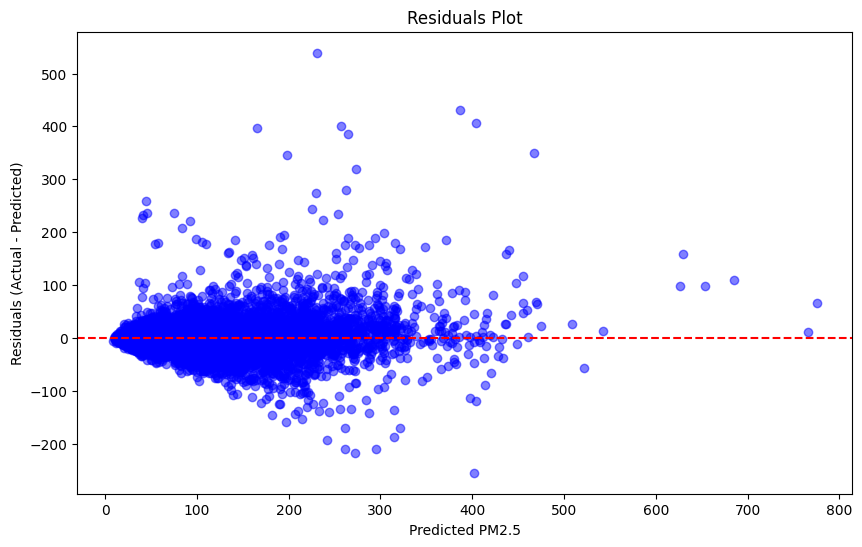

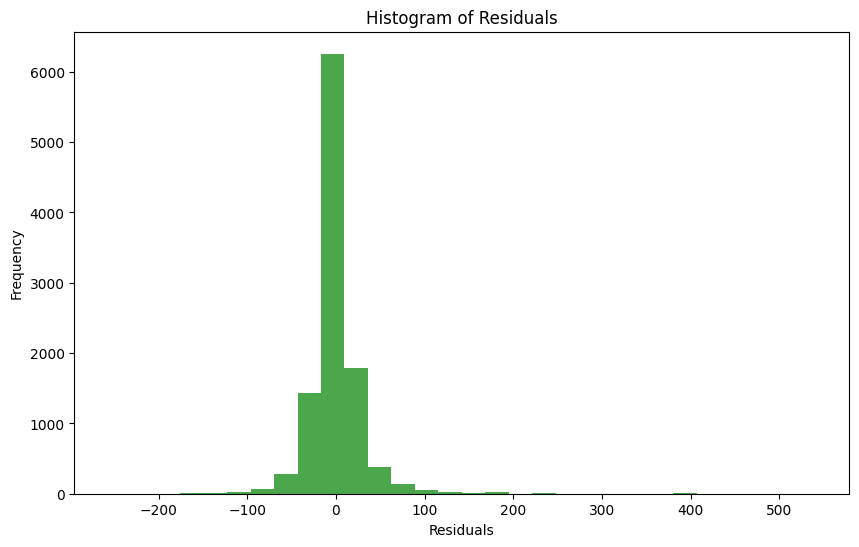

In [ ]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
import numpy as np
import matplotlib.pyplot as plt

# Step 1: Filter the data for the years 2018 to 2023
df_filtered = df[(df['Year'] >= 2018) & (df['Year'] <= 2023)]

# Dropping rows with missing PM2.5 values for training and testing
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])

# Step 2: Prepare lagged features, temporal features (Hour, Day, Month, Year), and target
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)']
temporal_features = ['Hour', 'Day', 'Month', 'Year']

# Combine lagged features and temporal features
X = df_filtered_cleaned[lagged_features + temporal_features]  # Use lagged + temporal features
y = df_filtered_cleaned['Avg_PM2.5']  # Target is PM2.5

# Step 3: Split data into training and testing sets (e.g., 80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 4: Train the Random Forest model on the training set
rf_model_lagged = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_lagged.fit(X_train, y_train)

# Step 5: Predict PM2.5 on the test set
y_pred = rf_model_lagged.predict(X_test)

# Step 6: Calculate accuracy metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print the accuracy metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Step 7: Visualize residuals
residuals = y_test - y_pred

# Scatter plot of predicted vs residuals
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, color='blue', alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals Plot")
plt.xlabel("Predicted PM2.5")
plt.ylabel("Residuals (Actual - Predicted)")
plt.show()

# Histogram of residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='green', alpha=0.7)
plt.title("Histogram of Residuals")
plt.xlabel("Residuals")
plt.ylabel("Frequency")
plt.show()


Mean Absolute Error (MAE): 38.95850151250761
Mean Squared Error (MSE): 3180.7913817231224
Root Mean Squared Error (RMSE): 56.39850513730947
R² Score: 0.4543220200208542


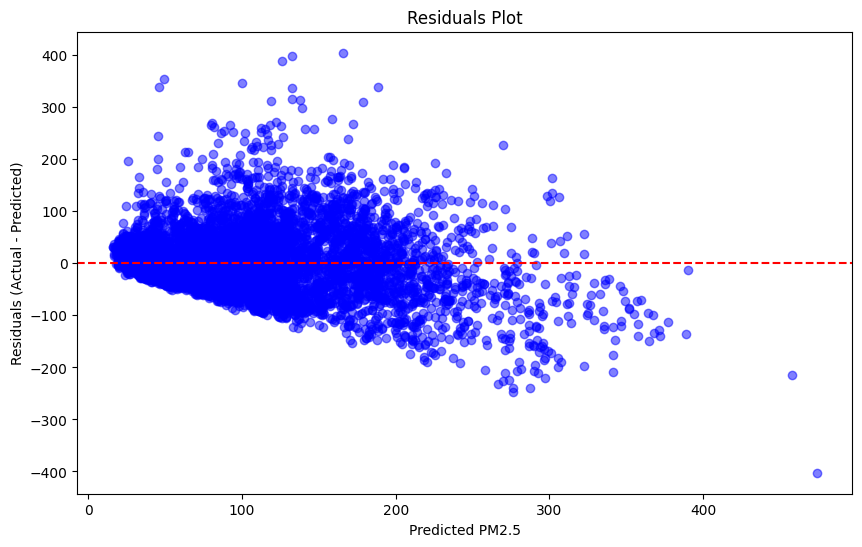

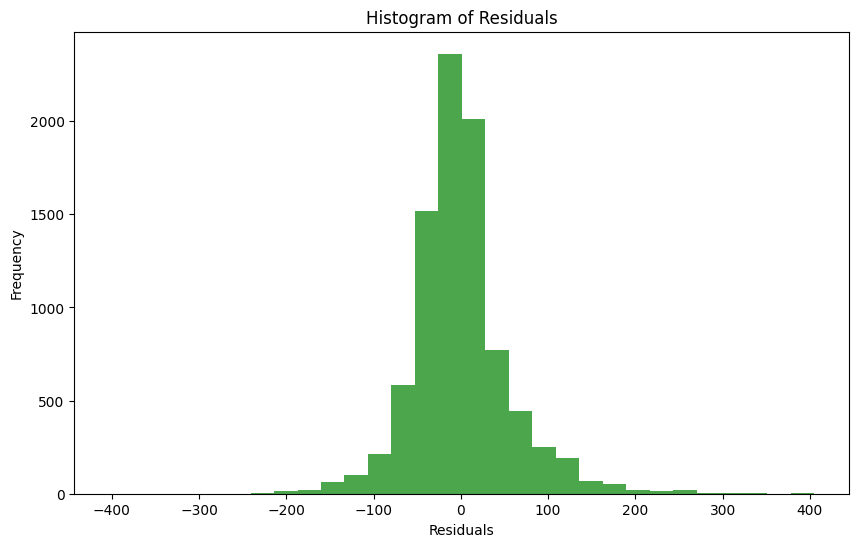

<ipython-input-10-963febd81858>:82: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2024['Predicted_PM2.5'] = predicted_pm25_2024


KeyError: "['time stamp'] not in index"

In [ ]:
# Step 1: Load the dataset
import pandas as pd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
import numpy as np
import matplotlib.pyplot as plt

# Load the dataset
df = pd.read_excel('/content/Copy of lagged_till_2024(1)WITH_RAINFALL.xlsx')

# Step 2: Filter the data for the years 2018 to 2022 for training and 2023 for testing
df_train = df[(df['Year'] >= 2018) & (df['Year'] <= 2022)]
df_test = df[df['Year'] == 2023]

# Dropping rows with missing PM2.5 values in training and testing data
df_train_cleaned = df_train.dropna(subset=['Avg_PM2.5'])
df_test_cleaned = df_test.dropna(subset=['Avg_PM2.5'])

# Step 3: Prepare lagged features, temporal features (Hour, Day, Month, Year), and target
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)', "lag_1year_TOT-RF (mm)"]
temporal_features = ['Hour', 'Day', 'Month', 'Year']

# Combine lagged and temporal features
X_train = df_train_cleaned[lagged_features + temporal_features]  # Use lagged + temporal features for training
y_train = df_train_cleaned['Avg_PM2.5']  # Target variable for training

X_test = df_test_cleaned[lagged_features + temporal_features]  # Use lagged + temporal features for testing
y_test = df_test_cleaned['Avg_PM2.5']  # Target variable for testing

# Step 4: Train the Random Forest model on the training set
rf_model_lagged = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model_lagged.fit(X_train, y_train)

# Step 5: Predict PM2.5 on the test set (2023)
y_pred = rf_model_lagged.predict(X_test)

# Step 6: Calculate accuracy metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print the accuracy metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Step 7: Visualize residuals
residuals = y_test - y_pred

# Scatter plot of predicted vs residuals
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, color='blue', alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals Plot")
plt.xlabel("Predicted PM2.5")
plt.ylabel("Residuals (Actual - Predicted)")
plt.show()

# Histogram of residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='green', alpha=0.7)
plt.title("Histogram of Residuals")
plt.xlabel("Residuals")
plt.ylabel("Frequency")
plt.show()

# Step 8: Prepare the data for 2024 prediction
df_2024 = df[df['Year'] == 2024]

# Step 9: Prepare lagged and temporal features for 2024 (interpolate missing values)
X_2024 = df_2024[lagged_features + temporal_features]
X_2024_lagged_interpolated = X_2024.interpolate(method='linear')

# Step 10: Use the trained model to predict PM2.5 for 2024
predicted_pm25_2024 = rf_model_lagged.predict(X_2024_lagged_interpolated)

# Step 11: Add the predicted PM2.5 values to the 2024 dataset
df_2024['Predicted_PM2.5'] = predicted_pm25_2024

# Step 12: Display the first few rows of the predicted PM2.5 values for 2024
print(df_2024[['time stamp', 'Predicted_PM2.5']].head())

# Step 13: Save the predictions to a CSV file for further use
df_2024[['time stamp', 'Predicted_PM2.5']].to_csv('predicted_pm25_2024.csv', index=False)
print("The predicted PM2.5 values for 2024 have been saved to 'predicted_pm25_2024.csv'.")


<ipython-input-11-64071481149c>:22: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  df = df.set_index('Timestamp').resample('H').mean()
<ipython-input-11-64071481149c>:82: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df[lagged_features] = df[lagged_features].fillna(method='ffill')


Mean Absolute Error (MAE): 36.434369339791516
Mean Squared Error (MSE): 2584.2013291433736
Root Mean Squared Error (RMSE): 50.8350403672838
R² Score: 0.5231990572152786


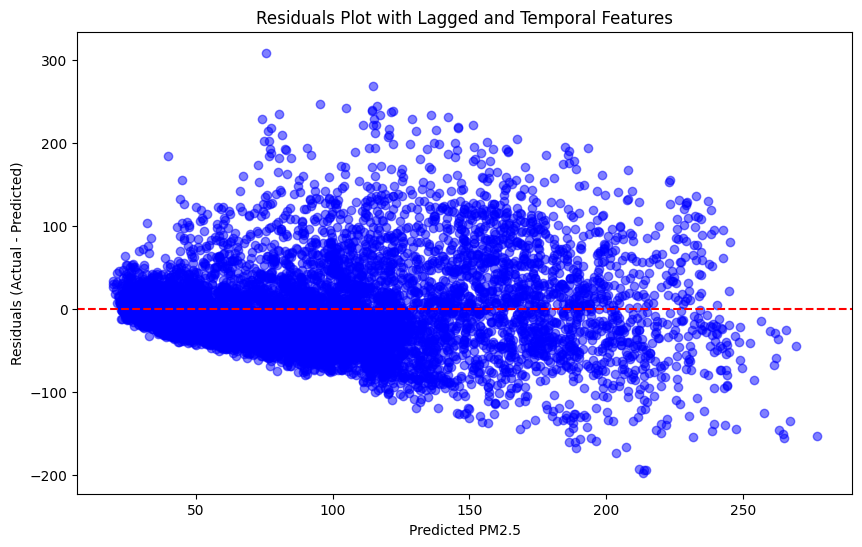

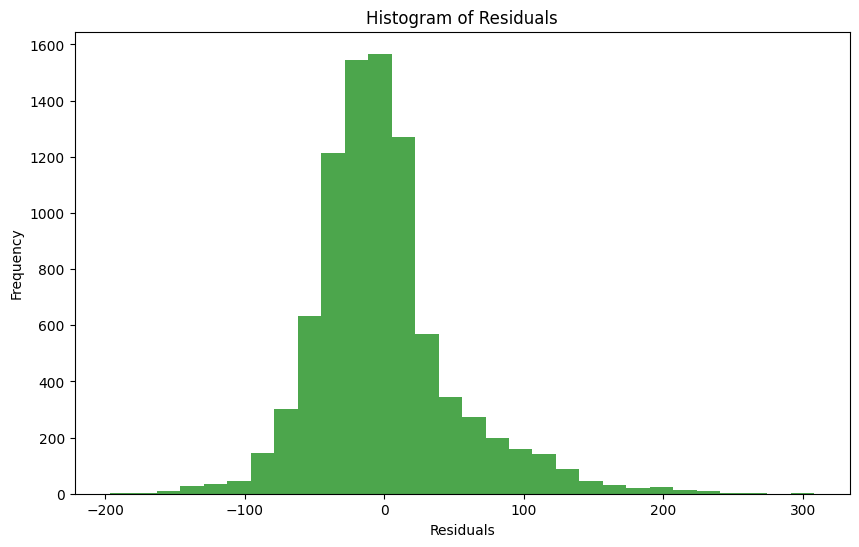

In [ ]:
# Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler, PowerTransformer
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from statsmodels.tsa.seasonal import STL
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Copy of lagged_till_2024(1)WITH_RAINFALL.xlsx'
df = pd.read_excel(file_path, sheet_name='Sheet1')

# Define initial features and target variable
features = ['Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_RH (%)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']
target = 'Avg_PM2.5'

# Convert Timestamp to datetime format
df['Timestamp'] = pd.to_datetime(df['Timestamp'])

# Set Timestamp as the index and regularize to hourly frequency
df = df.set_index('Timestamp').resample('H').mean()

# Interpolate missing values
df[features + [target]] = df[features + [target]].interpolate(method='linear', limit_direction='forward')

# Add time-based features
df['hour'] = df.index.hour
df['day_of_week'] = df.index.dayofweek
df['month'] = df.index.month
features.extend(['hour', 'day_of_week', 'month'])

# Define month, hour, and year-based weights
month_weights = {1: 1.0, 2: 0.8, 3: 0.6, 4: 0.4, 5: 0.2, 6: 0.1, 7: 0.1, 8: 0.1, 9: 0.2, 10: 0.6, 11: 0.9, 12: 1.0}
hour_weights = {0: 0.9, 1: 0.9, 2: 0.9, 3: 0.9, 4: 0.8, 5: 0.7, 6: 0.6, 7: 0.5, 8: 0.5, 9: 0.4, 10: 0.3, 11: 0.3,
                12: 0.3, 13: 0.3, 14: 0.2, 15: 0.2, 16: 0.3, 17: 0.4, 18: 0.5, 19: 0.6, 20: 0.7, 21: 0.8, 22: 0.9, 23: 0.9}
year_weights = {2017: 1.0, 2018: 0.9, 2019: 0.8, 2020: 0.5, 2021: 0.7, 2022: 0.9, 2023: 1.0}

# Apply weights as new features
df['PM2.5_month_weight'] = df['month'].map(month_weights)
df['PM2.5_hour_weight'] = df['hour'].map(hour_weights)
df['PM2.5_year_weight'] = df.index.year.map(year_weights)
features.extend(['PM2.5_month_weight', 'PM2.5_hour_weight', 'PM2.5_year_weight'])

# Outlier detection and removal for PM2.5 using IQR
Q1 = df[target].quantile(0.25)
Q3 = df[target].quantile(0.75)
IQR = Q3 - Q1
df = df[(df[target] >= Q1 - 1.5 * IQR) & (df[target] <= Q3 + 1.5 * IQR)]

# Scaling and normalization
# Apply Power Transformation
power_transformer = PowerTransformer(method='yeo-johnson')
df[features] = power_transformer.fit_transform(df[features])

# Standard Scaling
scaler = StandardScaler()
df[features] = scaler.fit_transform(df[features])

# Non-stationarity transformations
df['PM2.5_diff'] = df[target].diff()
df['PM2.5_log'] = np.log1p(df[target])

# Decomposition using STL
stl = STL(df[target].ffill(), period=24)  # Assuming daily seasonality with 24-hour period
result = stl.fit()
df['trend'] = result.trend
df['seasonal'] = result.seasonal
df['residual'] = result.resid

# Fourier Transform for cyclic patterns
df['fourier_hourly'] = np.sin(2 * np.pi * df['hour'] / 24)
df['fourier_daily'] = np.sin(2 * np.pi * df['day_of_week'] / 7)
df['fourier_monthly'] = np.sin(2 * np.pi * df['month'] / 12)

# Add lagged features
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)', "lag_1year_TOT-RF (mm)"]
temporal_features = ['Hour', 'Day', 'Month', 'Year']

# Ensure lagged data is present; add it to final features
df[lagged_features] = df[lagged_features].fillna(method='ffill')
final_features = features + lagged_features + temporal_features + ['fourier_hourly', 'fourier_daily', 'fourier_monthly']

# Drop rows with NaN values after transformations
df.dropna(subset=final_features + [target], inplace=True)

# Split into training and test sets (train on data till 2022, test on 2023)
train_data = df[df.index.year <= 2022]
test_data = df[df.index.year == 2023]

X_train = train_data[final_features].values
y_train = train_data[target].values
X_test = test_data[final_features].values
y_test = test_data[target].values

# Train Random Forest model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predict on the test set (2023)
y_pred = rf_model.predict(X_test)

# Calculate accuracy metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print the accuracy metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Visualize residuals
residuals = y_test - y_pred

# Scatter plot of predicted vs residuals
plt.figure(figsize=(10, 6))
plt.scatter(y_pred, residuals, color='blue', alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.title("Residuals Plot with Lagged and Temporal Features")
plt.xlabel("Predicted PM2.5")
plt.ylabel("Residuals (Actual - Predicted)")
plt.show()

# Histogram of residuals
plt.figure(figsize=(10, 6))
plt.hist(residuals, bins=30, color='green', alpha=0.7)
plt.title("Histogram of Residuals")
plt.xlabel("Residuals")
plt.ylabel("Frequency")
plt.show()


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# Step 1: Load the dataset
df = pd.read_excel('/content/for_delhi_lagged.xlsx')

# Step 2: Filter the data for the years 2018 to 2023 for training and testing
df_filtered = df[(df['Year'] >= 2018) & (df['Year'] <= 2023)]

# Dropping rows with missing PM2.5 values for training and testing
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])

# Step 3: Prepare lagged features and target
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)', 'Hour', 'Day', 'Month', 'Year']
X = df_filtered_cleaned[lagged_features]
y = df_filtered_cleaned['Avg_PM2.5']

# Step 4: Handle missing values using interpolation
X = X.interpolate(method='linear')

# Step 5: Split data into training and testing sets (e.g., 80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 6: Initialize models
models = {
    "Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
    "Gradient Boosting": GradientBoostingRegressor(n_estimators=100, random_state=42),
    "Support Vector Regression": SVR(),
    "Linear Regression": LinearRegression()
}

# Step 7: Train and evaluate models
results = {}

for model_name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculate evaluation metrics
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)

    # Store results
    results[model_name] = {
        "MAE": mae,
        "MSE": mse,
        "RMSE": rmse,
        "R² Score": r2
    }

# Step 8: Display results
results_df = pd.DataFrame(results).T
print("Model Performance Comparison:")
print(results_df)

# Step 9: Identify the best model based on R² score
best_model = results_df['R² Score'].idxmax()
print("\nBest Model:", best_model)


Model Performance Comparison:
                                 MAE          MSE       RMSE  R² Score
Random Forest              17.266335   903.936335  30.065534  0.875816
Gradient Boosting          35.425301  3022.063869  54.973301  0.584823
Support Vector Regression  58.919549  8081.408181  89.896653 -0.110238
Linear Regression          61.779507  7047.754255  83.950904  0.031767

Best Model: Random Forest



Best Model: Random Forest


<ipython-input-5-bb576bda6548>:73: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2024['Predicted_PM2.5'] = predicted_pm25_2024


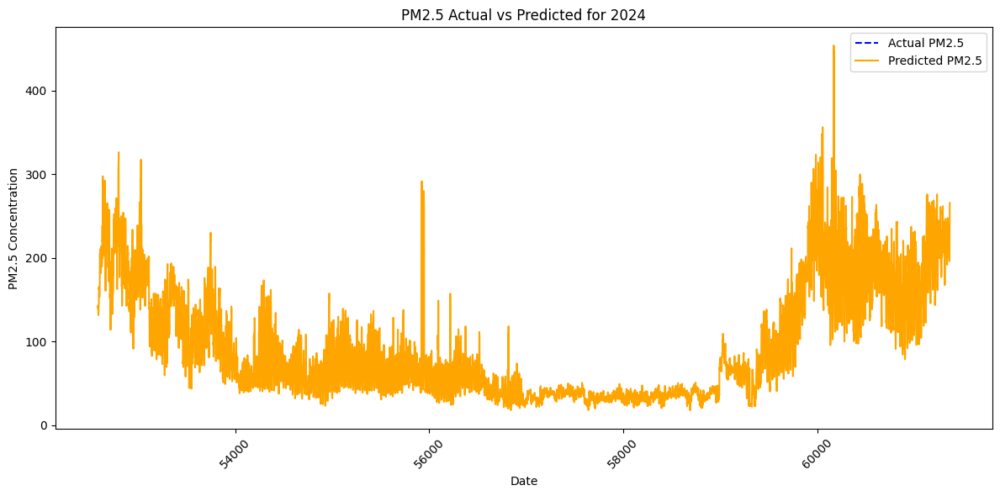

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Step 1: Load the dataset
df = pd.read_excel('/content/for_delhi_lagged.xlsx')

# Step 2: Filter the data for the years 2018 to 2023 for training and testing
df_filtered = df[(df['Year'] >= 2018) & (df['Year'] <= 2023)]
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])

# Step 3: Prepare lagged features and target
lagged_features = ['lag_1year_T (°C)', 'lag_1year_Avg_VWS (m/s)', 'lag_1year_Avg_RH (%)',
                   'lag_1year_Avg_WD (deg)', 'lag_1year_Avg_SR (W/mt2)', 'Hour', 'Day', 'Month', 'Year']
X = df_filtered_cleaned[lagged_features]
y = df_filtered_cleaned['Avg_PM2.5']

# Step 4: Handle missing values using interpolation
X = X.interpolate(method='linear')

# Step 5: Split data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 6: Initialize models
models = {
    "Random Forest": RandomForestRegressor(n_estimators=100, random_state=42),
    "Gradient Boosting": GradientBoostingRegressor(n_estimators=100, random_state=42),
    "Support Vector Regression": SVR(),
    "Linear Regression": LinearRegression()
}

# Step 7: Train and evaluate models
results = {}
for model_name, model in models.items():
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Calculate evaluation metrics
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)

    # Store results
    results[model_name] = {
        "MAE": mae,
        "MSE": mse,
        "RMSE": rmse,
        "R² Score": r2
    }

# Step 8: Identify the best model based on R² score
best_model = max(results, key=lambda x: results[x]['R² Score'])
print("\nBest Model:", best_model)

# Step 9: Prepare the data for 2024 prediction
df_2024 = df[df['Year'] == 2024]

# Prepare lagged features for 2024
X_2024 = df_2024[lagged_features].interpolate(method='linear')

# Use the best model to predict PM2.5 for 2024
best_model_instance = models[best_model]
best_model_instance.fit(X, y)  # Fit on all available data
predicted_pm25_2024 = best_model_instance.predict(X_2024)

# Add predicted values to the 2024 DataFrame
df_2024['Predicted_PM2.5'] = predicted_pm25_2024

# Step 10: Plot the actual vs. predicted PM2.5 values for 2024
plt.figure(figsize=(12, 6))
plt.plot(df_2024.index, df_2024['Avg_PM2.5'], label='Actual PM2.5', color='blue', linestyle='--')
plt.plot(df_2024.index, df_2024['Predicted_PM2.5'], label='Predicted PM2.5', color='orange')
plt.title('PM2.5 Actual vs Predicted for 2024')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


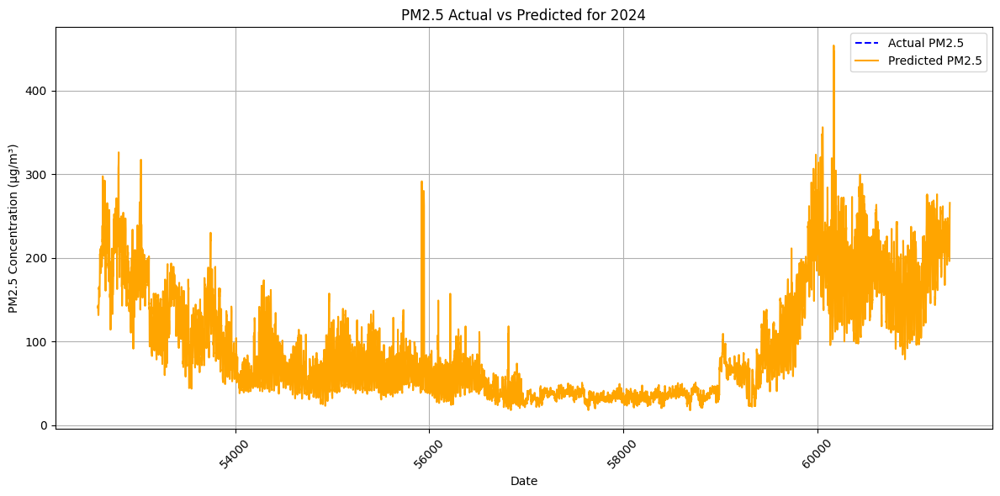

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot(df_2024.index, df_2024['Avg_PM2.5'], label='Actual PM2.5', color='blue', linestyle='--')
plt.plot(df_2024.index, df_2024['Predicted_PM2.5'], label='Predicted PM2.5', color='orange')
plt.title('PM2.5 Actual vs Predicted for 2024')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid()
plt.show()


First few rows of the dataset:
            Timestamp  Sirifort_PM2.5  IHBAS_PM2.5  Sonia_Vihar_PM2.5  \
0 2017-01-01 00:00:00          272.83       115.87                NaN   
1 2017-01-01 01:00:00          233.47       115.15                NaN   
2 2017-01-01 02:00:00          206.17       116.53                NaN   
3 2017-01-01 03:00:00          195.85       114.00                NaN   
4 2017-01-01 04:00:00          186.70       113.70                NaN   

   mandir_marg_PM2.5   Avg_PM2.5  Avg_PM10 (µg/m³)  Avg_NO2 (µg/m³)  \
0             227.83  205.510000            302.83        68.926667   
1             224.17  190.930000            255.00        56.870000   
2             200.50  174.400000            240.00        52.853333   
3             154.83  154.893333            211.67        44.416667   
4             164.00  154.800000            205.67        35.743333   

   Avg_AT (°C)  Avg_VWS (m/s)  Avg_O Xylene (µg/m³)  Avg_SO2 (µg/m³)  \
0       12.890           0.35  

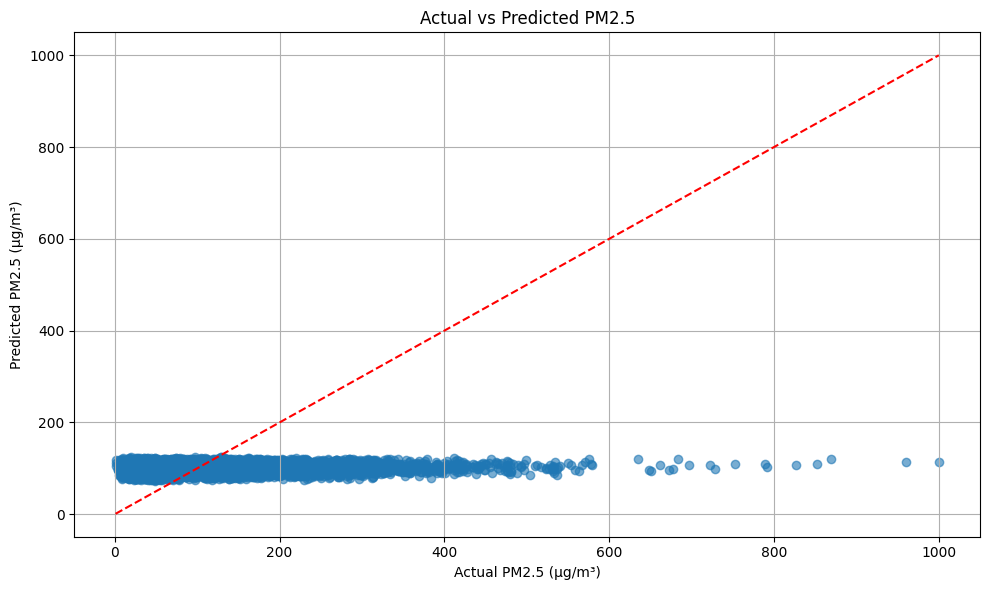

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Step 1: Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Update this path with the actual file path
df = pd.read_excel(file_path)

# Step 2: Display the first few rows and the columns to understand its structure
print("First few rows of the dataset:")
print(df.head())
print("Column Names:", df.columns.tolist())  # List all column names

# Step 3: Check if 'Year' column exists; if not, extract it from the date column
if 'Year' not in df.columns:
    if 'Timestamp' in df.columns:  # Replace with the actual date column name if different
        df['Year'] = pd.to_datetime(df['Timestamp']).dt.year
    else:
        raise Exception("No 'Year' or 'Timestamp' column found in the dataset.")

# Step 4: Filter the data for the years 2017 to 2023
df_filtered = df[(df['Year'] >= 2017) & (df['Year'] <= 2023)]
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])  # Drop rows with missing PM2.5 values

# Step 5: Prepare average features (update these with actual feature names from your dataset)
average_features = ['Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_RH (%)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']  # Example features
X = df_filtered_cleaned[average_features]
y = df_filtered_cleaned['Avg_PM2.5']

# Check for missing values in features
print("Missing values in features:")
print(X.isnull().sum())

# Handle missing values in features if any
X = X.interpolate(method='linear')  # Interpolation to fill NaN values

# Verify if any missing values remain
print("Missing values after interpolation:")
print(X.isnull().sum())

# Step 6: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 7: Model Training
model = LinearRegression()
model.fit(X_train, y_train)

# Step 8: Prediction and Evaluation
y_pred = model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Display evaluation metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Step 9: Visualization
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, alpha=0.6)
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='--')  # Ideal line
plt.title('Actual vs Predicted PM2.5')
plt.xlabel('Actual PM2.5 (µg/m³)')
plt.ylabel('Predicted PM2.5 (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


First few rows of the dataset:
            Timestamp  Sirifort_PM2.5  IHBAS_PM2.5  Sonia_Vihar_PM2.5  \
0 2017-01-01 00:00:00          272.83       115.87                NaN   
1 2017-01-01 01:00:00          233.47       115.15                NaN   
2 2017-01-01 02:00:00          206.17       116.53                NaN   
3 2017-01-01 03:00:00          195.85       114.00                NaN   
4 2017-01-01 04:00:00          186.70       113.70                NaN   

   mandir_marg_PM2.5   Avg_PM2.5  Avg_PM10 (µg/m³)  Avg_NO2 (µg/m³)  \
0             227.83  205.510000            302.83        68.926667   
1             224.17  190.930000            255.00        56.870000   
2             200.50  174.400000            240.00        52.853333   
3             154.83  154.893333            211.67        44.416667   
4             164.00  154.800000            205.67        35.743333   

   Avg_AT (°C)  Avg_VWS (m/s)  Avg_O Xylene (µg/m³)  Avg_SO2 (µg/m³)  \
0       12.890           0.35  

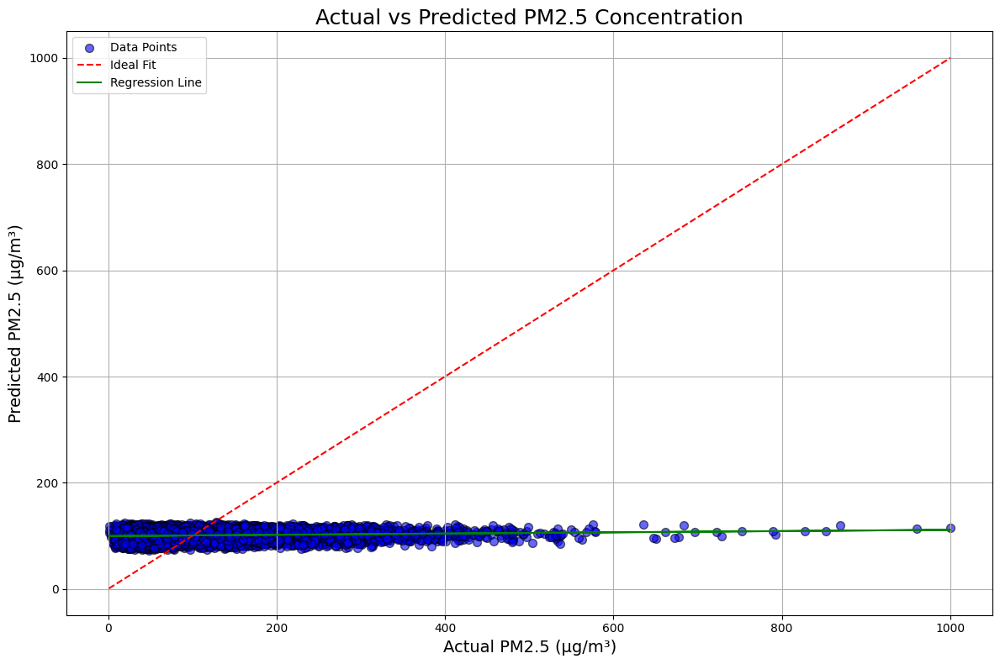

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Step 1: Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Update this path with the actual file path
df = pd.read_excel(file_path)

# Step 2: Display the first few rows and the columns to understand its structure
print("First few rows of the dataset:")
print(df.head())
print("Column Names:", df.columns.tolist())  # List all column names

# Step 3: Check if 'Year' column exists; if not, extract it from the date column
if 'Year' not in df.columns:
    if 'Timestamp' in df.columns:  # Replace with the actual date column name if different
        df['Year'] = pd.to_datetime(df['Timestamp']).dt.year
    else:
        raise Exception("No 'Year' or 'Timestamp' column found in the dataset.")

# Step 4: Filter the data for the years 2017 to 2023
df_filtered = df[(df['Year'] >= 2017) & (df['Year'] <= 2023)]
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])  # Drop rows with missing PM2.5 values

# Step 5: Prepare average features (update these with actual feature names from your dataset)
average_features = ['Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_RH (%)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']  # Example features
X = df_filtered_cleaned[average_features]
y = df_filtered_cleaned['Avg_PM2.5']

# Check for missing values in features
print("Missing values in features:")
print(X.isnull().sum())

# Handle missing values in features if any
X = X.interpolate(method='linear')  # Interpolation to fill NaN values

# Verify if any missing values remain
print("Missing values after interpolation:")
print(X.isnull().sum())

# Step 6: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 7: Model Training
model = LinearRegression()
model.fit(X_train, y_train)

# Step 8: Prediction and Evaluation
y_pred = model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Display evaluation metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Step 9: Improved Visualization
plt.figure(figsize=(12, 8))
plt.scatter(y_test, y_pred, alpha=0.6, color='blue', edgecolor='k', s=50, label='Data Points')
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='--', label='Ideal Fit')  # Ideal line

# Adding Regression Line
slope, intercept = np.polyfit(y_test, y_pred, 1)
plt.plot(y_test, slope * y_test + intercept, color='green', label='Regression Line')

# Adding Titles and Labels
plt.title('Actual vs Predicted PM2.5 Concentration', fontsize=18)
plt.xlabel('Actual PM2.5 (µg/m³)', fontsize=14)
plt.ylabel('Predicted PM2.5 (µg/m³)', fontsize=14)
plt.legend()
plt.grid(True)

# Show plot with improved layout
plt.tight_layout()
plt.show()


First few rows of the dataset:
            Timestamp  Sirifort_PM2.5  IHBAS_PM2.5  Sonia_Vihar_PM2.5  \
0 2017-01-01 00:00:00          272.83       115.87                NaN   
1 2017-01-01 01:00:00          233.47       115.15                NaN   
2 2017-01-01 02:00:00          206.17       116.53                NaN   
3 2017-01-01 03:00:00          195.85       114.00                NaN   
4 2017-01-01 04:00:00          186.70       113.70                NaN   

   mandir_marg_PM2.5   Avg_PM2.5  Avg_PM10 (µg/m³)  Avg_NO2 (µg/m³)  \
0             227.83  205.510000            302.83        68.926667   
1             224.17  190.930000            255.00        56.870000   
2             200.50  174.400000            240.00        52.853333   
3             154.83  154.893333            211.67        44.416667   
4             164.00  154.800000            205.67        35.743333   

   Avg_AT (°C)  Avg_VWS (m/s)  Avg_O Xylene (µg/m³)  Avg_SO2 (µg/m³)  \
0       12.890           0.35  

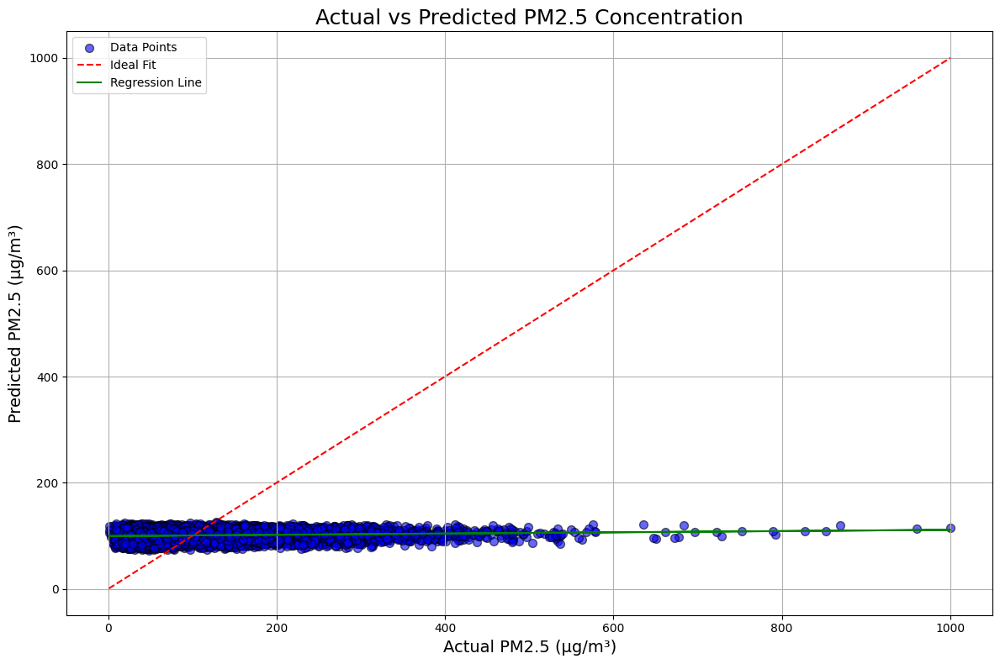

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Step 1: Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Update this path with the actual file path
df = pd.read_excel(file_path)

# Step 2: Display the first few rows and the columns to understand its structure
print("First few rows of the dataset:")
print(df.head())
print("Column Names:", df.columns.tolist())  # List all column names

# Step 3: Check if 'Year' column exists; if not, extract it from the date column
if 'Year' not in df.columns:
    if 'Timestamp' in df.columns:  # Replace with the actual date column name if different
        df['Year'] = pd.to_datetime(df['Timestamp']).dt.year
    else:
        raise Exception("No 'Year' or 'Timestamp' column found in the dataset.")

# Step 4: Filter the data for the years 2017 to 2023
df_filtered = df[(df['Year'] >= 2017) & (df['Year'] <= 2023)]
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])  # Drop rows with missing PM2.5 values

# Step 5: Prepare average features (update these with actual feature names from your dataset)
average_features = ['Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_RH (%)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']  # Example features
X = df_filtered_cleaned[average_features]
y = df_filtered_cleaned['Avg_PM2.5']

# Check for missing values in features
print("Missing values in features:")
print(X.isnull().sum())

# Handle missing values in features if any
X = X.interpolate(method='linear')  # Interpolation to fill NaN values

# Verify if any missing values remain
print("Missing values after interpolation:")
print(X.isnull().sum())

# Step 6: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 7: Model Training
model = LinearRegression()
model.fit(X_train, y_train)

# Step 8: Prediction and Evaluation
y_pred = model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Display evaluation metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Step 9: Improved Visualization
plt.figure(figsize=(12, 8))
plt.scatter(y_test, y_pred, alpha=0.6, color='blue', edgecolor='k', s=50, label='Data Points')
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='--', label='Ideal Fit')  # Ideal line

# Adding Regression Line
slope, intercept = np.polyfit(y_test, y_pred, 1)
plt.plot(y_test, slope * y_test + intercept, color='green', label='Regression Line')

# Adding Titles and Labels
plt.title('Actual vs Predicted PM2.5 Concentration', fontsize=18)
plt.xlabel('Actual PM2.5 (µg/m³)', fontsize=14)
plt.ylabel('Predicted PM2.5 (µg/m³)', fontsize=14)
plt.legend()
plt.grid(True)

# Show the plot with improved layout
plt.tight_layout()
plt.show()


First few rows of the dataset:
            Timestamp  Sirifort_PM2.5  IHBAS_PM2.5  Sonia_Vihar_PM2.5  \
0 2017-01-01 00:00:00          272.83       115.87                NaN   
1 2017-01-01 01:00:00          233.47       115.15                NaN   
2 2017-01-01 02:00:00          206.17       116.53                NaN   
3 2017-01-01 03:00:00          195.85       114.00                NaN   
4 2017-01-01 04:00:00          186.70       113.70                NaN   

   mandir_marg_PM2.5   Avg_PM2.5  Avg_PM10 (µg/m³)  Avg_NO2 (µg/m³)  \
0             227.83  205.510000            302.83        68.926667   
1             224.17  190.930000            255.00        56.870000   
2             200.50  174.400000            240.00        52.853333   
3             154.83  154.893333            211.67        44.416667   
4             164.00  154.800000            205.67        35.743333   

   Avg_AT (°C)  Avg_VWS (m/s)  Avg_O Xylene (µg/m³)  Avg_SO2 (µg/m³)  \
0       12.890           0.35  

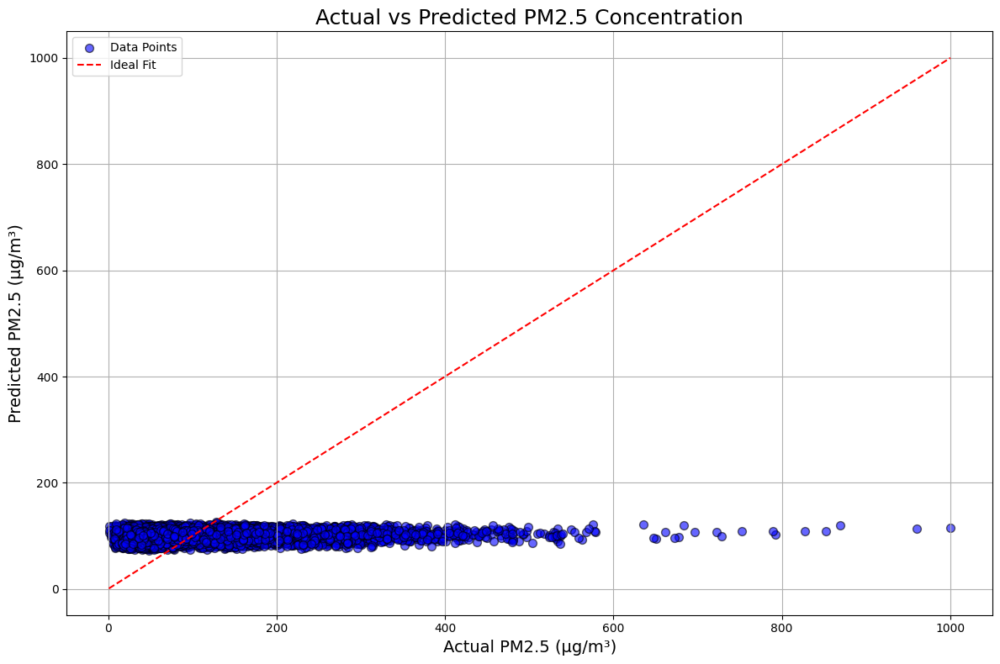

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Step 1: Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Update this path with the actual file path
df = pd.read_excel(file_path)

# Step 2: Display the first few rows and the columns to understand its structure
print("First few rows of the dataset:")
print(df.head())
print("Column Names:", df.columns.tolist())  # List all column names

# Step 3: Check if 'Year' column exists; if not, extract it from the date column
if 'Year' not in df.columns:
    if 'Timestamp' in df.columns:  # Replace with the actual date column name if different
        df['Year'] = pd.to_datetime(df['Timestamp']).dt.year
    else:
        raise Exception("No 'Year' or 'Timestamp' column found in the dataset.")

# Step 4: Filter the data for the years 2017 to 2023
df_filtered = df[(df['Year'] >= 2017) & (df['Year'] <= 2023)]
df_filtered_cleaned = df_filtered.dropna(subset=['Avg_PM2.5'])  # Drop rows with missing PM2.5 values

# Step 5: Prepare average features (update these with actual feature names from your dataset)
average_features = ['Avg_AT (°C)', 'Avg_VWS (m/s)', 'Avg_RH (%)', 'Avg_WD (deg)', 'Avg_SR (W/mt2)']  # Example features
X = df_filtered_cleaned[average_features]
y = df_filtered_cleaned['Avg_PM2.5']

# Step 6: Handle missing values in features
X = X.interpolate(method='linear')  # Interpolation to fill NaN values

# Step 7: Scale the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Step 8: Check for multicollinearity
vif_data = pd.DataFrame()
vif_data["Feature"] = average_features
vif_data["VIF"] = [variance_inflation_factor(X_scaled, i) for i in range(X_scaled.shape[1])]
print("Variance Inflation Factor (VIF):")
print(vif_data)

# Optional: Drop features with high VIF if needed
# For example: X = df_filtered_cleaned.drop(columns=['SomeHighVIFFeature'])

# Step 9: Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.2, random_state=42)

# Step 10: Model Training with Linear Regression
model = LinearRegression()
model.fit(X_train, y_train)

# Step 11: Prediction and Evaluation
y_pred = model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Display evaluation metrics
print("Linear Regression Model Performance:")
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
print("R² Score:", r2)

# Step 12: Visualization
plt.figure(figsize=(12, 8))
plt.scatter(y_test, y_pred, alpha=0.6, color='blue', edgecolor='k', s=50, label='Data Points')
plt.plot([y.min(), y.max()], [y.min(), y.max()], color='red', linestyle='--', label='Ideal Fit')  # Ideal line
plt.title('Actual vs Predicted PM2.5 Concentration', fontsize=18)
plt.xlabel('Actual PM2.5 (µg/m³)', fontsize=14)
plt.ylabel('Predicted PM2.5 (µg/m³)', fontsize=14)
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


<ipython-input-13-7bc7c59cbbe0>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2024['Timestamp'] = df_2024.index  # Ensure 'Timestamp' is datetime
<ipython-input-13-7bc7c59cbbe0>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_2024['Timestamp'] = pd.to_datetime(df_2024['Timestamp'], errors='coerce')
<ipython-input-13-7bc7c59cbbe0>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in

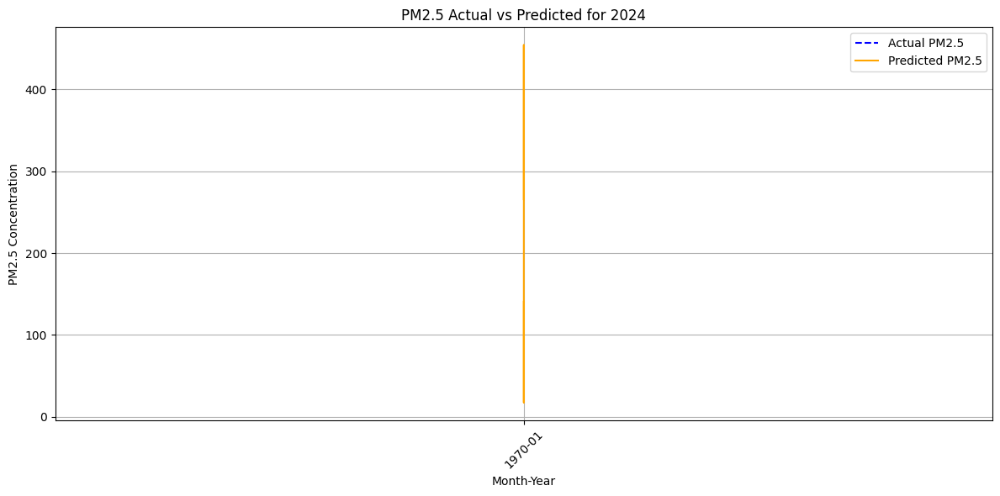

In [ ]:
# Prepare the DataFrame for 2024 predictions
df_2024['Timestamp'] = df_2024.index  # Ensure 'Timestamp' is datetime

# Ensure 'Timestamp' is in datetime format
df_2024['Timestamp'] = pd.to_datetime(df_2024['Timestamp'], errors='coerce')

# Extracting Month-Year for plotting
df_2024.loc[:, 'Month-Year'] = df_2024['Timestamp'].dt.to_period('M')  # Use .loc to avoid SettingWithCopyWarning

# Plotting Actual and Predicted PM2.5 values
plt.figure(figsize=(12, 6))
plt.plot(df_2024['Month-Year'].astype(str), df_2024['Avg_PM2.5'], label='Actual PM2.5', color='blue', linestyle='--')
plt.plot(df_2024['Month-Year'].astype(str), df_2024['Predicted_PM2.5'], label='Predicted PM2.5', color='orange')

# Formatting the plot
plt.title('PM2.5 Actual vs Predicted for 2024')
plt.xlabel('Month-Year')
plt.ylabel('PM2.5 Concentration')
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.legend()
plt.tight_layout()
plt.grid()
plt.show()


Linear Regression:
  R² Score: 0.0437
  Mean Squared Error: 6570.5368
  Mean Absolute Error: 60.2744
  Root Mean Squared Error: 81.0588

Lasso Regression:
  R² Score: 0.0420
  Mean Squared Error: 6582.4041
  Mean Absolute Error: 60.3386
  Root Mean Squared Error: 81.1320

Ridge Regression:
  R² Score: 0.0437
  Mean Squared Error: 6570.5369
  Mean Absolute Error: 60.2744
  Root Mean Squared Error: 81.0588

Support Vector Regressor:
  R² Score: 0.3185
  Mean Squared Error: 4682.7349
  Mean Absolute Error: 42.8808
  Root Mean Squared Error: 68.4305

Random Forest Regressor:
  R² Score: 0.8950
  Mean Squared Error: 721.2666
  Mean Absolute Error: 16.2480
  Root Mean Squared Error: 26.8564

Gradient Boosting Regressor:
  R² Score: 0.6030
  Mean Squared Error: 2727.4491
  Mean Absolute Error: 34.5574
  Root Mean Squared Error: 52.2250

K-Nearest Neighbors:
  R² Score: 0.7905
  Mean Squared Error: 1439.3777
  Mean Absolute Error: 23.1729
  Root Mean Squared Error: 37.9391



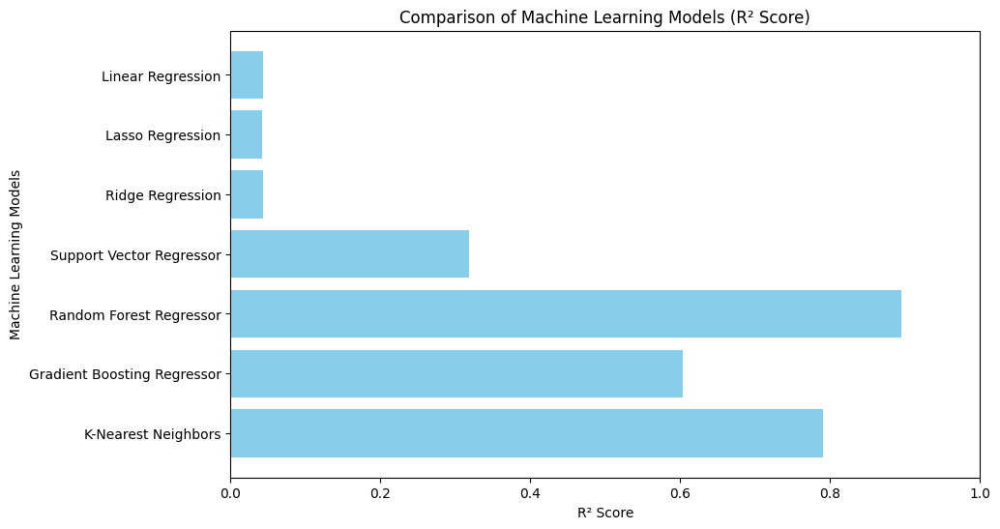

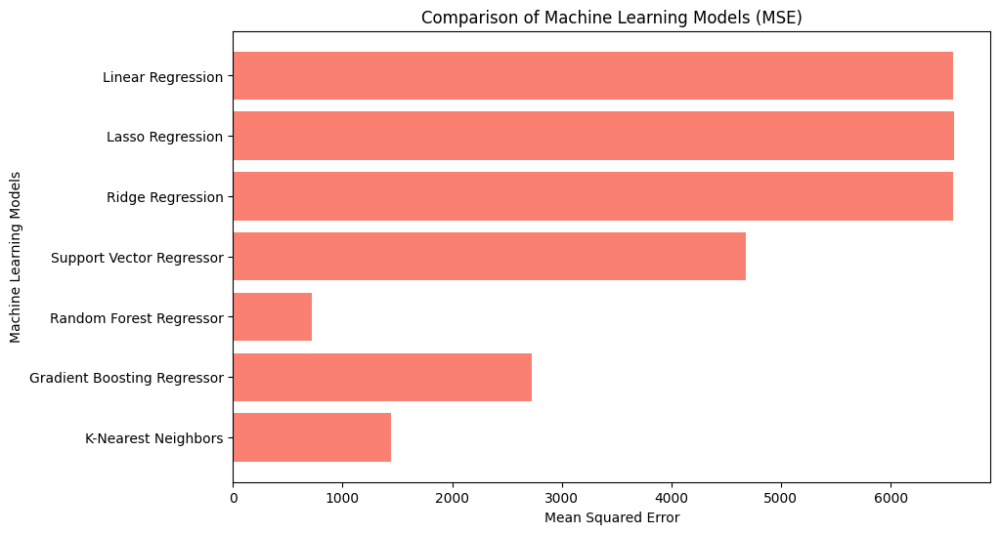

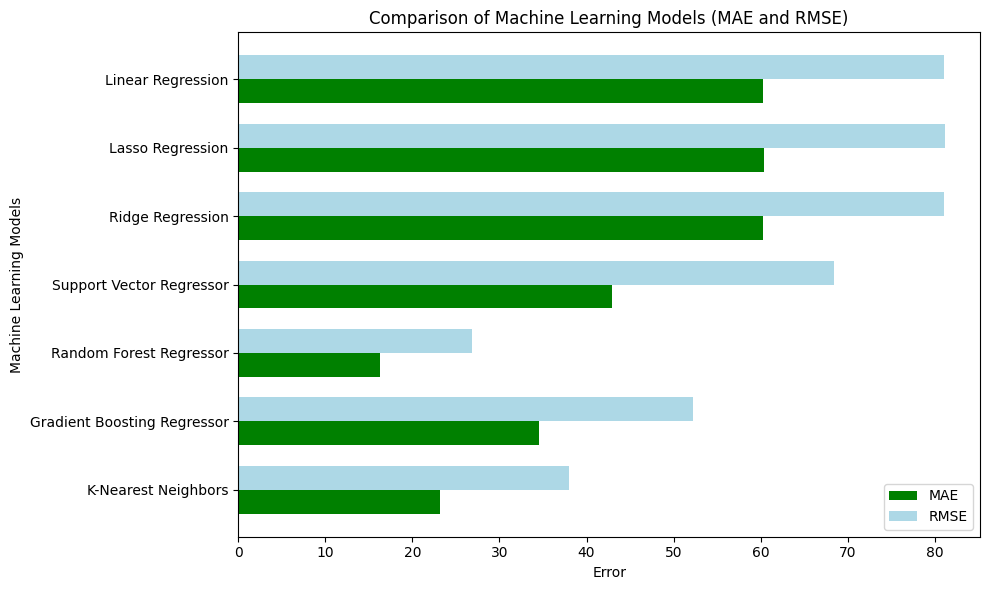

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Load the dataset
file_path = '/content/Book5 (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Extract relevant datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Apply linear interpolation to fill missing values in numeric columns
numeric_cols = data.select_dtypes(include=[np.number]).columns
data[numeric_cols] = data[numeric_cols].interpolate(method='linear')

# Create lag features for PM2.5
data['PM2.5_Lag1'] = data['Avg_PM2.5'].shift(1)
data['PM2.5_Lag2'] = data['Avg_PM2.5'].shift(2)

# Create rolling window features for PM2.5 (7-day rolling mean and std)
data['PM2.5_Rolling_Mean7'] = data['Avg_PM2.5'].rolling(window=7).mean()
data['PM2.5_Rolling_Std7'] = data['Avg_PM2.5'].rolling(window=7).std()

# Drop rows with NaN values (due to lag/rolling features)
data = data.dropna()

# Define features (X) and target variable (y)
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)',
         ]]
y = data['Avg_PM2.5']

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define models
models = {
    'Linear Regression': LinearRegression(),
    'Lasso Regression': Lasso(),
    'Ridge Regression': Ridge(),
    'Support Vector Regressor': SVR(),
    'Random Forest Regressor': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting Regressor': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'K-Nearest Neighbors': KNeighborsRegressor(n_neighbors=5)
}

# Train and evaluate models
performance = {}
for name, model in models.items():
    model.fit(X_train_scaled, y_train)
    y_pred = model.predict(X_test_scaled)

    # Calculate R², MSE, MAE, and RMSE
    r2 = r2_score(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mse)

    performance[name] = {'R²': r2, 'MSE': mse, 'MAE': mae, 'RMSE': rmse}

# Display performance metrics for each model
for model_name, metrics in performance.items():
    print(f"{model_name}:")
    print(f"  R² Score: {metrics['R²']:.4f}")
    print(f"  Mean Squared Error: {metrics['MSE']:.4f}")
    print(f"  Mean Absolute Error: {metrics['MAE']:.4f}")
    print(f"  Root Mean Squared Error: {metrics['RMSE']:.4f}")
    print()

# Prepare data for plotting (reverse the order for visualization)
model_names = list(performance.keys())[::-1]
r2_values = [metrics['R²'] for metrics in performance.values()][::-1]
mse_values = [metrics['MSE'] for metrics in performance.values()][::-1]
mae_values = [metrics['MAE'] for metrics in performance.values()][::-1]
rmse_values = [metrics['RMSE'] for metrics in performance.values()][::-1]

# Plot R² scores
plt.figure(figsize=(10, 6))
plt.barh(model_names, r2_values, color='skyblue')
plt.xlabel('R² Score')
plt.ylabel('Machine Learning Models')
plt.title('Comparison of Machine Learning Models (R² Score)')
plt.xlim(0, 1)
plt.show()

# Plot MSE scores
plt.figure(figsize=(10, 6))
plt.barh(model_names, mse_values, color='salmon')
plt.xlabel('Mean Squared Error')
plt.ylabel('Machine Learning Models')
plt.title('Comparison of Machine Learning Models (MSE)')
plt.show()

# Plot MAE and RMSE scores
width = 0.35
x = np.arange(len(model_names))

fig, ax = plt.subplots(figsize=(10, 6))
bars_mae = ax.barh(x - width / 2, mae_values, width, label='MAE', color='green')
bars_rmse = ax.barh(x + width / 2, rmse_values, width, label='RMSE', color='lightblue')

ax.set_xlabel('Error')
ax.set_ylabel('Machine Learning Models')
ax.set_title('Comparison of Machine Learning Models (MAE and RMSE)')
ax.set_yticks(x)
ax.set_yticklabels(model_names)
ax.legend()

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Step 1: Load the dataset
file_path = '/content/AQI_Classification.xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Step 2: Inspect the dataset
print(data.info())
print(data.describe())

# Step 3: Handle missing values by forward-filling
data.ffill(inplace=True)

# Step 4: Select the actual PM2.5 and meteorological columns from your dataset
features = data[['Avg_PM2.5', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
target = data['AQI']  # Target variable

# Step 5: Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Step 6: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_scaled, target, test_size=0.3, random_state=42)

# Step 7: Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_model.fit(X_train, y_train)

# Step 8: Predict on test data using SVR
svr_predictions = svr_model.predict(X_test)

# Step 9: Evaluate SVR model
print(f"SVR Mean Squared Error (MSE): {mean_squared_error(y_test, svr_predictions)}")
print(f"SVR R² Score: {r2_score(y_test, svr_predictions)}")

# Step 10: Visualize predictions
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual AQI', color='blue')
plt.plot(svr_predictions, label='Predicted AQI (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('AQI Prediction using Support Vector Regression')
plt.xlabel('Sample Index')
plt.ylabel('AQI')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

<ipython-input-3-ce0d39bed46c>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Contrast'] = contrast  # Add GLCM feature
<ipython-input-3-ce0d39bed46c>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Energy'] = energy      # Add GLCM feature
<ipython-input-3-ce0d39bed46c>:48: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

SVR Mean Squared Error (MSE): 7902.656380486139
SVR R² Score: -0.08004726593351075


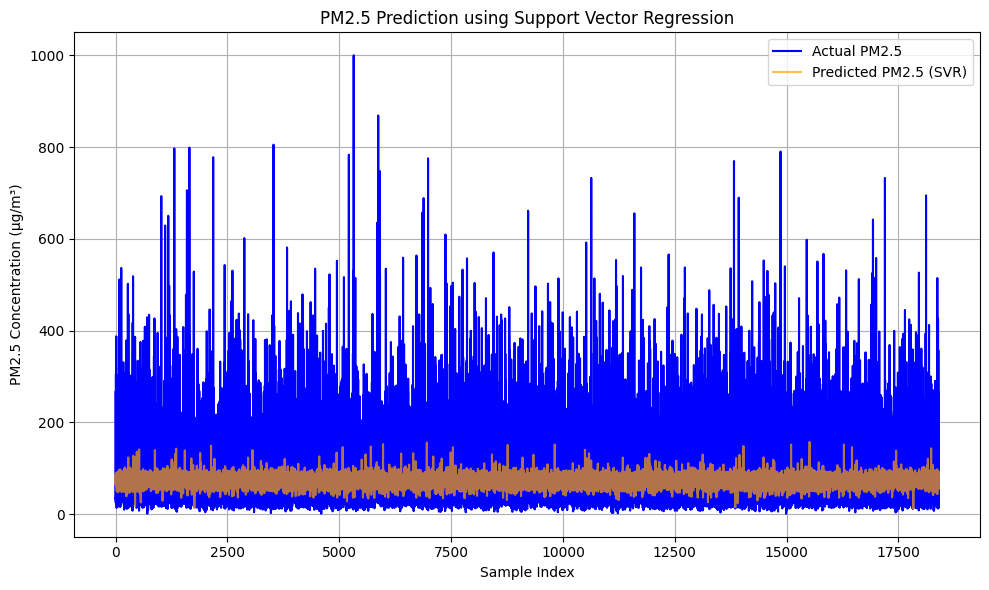

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Inspect the dataset
print(data.info())
print(data.describe())

# Handle missing values by forward-filling
data.ffill(inplace=True)

# Extract PM2.5 values for GLCM calculation
pm25_data = data['Avg_PM2.5'].astype(np.uint8).values  # Ensure correct type for GLCM

# 1. Manual GLCM Calculation and Feature Extraction
def glcm_matrix(data, levels=256):
    """Create a GLCM matrix manually for 1D data."""
    glcm = np.zeros((levels, levels), dtype=int)
    for i in range(len(data) - 1):
        glcm[data[i], data[i + 1]] += 1
    return glcm

def glcm_features(glcm):
    """Calculate GLCM features like contrast, energy, and entropy."""
    contrast = np.sum([[(i - j) ** 2 * glcm[i, j] for i in range(glcm.shape[0])] for j in range(glcm.shape[1])])
    energy = np.sum(glcm ** 2)
    entropy = -np.sum(glcm * np.log2(glcm + (glcm == 0)))  # Add (glcm == 0) to avoid log(0)
    return contrast, energy, entropy

# Calculate GLCM and extract features
glcm = glcm_matrix(pm25_data)
contrast, energy, entropy = glcm_features(glcm)
print(f"Contrast: {contrast}, Energy: {energy}, Entropy: {entropy}")

# 2. Prepare features for SVR
# Select the actual PM2.5 and meteorological columns from your dataset
features = data[['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]  # Meteorological features
features['Contrast'] = contrast  # Add GLCM feature
features['Energy'] = energy      # Add GLCM feature
features['Entropy'] = entropy     # Add GLCM feature

target = data['Avg_PM2.5']  # Target variable (you can also use 'AQI' if needed)

# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_scaled, target, test_size=0.3, random_state=42)

# Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_model.fit(X_train, y_train)

# Predict on test data using SVR
svr_predictions = svr_model.predict(X_test)

# Evaluate SVR model
print(f"SVR Mean Squared Error (MSE): {mean_squared_error(y_test, svr_predictions)}")
print(f"SVR R² Score: {r2_score(y_test, svr_predictions)}")

# Visualize predictions
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual PM2.5', color='blue')
plt.plot(svr_predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using Support Vector Regression')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

<ipython-input-4-aa2b3f5bce11>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Contrast'] = contrast  # Add GLCM feature
<ipython-input-4-aa2b3f5bce11>:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Energy'] = energy      # Add GLCM feature
<ipython-input-4-aa2b3f5bce11>:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

SVR Mean Squared Error (MSE): 7902.656380486139
SVR R² Score: -0.08004726593351075


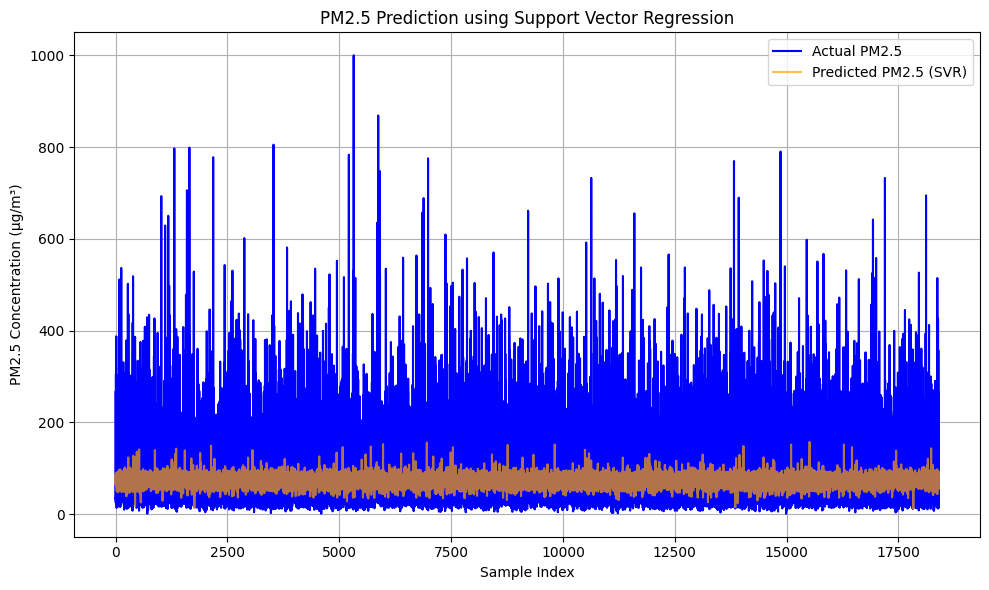

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Inspect the dataset
print(data.info())
print(data.describe())

# Handle missing values by forward-filling
data.ffill(inplace=True)

# Extract PM2.5 values for GLCM calculation
pm25_data = data['Avg_PM2.5'].astype(np.uint8).values  # Ensure correct type for GLCM

# 1. Manual GLCM Calculation and Feature Extraction
def glcm_matrix(data, levels=256):
    """Create a GLCM matrix manually for 1D data."""
    glcm = np.zeros((levels, levels), dtype=int)
    for i in range(len(data) - 1):
        glcm[data[i], data[i + 1]] += 1
    return glcm

def glcm_features(glcm):
    """Calculate GLCM features like contrast, energy, and entropy."""
    contrast = np.sum([[(i - j) ** 2 * glcm[i, j] for i in range(glcm.shape[0])] for j in range(glcm.shape[1])])
    energy = np.sum(glcm ** 2)
    entropy = -np.sum(glcm * np.log2(glcm + (glcm == 0)))  # Add (glcm == 0) to avoid log(0)
    return contrast, energy, entropy

# Calculate GLCM and extract features
glcm = glcm_matrix(pm25_data)
contrast, energy, entropy = glcm_features(glcm)
print(f"Contrast: {contrast}, Energy: {energy}, Entropy: {entropy}")

# 2. Feature Optimization (Placeholder for MFOA)
def mfoa_optimize(features):
    """Placeholder for actual MFOA implementation."""
    optimized_features = features  # For simplicity, return the same features
    return optimized_features

# Prepare features for SVR
# Select the actual PM2.5 and meteorological columns from your dataset
features = data[['Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]  # Meteorological features
features['Contrast'] = contrast  # Add GLCM feature
features['Energy'] = energy      # Add GLCM feature
features['Entropy'] = entropy     # Add GLCM feature

target = data['Avg_PM2.5']  # Target variable (you can also use 'AQI' if needed)

# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Apply MFOA to the extracted features (placeholder optimization step)
optimized_features = mfoa_optimize(features_scaled)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(optimized_features, target, test_size=0.3, random_state=42)

# Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_model.fit(X_train, y_train)

# Predict on test data using SVR
svr_predictions = svr_model.predict(X_test)

# Evaluate SVR model
print(f"SVR Mean Squared Error (MSE): {mean_squared_error(y_test, svr_predictions)}")
print(f"SVR R² Score: {r2_score(y_test, svr_predictions)}")

# Visualize predictions
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual PM2.5', color='blue')
plt.plot(svr_predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using Support Vector Regression')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

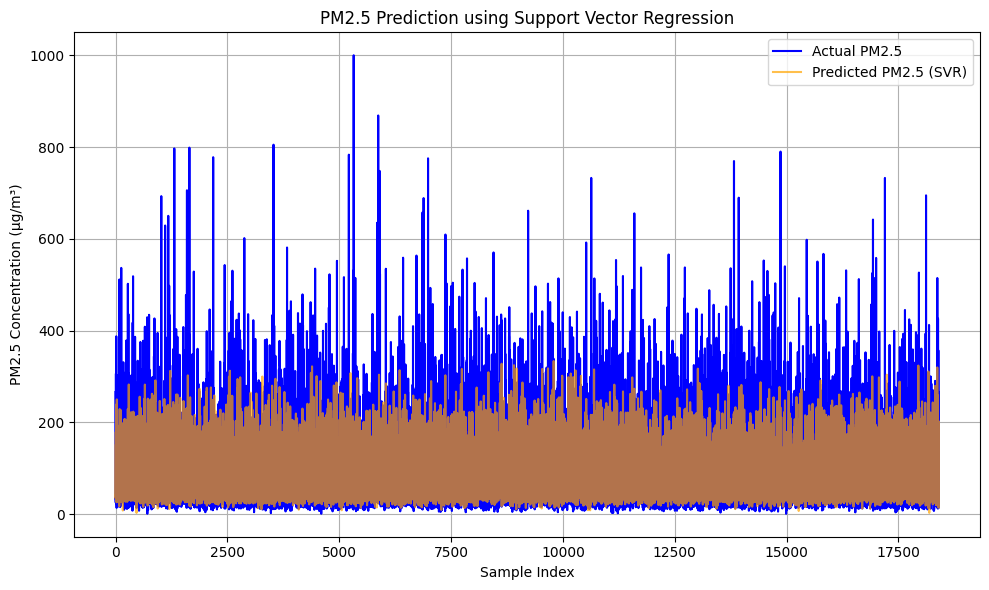

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Step 1: Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Step 2: Inspect the dataset
print(data.info())
print(data.describe())

# Step 3: Handle missing values by forward-filling
data.ffill(inplace=True)

# Step 4: Ensure 'Year', 'Month', 'Day', 'Hour' are extracted from the Timestamp column
if 'Timestamp' in data.columns:
    data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
    data['Year'] = data['Timestamp'].dt.year
    data['Month'] = data['Timestamp'].dt.month
    data['Day'] = data['Timestamp'].dt.day
    data['Hour'] = data['Timestamp'].dt.hour
else:
    raise Exception("Timestamp column is not found in the dataset.")

# Step 5: Define features (X) and target variable (y)
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']  # Target variable

# Step 6: Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(X)

# Step 7: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_scaled, y, test_size=0.3, random_state=42)

# Step 8: Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_model.fit(X_train, y_train)

# Step 9: Predict on test data using SVR
svr_predictions = svr_model.predict(X_test)

# Step 10: Evaluate SVR model
print(f"SVR Mean Squared Error (MSE): {mean_squared_error(y_test, svr_predictions)}")
print(f"SVR R² Score: {r2_score(y_test, svr_predictions)}")

# Step 11: Visualize predictions
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual PM2.5', color='blue')
plt.plot(svr_predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using Support Vector Regression')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

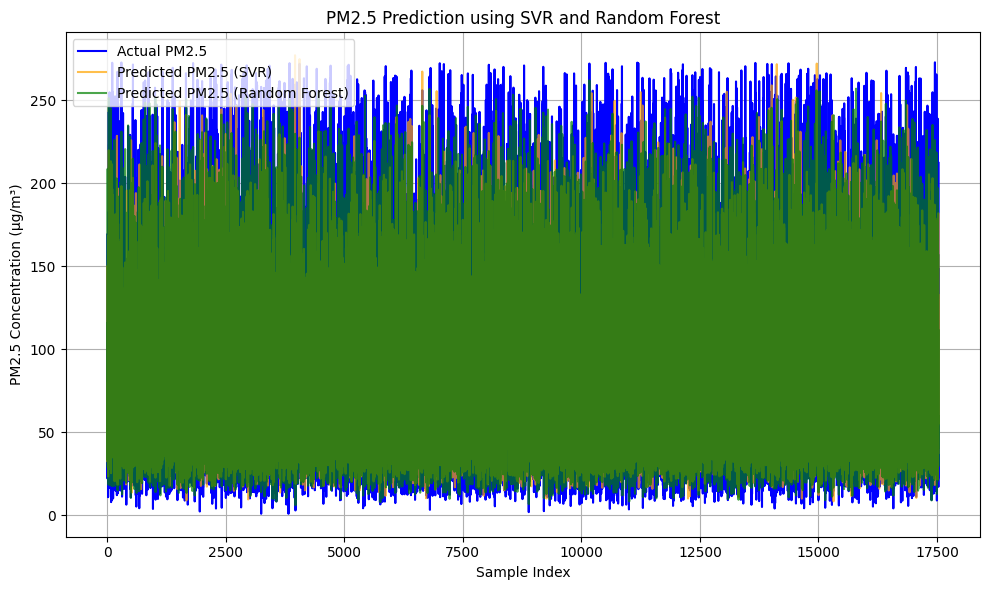

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Inspect the dataset
print(data.info())
print(data.describe())

# Step 1: Handle missing values by forward-filling
data.ffill(inplace=True)

# Step 2: Extract PM2.5 and meteorological features
data['Year'] = pd.to_datetime(data['Timestamp']).dt.year
data['Month'] = pd.to_datetime(data['Timestamp']).dt.month
data['Day'] = pd.to_datetime(data['Timestamp']).dt.day
data['Hour'] = pd.to_datetime(data['Timestamp']).dt.hour

# Select features and target
features = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
target = data['Avg_PM2.5']

# Step 3: Outlier Detection (using IQR)
Q1 = target.quantile(0.25)
Q3 = target.quantile(0.75)
IQR = Q3 - Q1
filter = (target >= (Q1 - 1.5 * IQR)) & (target <= (Q3 + 1.5 * IQR))
features = features[filter]
target = target[filter]

# Step 4: Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Step 5: Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features_scaled, target, test_size=0.3, random_state=42)

# Step 6: Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_model.fit(X_train, y_train)

# Step 7: Predict on test data using SVR
svr_predictions = svr_model.predict(X_test)

# Evaluate SVR model
print(f"SVR Mean Squared Error (MSE): {mean_squared_error(y_test, svr_predictions)}")
print(f"SVR R² Score: {r2_score(y_test, svr_predictions)}")

# Step 8: Try Random Forest as an alternative model
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Predict with Random Forest
rf_predictions = rf_model.predict(X_test)

# Evaluate Random Forest model
print(f"Random Forest Mean Squared Error (MSE): {mean_squared_error(y_test, rf_predictions)}")
print(f"Random Forest R² Score: {r2_score(y_test, rf_predictions)}")

# Step 9: Visualize predictions
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual PM2.5', color='blue')
plt.plot(svr_predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.plot(rf_predictions, label='Predicted PM2.5 (Random Forest)', color='green', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using SVR and Random Forest')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

<ipython-input-6-574c41920433>:58: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Contrast'] = contrast  # Add GLCM feature
<ipython-input-6-574c41920433>:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  features['Energy'] = energy      # Add GLCM feature
<ipython-input-6-574c41920433>:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.or

SVR Mean Squared Error (MSE): 4035.6893099077874
SVR R² Score: 0.44844682655240653


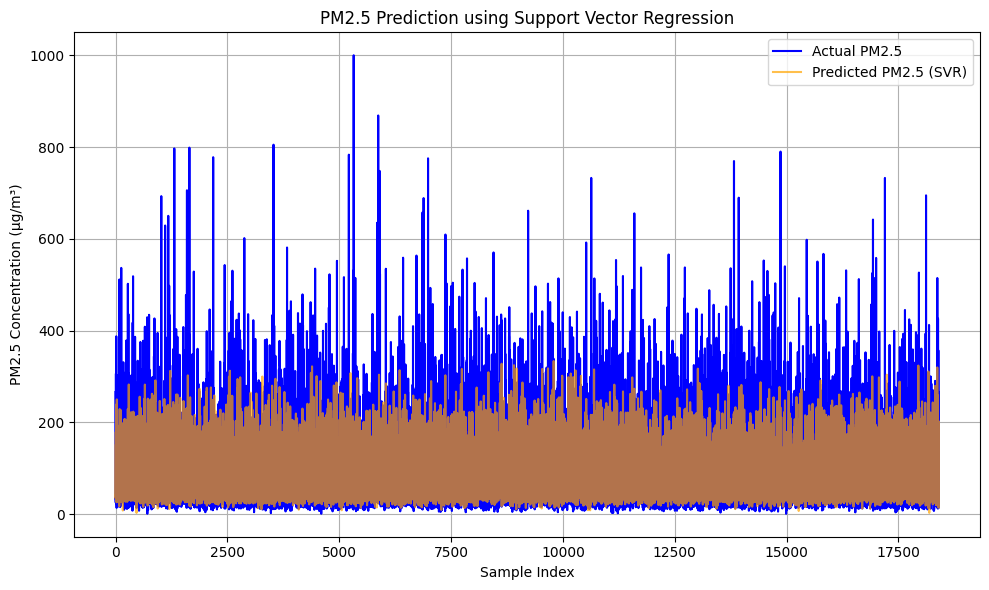

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Inspect the dataset
print(data.info())
print(data.describe())

# Handle missing values by forward-filling
data.ffill(inplace=True)

# Extract PM2.5 values for GLCM calculation
pm25_data = data['Avg_PM2.5'].astype(np.uint8).values  # Ensure correct type for GLCM

# 1. Manual GLCM Calculation and Feature Extraction
def glcm_matrix(data, levels=256):
    """Create a GLCM matrix manually for 1D data."""
    glcm = np.zeros((levels, levels), dtype=int)
    for i in range(len(data) - 1):
        glcm[data[i], data[i + 1]] += 1
    return glcm

def glcm_features(glcm):
    """Calculate GLCM features like contrast, energy, and entropy."""
    contrast = np.sum([[(i - j) ** 2 * glcm[i, j] for i in range(glcm.shape[0])] for j in range(glcm.shape[1])])
    energy = np.sum(glcm ** 2)
    entropy = -np.sum(glcm * np.log2(glcm + (glcm == 0)))  # Add (glcm == 0) to avoid log(0)
    return contrast, energy, entropy

# Calculate GLCM and extract features
glcm = glcm_matrix(pm25_data)
contrast, energy, entropy = glcm_features(glcm)
print(f"Contrast: {contrast}, Energy: {energy}, Entropy: {entropy}")

# 2. Feature Optimization (Placeholder for MFOA)
def mfoa_optimize(features):
    """Placeholder for actual MFOA implementation."""
    optimized_features = features  # For simplicity, return the same features
    return optimized_features

# Prepare features for SVR
# Select the actual PM2.5 and meteorological columns from your dataset
data['Year'] = pd.to_datetime(data['Timestamp']).dt.year
data['Month'] = pd.to_datetime(data['Timestamp']).dt.month
data['Day'] = pd.to_datetime(data['Timestamp']).dt.day
data['Hour'] = pd.to_datetime(data['Timestamp']).dt.hour

# Select meteorological features and add GLCM features
features = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
features['Contrast'] = contrast  # Add GLCM feature
features['Energy'] = energy      # Add GLCM feature
features['Entropy'] = entropy     # Add GLCM feature

target = data['Avg_PM2.5']  # Target variable (you can also use 'AQI' if needed)

# Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Apply MFOA to the extracted features (placeholder optimization step)
optimized_features = mfoa_optimize(features_scaled)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(optimized_features, target, test_size=0.3, random_state=42)

# Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, gamma=0.1, epsilon=.1)
svr_model.fit(X_train, y_train)

# Predict on test data using SVR
svr_predictions = svr_model.predict(X_test)

# Evaluate SVR model
print(f"SVR Mean Squared Error (MSE): {mean_squared_error(y_test, svr_predictions)}")
print(f"SVR R² Score: {r2_score(y_test, svr_predictions)}")

# Visualize predictions
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual PM2.5', color='blue')
plt.plot(svr_predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using Support Vector Regression')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

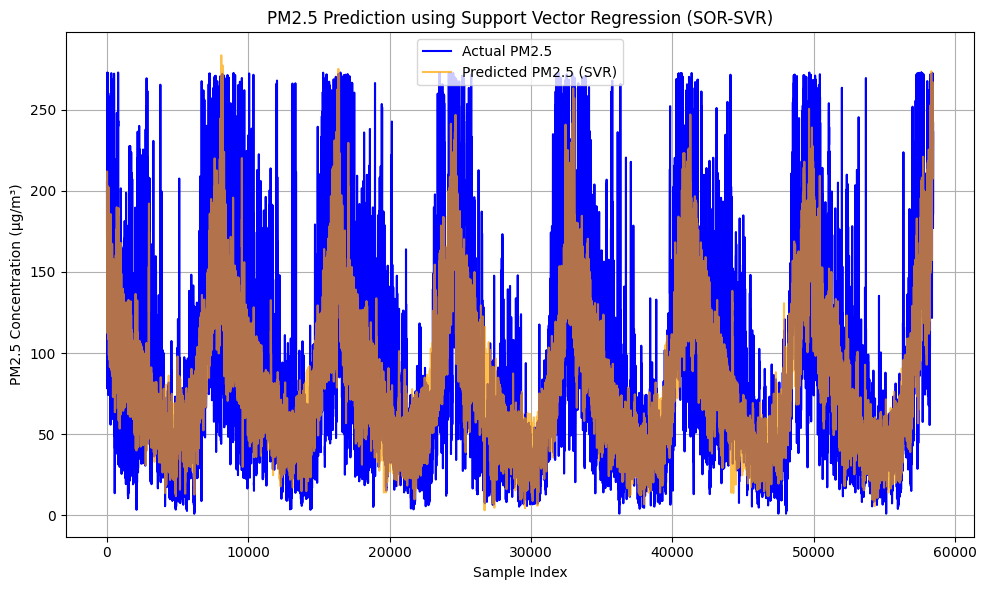

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, KFold
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update this path with the actual file path
data = pd.read_excel(file_path)

# Inspect the dataset
print(data.info())
print(data.describe())

# Handle missing values by forward-filling
data.ffill(inplace=True)

# Extract PM2.5 values and meteorological features
data['Year'] = pd.to_datetime(data['Timestamp']).dt.year
data['Month'] = pd.to_datetime(data['Timestamp']).dt.month
data['Day'] = pd.to_datetime(data['Timestamp']).dt.day
data['Hour'] = pd.to_datetime(data['Timestamp']).dt.hour

# Select features and target
features = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
target = data['Avg_PM2.5']

# Step 1: Outlier Detection (using IQR)
Q1 = target.quantile(0.25)
Q3 = target.quantile(0.75)
IQR = Q3 - Q1
filter = (target >= (Q1 - 1.5 * IQR)) & (target <= (Q3 + 1.5 * IQR))
features = features[filter]
target = target[filter]

# Step 2: Normalize the features
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# Step 3: Set parameters for SOR-SVR
epsilon = 0.1  # Error acceptance
C = 100        # Regularization parameter
gamma = 0.1    # Gaussian kernel parameter (sigma = 1/(2*gamma))

# Step 4: K-Fold Cross-Validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

mse_scores = []
r2_scores = []

# Step 5: Train and Evaluate SVR using K-Fold Cross-Validation
for train_index, test_index in kf.split(features_scaled):
    X_train, X_test = features_scaled[train_index], features_scaled[test_index]
    y_train, y_test = target.iloc[train_index], target.iloc[test_index]

    # Train the SVR model
    svr_model = SVR(kernel='rbf', C=C, epsilon=epsilon, gamma=gamma)
    svr_model.fit(X_train, y_train)

    # Predict on test data
    svr_predictions = svr_model.predict(X_test)

    # Evaluate the model
    mse_scores.append(mean_squared_error(y_test, svr_predictions))
    r2_scores.append(r2_score(y_test, svr_predictions))

# Calculate average MSE and R² score from cross-validation
average_mse = np.mean(mse_scores)
average_r2 = np.mean(r2_scores)

print(f"Average SVR Mean Squared Error (MSE): {average_mse}")
print(f"Average SVR R² Score: {average_r2}")

# Train final SVR model on the full dataset
svr_model_final = SVR(kernel='rbf', C=C, epsilon=epsilon, gamma=gamma)
svr_model_final.fit(features_scaled, target)

# Predict on the full dataset to evaluate
final_predictions = svr_model_final.predict(features_scaled)

# Visualize final predictions
plt.figure(figsize=(10, 6))
plt.plot(target.values, label='Actual PM2.5', color='blue')
plt.plot(final_predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using Support Vector Regression (SOR-SVR)')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 61344 entries, 0 to 61343
Data columns (total 19 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   Timestamp                61344 non-null  datetime64[ns]
 1   Sirifort_PM2.5           55476 non-null  float64       
 2   IHBAS_PM2.5              54723 non-null  float64       
 3   Sonia_Vihar_PM2.5        50035 non-null  float64       
 4   mandir_marg_PM2.5        58211 non-null  float64       
 5   Avg_PM2.5                61202 non-null  float64       
 6   Avg_PM10 (µg/m³)         60403 non-null  float64       
 7   Avg_NO2 (µg/m³)          61045 non-null  float64       
 8   Avg_AT (°C)              60785 non-null  float64       
 9   Avg_VWS (m/s)            32365 non-null  float64       
 10  Avg_O Xylene (µg/m³)     20998 non-null  float64       
 11  Avg_SO2 (µg/m³)          60289 non-null  float64       
 12  Avg_Eth-Benzene (µg/m³)  43140 n

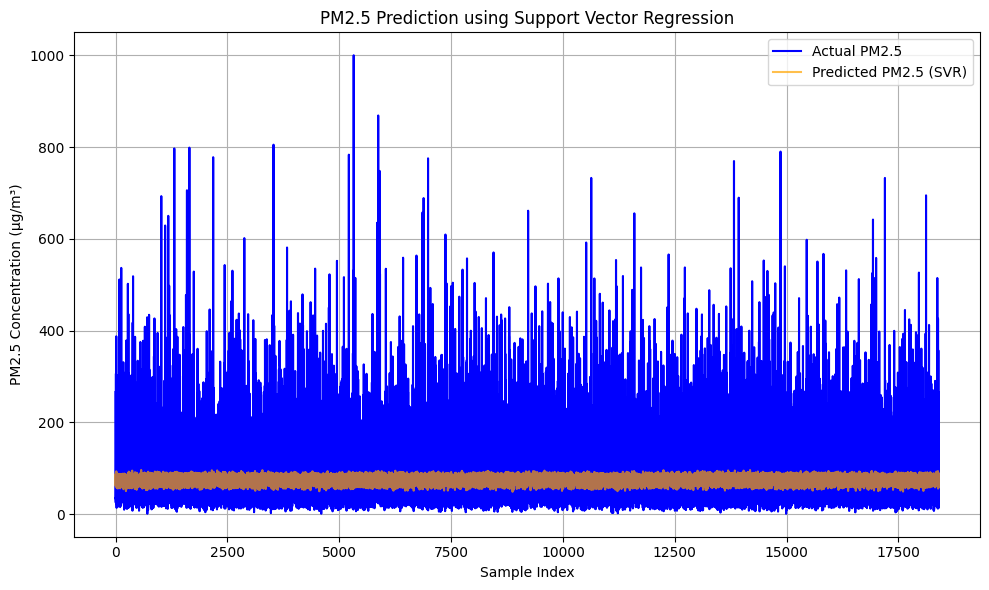

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVR
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt

# Load your dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update with the actual file path
data = pd.read_excel(file_path)

# Inspect the dataset
print(data.info())
print(data.describe())

# Handle missing values using linear interpolation
data.interpolate(method='linear', inplace=True)

# Extract PM2.5 values and meteorological features
data['Year'] = pd.to_datetime(data['Timestamp']).dt.year
data['Month'] = pd.to_datetime(data['Timestamp']).dt.month
data['Day'] = pd.to_datetime(data['Timestamp']).dt.day
data['Hour'] = pd.to_datetime(data['Timestamp']).dt.hour

# Feature selection - Adjust as per your dataset
features = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
target = data['Avg_PM2.5']

# Step 1: Grey Correlation Analysis (GCA)
def grey_correlation_analysis(target, features):
    """Perform Grey Correlation Analysis."""
    correlations = {}
    for col in features.columns:
        # Calculate correlation between target and each feature
        corr = np.corrcoef(target, features[col])[0, 1]
        correlations[col] = corr
    return correlations

gca_results = grey_correlation_analysis(target, features)
print("Grey Correlation Analysis Results:", gca_results)

# Step 2: Data Preparation for SVR
# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.3, random_state=42)

# Step 3: Support Vector Regression (SVR)
svr_model = SVR(kernel='rbf', C=100, epsilon=0.1, gamma='scale')  # Adjust parameters as needed
svr_model.fit(X_train, y_train)

# Step 4: Predictions and Evaluation
predictions = svr_model.predict(X_test)
mse = mean_squared_error(y_test, predictions)
mae = mean_absolute_error(y_test, predictions)

print(f"Mean Squared Error (MSE): {mse}")
print(f"Mean Absolute Error (MAE): {mae}")

# Step 5: Visualization
plt.figure(figsize=(10, 6))
plt.plot(y_test.values, label='Actual PM2.5', color='blue')
plt.plot(predictions, label='Predicted PM2.5 (SVR)', color='orange', alpha=0.7)
plt.legend()
plt.title('PM2.5 Prediction using Support Vector Regression')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


In [ ]:
pip install pandas numpy matplotlib statsmodels


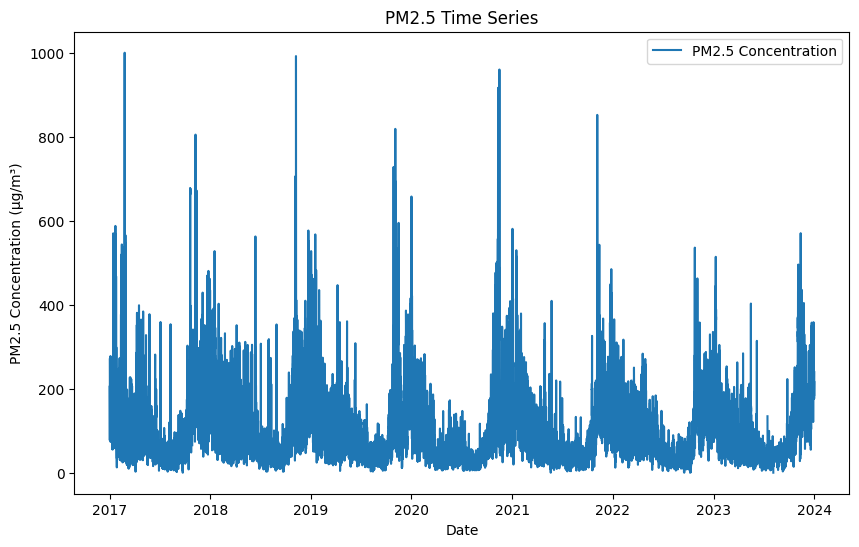

/usr/local/lib/python3.10/dist-packages/matplotlib/axes/_base.py:2503: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


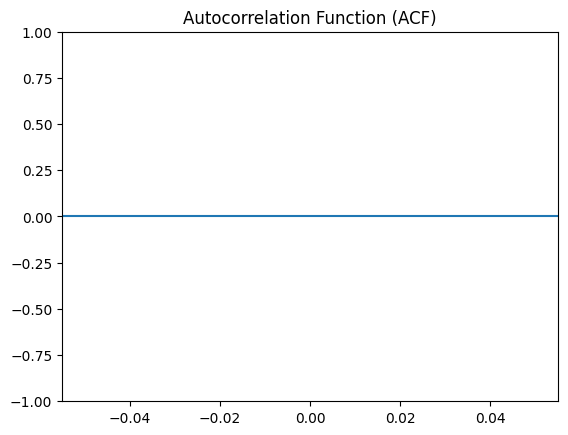

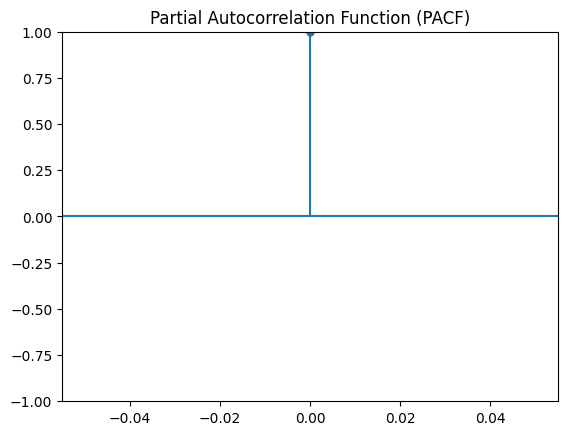

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


                                     SARIMAX Results                                      
Dep. Variable:                          Avg_PM2.5   No. Observations:                61344
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood             -284930.232
Date:                            Fri, 25 Oct 2024   AIC                         569870.464
Time:                                    05:15:20   BIC                         569915.584
Sample:                                01-01-2017   HQIC                        569884.464
                                     - 12-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4077      0.006    -73.344      0.000      -0.419      -0.397
ma.L1          0.3000      0.006   

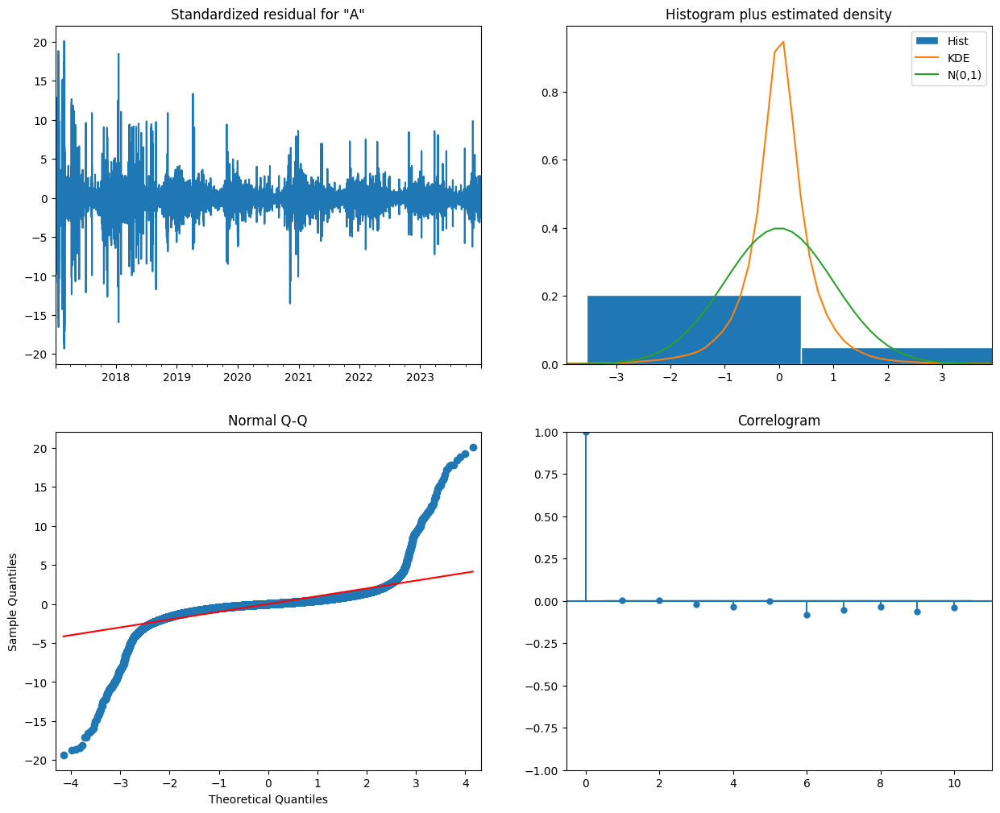

<ipython-input-8-f3a5ff14a8b4>:60: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')


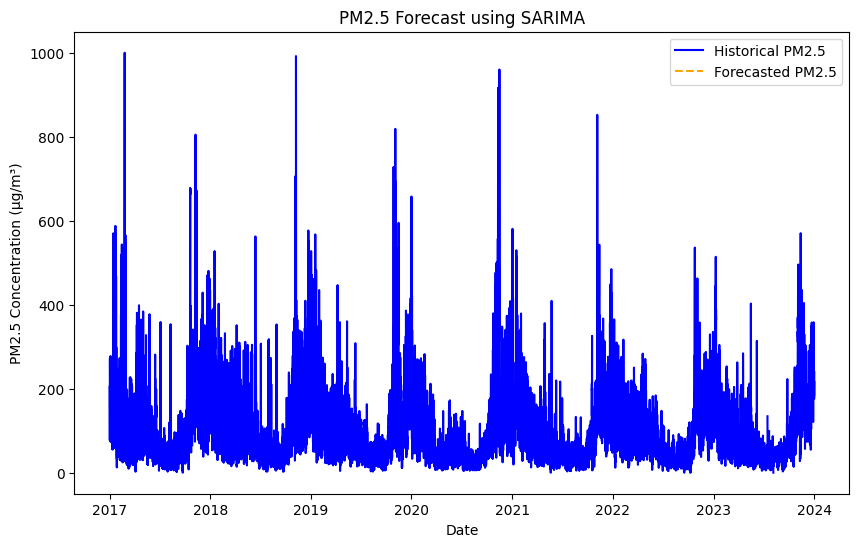

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

# Load your dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update with the actual file path
data = pd.read_excel(file_path)

# Ensure the timestamp column is in datetime format and set as index
data['Timestamp'] = pd.to_datetime(data['Timestamp'])
data.set_index('Timestamp', inplace=True)

# Extract the PM2.5 series
pm25_series = data['Avg_PM2.5']

# Step 1: Visualize the time series
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='PM2.5 Concentration')
plt.title('PM2.5 Time Series')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()

# Step 2: Identify orders using ACF and PACF
plot_acf(pm25_series)
plt.title('Autocorrelation Function (ACF)')
plt.show()

plot_pacf(pm25_series)
plt.title('Partial Autocorrelation Function (PACF)')
plt.show()

# Step 3: Fit the SARIMA model
# You can adjust the parameters (p, d, q) and (P, D, Q, S) based on your analysis
p = 1  # Example value for non-seasonal AR term
d = 1  # Example value for non-seasonal differencing
q = 1  # Example value for non-seasonal MA term
P = 1  # Example value for seasonal AR term
D = 1  # Example value for seasonal differencing
Q = 1  # Example value for seasonal MA term
S = 12  # Example seasonal period (monthly data)

# Fitting the SARIMA model
model = sm.tsa.SARIMAX(pm25_series, order=(p, d, q), seasonal_order=(P, D, Q, S))
results = model.fit()

# Step 4: Print summary of the model
print(results.summary())

# Step 5: Plot diagnostics
results.plot_diagnostics(figsize=(15, 12))
plt.show()

# Step 6: Forecasting
forecast_steps = 12  # Forecasting the next 12 months
forecast = results.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')

# Create a DataFrame to hold the forecasted values
forecast_df = pd.DataFrame(forecast.predicted_mean, index=forecast_index, columns=['Forecasted PM2.5'])

# Step 7: Visualize the forecast
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='Historical PM2.5', color='blue')
plt.plot(forecast_df, label='Forecasted PM2.5', color='orange', linestyle='--')
plt.title('PM2.5 Forecast using SARIMA')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()


In [ ]:
# Step 1: Obtain fitted values for the training dataset
fitted_values = results.fittedvalues

# Step 2: Calculate R² score
SS_res = np.sum((pm25_series[1:] - fitted_values) ** 2)  # Residual sum of squares
SS_tot = np.sum((pm25_series[1:] - np.mean(pm25_series[1:])) ** 2)  # Total sum of squares
r2_score = 1 - (SS_res / SS_tot)

print(f"R² Score: {r2_score}")


R² Score: 0.9137365022739803


No missing values in the PM2.5 series.
ADF Statistic: -12.264215600922686
p-value: 8.936323257324707e-23
Critical Values:
   1%, -3.4304567058368516
Critical Values:
   5%, -2.861587161979842
Critical Values:
   10%, -2.5667951027287517


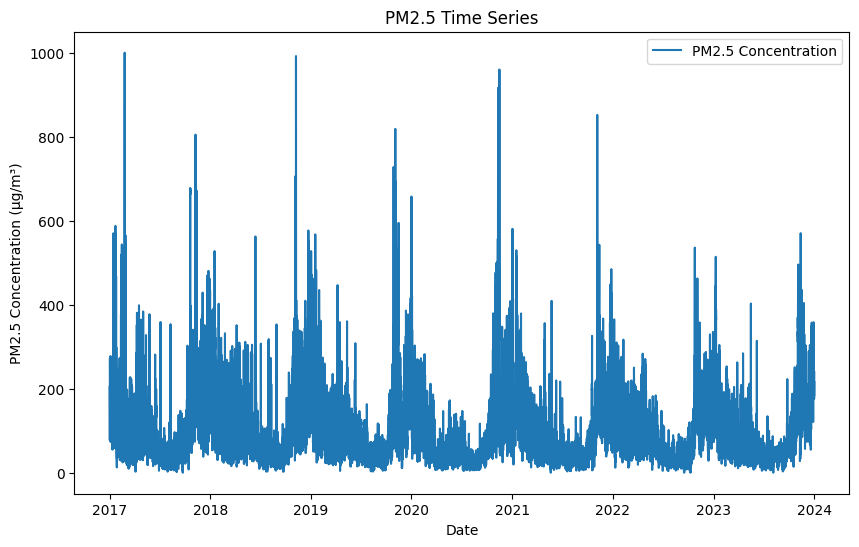

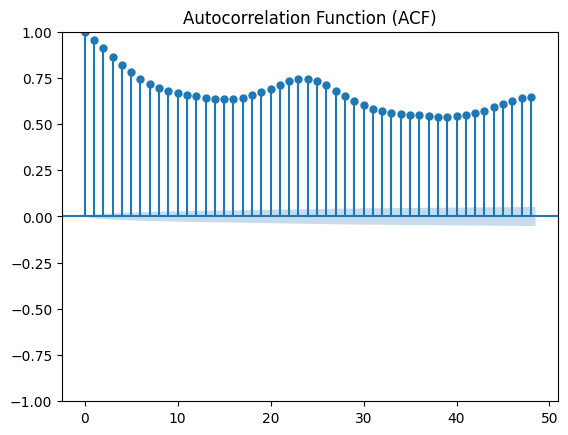

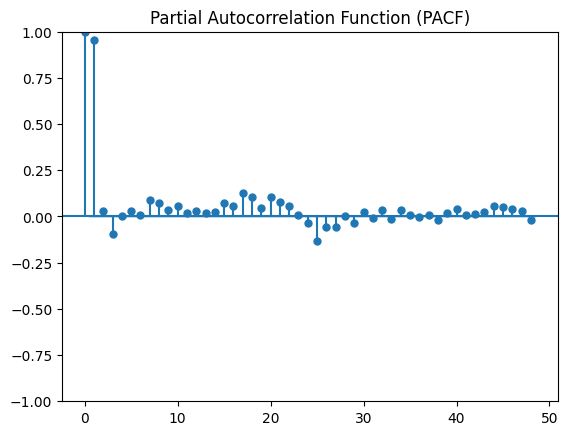

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


                                     SARIMAX Results                                      
Dep. Variable:                          Avg_PM2.5   No. Observations:                61344
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood             -285518.182
Date:                            Fri, 25 Oct 2024   AIC                         571046.365
Time:                                    05:26:26   BIC                         571091.485
Sample:                                01-01-2017   HQIC                        571060.366
                                     - 12-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4087      0.006    -72.955      0.000      -0.420      -0.398
ma.L1          0.3023      0.006   

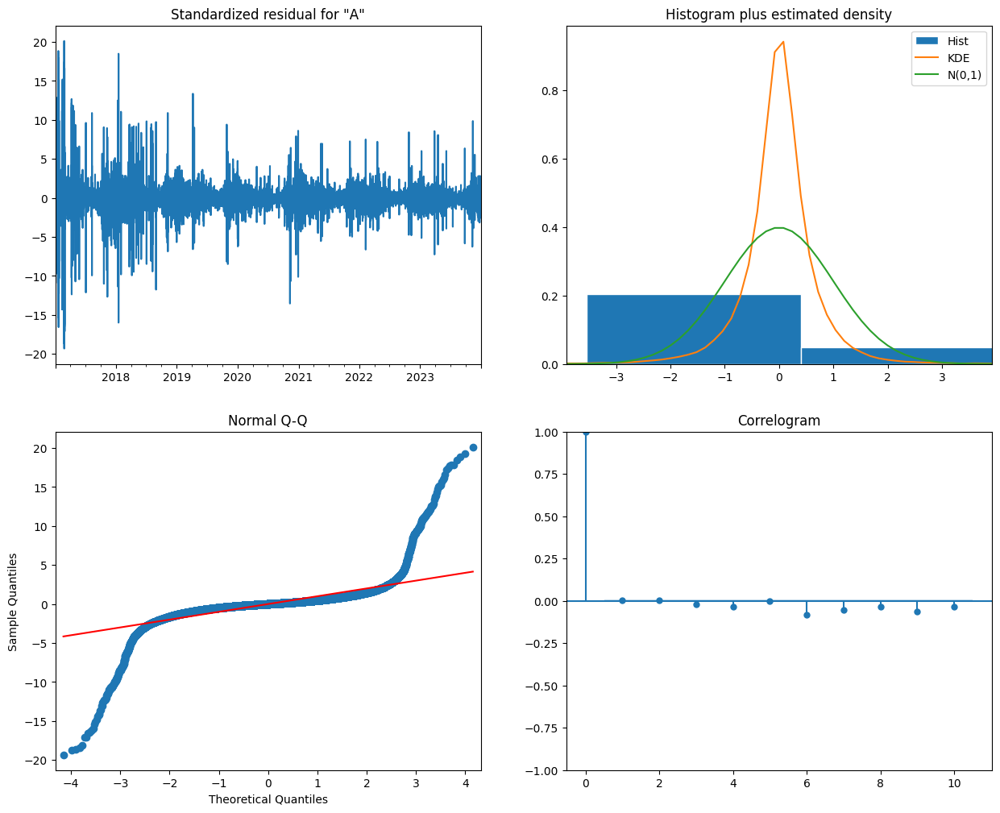

<ipython-input-11-79b111c40ec4>:81: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')


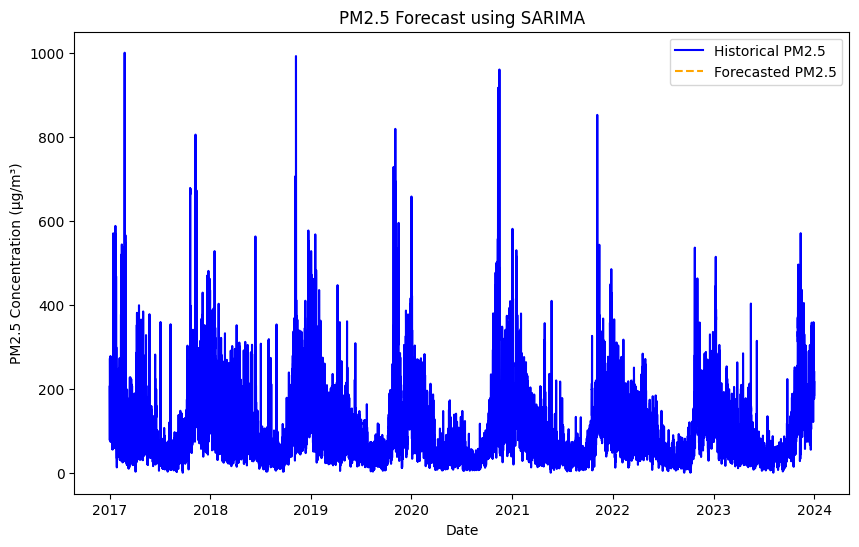

R² Score: 0.9138547670443987


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller

# Load your dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update with the actual file path
data = pd.read_excel(file_path)

# Ensure the timestamp column is in datetime format and set as index
data['Timestamp'] = pd.to_datetime(data['Timestamp'])
data.set_index('Timestamp', inplace=True)

# Extract the PM2.5 series
pm25_series = data['Avg_PM2.5']

# Step 1: Handle missing values using linear interpolation
pm25_series = pm25_series.interpolate(method='linear')

# Check for any remaining NaNs
if pm25_series.isnull().any():
    print("There are still missing values in the PM2.5 series after interpolation.")
else:
    print("No missing values in the PM2.5 series.")

# Step 2: Check for stationarity
def test_stationarity(timeseries):
    """Perform ADF test to check stationarity."""
    result = adfuller(timeseries)
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    for key, value in result[4].items():
        print('Critical Values:')
        print(f'   {key}, {value}')

test_stationarity(pm25_series)

# Step 3: Visualize the time series
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='PM2.5 Concentration')
plt.title('PM2.5 Time Series')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()

# Step 4: Identify orders using ACF and PACF
plot_acf(pm25_series)
plt.title('Autocorrelation Function (ACF)')
plt.show()

plot_pacf(pm25_series)
plt.title('Partial Autocorrelation Function (PACF)')
plt.show()

# Step 5: Fit the SARIMA model
p = 1
d = 1
q = 1
P = 1
D = 1
Q = 1
S = 12  # Monthly data

# Fitting the SARIMA model
model = sm.tsa.SARIMAX(pm25_series, order=(p, d, q), seasonal_order=(P, D, Q, S))
results = model.fit()

# Step 6: Print summary of the model
print(results.summary())

# Step 7: Plot diagnostics
results.plot_diagnostics(figsize=(15, 12))
plt.show()

# Step 8: Forecasting
forecast_steps = 12  # Forecasting the next 12 months
forecast = results.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')

# Create a DataFrame to hold the forecasted values
forecast_df = pd.DataFrame(forecast.predicted_mean, index=forecast_index, columns=['Forecasted PM2.5'])

# Step 9: Visualize the forecast
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='Historical PM2.5', color='blue')
plt.plot(forecast_df, label='Forecasted PM2.5', color='orange', linestyle='--')
plt.title('PM2.5 Forecast using SARIMA')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()

# Step 10: Evaluate R² Score
fitted_values = results.fittedvalues
SS_res = np.sum((pm25_series[1:] - fitted_values) ** 2)  # Residual sum of squares
SS_tot = np.sum((pm25_series[1:] - np.mean(pm25_series[1:])) ** 2)  # Total sum of squares
r2_score = 1 - (SS_res / SS_tot)

print(f"R² Score: {r2_score}")


No missing values in the PM2.5 series.
Detected outliers:
Timestamp
2017-01-03 00:00:00    275.250000
2017-01-04 01:00:00    278.430000
2017-01-12 04:00:00    275.656667
2017-01-12 05:00:00    275.676667
2017-01-13 16:00:00    379.466667
                          ...    
2023-12-29 22:00:00    283.665625
2023-12-29 23:00:00    274.583333
2023-12-30 12:00:00    282.860000
2023-12-30 13:00:00    284.395625
2023-12-30 17:00:00    275.265208
Name: Avg_PM2.5, Length: 2908, dtype: float64
ADF Statistic: -10.53130078186847
p-value: 9.137006770083042e-19
Critical Values:
   1%, -3.430456707578066
Critical Values:
   5%, -2.8615871627494123
Critical Values:
   10%, -2.5667951031383702


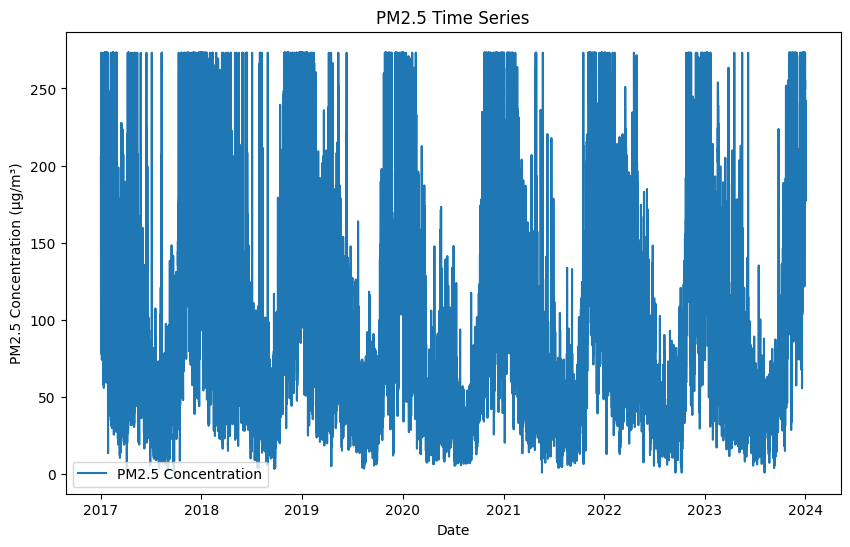

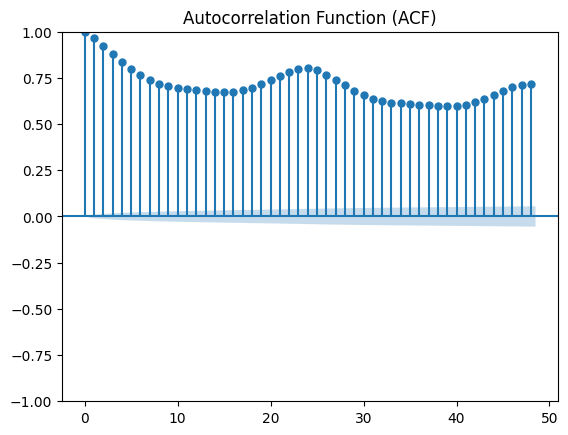

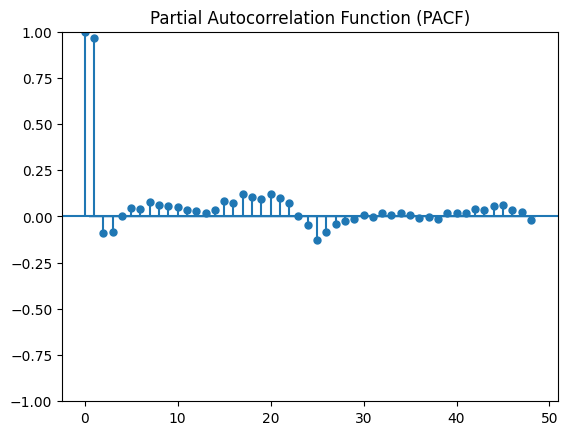

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)


                                     SARIMAX Results                                      
Dep. Variable:                          Avg_PM2.5   No. Observations:                61344
Model:             SARIMAX(1, 1, 1)x(1, 1, 1, 12)   Log Likelihood             -263984.372
Date:                            Fri, 25 Oct 2024   AIC                         527978.743
Time:                                    05:38:20   BIC                         528023.863
Sample:                                01-01-2017   HQIC                        527992.744
                                     - 12-31-2023                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9126      0.001    648.476      0.000       0.910       0.915
ma.L1         -0.9905      0.001  -

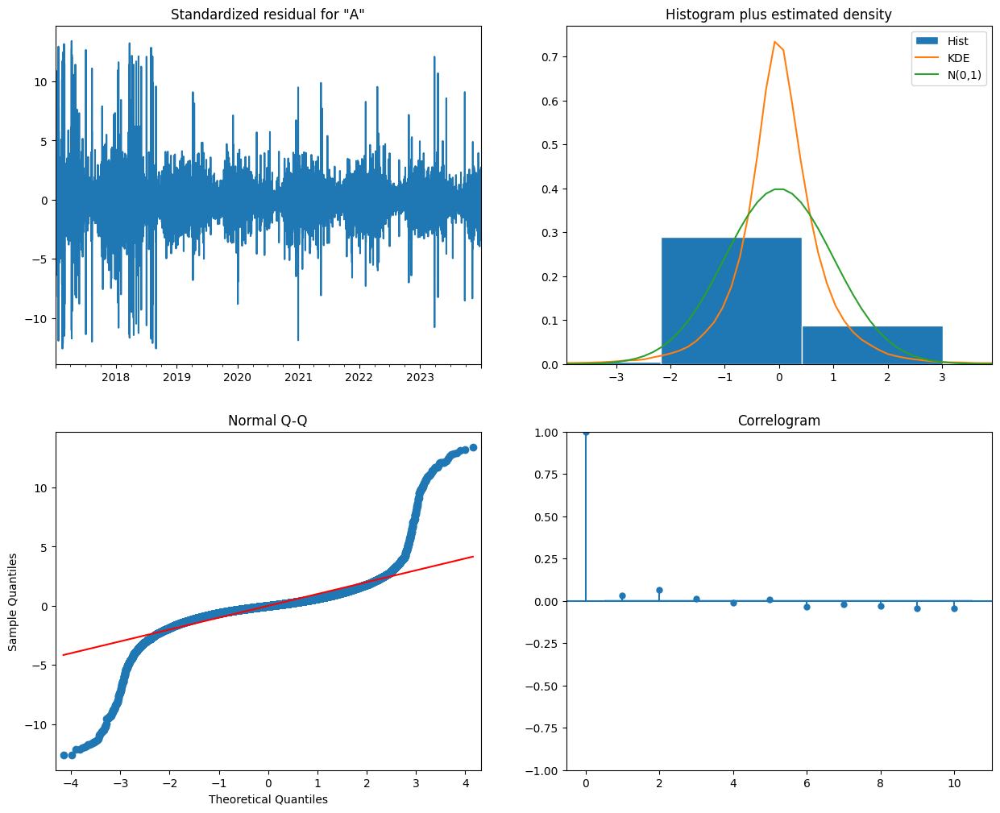

<ipython-input-12-7627ec77c72e>:102: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')


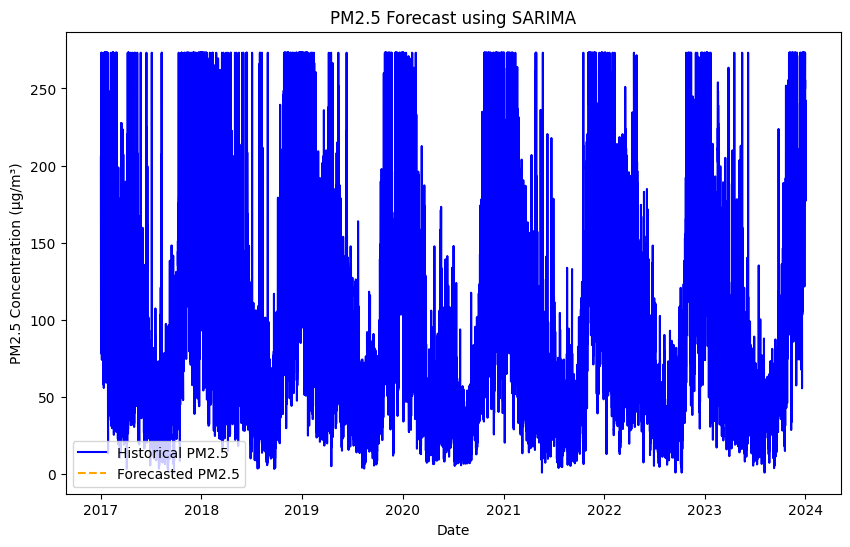

R² Score: 0.937176076817692


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller

# Load your dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update with the actual file path
data = pd.read_excel(file_path)

# Ensure the timestamp column is in datetime format and set as index
data['Timestamp'] = pd.to_datetime(data['Timestamp'])
data.set_index('Timestamp', inplace=True)

# Extract the PM2.5 series
pm25_series = data['Avg_PM2.5']

# Step 1: Handle missing values using linear interpolation
pm25_series = pm25_series.interpolate(method='linear')

# Check for any remaining NaNs
if pm25_series.isnull().any():
    print("There are still missing values in the PM2.5 series after interpolation.")
else:
    print("No missing values in the PM2.5 series.")

# Step 2: Outlier detection using IQR method
Q1 = pm25_series.quantile(0.25)
Q3 = pm25_series.quantile(0.75)
IQR = Q3 - Q1

# Define outlier bounds
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify outliers
outliers = pm25_series[(pm25_series < lower_bound) | (pm25_series > upper_bound)]

# Print outliers if any
if not outliers.empty:
    print(f"Detected outliers:\n{outliers}")
else:
    print("No outliers detected.")

# Optionally, you can remove or replace outliers
pm25_series = pm25_series.clip(lower=lower_bound, upper=upper_bound)

# Step 3: Check for stationarity
def test_stationarity(timeseries):
    """Perform ADF test to check stationarity."""
    result = adfuller(timeseries)
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    for key, value in result[4].items():
        print('Critical Values:')
        print(f'   {key}, {value}')

test_stationarity(pm25_series)

# Step 4: Visualize the time series
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='PM2.5 Concentration')
plt.title('PM2.5 Time Series')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()

# Step 5: Identify orders using ACF and PACF
plot_acf(pm25_series)
plt.title('Autocorrelation Function (ACF)')
plt.show()

plot_pacf(pm25_series)
plt.title('Partial Autocorrelation Function (PACF)')
plt.show()

# Step 6: Fit the SARIMA model
p = 1
d = 1
q = 1
P = 1
D = 1
Q = 1
S = 12  # Monthly data

# Fitting the SARIMA model
model = sm.tsa.SARIMAX(pm25_series, order=(p, d, q), seasonal_order=(P, D, Q, S))
results = model.fit()

# Step 7: Print summary of the model
print(results.summary())

# Step 8: Plot diagnostics
results.plot_diagnostics(figsize=(15, 12))
plt.show()

# Step 9: Forecasting
forecast_steps = 12  # Forecasting the next 12 months
forecast = results.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')

# Create a DataFrame to hold the forecasted values
forecast_df = pd.DataFrame(forecast.predicted_mean, index=forecast_index, columns=['Forecasted PM2.5'])

# Step 10: Visualize the forecast
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='Historical PM2.5', color='blue')
plt.plot(forecast_df, label='Forecasted PM2.5', color='orange', linestyle='--')
plt.title('PM2.5 Forecast using SARIMA')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()

# Step 11: Evaluate R² Score
fitted_values = results.fittedvalues
SS_res = np.sum((pm25_series[1:] - fitted_values) ** 2)  # Residual sum of squares
SS_tot = np.sum((pm25_series[1:] - np.mean(pm25_series[1:])) ** 2)  # Total sum of squares
r2_score = 1 - (SS_res / SS_tot)

print(f"R² Score: {r2_score}")


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller

# Load your dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Update with the actual file path
data = pd.read_excel(file_path)

# Ensure the timestamp column is in datetime format and set as index
data['Timestamp'] = pd.to_datetime(data['Timestamp'])
data.set_index('Timestamp', inplace=True)

# Extract the PM2.5 series
pm25_series = data['Avg_PM2.5']

# Step 1: Handle missing values using linear interpolation
pm25_series = pm25_series.interpolate(method='linear')

# Check for any remaining NaNs in PM2.5
if pm25_series.isnull().any():
    print("There are still missing values in the PM2.5 series after interpolation.")
else:
    print("No missing values in the PM2.5 series.")

# Step 2: Create additional features
data['Month'] = data.index.month
data['Sine'] = np.sin(2 * np.pi * data['Month'] / 12)
data['Cosine'] = np.cos(2 * np.pi * data['Month'] / 12)

# Step 3: Handle missing values for exogenous variables
data['Avg_AT (°C)'] = data['Avg_AT (°C)'].interpolate(method='linear')
data['Avg_RH (%)'] = data['Avg_RH (%)'].interpolate(method='linear')
data['Avg_VWS (m/s)'] = data['Avg_VWS (m/s)'].interpolate(method='linear')
data['Avg_WD (deg)'] = data['Avg_WD (deg)'].interpolate(method='linear')

# Check for NaNs in exogenous variables
if data[['Sine', 'Cosine', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']].isnull().any().any():
    print("Exogenous variables contain NaNs.")
else:
    print("No NaNs in exogenous variables.")

# Extract features for SARIMAX
X = data[['Sine', 'Cosine', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]

# Step 4: Check for stationarity
def test_stationarity(timeseries):
    """Perform ADF test to check stationarity."""
    result = adfuller(timeseries)
    print('ADF Statistic:', result[0])
    print('p-value:', result[1])
    for key, value in result[4].items():
        print('Critical Values:')
        print(f'   {key}, {value}')

test_stationarity(pm25_series)

# Step 5: Fit the SARIMA model with exogenous variables
p = 1
d = 1
q = 1
P = 1
D = 1
Q = 1
S = 12  # Monthly data

# Fitting the SARIMAX model
model = sm.tsa.SARIMAX(pm25_series, exog=X, order=(p, d, q), seasonal_order=(P, D, Q, S))
results = model.fit()

# Step 6: Print summary of the model
print(results.summary())

# Step 7: Plot diagnostics
results.plot_diagnostics(figsize=(15, 12))
plt.show()

# Step 8: Forecasting
forecast_steps = 12  # Forecasting the next 12 months
forecast = results.get_forecast(steps=forecast_steps)
forecast_index = pd.date_range(start=pm25_series.index[-1] + pd.Timedelta(days=1), periods=forecast_steps, freq='M')

# Create a DataFrame to hold the forecasted values
forecast_df = pd.DataFrame(forecast.predicted_mean, index=forecast_index, columns=['Forecasted PM2.5'])

# Step 9: Visualize the forecast
plt.figure(figsize=(10, 6))
plt.plot(pm25_series, label='Historical PM2.5', color='blue')
plt.plot(forecast_df, label='Forecasted PM2.5', color='orange', linestyle='--')
plt.title('PM2.5 Forecast using SARIMA')
plt.xlabel('Date')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.legend()
plt.show()

# Step 10: Evaluate R² Score
fitted_values = results.fittedvalues
SS_res = np.sum((pm25_series[1:] - fitted_values) ** 2)  # Residual sum of squares
SS_tot = np.sum((pm25_series[1:] - np.mean(pm25_series[1:])) ** 2)  # Total sum of squares
r2_score = 1 - (SS_res / SS_tot)

print(f"R² Score: {r2_score}")


No missing values in the PM2.5 series.
No NaNs in exogenous variables.
ADF Statistic: -12.264215600922686
p-value: 8.936323257324707e-23
Critical Values:
   1%, -3.4304567058368516
Critical Values:
   5%, -2.861587161979842
Critical Values:
   10%, -2.5667951027287517


/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency h will be used.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


No missing values in the features or target.
Random Forest Regressor:
  R² Score: 0.8647
  Mean Squared Error: 994.5349
  Mean Absolute Error: 17.3657

Gradient Boosting Regressor:
  R² Score: 0.5760
  Mean Squared Error: 3116.1139
  Mean Absolute Error: 35.7736

K-Nearest Neighbors:
  R² Score: 0.7953
  Mean Squared Error: 1504.0348
  Mean Absolute Error: 22.3177



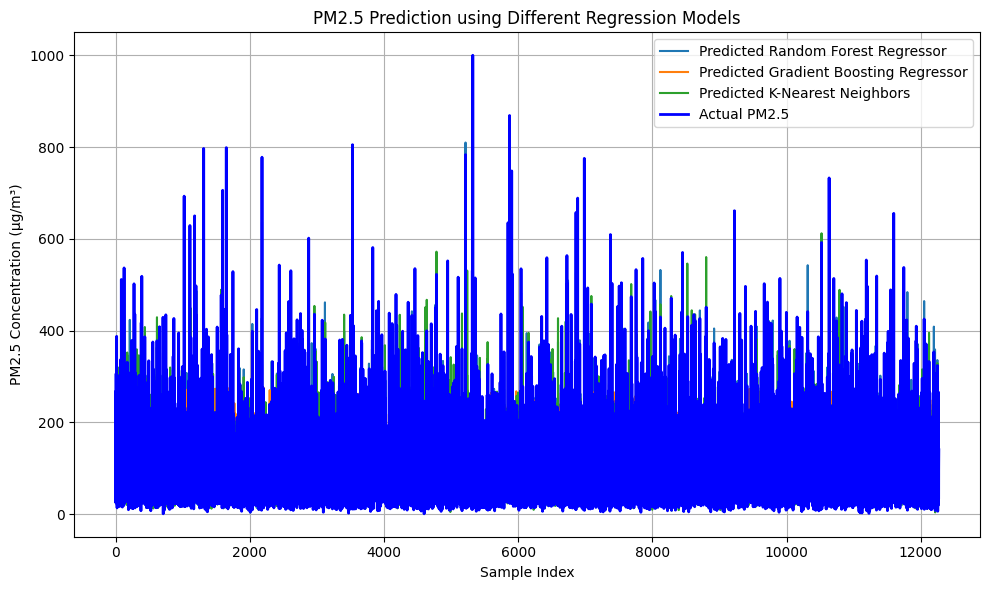

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Handle missing values using linear interpolation
data.interpolate(method='linear', inplace=True)

# Extract relevant datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features (X) and target variable (y)
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Check for any remaining NaNs
if X.isnull().any().any() or y.isnull().any():
    print("There are still missing values in the features or target after interpolation.")
else:
    print("No missing values in the features or target.")

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize the features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Define models
models = {
    'Random Forest Regressor': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting Regressor': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'K-Nearest Neighbors': KNeighborsRegressor(n_neighbors=5)
}

# Train and evaluate models
performance = {}
for name, model in models.items():
    model.fit(X_train_normalized, y_train)
    predictions = model.predict(X_test_normalized)

    # Calculate R², MSE, MAE
    r2 = r2_score(y_test, predictions)
    mse = mean_squared_error(y_test, predictions)
    mae = mean_absolute_error(y_test, predictions)

    performance[name] = {'R²': r2, 'MSE': mse, 'MAE': mae}

# Display performance metrics for each model
for model_name, metrics in performance.items():
    print(f"{model_name}:")
    print(f"  R² Score: {metrics['R²']:.4f}")
    print(f"  Mean Squared Error: {metrics['MSE']:.4f}")
    print(f"  Mean Absolute Error: {metrics['MAE']:.4f}")
    print()

# Visualization of predictions
plt.figure(figsize=(10, 6))
for name, model in models.items():
    predictions = model.predict(X_test_normalized)
    plt.plot(predictions, label=f'Predicted {name}')

plt.plot(y_test.values, label='Actual PM2.5', color='blue', linewidth=2)
plt.legend()
plt.title('PM2.5 Prediction using Different Regression Models')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


No missing values in the features or target.
Random Forest Regressor:
  R² Score: 0.8660
  Mean Squared Error: 985.0634
  Mean Absolute Error: 17.2158

Gradient Boosting Regressor:
  R² Score: 0.5760
  Mean Squared Error: 3116.1139
  Mean Absolute Error: 35.7736

K-Nearest Neighbors:
  R² Score: 0.7953
  Mean Squared Error: 1504.0348
  Mean Absolute Error: 22.3177



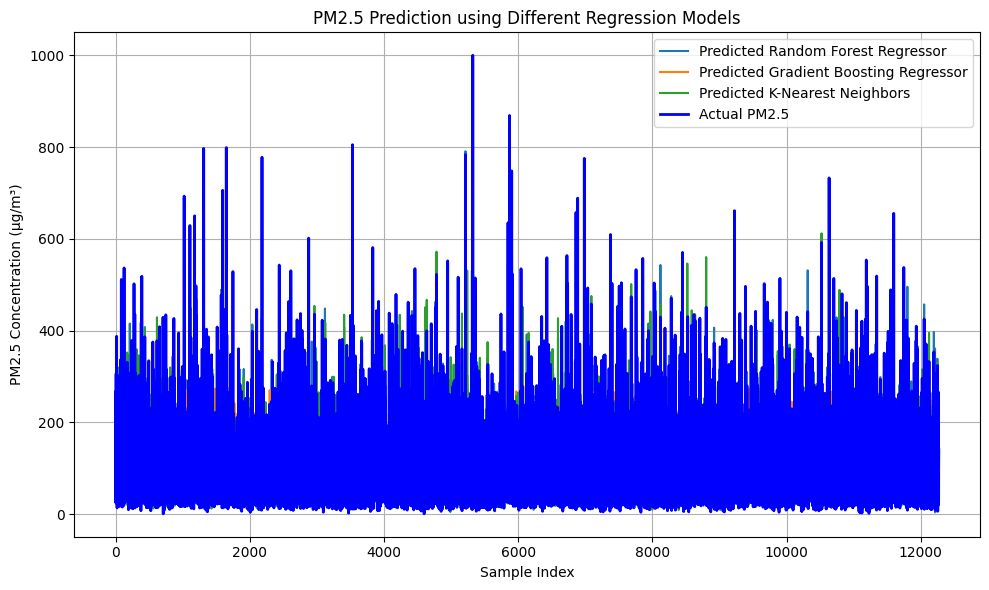

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Handle missing values using linear interpolation
data.interpolate(method='linear', inplace=True)

# Extract relevant datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features (X) and target variable (y)
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Check for any remaining NaNs
if X.isnull().any().any() or y.isnull().any():
    print("There are still missing values in the features or target after interpolation.")
else:
    print("No missing values in the features or target.")

# Split the data into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize the features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Define models
models = {
    'Random Forest Regressor': RandomForestRegressor(n_estimators=1000, max_features=12, random_state=42),
    'Gradient Boosting Regressor': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'K-Nearest Neighbors': KNeighborsRegressor(n_neighbors=5)
}

# Train and evaluate models
performance = {}
for name, model in models.items():
    model.fit(X_train_normalized, y_train)
    predictions = model.predict(X_test_normalized)

    # Calculate R², MSE, MAE
    r2 = r2_score(y_test, predictions)
    mse = mean_squared_error(y_test, predictions)
    mae = mean_absolute_error(y_test, predictions)

    performance[name] = {'R²': r2, 'MSE': mse, 'MAE': mae}

# Display performance metrics for each model
for model_name, metrics in performance.items():
    print(f"{model_name}:")
    print(f"  R² Score: {metrics['R²']:.4f}")
    print(f"  Mean Squared Error: {metrics['MSE']:.4f}")
    print(f"  Mean Absolute Error: {metrics['MAE']:.4f}")
    print()

# Visualization of predictions
plt.figure(figsize=(10, 6))
for name, model in models.items():
    predictions = model.predict(X_test_normalized)
    plt.plot(predictions, label=f'Predicted {name}')

plt.plot(y_test.values, label='Actual PM2.5', color='blue', linewidth=2)
plt.legend()
plt.title('PM2.5 Prediction using Different Regression Models')
plt.xlabel('Sample Index')
plt.ylabel('PM2.5 Concentration (µg/m³)')
plt.grid()
plt.tight_layout()
plt.show()


Winter Performance:
  Train R² Score: 0.9705
  Test R² Score: 0.7833
  Train Mean Squared Error: 240.2081
  Test Mean Squared Error: 1767.4822
  Train Mean Absolute Error: 9.2479
  Test Mean Absolute Error: 24.4012

Spring Performance:
  Train R² Score: 0.9583
  Test R² Score: 0.6940
  Train Mean Squared Error: 87.4307
  Test Mean Squared Error: 612.0007
  Train Mean Absolute Error: 5.8641
  Test Mean Absolute Error: 15.7402

Summer Performance:
  Train R² Score: 0.9649
  Test R² Score: 0.7589
  Train Mean Squared Error: 31.6680
  Test Mean Squared Error: 253.4590
  Train Mean Absolute Error: 3.1546
  Test Mean Absolute Error: 8.6994

Fall Performance:
  Train R² Score: 0.9874
  Test R² Score: 0.9109
  Train Mean Squared Error: 140.1749
  Test Mean Squared Error: 1100.3498
  Train Mean Absolute Error: 6.5056
  Test Mean Absolute Error: 17.9166



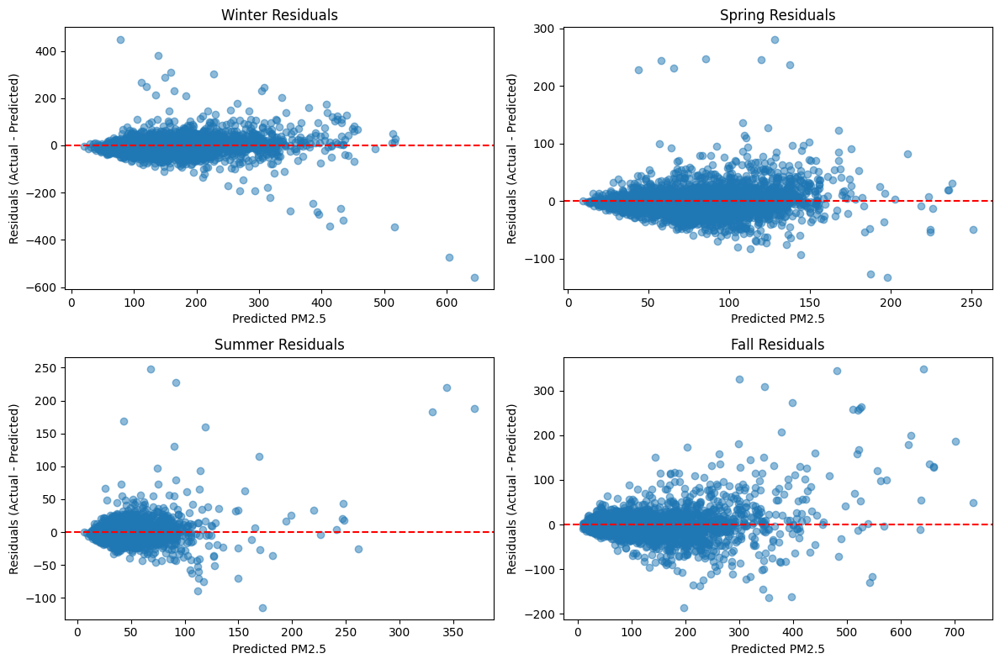

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Handle missing values using linear interpolation
data.interpolate(method='linear', inplace=True)

# Extract relevant datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define seasons based on the Month
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Fall'

data['Season'] = data['Month'].apply(get_season)

# Initialize performance storage
season_performance = {}

# Loop through each season to create separate Random Forest models
for season in data['Season'].unique():
    season_data = data[data['Season'] == season]

    # Define features (X) and target variable (y)
    X = season_data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
    y = season_data['Avg_PM2.5']

    # Split the data into training and testing sets (80% train, 20% test)
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    # Normalize the features
    scaler = MinMaxScaler()
    X_train_normalized = scaler.fit_transform(X_train)
    X_test_normalized = scaler.transform(X_test)

    # Define and train the Random Forest model
    rf_model = RandomForestRegressor(n_estimators=1000, max_features=12, random_state=42)
    rf_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = rf_model.predict(X_train_normalized)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Calculate performance metrics
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    train_mse = mean_squared_error(y_train, y_train_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)
    train_mae = mean_absolute_error(y_train, y_train_pred)
    test_mae = mean_absolute_error(y_test, y_test_pred)

    # Store the performance metrics for the current season
    season_performance[season] = {
        'Train R²': train_r2,
        'Test R²': test_r2,
        'Train MSE': train_mse,
        'Test MSE': test_mse,
        'Train MAE': train_mae,
        'Test MAE': test_mae
    }

# Display performance metrics for each season
for season_name, metrics in season_performance.items():
    print(f"{season_name} Performance:")
    print(f"  Train R² Score: {metrics['Train R²']:.4f}")
    print(f"  Test R² Score: {metrics['Test R²']:.4f}")
    print(f"  Train Mean Squared Error: {metrics['Train MSE']:.4f}")
    print(f"  Test Mean Squared Error: {metrics['Test MSE']:.4f}")
    print(f"  Train Mean Absolute Error: {metrics['Train MAE']:.4f}")
    print(f"  Test Mean Absolute Error: {metrics['Test MAE']:.4f}\n")

# Optional: Plotting Residuals for Each Season
plt.figure(figsize=(12, 8))
for season in season_performance.keys():
    season_data = data[data['Season'] == season]
    X = season_data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
    y = season_data['Avg_PM2.5']

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    X_train_normalized = scaler.fit_transform(X_train)
    X_test_normalized = scaler.transform(X_test)

    # Predictions
    rf_model.fit(X_train_normalized, y_train)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Plotting Residuals
    residuals = y_test - y_test_pred
    plt.subplot(2, 2, list(season_performance.keys()).index(season) + 1)
    plt.scatter(y_test_pred, residuals, alpha=0.5)
    plt.axhline(0, color='red', linestyle='--')
    plt.title(f'{season} Residuals')
    plt.xlabel('Predicted PM2.5')
    plt.ylabel('Residuals (Actual - Predicted)')

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

In [ ]:
# Import required libraries
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Handle missing values
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year


In [ ]:
# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)


NameError: name 'data' is not defined

In [ ]:
def evaluate_rf_model(n_estimators=100, max_depth=10, min_samples_split=5):
    # Initialize the model with adjustable parameters
    rf_model = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth,
                                     min_samples_split=min_samples_split, random_state=42)

    # Train the model
    rf_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = rf_model.predict(X_train_normalized)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print the R² scores
    print(f"Model Performance: {n_estimators} Estimators, Max Depth {max_depth}")
    print(f"Train R²: {performance['Train R²']:.4f}, Test R²: {performance['Test R²']:.4f}")
    return performance


In [ ]:
# Example: Running with 160 estimators and max depth 20
evaluate_rf_model(n_estimators=160, max_depth=20, min_samples_split=5)


Model Performance: 160 Estimators, Max Depth 20
Train R²: 0.9649, Test R²: 0.8572


{'Train R²': 0.964928816569992,
 'Test R²': 0.8572044169149928,
 'Train MSE': 265.6191504158967,
 'Test MSE': 1049.3322298546175,
 'Train MAE': 9.103495178203366,
 'Test MAE': 18.10379616857936}

In [ ]:
# Example: Running with 160 estimators and max depth 20
evaluate_rf_model(n_estimators=170, max_depth=20, min_samples_split=5)

Model Performance: 170 Estimators, Max Depth 20
Train R²: 0.9649, Test R²: 0.8572


{'Train R²': 0.964907113940882,
 'Test R²': 0.8571833689686303,
 'Train MSE': 265.78351994501435,
 'Test MSE': 1049.4869005244886,
 'Train MAE': 9.103067662045312,
 'Test MAE': 18.100794369369932}

In [ ]:
# Example: Running with 160 estimators and max depth 20
evaluate_rf_model(n_estimators=290, max_depth=20, min_samples_split=17)

Model Performance: 290 Estimators, Max Depth 20
Train R²: 0.9044, Test R²: 0.8195


{'Train R²': 0.904379431371264,
 'Test R²': 0.8194681795957438,
 'Train MSE': 724.2029414872244,
 'Test MSE': 1326.6366758118695,
 'Train MAE': 15.284392137139347,
 'Test MAE': 20.952034627261654}

Model Performance: 294 Estimators, Max Depth 20
Train R²: 0.9768, Test R²: 0.8629


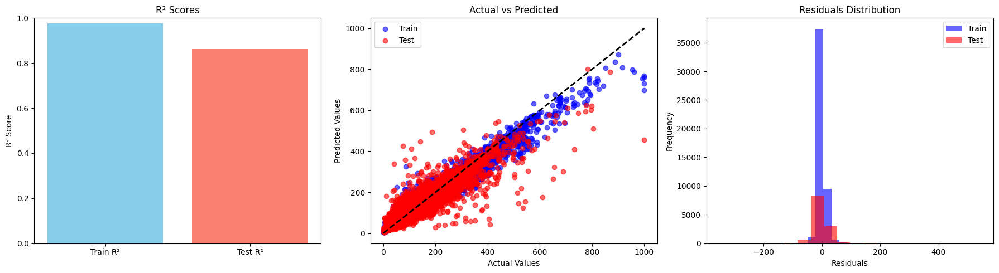

{'Train R²': 0.9768069933379208,
 'Test R²': 0.8628641668009718,
 'Train MSE': 175.6572240416783,
 'Test MSE': 1007.7416019096471,
 'Train MAE': 7.723903913446613,
 'Test MAE': 17.6382320647124}

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor

def evaluate_rf_model(n_estimators=100, max_depth=10, min_samples_split=5, min_samples_leaf=1):
    # Initialize the model with adjustable parameters
    rf_model = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        random_state=42
    )

    # Train the model
    rf_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = rf_model.predict(X_train_normalized)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print the R² scores
    print(f"Model Performance: {n_estimators} Estimators, Max Depth {max_depth}")
    print(f"Train R²: {performance['Train R²']:.4f}, Test R²: {performance['Test R²']:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Test R²'], [performance['Train R²'], performance['Test R²']], color=['skyblue', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

    return performance

# Example usage with 170 estimators, max depth of 20, min_samples_split of 5, and min_samples_leaf of 1
evaluate_rf_model(n_estimators=294, max_depth=20, min_samples_split=2, min_samples_leaf=1)


Model Performance: 294 Estimators, Max Depth 20
Train R²: 0.9763
Validation R²: 0.8374
Test R²: 0.8520
Train MSE: 179.5404
Validation MSE: 1238.7104
Test MSE: 1075.5664
Train MAE: 7.8929
Validation MAE: 19.3338
Test MAE: 18.6234


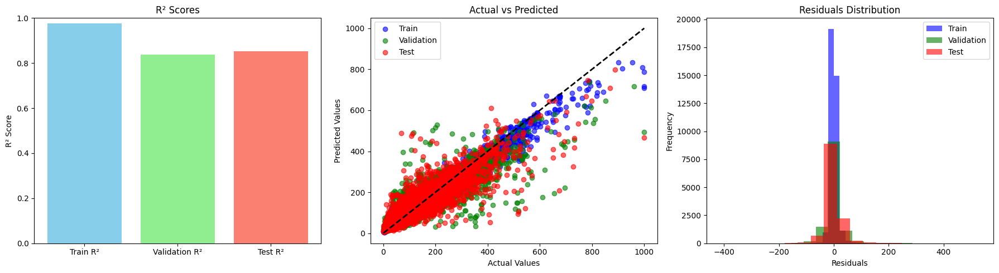

{'Train R²': 0.9763321305133866,
 'Validation R²': 0.8373609301208685,
 'Test R²': 0.8520337732785077,
 'Train MSE': 179.54043284451885,
 'Validation MSE': 1238.7104323486608,
 'Test MSE': 1075.5663832274995,
 'Train MAE': 7.892889019770854,
 'Validation MAE': 19.333761670453487,
 'Test MAE': 18.62336790778129}

In [ ]:
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

# Split the data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features (assuming scaler is defined and applied consistently)
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

def evaluate_rf_model(n_estimators=100, max_depth=10, min_samples_split=5, min_samples_leaf=1):
    # Initialize the RandomForest model with adjustable parameters
    rf_model = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        random_state=42
    )

    # Train the model
    rf_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = rf_model.predict(X_train_normalized)
    y_val_pred = rf_model.predict(X_val_normalized)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Validation R²': r2_score(y_val, y_val_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Validation MSE': mean_squared_error(y_val, y_val_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Validation MAE': mean_absolute_error(y_val, y_val_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print the R² scores
    print(f"Model Performance: {n_estimators} Estimators, Max Depth {max_depth}")
    for key, value in performance.items():
        print(f"{key}: {value:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Validation R²', 'Test R²'],
               [performance['Train R²'], performance['Validation R²'], performance['Test R²']],
               color=['skyblue', 'lightgreen', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_val, y_val_pred, color='green', alpha=0.6, label='Validation')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    val_residuals = y_val - y_val_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(val_residuals, bins=20, alpha=0.6, color='green', label='Validation')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

    return performance

# Example usage with specified parameters
evaluate_rf_model(n_estimators=294, max_depth=20, min_samples_split=2, min_samples_leaf=1)


Model Performance with 294 Estimators, Max Depth 20:
Train R²: 0.9763
Validation R²: 0.8374
Test R²: 0.8520
Train MSE: 179.5404
Validation MSE: 1238.7104
Test MSE: 1075.5664
Train MAE: 7.8929
Validation MAE: 19.3338
Test MAE: 18.6234


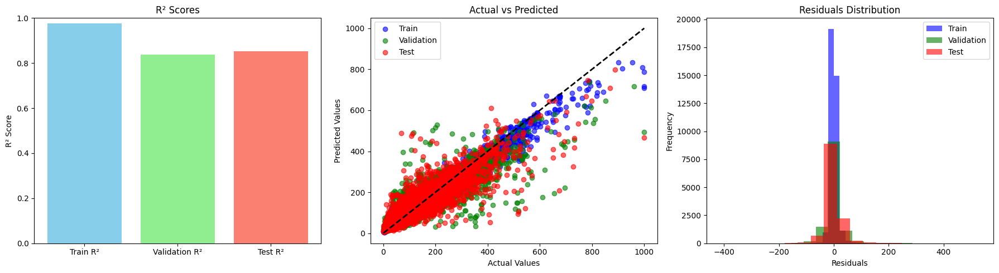

{'Train R²': 0.9763321305133866,
 'Validation R²': 0.8373609301208685,
 'Test R²': 0.8520337732785077,
 'Train MSE': 179.54043284451885,
 'Validation MSE': 1238.7104323486608,
 'Test MSE': 1075.5663832274995,
 'Train MAE': 7.892889019770854,
 'Validation MAE': 19.333761670453487,
 'Test MAE': 18.62336790778129}

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

# Assuming 'X' and 'y' are defined and the data has been loaded and preprocessed
# Split the data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features (assuming scaler is defined and applied consistently)
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

def evaluate_rf_model(n_estimators=100, max_depth=10, min_samples_split=5, min_samples_leaf=1):
    # Initialize the RandomForest model with adjustable parameters
    rf_model = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        random_state=42
    )

    # Train the model
    rf_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = rf_model.predict(X_train_normalized)
    y_val_pred = rf_model.predict(X_val_normalized)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Validation R²': r2_score(y_val, y_val_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Validation MSE': mean_squared_error(y_val, y_val_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Validation MAE': mean_absolute_error(y_val, y_val_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print the R² scores and other metrics
    print(f"Model Performance with {n_estimators} Estimators, Max Depth {max_depth}:")
    for key, value in performance.items():
        print(f"{key}: {value:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Validation R²', 'Test R²'],
               [performance['Train R²'], performance['Validation R²'], performance['Test R²']],
               color=['skyblue', 'lightgreen', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_val, y_val_pred, color='green', alpha=0.6, label='Validation')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    val_residuals = y_val - y_val_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(val_residuals, bins=20, alpha=0.6, color='green', label='Validation')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

    return performance

# Example usage with specified parameters
evaluate_rf_model(n_estimators=294, max_depth=20, min_samples_split=2, min_samples_leaf=1)


Model Performance: 294 Estimators, Max Depth 20
Train R²: 0.9763
Validation R²: 0.8374
Test R²: 0.8520
Train MSE: 179.5404
Validation MSE: 1238.7104
Test MSE: 1075.5664
Train MAE: 7.8929
Validation MAE: 19.3338
Test MAE: 18.6234


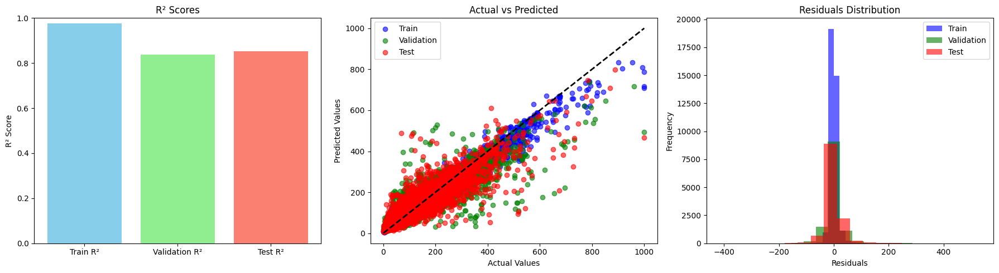

{'Train R²': 0.9763321305133866,
 'Validation R²': 0.8373609301208685,
 'Test R²': 0.8520337732785077,
 'Train MSE': 179.54043284451885,
 'Validation MSE': 1238.7104323486608,
 'Test MSE': 1075.5663832274995,
 'Train MAE': 7.892889019770854,
 'Validation MAE': 19.333761670453487,
 'Test MAE': 18.62336790778129}

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split

# Define the model training and evaluation function
def evaluate_rf_model(n_estimators=100, max_depth=10, min_samples_split=5, min_samples_leaf=1):
    # Initialize the RandomForest model with adjustable parameters
    rf_model = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        random_state=42
    )

    # Train the model
    rf_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = rf_model.predict(X_train_normalized)
    y_val_pred = rf_model.predict(X_val_normalized)
    y_test_pred = rf_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Validation R²': r2_score(y_val, y_val_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Validation MSE': mean_squared_error(y_val, y_val_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Validation MAE': mean_absolute_error(y_val, y_val_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print the R² scores
    print(f"Model Performance: {n_estimators} Estimators, Max Depth {max_depth}")
    for key, value in performance.items():
        print(f"{key}: {value:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Validation R²', 'Test R²'],
               [performance['Train R²'], performance['Validation R²'], performance['Test R²']],
               color=['skyblue', 'lightgreen', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_val, y_val_pred, color='green', alpha=0.6, label='Validation')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    val_residuals = y_val - y_val_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(val_residuals, bins=20, alpha=0.6, color='green', label='Validation')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

    return performance

# Example usage with specified parameters
evaluate_rf_model(n_estimators=294, max_depth=20, min_samples_split=2, min_samples_leaf=1)


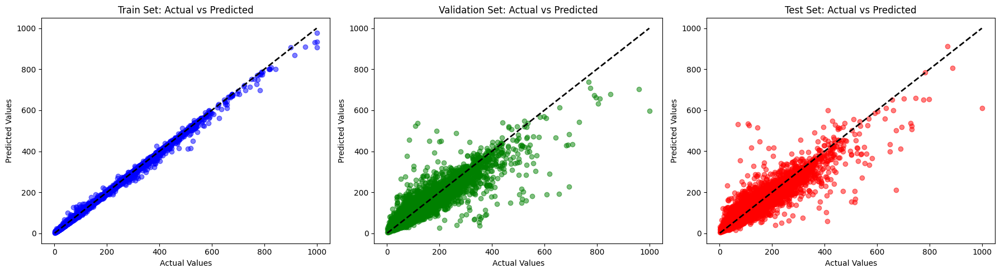

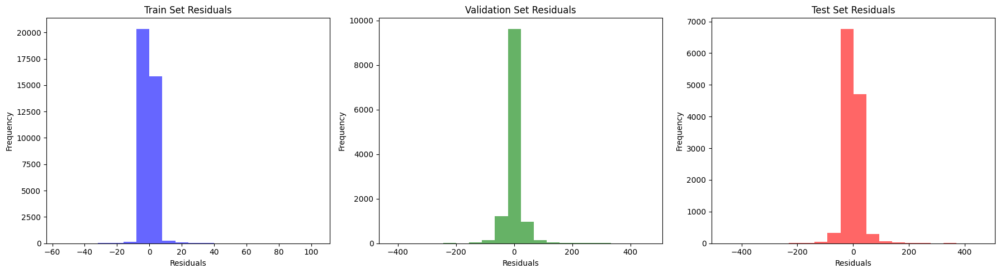

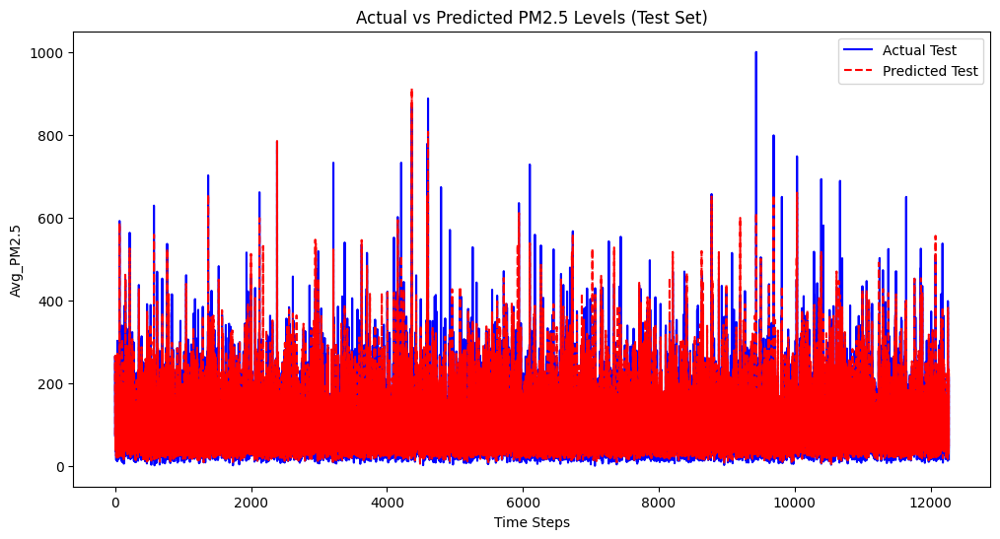

In [ ]:
# Scatter plot of Actual vs Predicted values
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
for i, (y_true, y_pred, title, color) in enumerate(
    [(y_train, y_train_pred, "Train Set: Actual vs Predicted", 'blue'),
     (y_val, y_val_pred, "Validation Set: Actual vs Predicted", 'green'),
     (y_test, y_test_pred, "Test Set: Actual vs Predicted", 'red')]):

    axs[i].scatter(y_true, y_pred, color=color, alpha=0.5)
    axs[i].plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'k--', lw=2)
    axs[i].set_title(title)
    axs[i].set_xlabel("Actual Values")
    axs[i].set_ylabel("Predicted Values")
plt.tight_layout()
plt.show()

# Residuals Analysis
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
for i, (residuals, title, color) in enumerate(
    [(y_train - y_train_pred, "Train Set Residuals", 'blue'),
     (y_val - y_val_pred, "Validation Set Residuals", 'green'),
     (y_test - y_test_pred, "Test Set Residuals", 'red')]):

    axs[i].hist(residuals, bins=20, color=color, alpha=0.6)
    axs[i].set_title(title)
    axs[i].set_xlabel("Residuals")
    axs[i].set_ylabel("Frequency")
plt.tight_layout()
plt.show()

# Line plot of predicted vs. actual values for Test set
plt.figure(figsize=(12, 6))
plt.plot(y_test.values, label="Actual Test", color='blue', linestyle='-')
plt.plot(y_test_pred, label="Predicted Test", color='red', linestyle='--')
plt.title("Actual vs Predicted PM2.5 Levels (Test Set)")
plt.xlabel("Time Steps")
plt.ylabel("Avg_PM2.5")
plt.legend()
plt.show()

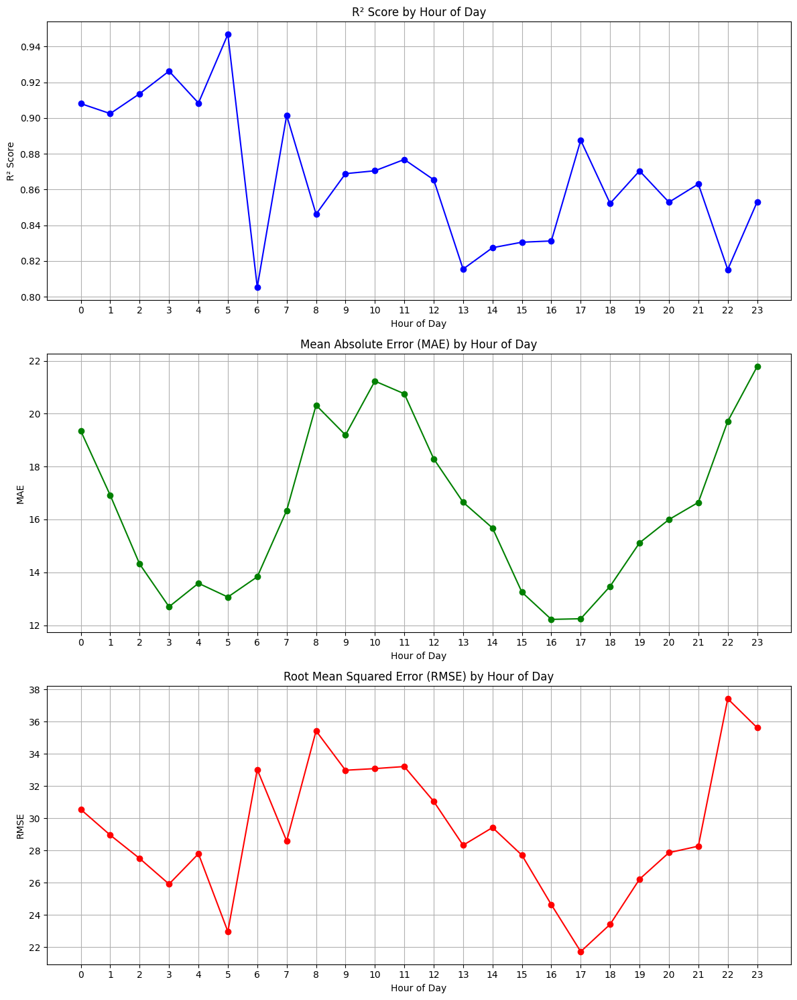

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# Assuming y_test, y_test_pred, and X_test are defined and we want to analyze by 'Hour'

# Add hour information to y_test and y_test_pred for grouping
test_results = pd.DataFrame({
    'Actual': y_test,
    'Predicted': y_test_pred,
    'Hour': X_test['Hour'].values  # Assuming 'Hour' column exists in X_test
})

# Initialize lists to store per-hour metrics
hours = []
hourly_r2 = []
hourly_mae = []
hourly_rmse = []

# Calculate metrics for each hour of the day
for hour in sorted(test_results['Hour'].unique()):
    hour_data = test_results[test_results['Hour'] == hour]

    r2 = r2_score(hour_data['Actual'], hour_data['Predicted'])
    mae = mean_absolute_error(hour_data['Actual'], hour_data['Predicted'])
    rmse = np.sqrt(mean_squared_error(hour_data['Actual'], hour_data['Predicted']))

    hours.append(hour)
    hourly_r2.append(r2)
    hourly_mae.append(mae)
    hourly_rmse.append(rmse)

# Visualization
fig, axs = plt.subplots(3, 1, figsize=(12, 15))

# R² Score per Hour
axs[0].plot(hours, hourly_r2, marker='o', linestyle='-', color='blue')
axs[0].set_title('R² Score by Hour of Day')
axs[0].set_xlabel('Hour of Day')
axs[0].set_ylabel('R² Score')
axs[0].set_xticks(range(0, 24))
axs[0].grid()

# MAE per Hour
axs[1].plot(hours, hourly_mae, marker='o', linestyle='-', color='green')
axs[1].set_title('Mean Absolute Error (MAE) by Hour of Day')
axs[1].set_xlabel('Hour of Day')
axs[1].set_ylabel('MAE')
axs[1].set_xticks(range(0, 24))
axs[1].grid()

# RMSE per Hour
axs[2].plot(hours, hourly_rmse, marker='o', linestyle='-', color='red')
axs[2].set_title('Root Mean Squared Error (RMSE) by Hour of Day')
axs[2].set_xlabel('Hour of Day')
axs[2].set_ylabel('RMSE')
axs[2].set_xticks(range(0, 24))
axs[2].grid()

plt.tight_layout()
plt.show()


Model Performance:
Train R²: 1.0000
Test R²: 0.9878
Train MSE: 0.0256
Test MSE: 89.3272
Train MAE: 0.0894
Test MAE: 3.3194


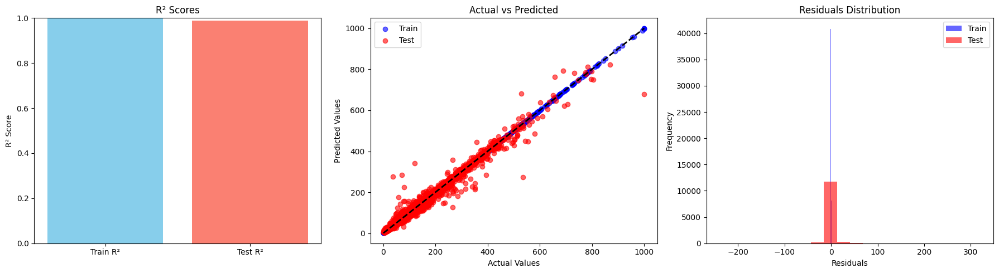

{'Train R²': 0.9999966249759512,
 'Test R²': 0.987844139818807,
 'Train MSE': 0.02556147049522141,
 'Test MSE': 89.3272438415596,
 'Train MAE': 0.08935500931092277,
 'Test MAE': 3.3193911215165115}

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor



# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)
# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Handle missing values
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define and train the XGBRegressor model
def evaluate_xgb_model(n_estimators=100, max_depth=10, learning_rate=0.1, min_child_weight=1, subsample=1.0):
    # Initialize the XGBRegressor
    xgb_model = XGBRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        min_child_weight=min_child_weight,
        subsample=subsample,
        random_state=42
    )

    # Train the model
    xgb_model.fit(X_train, y_train)

    # Predictions
    y_train_pred = xgb_model.predict(X_train)
    y_test_pred = xgb_model.predict(X_test)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print performance metrics
    print("Model Performance:")
    for metric, value in performance.items():
        print(f"{metric}: {value:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Test R²'], [performance['Train R²'], performance['Test R²']], color=['skyblue', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

    return performance

# Run the evaluation with specified parameters
evaluate_xgb_model(n_estimators=294, max_depth=20, learning_rate=0.05, min_child_weight=2, subsample=0.8)


Model Performance:
Train R²: 0.9990
Test R²: 0.8888
Train MSE: 7.8016
Test MSE: 817.3063
Train MAE: 1.3797
Test MAE: 15.2173


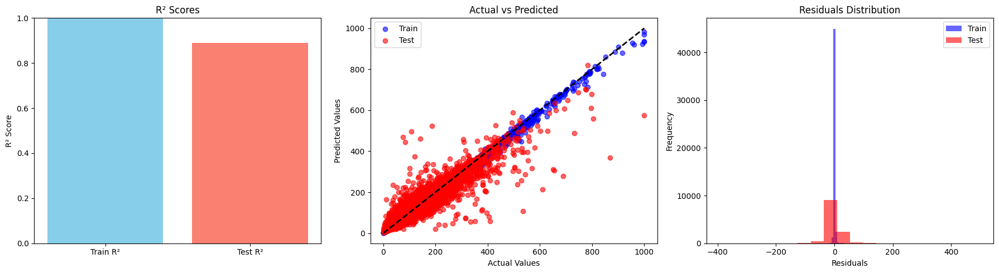

{'Train R²': 0.9989699127054273,
 'Test R²': 0.888779048778964,
 'Train MSE': 7.801587664831758,
 'Test MSE': 817.3062935836368,
 'Train MAE': 1.3797273910067824,
 'Test MAE': 15.21728346708437}

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBRegressor

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
def evaluate_xgb_model(n_estimators=100, max_depth=10, learning_rate=0.1, min_child_weight=1, subsample=1.0):
    # Initialize the XGBRegressor
    xgb_model = XGBRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        min_child_weight=min_child_weight,
        subsample=subsample,
        random_state=42
    )

    # Train the model
    xgb_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = xgb_model.predict(X_train_normalized)
    y_test_pred = xgb_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print performance metrics
    print("Model Performance:")
    for metric, value in performance.items():
        print(f"{metric}: {value:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Test R²'], [performance['Train R²'], performance['Test R²']], color=['skyblue', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()

    return performance

# Run the evaluation with specified parameters
evaluate_xgb_model(n_estimators=294, max_depth=20, learning_rate=0.025500916544420573, min_child_weight=2, subsample=0.7434753286589282)


Train Data Summary:
               Hour           Day         Month          Year   Avg_AT (°C)  \
count  49075.000000  49075.000000  49075.000000  49075.000000  49075.000000   
mean      11.495079     15.715660      6.518512   2019.996454     25.330419   
std        6.932163      8.813328      3.447508      1.999059      8.427542   
min        0.000000      1.000000      1.000000   2017.000000      1.230000   
25%        5.000000      8.000000      4.000000   2018.000000     19.015000   
50%       11.000000     16.000000      7.000000   2020.000000     26.665000   
75%       18.000000     23.000000     10.000000   2022.000000     31.475000   
max       23.000000     31.000000     12.000000   2023.000000     48.150000   

         Avg_RH (%)  Avg_VWS (m/s)  Avg_WD (deg)  
count  49075.000000   49075.000000  49075.000000  
mean      59.493111      -0.064477    202.747953  
std       20.212694       1.004120     54.113534  
min        3.336667     -12.020000      0.230000  
25%       44.

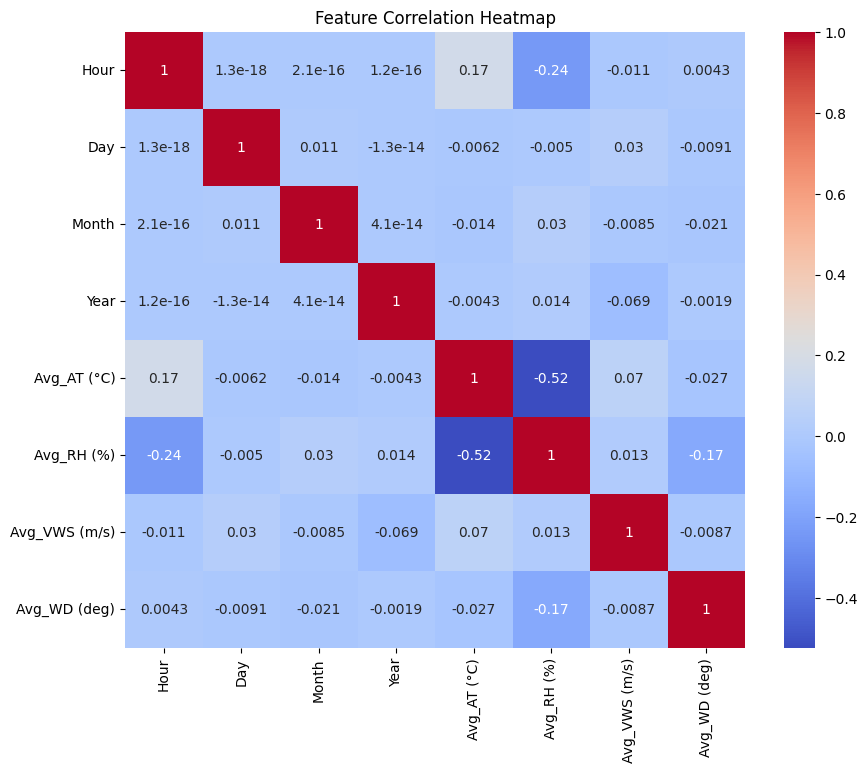


Model Performance:
Train R²: 0.9990
Test R²: 0.8883
Train MSE: 7.2811
Test MSE: 821.0765
Train MAE: 1.3384
Test MAE: 15.2493


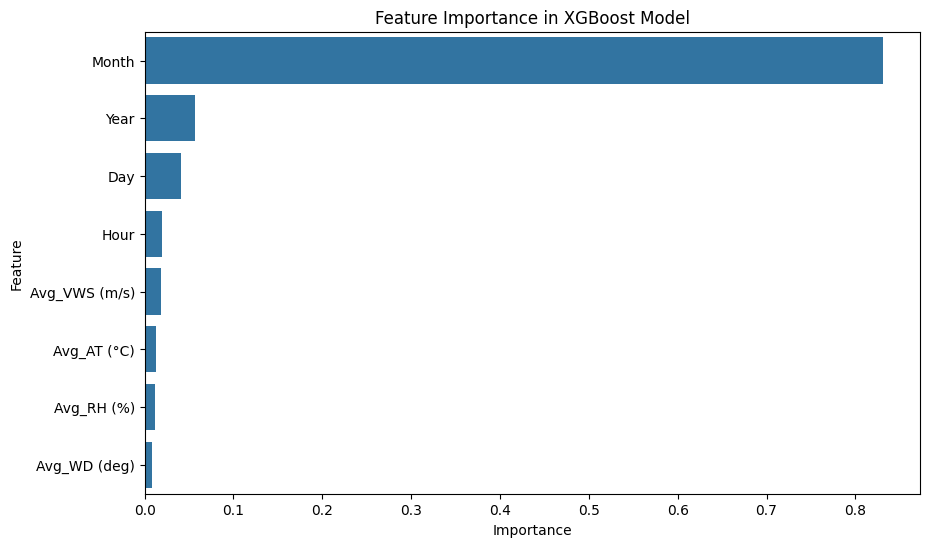

In [ ]:
import pandas as pd ################
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Statistical Summary for Train and Test
print("Train Data Summary:")
print(X_train.describe())
print("\nTest Data Summary:")
print(X_test.describe())

# T-test to compare distributions between Train and Test for each feature
print("\nT-test results between Train and Test sets:")
for column in X.columns:
    stat, p_value = ttest_ind(X_train[column], X_test[column], nan_policy='omit')
    print(f"{column}: T-statistic = {stat:.4f}, p-value = {p_value:.4f}")

# Correlation Analysis
plt.figure(figsize=(10, 8))
sns.heatmap(X.corr(), annot=True, cmap="coolwarm")
plt.title("Feature Correlation Heatmap")
plt.show()

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Predictions
y_train_pred = xgb_model.predict(X_train_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate performance metrics
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_mse = mean_squared_error(y_train, y_train_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

print("\nModel Performance:")
print(f"Train R²: {train_r2:.4f}")
print(f"Test R²: {test_r2:.4f}")
print(f"Train MSE: {train_mse:.4f}")
print(f"Test MSE: {test_mse:.4f}")
print(f"Train MAE: {train_mae:.4f}")
print(f"Test MAE: {test_mae:.4f}")

# Feature Importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Split the data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)
xgb_model.fit(X_train_normalized, y_train)

# Make predictions
y_train_pred = xgb_model.predict(X_train_normalized)
y_val_pred = xgb_model.predict(X_val_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate R² and other metrics for each set
performance = {
    'Train R²': r2_score(y_train, y_train_pred),
    'Validation R²': r2_score(y_val, y_val_pred),
    'Test R²': r2_score(y_test, y_test_pred),
    'Train MSE': mean_squared_error(y_train, y_train_pred),
    'Validation MSE': mean_squared_error(y_val, y_val_pred),
    'Test MSE': mean_squared_error(y_test, y_test_pred),
    'Train MAE': mean_absolute_error(y_train, y_train_pred),
    'Validation MAE': mean_absolute_error(y_val, y_val_pred),
    'Test MAE': mean_absolute_error(y_test, y_test_pred)
}

# Display performance metrics
print("\nModel Performance:")
for metric, value in performance.items():
    print(f"{metric}: {value:.4f}")

# Plotting R² scores for train, validation, and test sets
plt.figure(figsize=(8, 5))
plt.bar(['Train R²', 'Validation R²', 'Test R²'],
        [performance['Train R²'], performance['Validation R²'], performance['Test R²']],
        color=['skyblue', 'lightgreen', 'salmon'])
plt.title("R² Scores for Train, Validation, and Test Sets")
plt.ylim(0, 1)
plt.ylabel("R² Score")
plt.show()


KeyboardInterrupt: 

Train Data Summary:
               Hour           Day         Month          Year   Avg_AT (°C)  \
count  49075.000000  49075.000000  49075.000000  49075.000000  49075.000000   
mean      11.495079     15.715660      6.518512   2019.996454     25.330419   
std        6.932163      8.813328      3.447508      1.999059      8.427542   
min        0.000000      1.000000      1.000000   2017.000000      1.230000   
25%        5.000000      8.000000      4.000000   2018.000000     19.015000   
50%       11.000000     16.000000      7.000000   2020.000000     26.665000   
75%       18.000000     23.000000     10.000000   2022.000000     31.475000   
max       23.000000     31.000000     12.000000   2023.000000     48.150000   

         Avg_RH (%)  Avg_VWS (m/s)  
count  49075.000000   49075.000000  
mean      59.493111      -0.064477  
std       20.212694       1.004120  
min        3.336667     -12.020000  
25%       44.160000      -0.385000  
50%       61.640000       0.001096  
75%      

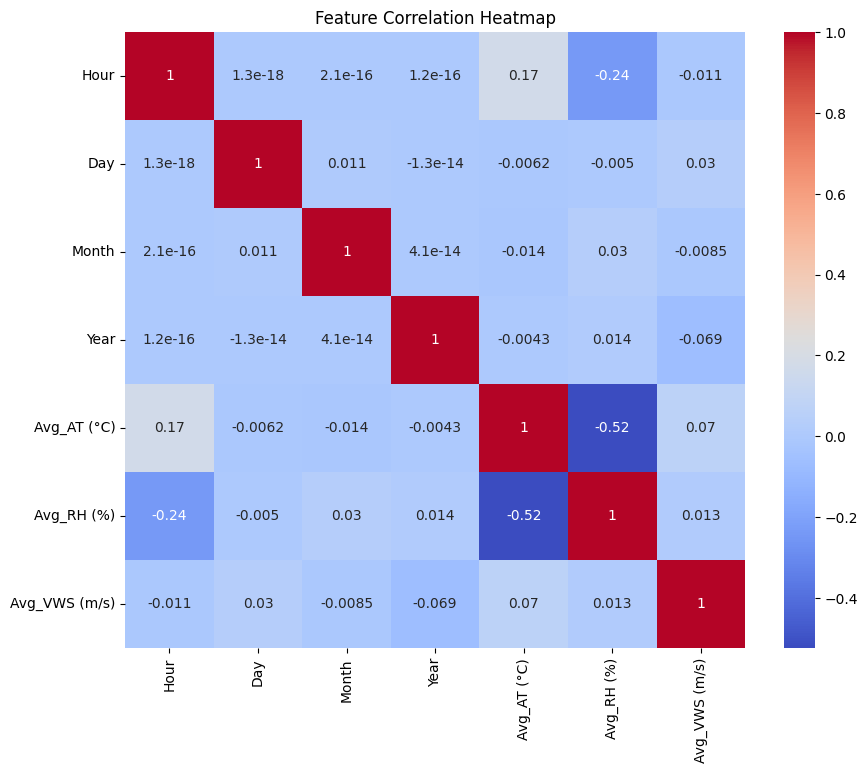


Model Performance:
Train R²: 0.9988
Test R²: 0.8959
Train MSE: 8.9591
Test MSE: 764.7700
Train MAE: 1.5107
Test MAE: 14.5062


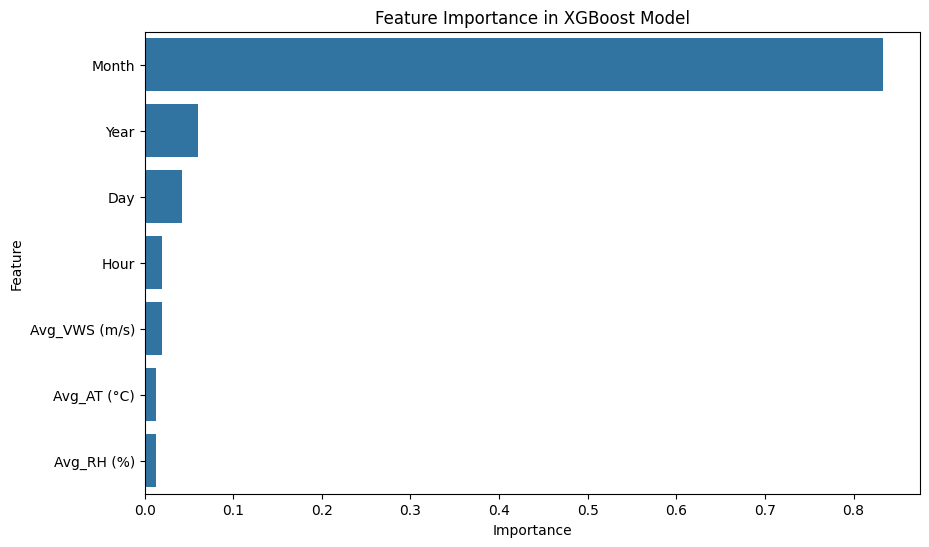

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Statistical Summary for Train and Test
print("Train Data Summary:")
print(X_train.describe())
print("\nTest Data Summary:")
print(X_test.describe())

# T-test to compare distributions between Train and Test for each feature
print("\nT-test results between Train and Test sets:")
for column in X.columns:
    stat, p_value = ttest_ind(X_train[column], X_test[column], nan_policy='omit')
    print(f"{column}: T-statistic = {stat:.4f}, p-value = {p_value:.4f}")

# Correlation Analysis
plt.figure(figsize=(10, 8))
sns.heatmap(X.corr(), annot=True, cmap="coolwarm")
plt.title("Feature Correlation Heatmap")
plt.show()

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Predictions
y_train_pred = xgb_model.predict(X_train_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate performance metrics
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_mse = mean_squared_error(y_train, y_train_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
train_mae = mean_absolute_error(y_train, y_train_pred)
test_mae = mean_absolute_error(y_test, y_test_pred)

print("\nModel Performance:")
print(f"Train R²: {train_r2:.4f}")
print(f"Test R²: {test_r2:.4f}")
print(f"Train MSE: {train_mse:.4f}")
print(f"Test MSE: {test_mse:.4f}")
print(f"Train MAE: {train_mae:.4f}")
print(f"Test MAE: {test_mae:.4f}")

# Feature Importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()



Model Performance:
Train R²: 0.9986
Validation R²: 0.8626
Test R²: 0.8801
Train MSE: 10.3923
Validation MSE: 1046.6144
Test MSE: 871.5014
Train MAE: 1.5804
Validation MAE: 17.1011
Test MAE: 16.3631


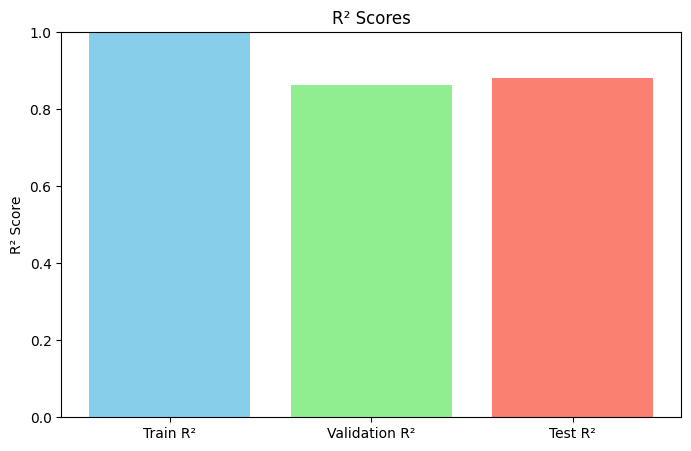

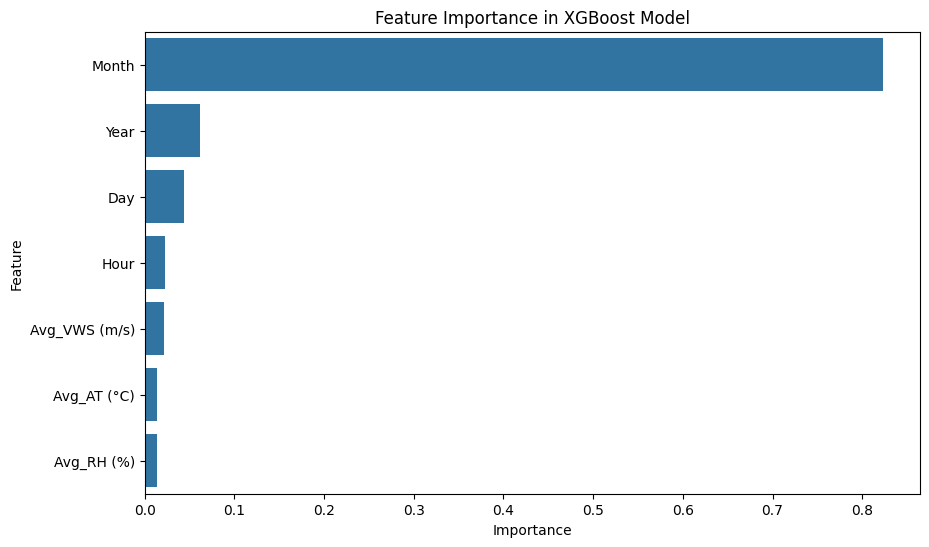

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y = data['Avg_PM2.5']

# Split the data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Predictions for train, validation, and test sets
y_train_pred = xgb_model.predict(X_train_normalized)
y_val_pred = xgb_model.predict(X_val_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate performance metrics for each set
performance = {
    'Train R²': r2_score(y_train, y_train_pred),
    'Validation R²': r2_score(y_val, y_val_pred),
    'Test R²': r2_score(y_test, y_test_pred),
    'Train MSE': mean_squared_error(y_train, y_train_pred),
    'Validation MSE': mean_squared_error(y_val, y_val_pred),
    'Test MSE': mean_squared_error(y_test, y_test_pred),
    'Train MAE': mean_absolute_error(y_train, y_train_pred),
    'Validation MAE': mean_absolute_error(y_val, y_val_pred),
    'Test MAE': mean_absolute_error(y_test, y_test_pred)
}

# Print performance metrics
print("\nModel Performance:")
for metric, value in performance.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance['Train R²'], performance['Validation R²'], performance['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()



Model Performance:
Train R²: 0.9986
Validation R²: 0.8626
Test R²: 0.8801
Train MSE: 10.3923
Validation MSE: 1046.6144
Test MSE: 871.5014
Train RMSE: 3.2237
Validation RMSE: 32.3514
Test RMSE: 29.5212
Train MAE: 1.5804
Validation MAE: 17.1011
Test MAE: 16.3631
Train MAPE: 0.0274
Validation MAPE: 0.2219
Test MAPE: 0.2267
Train EVS: 0.9986
Validation EVS: 0.8626
Test EVS: 0.8802
Train Median AE: 0.9441
Validation Median AE: 9.3781
Test Median AE: 9.3544


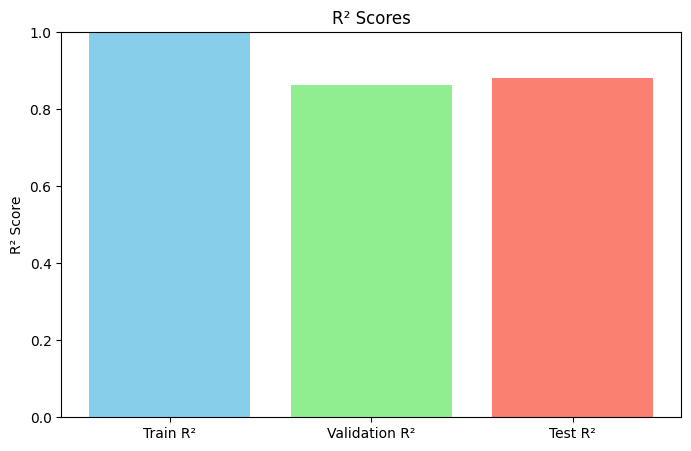

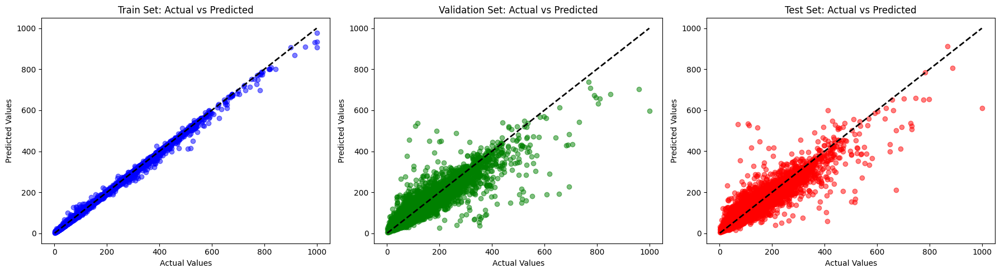

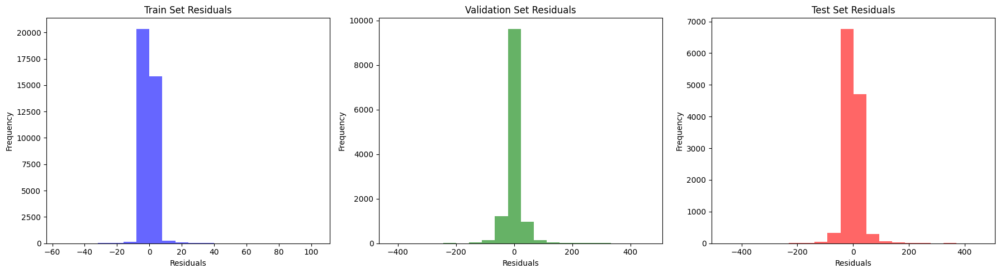

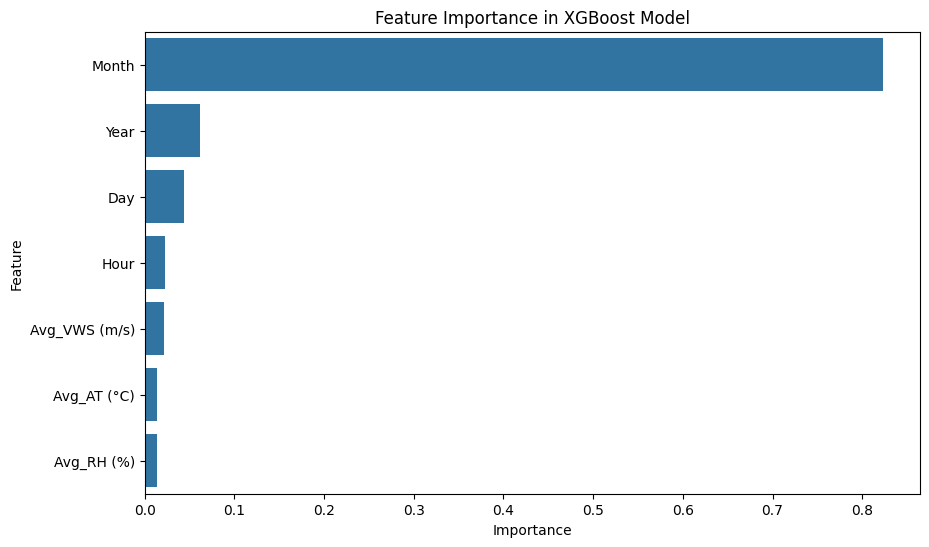

In [ ]:
import pandas as pd ################
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.metrics import explained_variance_score, median_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y = data['Avg_PM2.5']

# Split the data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Predictions for train, validation, and test sets
y_train_pred = xgb_model.predict(X_train_normalized)
y_val_pred = xgb_model.predict(X_val_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate performance metrics for each set
performance = {
    'Train R²': r2_score(y_train, y_train_pred),
    'Validation R²': r2_score(y_val, y_val_pred),
    'Test R²': r2_score(y_test, y_test_pred),
    'Train MSE': mean_squared_error(y_train, y_train_pred),
    'Validation MSE': mean_squared_error(y_val, y_val_pred),
    'Test MSE': mean_squared_error(y_test, y_test_pred),
    'Train RMSE': np.sqrt(mean_squared_error(y_train, y_train_pred)),
    'Validation RMSE': np.sqrt(mean_squared_error(y_val, y_val_pred)),
    'Test RMSE': np.sqrt(mean_squared_error(y_test, y_test_pred)),
    'Train MAE': mean_absolute_error(y_train, y_train_pred),
    'Validation MAE': mean_absolute_error(y_val, y_val_pred),
    'Test MAE': mean_absolute_error(y_test, y_test_pred),
    'Train MAPE': mean_absolute_percentage_error(y_train, y_train_pred),
    'Validation MAPE': mean_absolute_percentage_error(y_val, y_val_pred),
    'Test MAPE': mean_absolute_percentage_error(y_test, y_test_pred),
    'Train EVS': explained_variance_score(y_train, y_train_pred),
    'Validation EVS': explained_variance_score(y_val, y_val_pred),
    'Test EVS': explained_variance_score(y_test, y_test_pred),
    'Train Median AE': median_absolute_error(y_train, y_train_pred),
    'Validation Median AE': median_absolute_error(y_val, y_val_pred),
    'Test Median AE': median_absolute_error(y_test, y_test_pred),
}

# Print performance metrics
print("\nModel Performance:")
for metric, value in performance.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance['Train R²'], performance['Validation R²'], performance['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Scatter plot of Actual vs Predicted values
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
axs[0].scatter(y_train, y_train_pred, color='blue', alpha=0.5)
axs[0].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
axs[0].set_title("Train Set: Actual vs Predicted")
axs[0].set_xlabel("Actual Values")
axs[0].set_ylabel("Predicted Values")

axs[1].scatter(y_val, y_val_pred, color='green', alpha=0.5)
axs[1].plot([y_val.min(), y_val.max()], [y_val.min(), y_val.max()], 'k--', lw=2)
axs[1].set_title("Validation Set: Actual vs Predicted")
axs[1].set_xlabel("Actual Values")
axs[1].set_ylabel("Predicted Values")

axs[2].scatter(y_test, y_test_pred, color='red', alpha=0.5)
axs[2].plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
axs[2].set_title("Test Set: Actual vs Predicted")
axs[2].set_xlabel("Actual Values")
axs[2].set_ylabel("Predicted Values")

plt.tight_layout()
plt.show()

# Residuals Analysis
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
axs[0].hist(y_train - y_train_pred, bins=20, color='blue', alpha=0.6)
axs[0].set_title("Train Set Residuals")
axs[0].set_xlabel("Residuals")
axs[0].set_ylabel("Frequency")

axs[1].hist(y_val - y_val_pred, bins=20, color='green', alpha=0.6)
axs[1].set_title("Validation Set Residuals")
axs[1].set_xlabel("Residuals")
axs[1].set_ylabel("Frequency")

axs[2].hist(y_test - y_test_pred, bins=20, color='red', alpha=0.6)
axs[2].set_title("Test Set Residuals")
axs[2].set_xlabel("Residuals")
axs[2].set_ylabel("Frequency")

plt.tight_layout()
plt.show()

# Feature Importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()



Model Performance:
Train R²: 0.9986
Validation R²: 0.8626
Test R²: 0.8801
Train MSE: 10.3923
Validation MSE: 1046.6144
Test MSE: 871.5014
Train RMSE: 3.2237
Validation RMSE: 32.3514
Test RMSE: 29.5212
Train MAE: 1.5804
Validation MAE: 17.1011
Test MAE: 16.3631
Train MAPE: 0.0274
Validation MAPE: 0.2219
Test MAPE: 0.2267
Train EVS: 0.9986
Validation EVS: 0.8626
Test EVS: 0.8802
Train Median AE: 0.9441
Validation Median AE: 9.3781
Test Median AE: 9.3544


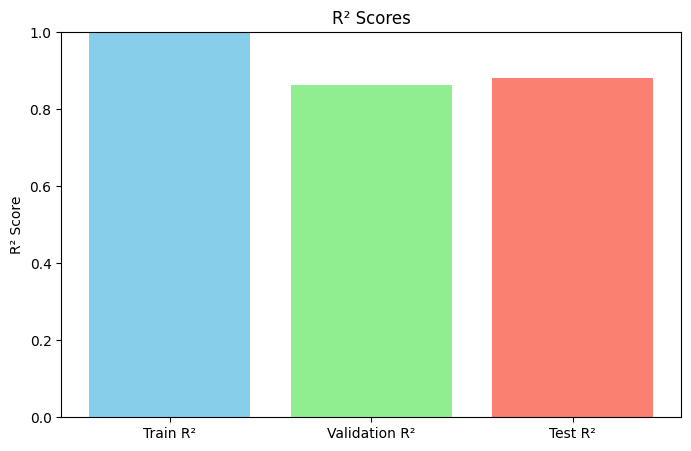

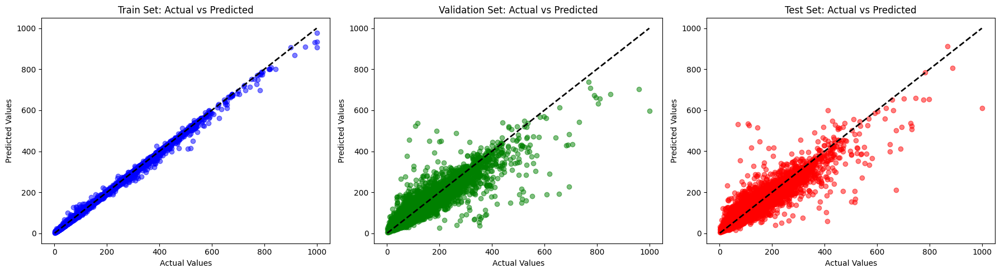

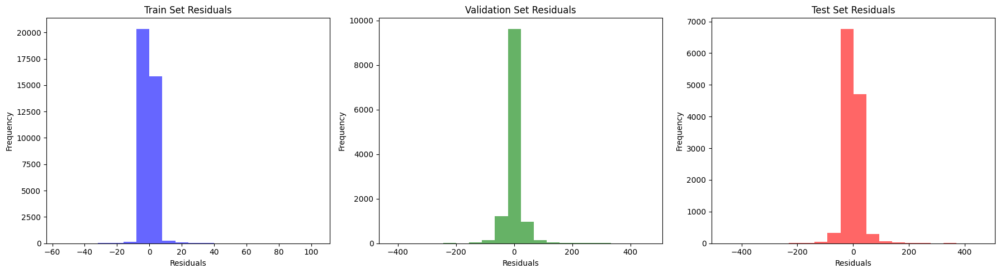

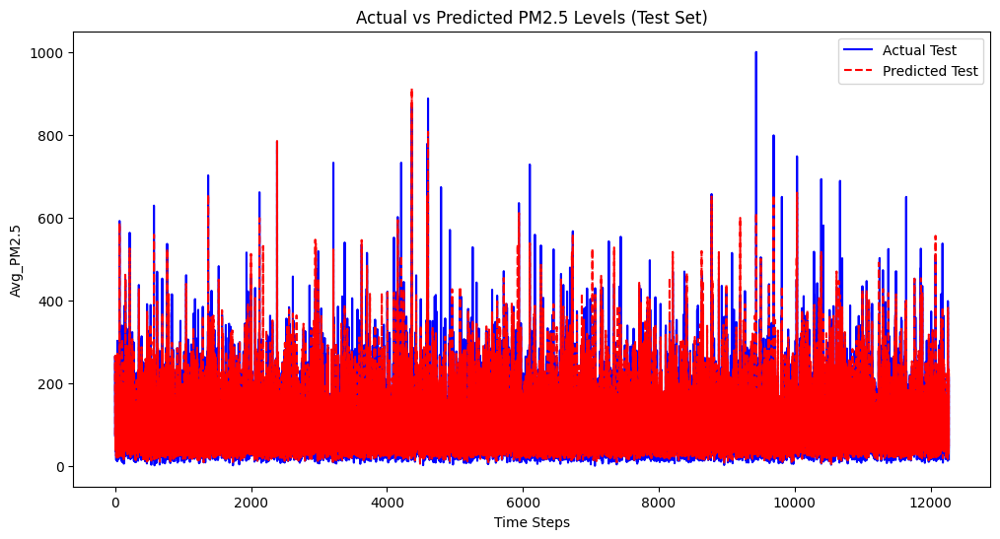

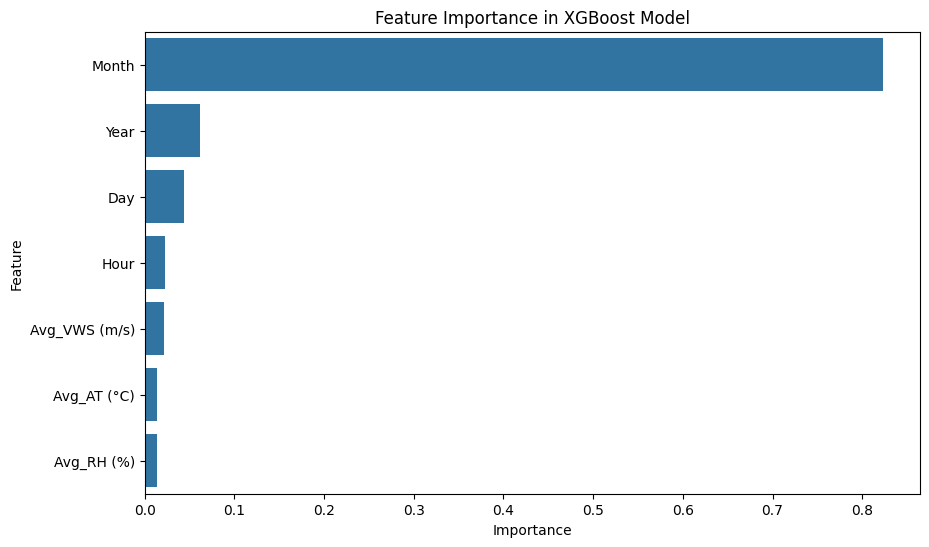

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.metrics import explained_variance_score, median_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y = data['Avg_PM2.5']

# Split the data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Predictions for train, validation, and test sets
y_train_pred = xgb_model.predict(X_train_normalized)
y_val_pred = xgb_model.predict(X_val_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate performance metrics for each set
performance = {
    'Train R²': r2_score(y_train, y_train_pred),
    'Validation R²': r2_score(y_val, y_val_pred),
    'Test R²': r2_score(y_test, y_test_pred),
    'Train MSE': mean_squared_error(y_train, y_train_pred),
    'Validation MSE': mean_squared_error(y_val, y_val_pred),
    'Test MSE': mean_squared_error(y_test, y_test_pred),
    'Train RMSE': np.sqrt(mean_squared_error(y_train, y_train_pred)),
    'Validation RMSE': np.sqrt(mean_squared_error(y_val, y_val_pred)),
    'Test RMSE': np.sqrt(mean_squared_error(y_test, y_test_pred)),
    'Train MAE': mean_absolute_error(y_train, y_train_pred),
    'Validation MAE': mean_absolute_error(y_val, y_val_pred),
    'Test MAE': mean_absolute_error(y_test, y_test_pred),
    'Train MAPE': mean_absolute_percentage_error(y_train, y_train_pred),
    'Validation MAPE': mean_absolute_percentage_error(y_val, y_val_pred),
    'Test MAPE': mean_absolute_percentage_error(y_test, y_test_pred),
    'Train EVS': explained_variance_score(y_train, y_train_pred),
    'Validation EVS': explained_variance_score(y_val, y_val_pred),
    'Test EVS': explained_variance_score(y_test, y_test_pred),
    'Train Median AE': median_absolute_error(y_train, y_train_pred),
    'Validation Median AE': median_absolute_error(y_val, y_val_pred),
    'Test Median AE': median_absolute_error(y_test, y_test_pred),
}

# Print performance metrics
print("\nModel Performance:")
for metric, value in performance.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance['Train R²'], performance['Validation R²'], performance['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Scatter plot of Actual vs Predicted values
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
for i, (y_true, y_pred, title, color) in enumerate(
    [(y_train, y_train_pred, "Train Set: Actual vs Predicted", 'blue'),
     (y_val, y_val_pred, "Validation Set: Actual vs Predicted", 'green'),
     (y_test, y_test_pred, "Test Set: Actual vs Predicted", 'red')]):

    axs[i].scatter(y_true, y_pred, color=color, alpha=0.5)
    axs[i].plot([y_true.min(), y_true.max()], [y_true.min(), y_true.max()], 'k--', lw=2)
    axs[i].set_title(title)
    axs[i].set_xlabel("Actual Values")
    axs[i].set_ylabel("Predicted Values")
plt.tight_layout()
plt.show()

# Residuals Analysis
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
for i, (residuals, title, color) in enumerate(
    [(y_train - y_train_pred, "Train Set Residuals", 'blue'),
     (y_val - y_val_pred, "Validation Set Residuals", 'green'),
     (y_test - y_test_pred, "Test Set Residuals", 'red')]):

    axs[i].hist(residuals, bins=20, color=color, alpha=0.6)
    axs[i].set_title(title)
    axs[i].set_xlabel("Residuals")
    axs[i].set_ylabel("Frequency")
plt.tight_layout()
plt.show()

# Line plot of predicted vs. actual values for Test set
plt.figure(figsize=(12, 6))
plt.plot(y_test.values, label="Actual Test", color='blue', linestyle='-')
plt.plot(y_test_pred, label="Predicted Test", color='red', linestyle='--')
plt.title("Actual vs Predicted PM2.5 Levels (Test Set)")
plt.xlabel("Time Steps")
plt.ylabel("Avg_PM2.5")
plt.legend()
plt.show()

# Feature Importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


KeyboardInterrupt: 

In [ ]:
import shap
from sklearn.model_selection import learning_curve
from sklearn.metrics import mean_squared_log_error
import warnings

warnings.filterwarnings("ignore", category=UserWarning)

# Additional Performance Metrics
performance['Train MSLE'] = mean_squared_log_error(y_train, y_train_pred)
performance['Validation MSLE'] = mean_squared_log_error(y_val, y_val_pred)
performance['Test MSLE'] = mean_squared_log_error(y_test, y_test_pred)

print("\nExtended Model Performance with MSLE:")
for metric, value in performance.items():
    print(f"{metric}: {value:.4f}")

# Learning Curve Analysis
train_sizes, train_scores, val_scores = learning_curve(
    xgb_model, X_train_normalized, y_train, cv=5, scoring="neg_mean_squared_error",
    train_sizes=np.linspace(0.1, 1.0, 10), n_jobs=-1
)

train_mean = -train_scores.mean(axis=1)
train_std = train_scores.std(axis=1)
val_mean = -val_scores.mean(axis=1)
val_std = val_scores.std(axis=1)

plt.figure(figsize=(10, 6))
plt.plot(train_sizes, train_mean, 'o-', color="blue", label="Training error")
plt.plot(train_sizes, val_mean, 'o-', color="red", label="Validation error")
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, alpha=0.1, color="blue")
plt.fill_between(train_sizes, val_mean - val_std, val_mean + val_std, alpha=0.1, color="red")
plt.xlabel("Training Set Size")
plt.ylabel("Mean Squared Error")
plt.legend()
plt.title("Learning Curve: Training vs Validation Error")
plt.show()

# Residual Plot (Actual - Predicted vs Predicted)
plt.figure(figsize=(10, 6))
residuals = y_test - y_test_pred
plt.scatter(y_test_pred, residuals, alpha=0.5, color='purple')
plt.axhline(0, color='gray', linestyle='--', lw=2)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals (Actual - Predicted)")
plt.title("Residual Plot: Test Set")
plt.show()

# SHAP Summary Plot for Feature Importance
explainer = shap.TreeExplainer(xgb_model)
shap_values = explainer.shap_values(X_test_normalized)

shap.summary_plot(shap_values, X_test, feature_names=X.columns, plot_type="bar")
shap.summary_plot(shap_values, X_test, feature_names=X.columns)

# Cumulative Error Analysis
plt.figure(figsize=(10, 6))
cumulative_error = np.cumsum(np.abs(residuals) / np.sum(np.abs(residuals)))
plt.plot(cumulative_error, color='blue')
plt.xlabel("Sample Index (Sorted by Cumulative Error)")
plt.ylabel("Cumulative Error Proportion")
plt.title("Cumulative Error Analysis on Test Set")
plt.grid(True)
plt.show()



Extended Model Performance with MSLE:
Train R²: 0.9986
Validation R²: 0.8626
Test R²: 0.8801
Train MSE: 10.3923
Validation MSE: 1046.6144
Test MSE: 871.5014
Train RMSE: 3.2237
Validation RMSE: 32.3514
Test RMSE: 29.5212
Train MAE: 1.5804
Validation MAE: 17.1011
Test MAE: 16.3631
Train MAPE: 0.0274
Validation MAPE: 0.2219
Test MAPE: 0.2267
Train EVS: 0.9986
Validation EVS: 0.8626
Test EVS: 0.8802
Train Median AE: 0.9441
Validation Median AE: 9.3781
Test Median AE: 9.3544
Train MSLE: 0.0025
Validation MSLE: 0.0748
Test MSLE: 0.0754


KeyboardInterrupt: 

<ipython-input-30-7c374fee1cbe>:39: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  plt.annotate(f"Max Deviation: {deviations[max_dev_idx]:.2f}",


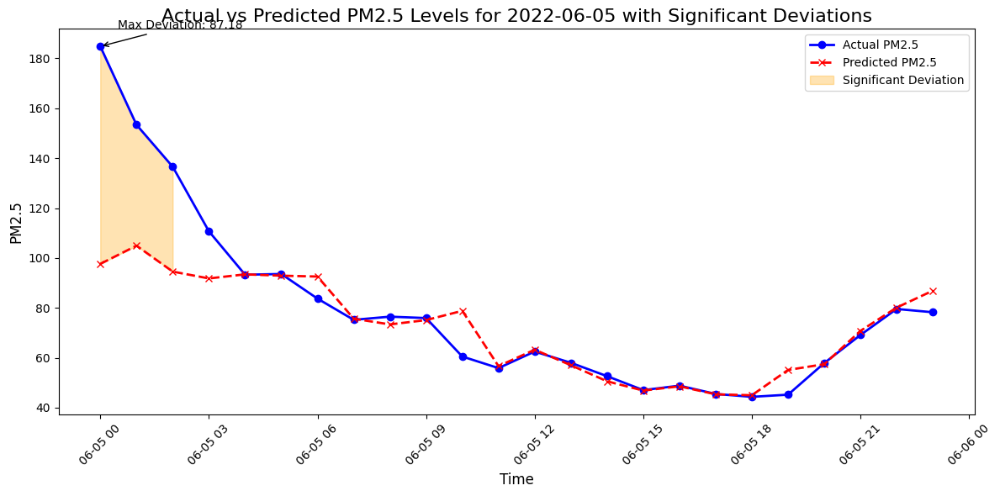

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Select a random day from the dataset
random_day = np.random.choice(data.index.date)  # Randomly choose a date from available data

# Filter data for the selected day
day_data = data[data.index.date == random_day]
if day_data.empty:
    print(f"No data available for the selected day: {random_day}")
else:
    # Prepare features for prediction
    X_day = day_data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]

    # Scale the features for the selected day
    X_day_scaled = scaler.transform(X_day)  # Make sure 'scaler' is predefined

    # Predict PM2.5 levels for the selected day
    y_pred_day = xgb_model.predict(X_day_scaled)  # Make sure 'xgb_model' is predefined

    # Calculate deviation (absolute difference between actual and predicted values)
    deviations = np.abs(day_data['Avg_PM2.5'] - y_pred_day)

    # Define a deviation threshold for highlighting (e.g., any deviation above 20 units)
    threshold = 20
    significant_deviation = deviations > threshold

    # Plot actual vs. predicted values
    plt.figure(figsize=(12, 6))
    plt.plot(day_data.index, day_data['Avg_PM2.5'], label='Actual PM2.5', color='blue', marker='o', linestyle='-', linewidth=2)
    plt.plot(day_data.index, y_pred_day, label='Predicted PM2.5', color='red', marker='x', linestyle='--', linewidth=2)

    # Highlight significant deviations
    plt.fill_between(day_data.index, day_data['Avg_PM2.5'], y_pred_day, where=significant_deviation,
                     color='orange', alpha=0.3, label='Significant Deviation')

    # Annotate the maximum deviation
    max_dev_idx = np.argmax(deviations)
    plt.annotate(f"Max Deviation: {deviations[max_dev_idx]:.2f}",
                 (day_data.index[max_dev_idx], day_data['Avg_PM2.5'].iloc[max_dev_idx]),
                 xytext=(15, 15), textcoords='offset points', arrowprops=dict(arrowstyle='->', color='black'))

    # Title and labels
    plt.title(f'Actual vs Predicted PM2.5 Levels for {random_day} with Significant Deviations', fontsize=16)
    plt.xlabel('Time', fontsize=12)
    plt.ylabel('PM2.5', fontsize=12)
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


<ipython-input-31-91a480fdc8e0>:31: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  max_deviation_value = deviations[max_deviation_idx]



Analysis for 2022-08-31:
Highest deviation at 2022-08-31 16:00:00: 7.46 units
Times with significant deviations (above threshold):


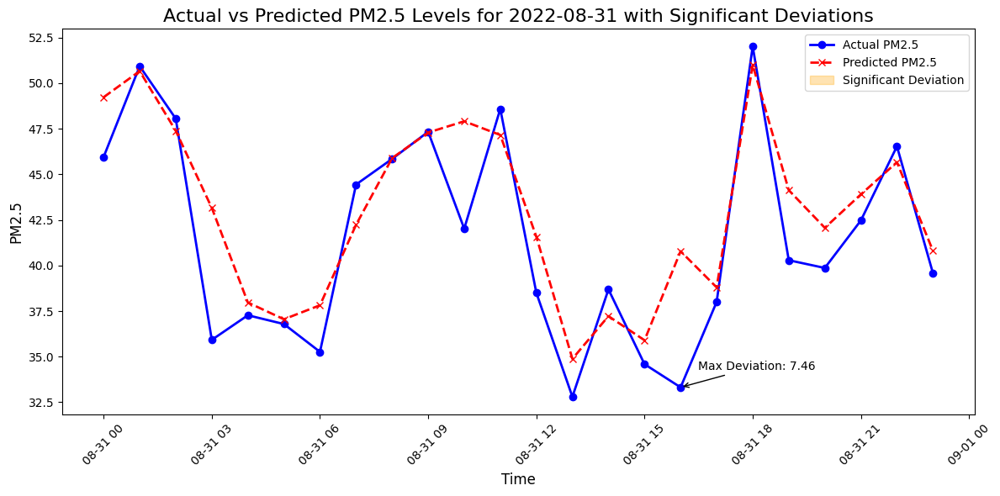

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Select a random day from the dataset
random_day = np.random.choice(data.index.date)  # Randomly choose a date from available data

# Filter data for the selected day
day_data = data[data.index.date == random_day]
if day_data.empty:
    print(f"No data available for the selected day: {random_day}")
else:
    # Prepare features for prediction
    X_day = day_data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]

    # Scale the features for the selected day
    X_day_scaled = scaler.transform(X_day)  # Make sure 'scaler' is predefined

    # Predict PM2.5 levels for the selected day
    y_pred_day = xgb_model.predict(X_day_scaled)  # Make sure 'xgb_model' is predefined

    # Calculate deviation (absolute difference between actual and predicted values)
    deviations = np.abs(day_data['Avg_PM2.5'] - y_pred_day)

    # Define a deviation threshold for highlighting (e.g., any deviation above 20 units)
    threshold = 20
    significant_deviation = deviations > threshold

    # Find timestamps with the highest deviation
    max_deviation_idx = np.argmax(deviations)
    max_deviation_time = day_data.index[max_deviation_idx]
    max_deviation_value = deviations[max_deviation_idx]
    significant_times = day_data.index[significant_deviation]

    # Print specific analysis results
    print(f"\nAnalysis for {random_day}:")
    print(f"Highest deviation at {max_deviation_time}: {max_deviation_value:.2f} units")
    print("Times with significant deviations (above threshold):")
    for time in significant_times:
        print(f"- {time}: Deviation = {deviations[day_data.index == time].values[0]:.2f}")

    # Plot actual vs. predicted values
    plt.figure(figsize=(12, 6))
    plt.plot(day_data.index, day_data['Avg_PM2.5'], label='Actual PM2.5', color='blue', marker='o', linestyle='-', linewidth=2)
    plt.plot(day_data.index, y_pred_day, label='Predicted PM2.5', color='red', marker='x', linestyle='--', linewidth=2)

    # Highlight significant deviations
    plt.fill_between(day_data.index, day_data['Avg_PM2.5'], y_pred_day, where=significant_deviation,
                     color='orange', alpha=0.3, label='Significant Deviation')

    # Annotate the maximum deviation
    plt.annotate(f"Max Deviation: {max_deviation_value:.2f}",
                 (max_deviation_time, day_data['Avg_PM2.5'].iloc[max_deviation_idx]),
                 xytext=(15, 15), textcoords='offset points', arrowprops=dict(arrowstyle='->', color='black'))

    # Title and labels
    plt.title(f'Actual vs Predicted PM2.5 Levels for {random_day} with Significant Deviations', fontsize=16)
    plt.xlabel('Time', fontsize=12)
    plt.ylabel('PM2.5', fontsize=12)
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


<ipython-input-32-20149af06dac>:24: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  max_deviation_value = deviations[max_deviation_idx]


Streaming output truncated to the last 5000 lines.
- 2017-12-15 09:00:00: Deviation = 31.10
- 2017-12-15 10:00:00: Deviation = 45.75
- 2017-12-15 11:00:00: Deviation = 99.17
- 2017-12-15 20:00:00: Deviation = 27.79
- 2017-12-15 22:00:00: Deviation = 36.82
- 2017-12-16 00:00:00: Deviation = 30.48
- 2017-12-16 01:00:00: Deviation = 81.20
- 2017-12-16 03:00:00: Deviation = 47.74
- 2017-12-16 07:00:00: Deviation = 34.00
- 2017-12-16 09:00:00: Deviation = 23.93
- 2017-12-16 18:00:00: Deviation = 70.28
- 2017-12-17 00:00:00: Deviation = 24.89
- 2017-12-17 03:00:00: Deviation = 39.83
- 2017-12-17 07:00:00: Deviation = 44.14
- 2017-12-17 09:00:00: Deviation = 24.88
- 2017-12-17 14:00:00: Deviation = 34.86
- 2017-12-17 23:00:00: Deviation = 56.08
- 2017-12-19 01:00:00: Deviation = 39.12
- 2017-12-19 02:00:00: Deviation = 25.77
- 2017-12-19 03:00:00: Deviation = 20.11
- 2017-12-19 17:00:00: Deviation = 24.91
- 2017-12-19 22:00:00: Deviation = 46.78
- 2017-12-20 01:00:00: Deviation = 41.93
- 2017

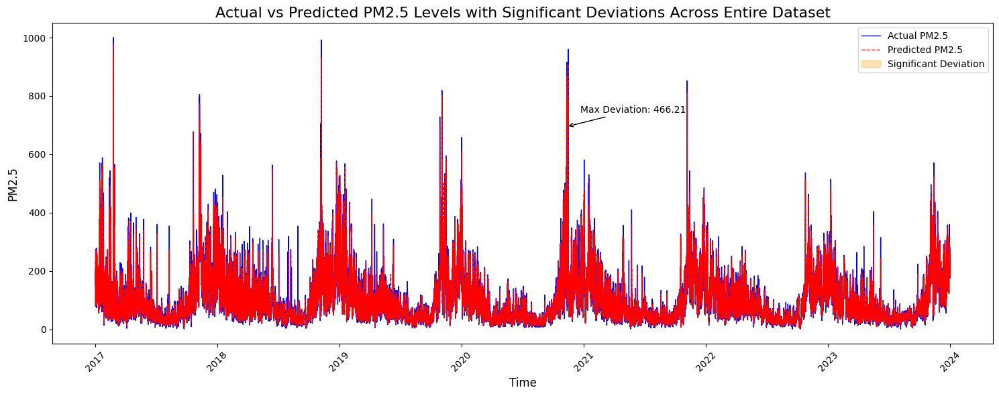

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Prepare features and target variable for the entire dataset
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_actual = data['Avg_PM2.5']

# Scale the features
X_scaled = scaler.transform(X)  # Make sure 'scaler' is predefined from previous preprocessing

# Predict PM2.5 levels for the entire dataset
y_pred = xgb_model.predict(X_scaled)  # Make sure 'xgb_model' is predefined

# Calculate deviation (absolute difference between actual and predicted values)
deviations = np.abs(y_actual - y_pred)

# Define a deviation threshold for highlighting (e.g., any deviation above 20 units)
threshold = 20
significant_deviation = deviations > threshold

# Find timestamps with the highest deviation
max_deviation_idx = np.argmax(deviations)
max_deviation_time = data.index[max_deviation_idx]
max_deviation_value = deviations[max_deviation_idx]
significant_times = data.index[significant_deviation]

# Print specific analysis results
print(f"\nOverall Dataset Analysis:")
print(f"Highest deviation at {max_deviation_time}: {max_deviation_value:.2f} units")
print("Times with significant deviations (above threshold):")
for time in significant_times:
    print(f"- {time}: Deviation = {deviations[data.index == time].values[0]:.2f}")

# Plot actual vs. predicted values for the entire dataset
plt.figure(figsize=(15, 6))
plt.plot(data.index, y_actual, label='Actual PM2.5', color='blue', linestyle='-', linewidth=1)
plt.plot(data.index, y_pred, label='Predicted PM2.5', color='red', linestyle='--', linewidth=1)

# Highlight significant deviations
plt.fill_between(data.index, y_actual, y_pred, where=significant_deviation,
                 color='orange', alpha=0.3, label='Significant Deviation')

# Annotate the maximum deviation
plt.annotate(f"Max Deviation: {max_deviation_value:.2f}",
             (max_deviation_time, y_actual.iloc[max_deviation_idx]),
             xytext=(15, 15), textcoords='offset points', arrowprops=dict(arrowstyle='->', color='black'))

# Title and labels
plt.title('Actual vs Predicted PM2.5 Levels with Significant Deviations Across Entire Dataset', fontsize=16)
plt.xlabel('Time', fontsize=12)
plt.ylabel('PM2.5', fontsize=12)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


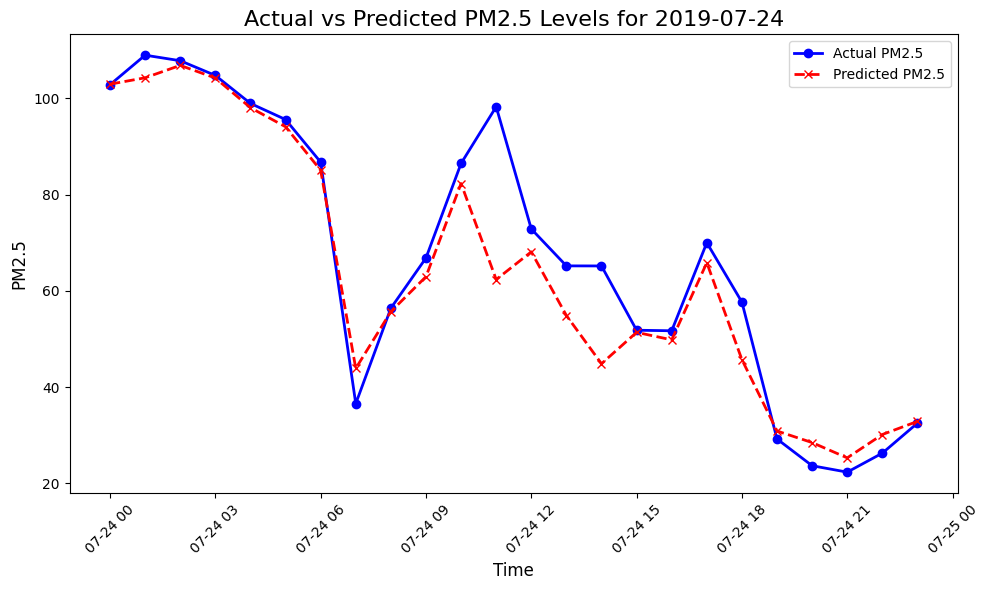

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Select a random day from the dataset
random_day = np.random.choice(data.index.date)  # Randomly choose a date from available data

# Filter data for the selected day
day_data = data[data.index.date == random_day]
if day_data.empty:
    print(f"No data available for the selected day: {random_day}")
else:
    # Prepare features for prediction
    X_day = day_data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]

    # Scale the features for the selected day
    X_day_scaled = scaler.transform(X_day)  # Make sure 'scaler' is predefined

    # Predict PM2.5 levels for the selected day
    y_pred_day = xgb_model.predict(X_day_scaled)  # Make sure 'xgb_model' is predefined

    # Plot actual vs. predicted values for the selected day
    plt.figure(figsize=(10, 6))
    plt.plot(day_data.index, day_data['Avg_PM2.5'], label='Actual PM2.5', color='blue', marker='o', linestyle='-', linewidth=2)
    plt.plot(day_data.index, y_pred_day, label='Predicted PM2.5', color='red', marker='x', linestyle='--', linewidth=2)
    plt.title(f'Actual vs Predicted PM2.5 Levels for {random_day}', fontsize=16)
    plt.xlabel('Time', fontsize=12)
    plt.ylabel('PM2.5', fontsize=12)
    plt.legend()
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()


Top 10 Largest Deviations Between Actual and Predicted PM2.5 Levels:
                              Timestamp  Actual_PM2.5  Predicted_PM2.5  \
Timestamp                                                                
2020-11-09 23:00:00 2020-11-09 23:00:00       694.780       228.571136   
2020-11-09 21:00:00 2020-11-09 21:00:00       655.575       190.971909   
2020-11-09 22:00:00 2020-11-09 22:00:00       673.595       211.270203   
2017-02-26 06:00:00 2017-02-26 06:00:00        70.450       531.481567   
2017-02-26 04:00:00 2017-02-26 04:00:00       107.935       535.621521   
2020-11-09 20:00:00 2020-11-09 20:00:00       609.400       188.300644   
2017-02-26 02:00:00 2017-02-26 02:00:00       117.275       537.363220   
2017-02-24 22:00:00 2017-02-24 22:00:00       107.590       522.521301   
2017-02-26 03:00:00 2017-02-26 03:00:00       111.410       525.169434   
2017-02-24 06:00:00 2017-02-24 06:00:00      1000.000       597.919067   

                      Deviation  
Timestam

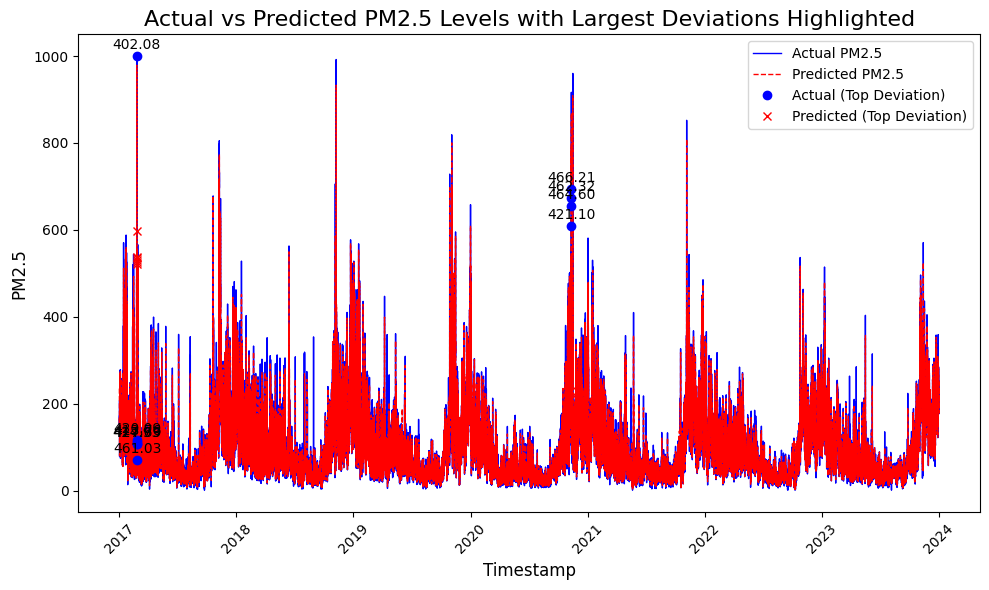

In [ ]:
import pandas as pd

# Calculate deviations (absolute difference between actual and predicted values)
deviations = np.abs(y_actual - y_pred)

# Create a DataFrame to store actual, predicted, and deviation values
deviation_df = pd.DataFrame({
    'Timestamp': data.index,
    'Actual_PM2.5': y_actual,
    'Predicted_PM2.5': y_pred,
    'Deviation': deviations
})

# Sort the DataFrame by deviation in descending order to find the largest deviations
top_deviations = deviation_df.sort_values(by='Deviation', ascending=False).head(10)

# Print the top deviations
print("Top 10 Largest Deviations Between Actual and Predicted PM2.5 Levels:")
print(top_deviations)

# Plot the largest deviations for visual inspection
plt.figure(figsize=(10, 6))
plt.plot(data.index, y_actual, label='Actual PM2.5', color='blue', linestyle='-', linewidth=1)
plt.plot(data.index, y_pred, label='Predicted PM2.5', color='red', linestyle='--', linewidth=1)

# Highlight the top 10 deviations
for idx, row in top_deviations.iterrows():
    plt.plot(row['Timestamp'], row['Actual_PM2.5'], 'bo', label="Actual (Top Deviation)" if idx == top_deviations.index[0] else "")
    plt.plot(row['Timestamp'], row['Predicted_PM2.5'], 'rx', label="Predicted (Top Deviation)" if idx == top_deviations.index[0] else "")
    plt.annotate(f"{row['Deviation']:.2f}",
                 (row['Timestamp'], row['Actual_PM2.5']),
                 xytext=(0, 5), textcoords='offset points', ha='center', color='black')

# Title and labels
plt.title('Actual vs Predicted PM2.5 Levels with Largest Deviations Highlighted', fontsize=16)
plt.xlabel('Timestamp', fontsize=12)
plt.ylabel('PM2.5', fontsize=12)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


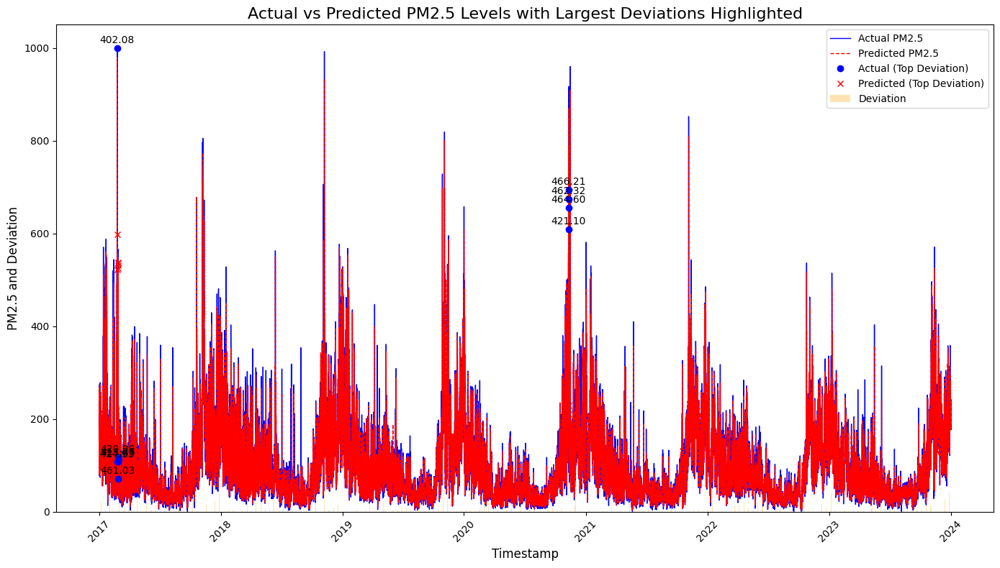

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Calculate deviations
deviations = np.abs(y_actual - y_pred)

# Create a DataFrame to store actual, predicted, and deviation values
deviation_df = pd.DataFrame({
    'Timestamp': data.index,
    'Actual_PM2.5': y_actual,
    'Predicted_PM2.5': y_pred,
    'Deviation': deviations
})

# Sort by deviation in descending order to find largest deviations
top_deviations = deviation_df.sort_values(by='Deviation', ascending=False).head(10)

# Plot actual and predicted values
plt.figure(figsize=(14, 8))
plt.plot(data.index, y_actual, label='Actual PM2.5', color='blue', linestyle='-', linewidth=1)
plt.plot(data.index, y_pred, label='Predicted PM2.5', color='red', linestyle='--', linewidth=1)

# Highlight the top 10 deviations
for idx, row in top_deviations.iterrows():
    plt.plot(row['Timestamp'], row['Actual_PM2.5'], 'bo', label="Actual (Top Deviation)" if idx == top_deviations.index[0] else "")
    plt.plot(row['Timestamp'], row['Predicted_PM2.5'], 'rx', label="Predicted (Top Deviation)" if idx == top_deviations.index[0] else "")
    plt.annotate(f"{row['Deviation']:.2f}",
                 (row['Timestamp'], row['Actual_PM2.5']),
                 xytext=(0, 5), textcoords='offset points', ha='center', color='black')

# Bar plot overlay for deviations
plt.bar(deviation_df['Timestamp'], deviation_df['Deviation'], width=0.01, color='orange', alpha=0.3, label='Deviation')

# Labels, title, and legend
plt.title('Actual vs Predicted PM2.5 Levels with Largest Deviations Highlighted', fontsize=16)
plt.xlabel('Timestamp', fontsize=12)
plt.ylabel('PM2.5 and Deviation', fontsize=12)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd#########
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Remove outliers with 1.5 IQR
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

X_filtered = remove_outliers(X)
y_filtered = y.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split data into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X_filtered, y_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define function to train and evaluate model
def train_and_evaluate(X_train, y_train, X_val, y_val, X_test, y_test):
    xgb_model = XGBRegressor(
        n_estimators=294,
        max_depth=20,
        learning_rate=0.025500916544420573,
        min_child_weight=2,
        subsample=0.7434753286589282,
        random_state=42
    )
    xgb_model.fit(X_train, y_train)

    # Predictions for train, validation, and test sets
    y_train_pred = xgb_model.predict(X_train)
    y_val_pred = xgb_model.predict(X_val)
    y_test_pred = xgb_model.predict(X_test)

    # Calculate performance metrics for each set
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Validation R²': r2_score(y_val, y_val_pred),
        'Test R²': r2_score(y_test, y_test_pred)
    }
    return performance

# Baseline model with all features
print("Baseline Model Performance with All Features:")
baseline_performance = train_and_evaluate(X_train_normalized, y_train, X_val_normalized, y_val, X_test_normalized, y_test)
print(baseline_performance)

# Evaluate model performance after removing each feature one-by-one
feature_performance = {}
for feature in X.columns:
    print(f"\nEvaluating after removing feature: {feature}")
    X_train_dropped = X_train.drop(columns=[feature])
    X_val_dropped = X_val.drop(columns=[feature])
    X_test_dropped = X_test.drop(columns=[feature])

    # Normalize features after dropping
    scaler = MinMaxScaler()
    X_train_dropped_normalized = scaler.fit_transform(X_train_dropped)
    X_val_dropped_normalized = scaler.transform(X_val_dropped)
    X_test_dropped_normalized = scaler.transform(X_test_dropped)

    # Train and evaluate the model
    performance = train_and_evaluate(X_train_dropped_normalized, y_train, X_val_dropped_normalized, y_val, X_test_dropped_normalized, y_test)
    feature_performance[feature] = performance

# Compare performance
print("\nComparison of Model Performance After Removing Each Feature:")
for feature, perf in feature_performance.items():
    print(f"\nFeature removed: {feature}")
    print(f"Train R²: {perf['Train R²']:.4f} (Change: {perf['Train R²'] - baseline_performance['Train R²']:.4f})")
    print(f"Validation R²: {perf['Validation R²']:.4f} (Change: {perf['Validation R²'] - baseline_performance['Validation R²']:.4f})")
    print(f"Test R²: {perf['Test R²']:.4f} (Change: {perf['Test R²'] - baseline_performance['Test R²']:.4f})")


Baseline Model Performance with All Features:
{'Train R²': 0.9991582621186282, 'Validation R²': 0.8602892427441933, 'Test R²': 0.8595553166017013}

Evaluating after removing feature: Hour

Evaluating after removing feature: Day

Evaluating after removing feature: Month

Evaluating after removing feature: Year

Evaluating after removing feature: Avg_AT (°C)

Evaluating after removing feature: Avg_RH (%)

Evaluating after removing feature: Avg_VWS (m/s)

Evaluating after removing feature: Avg_WD (deg)

Comparison of Model Performance After Removing Each Feature:

Feature removed: Hour
Train R²: 0.9984 (Change: -0.0007)
Validation R²: 0.8203 (Change: -0.0400)
Test R²: 0.8206 (Change: -0.0389)

Feature removed: Day
Train R²: 0.9986 (Change: -0.0006)
Validation R²: 0.7455 (Change: -0.1148)
Test R²: 0.7313 (Change: -0.1282)

Feature removed: Month
Train R²: 0.9969 (Change: -0.0023)
Validation R²: 0.4909 (Change: -0.3694)
Test R²: 0.4893 (Change: -0.3703)

Feature removed: Year
Train R²: 0.99

Baseline Model Performance with All Features:
{'Train R²': 0.9991582621186282, 'Validation R²': 0.8602892427441933, 'Test R²': 0.8595553166017013}


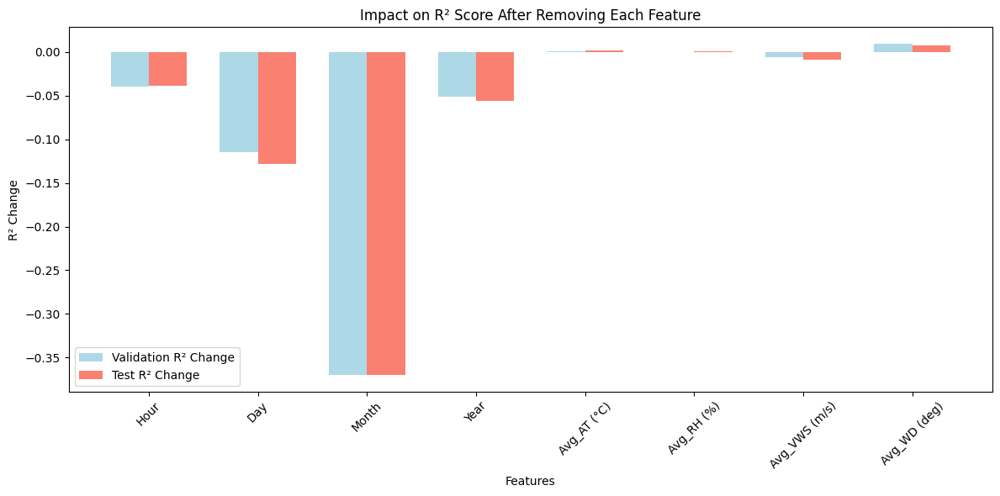

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Remove outliers with 1.5 IQR
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

X_filtered = remove_outliers(X)
y_filtered = y.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split data into train, validation, and test sets
X_train, X_temp, y_train, y_temp = train_test_split(X_filtered, y_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define function to train and evaluate model
def train_and_evaluate(X_train, y_train, X_val, y_val, X_test, y_test):
    xgb_model = XGBRegressor(
        n_estimators=294,
        max_depth=20,
        learning_rate=0.025500916544420573,
        min_child_weight=2,
        subsample=0.7434753286589282,
        random_state=42
    )
    xgb_model.fit(X_train, y_train)

    # Predictions for train, validation, and test sets
    y_train_pred = xgb_model.predict(X_train)
    y_val_pred = xgb_model.predict(X_val)
    y_test_pred = xgb_model.predict(X_test)

    # Calculate R² score for each set
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Validation R²': r2_score(y_val, y_val_pred),
        'Test R²': r2_score(y_test, y_test_pred)
    }
    return performance

# Baseline model with all features
print("Baseline Model Performance with All Features:")
baseline_performance = train_and_evaluate(X_train_normalized, y_train, X_val_normalized, y_val, X_test_normalized, y_test)
print(baseline_performance)

# Store the changes in performance after feature removal
validation_r2_changes = {}
test_r2_changes = {}

# Evaluate model performance after removing each feature one-by-one
for feature in X.columns:
    X_train_dropped = X_train.drop(columns=[feature])
    X_val_dropped = X_val.drop(columns=[feature])
    X_test_dropped = X_test.drop(columns=[feature])

    # Normalize features after dropping
    scaler = MinMaxScaler()
    X_train_dropped_normalized = scaler.fit_transform(X_train_dropped)
    X_val_dropped_normalized = scaler.transform(X_val_dropped)
    X_test_dropped_normalized = scaler.transform(X_test_dropped)

    # Train and evaluate the model
    performance = train_and_evaluate(X_train_dropped_normalized, y_train, X_val_dropped_normalized, y_val, X_test_dropped_normalized, y_test)

    # Calculate R² change relative to baseline
    validation_r2_changes[feature] = performance['Validation R²'] - baseline_performance['Validation R²']
    test_r2_changes[feature] = performance['Test R²'] - baseline_performance['Test R²']

# Plot the accuracy change after feature removal
features = list(validation_r2_changes.keys())
validation_changes = list(validation_r2_changes.values())
test_changes = list(test_r2_changes.values())

fig, ax = plt.subplots(figsize=(12, 6))
bar_width = 0.35
index = np.arange(len(features))

# Validation and Test R² change bars
val_bars = ax.bar(index, validation_changes, bar_width, label='Validation R² Change', color='lightblue')
test_bars = ax.bar(index + bar_width, test_changes, bar_width, label='Test R² Change', color='salmon')

# Label and title
ax.set_xlabel('Features')
ax.set_ylabel('R² Change')
ax.set_title('Impact on R² Score After Removing Each Feature')
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(features, rotation=45)
ax.legend()

plt.tight_layout()
plt.show()


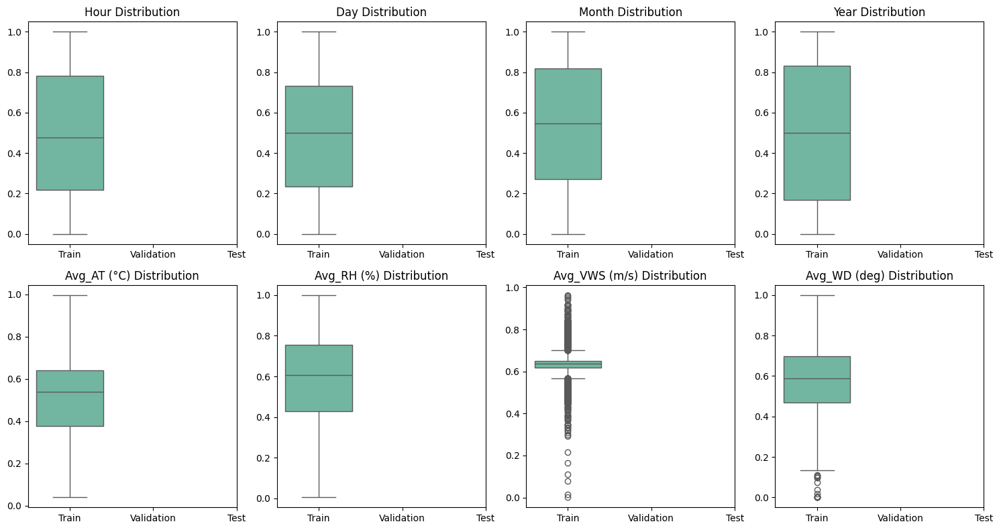

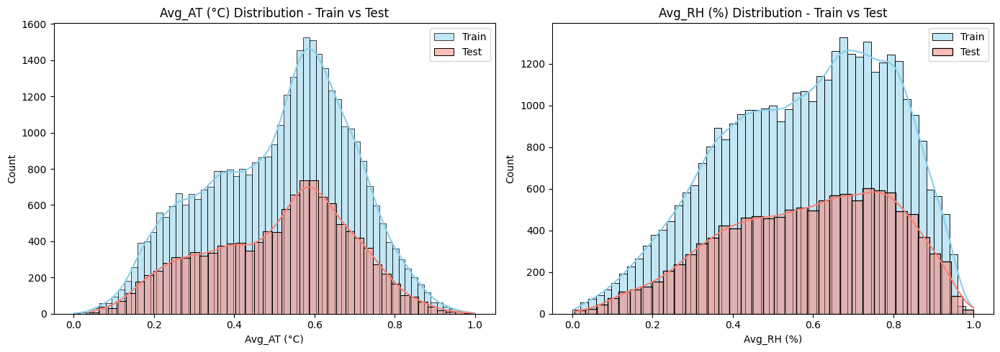

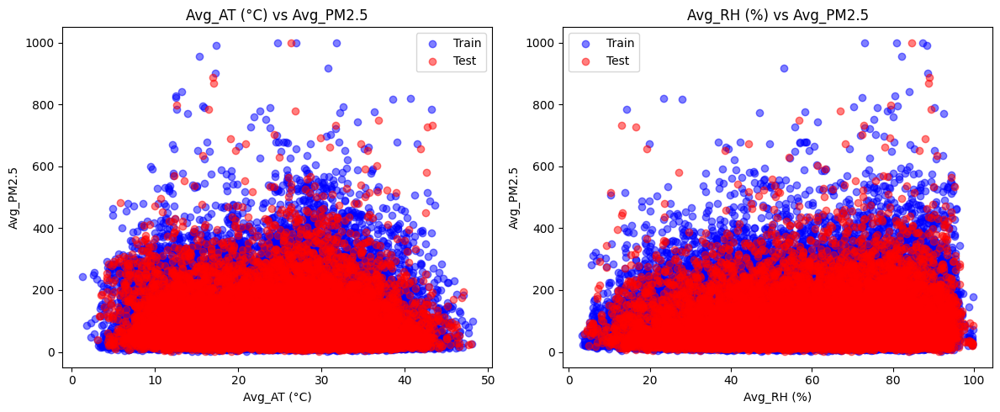

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Convert normalized data back to DataFrame for easy plotting
X_train_df = pd.DataFrame(X_train_normalized, columns=X.columns)
X_val_df = pd.DataFrame(X_val_normalized, columns=X.columns)
X_test_df = pd.DataFrame(X_test_normalized, columns=X.columns)

# 1. Boxplots for feature distributions in Train, Validation, and Test sets
plt.figure(figsize=(15, 8))
for i, column in enumerate(X.columns, 1):
    plt.subplot(2, 4, i)
    sns.boxplot(data=[X_train_df[column], X_val_df[column], X_test_df[column]], palette="Set2")
    plt.xticks([0, 1, 2], ["Train", "Validation", "Test"])
    plt.title(f"{column} Distribution")

plt.tight_layout()
plt.show()

# 2. Histograms for features with notable T-test differences (e.g., Avg_AT (°C))
plt.figure(figsize=(14, 5))

# Histogram for Avg_AT (°C)
plt.subplot(1, 2, 1)
sns.histplot(X_train_df['Avg_AT (°C)'], color='skyblue', label="Train", kde=True)
sns.histplot(X_test_df['Avg_AT (°C)'], color='salmon', label="Test", kde=True)
plt.title("Avg_AT (°C) Distribution - Train vs Test")
plt.xlabel("Avg_AT (°C)")
plt.legend()

# Histogram for Avg_RH (%)
plt.subplot(1, 2, 2)
sns.histplot(X_train_df['Avg_RH (%)'], color='skyblue', label="Train", kde=True)
sns.histplot(X_test_df['Avg_RH (%)'], color='salmon', label="Test", kde=True)
plt.title("Avg_RH (%) Distribution - Train vs Test")
plt.xlabel("Avg_RH (%)")
plt.legend()

plt.tight_layout()
plt.show()

# 3. Scatter Plot of Key Features (e.g., Avg_AT (°C)) vs Target Variable (y) in Train and Test Sets
plt.figure(figsize=(12, 5))

# Scatter plot for Avg_AT (°C) vs Avg_PM2.5
plt.subplot(1, 2, 1)
plt.scatter(X_train['Avg_AT (°C)'], y_train, color='blue', alpha=0.5, label="Train")
plt.scatter(X_test['Avg_AT (°C)'], y_test, color='red', alpha=0.5, label="Test")
plt.title("Avg_AT (°C) vs Avg_PM2.5")
plt.xlabel("Avg_AT (°C)")
plt.ylabel("Avg_PM2.5")
plt.legend()

# Scatter plot for Avg_RH (%) vs Avg_PM2.5
plt.subplot(1, 2, 2)
plt.scatter(X_train['Avg_RH (%)'], y_train, color='blue', alpha=0.5, label="Train")
plt.scatter(X_test['Avg_RH (%)'], y_test, color='red', alpha=0.5, label="Test")
plt.title("Avg_RH (%) vs Avg_PM2.5")
plt.xlabel("Avg_RH (%)")
plt.ylabel("Avg_PM2.5")
plt.legend()

plt.tight_layout()
plt.show()


Combined Feature Importance and T-Test Results:
         Feature  Importance  T-statistic   p-value
0          Month    0.830832    -0.825134  0.409299
1           Year    0.057232    -0.878317  0.379775
2            Day    0.041329    -0.567698  0.570242
3           Hour    0.019724    -0.352143  0.724733
4  Avg_VWS (m/s)    0.018500    -0.143980  0.885516
5    Avg_AT (°C)    0.012441    -0.335585  0.737185
6     Avg_RH (%)    0.011597     0.823917  0.409990
7   Avg_WD (deg)    0.008345     1.479966  0.138887


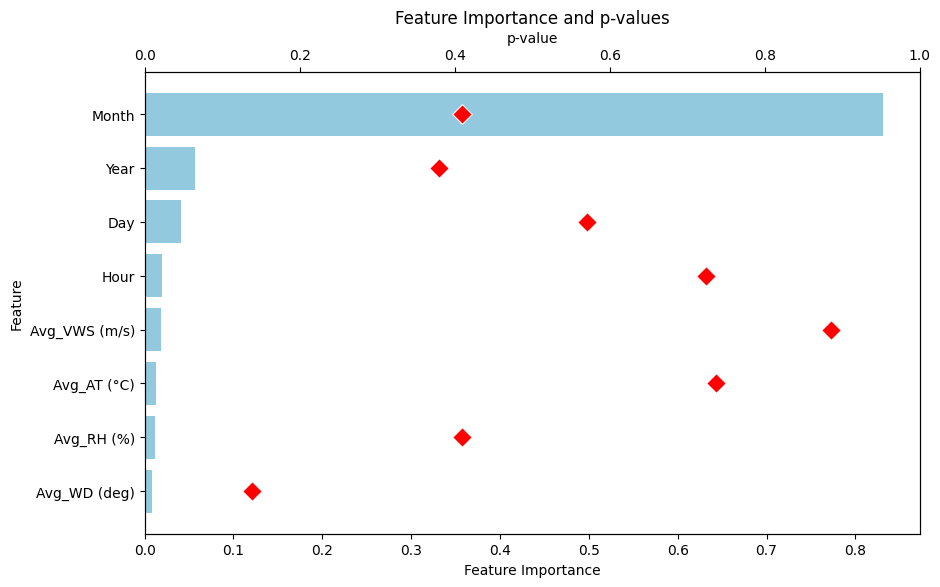

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Split data into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Calculate feature importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# T-test to compare distributions between Train and Test for each feature
t_test_results = []
for column in X.columns:
    stat, p_value = ttest_ind(X_train[column], X_test[column], nan_policy='omit')
    t_test_results.append({'Feature': column, 'T-statistic': stat, 'p-value': p_value})

t_test_df = pd.DataFrame(t_test_results).sort_values(by='p-value')

# Merge feature importance with T-test results
analysis_df = pd.merge(importance_df, t_test_df, on="Feature")
print("Combined Feature Importance and T-Test Results:")
print(analysis_df)

# Visualization of Feature Importance and p-values
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plot Feature Importance
sns.barplot(x='Importance', y='Feature', data=analysis_df, color="skyblue", ax=ax1)
ax1.set_xlabel("Feature Importance")
ax1.set_ylabel("Feature")
ax1.set_title("Feature Importance and p-values")

# Plot p-values on a secondary x-axis
ax2 = ax1.twiny()
sns.scatterplot(x='p-value', y='Feature', data=analysis_df, color="red", ax=ax2, marker="D", s=100)
ax2.set_xlim(0, 1)  # Set limits to focus on significant p-values
ax2.set_xlabel("p-value")

plt.show()


In [ ]:
# Identify features with low importance and high p-value (non-influential features)
non_influential_features = analysis_df[(analysis_df['Importance'] < 0.01) & (analysis_df['p-value'] > 0.05)]

print("Features unlikely to cause accuracy difference between train and test:")
print(non_influential_features[['Feature', 'Importance', 'p-value']])


Features unlikely to cause accuracy difference between train and test:
        Feature  Importance   p-value
7  Avg_WD (deg)    0.008345  0.138887


Model Performance:
Train R²: 0.9990
Test R²: 0.8883
Train MSE: 7.2811
Test MSE: 821.0765
Train MAE: 1.3384
Test MAE: 15.2493


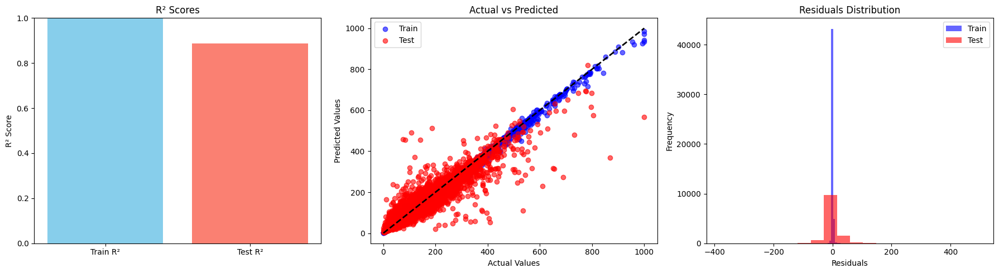

{'Train R²': 0.9990386337300279,
 'Test R²': 0.8882659866214766,
 'Train MSE': 7.281114205287921,
 'Test MSE': 821.0765268509338,
 'Train MAE': 1.3384207842681268,
 'Test MAE': 15.249345906947566}

In [ ]:
# Run the evaluation with specified parameters
evaluate_xgb_model(n_estimators=294, max_depth=20, learning_rate=0.025500916544420573, min_child_weight=2, subsample=0.7434753286589282)

Model Performance:
Train R²: 0.9953
Test R²: 0.8898
Train MSE: 35.3022
Test MSE: 809.8001
Train MAE: 3.6950
Test MAE: 15.9346


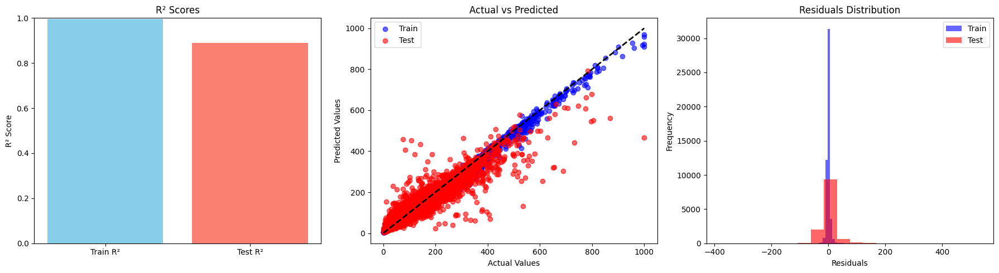

IndexError: index 2 is out of bounds for axis 0 with size 2

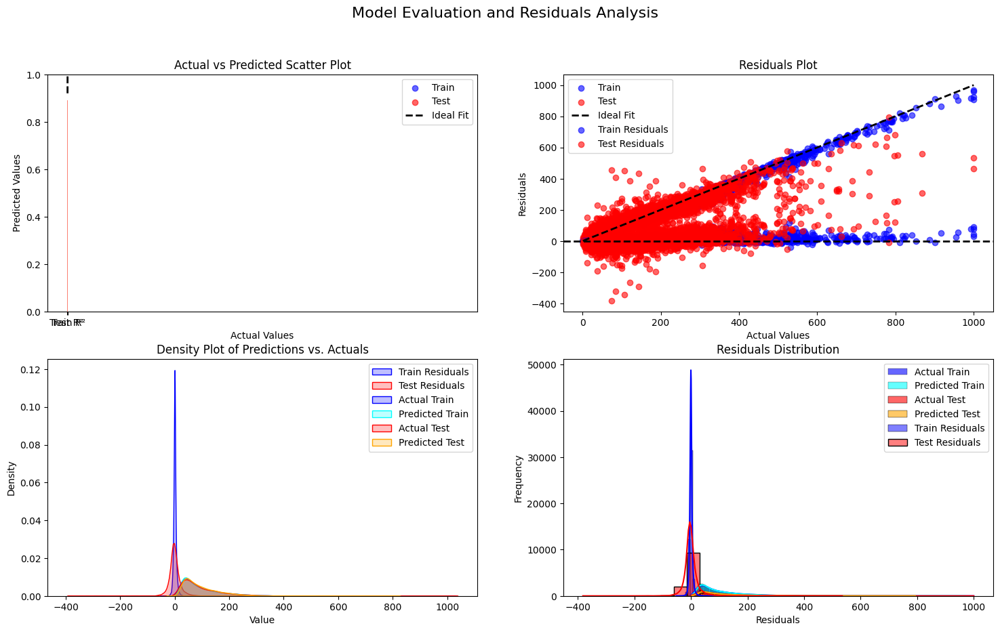

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from xgboost import XGBRegressor

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
def evaluate_xgb_model(n_estimators=100, max_depth=10, learning_rate=0.1, min_child_weight=1,
                       subsample=1.0, colsample_bytree=1.0, gamma=0):
    # Initialize the XGBRegressor
    xgb_model = XGBRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        min_child_weight=min_child_weight,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        gamma=gamma,
        random_state=42
    )

    # Train the model
    xgb_model.fit(X_train_normalized, y_train)

    # Predictions
    y_train_pred = xgb_model.predict(X_train_normalized)
    y_test_pred = xgb_model.predict(X_test_normalized)

    # Calculate performance metrics
    performance = {
        'Train R²': r2_score(y_train, y_train_pred),
        'Test R²': r2_score(y_test, y_test_pred),
        'Train MSE': mean_squared_error(y_train, y_train_pred),
        'Test MSE': mean_squared_error(y_test, y_test_pred),
        'Train MAE': mean_absolute_error(y_train, y_train_pred),
        'Test MAE': mean_absolute_error(y_test, y_test_pred)
    }

    # Print performance metrics
    print("Model Performance:")
    for metric, value in performance.items():
        print(f"{metric}: {value:.4f}")

    # Visualization
    fig, axs = plt.subplots(1, 3, figsize=(18, 5))

    # R² Scores Bar Plot
    axs[0].bar(['Train R²', 'Test R²'], [performance['Train R²'], performance['Test R²']], color=['skyblue', 'salmon'])
    axs[0].set_title("R² Scores")
    axs[0].set_ylim(0, 1)
    axs[0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot
    axs[1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[1].plot([y_train.min(), y_train.max()], [y_train.min(), y_train.max()], 'k--', lw=2)
    axs[1].set_title("Actual vs Predicted")
    axs[1].set_xlabel("Actual Values")
    axs[1].set_ylabel("Predicted Values")
    axs[1].legend()

    # Residuals Histogram
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    axs[2].hist(train_residuals, bins=20, alpha=0.6, color='blue', label='Train')
    axs[2].hist(test_residuals, bins=20, alpha=0.6, color='red', label='Test')
    axs[2].set_title("Residuals Distribution")
    axs[2].set_xlabel("Residuals")
    axs[2].set_ylabel("Frequency")
    axs[2].legend()

    plt.tight_layout()
    plt.show()
    # Initialize subplots
    fig, axs = plt.subplots(2, 2, figsize=(18, 10))
    fig.suptitle("Model Evaluation and Residuals Analysis", fontsize=16)

    # R² Scores Bar Plot
    axs[0, 0].bar(['Train R²', 'Test R²'], [performance['Train R²'], performance['Test R²']], color=['skyblue', 'salmon'])
    axs[0, 0].set_title("R² Scores")
    axs[0, 0].set_ylim(0, 1)
    axs[0, 0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot with Regression Line
    axs[0, 1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[0, 1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[0, 1].plot([min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
                   [min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
                   'k--', lw=2, label="Ideal Fit")
    axs[0, 1].set_title("Actual vs Predicted")
    axs[0, 1].set_xlabel("Actual Values")
    axs[0, 1].set_ylabel("Predicted Values")
    axs[0, 1].legend()

    # Residuals Density Plot
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    sns.kdeplot(train_residuals, color='blue', fill=True, ax=axs[1, 0], label='Train Residuals')
    sns.kdeplot(test_residuals, color='red', fill=True, ax=axs[1, 0], label='Test Residuals')
    axs[1, 0].set_title("Residuals Density Plot")
    axs[1, 0].set_xlabel("Residuals")
    axs[1, 0].set_ylabel("Density")
    axs[1, 0].legend()

    # Actual vs Predicted Histograms
    sns.histplot(y_train, color="blue", label="Actual Train", alpha=0.6, kde=True, ax=axs[1, 1])
    sns.histplot(y_train_pred, color="cyan", label="Predicted Train", alpha=0.6, kde=True, ax=axs[1, 1])
    sns.histplot(y_test, color="red", label="Actual Test", alpha=0.6, kde=True, ax=axs[1, 1])
    sns.histplot(y_test_pred, color="orange", label="Predicted Test", alpha=0.6, kde=True, ax=axs[1, 1])
    axs[1, 1].set_title("Actual vs Predicted Distribution")
    axs[1, 1].set_xlabel("Value")
    axs[1, 1].set_ylabel("Frequency")
    axs[1, 1].legend()
        # 1. Actual vs Predicted Scatter Plot with Ideal Line
    axs[0, 0].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[0, 0].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[0, 0].plot([min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
                   [min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
                   'k--', lw=2, label="Ideal Fit")
    axs[0, 0].set_title("Actual vs Predicted Scatter Plot")
    axs[0, 0].set_xlabel("Actual Values")
    axs[0, 0].set_ylabel("Predicted Values")
    axs[0, 0].legend()

    # 2. Residuals Plot (Actual vs Residuals)
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    axs[0, 1].scatter(y_train, train_residuals, color='blue', alpha=0.6, label='Train Residuals')
    axs[0, 1].scatter(y_test, test_residuals, color='red', alpha=0.6, label='Test Residuals')
    axs[0, 1].axhline(0, color='k', linestyle='--', lw=2)
    axs[0, 1].set_title("Residuals Plot")
    axs[0, 1].set_xlabel("Actual Values")
    axs[0, 1].set_ylabel("Residuals")
    axs[0, 1].legend()

    # 3. Density Plot of Predictions vs Actuals
    sns.kdeplot(y_train, color='blue', fill=True, label="Actual Train", ax=axs[1, 0])
    sns.kdeplot(y_train_pred, color='cyan', fill=True, label="Predicted Train", ax=axs[1, 0])
    sns.kdeplot(y_test, color='red', fill=True, label="Actual Test", ax=axs[1, 0])
    sns.kdeplot(y_test_pred, color='orange', fill=True, label="Predicted Test", ax=axs[1, 0])
    axs[1, 0].set_title("Density Plot of Predictions vs. Actuals")
    axs[1, 0].set_xlabel("Value")
    axs[1, 0].set_ylabel("Density")
    axs[1, 0].legend()

    # 4. Error Distribution Plot (Histogram of Residuals)
    sns.histplot(train_residuals, color="blue", bins=20, label="Train Residuals", ax=axs[1, 1], kde=True)
    sns.histplot(test_residuals, color="red", bins=20, label="Test Residuals", ax=axs[1, 1], kde=True)
    axs[1, 1].set_title("Residuals Distribution")
    axs[1, 1].set_xlabel("Residuals")
    axs[1, 1].set_ylabel("Frequency")
    axs[1, 1].legend()

    # 5. Line Plot of Actual vs Predicted (useful for time series)
    axs[2, 0].plot(np.arange(len(y_train)), y_train, color='blue', label="Actual Train", linestyle='--')
    axs[2, 0].plot(np.arange(len(y_train)), y_train_pred, color='cyan', label="Predicted Train")
    axs[2, 0].plot(np.arange(len(y_train), len(y_train) + len(y_test)), y_test, color='red', linestyle='--', label="Actual Test")
    axs[2, 0].plot(np.arange(len(y_train), len(y_train) + len(y_test)), y_test_pred, color='orange', label="Predicted Test")
    axs[2, 0].set_title("Line Plot of Actual vs Predicted")
    axs[2, 0].set_xlabel("Index")
    axs[2, 0].set_ylabel("Values")
    axs[2, 0].legend()

    # 6. Actual and Predicted Distribution Overlap
    sns.histplot(y_train, color="blue", label="Actual Train", alpha=0.5, kde=True, ax=axs[2, 1])
    sns.histplot(y_train_pred, color="cyan", label="Predicted Train", alpha=0.5, kde=True, ax=axs[2, 1])
    sns.histplot(y_test, color="red", label="Actual Test", alpha=0.5, kde=True, ax=axs[2, 1])
    sns.histplot(y_test_pred, color="orange", label="Predicted Test", alpha=0.5, kde=True, ax=axs[2, 1])
    axs[2, 1].set_title("Actual vs Predicted Distribution Overlap")
    axs[2, 1].set_xlabel("Value")
    axs[2, 1].set_ylabel("Frequency")
    axs[2, 1].legend()

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()
    return performance

# Run the evaluation with specified parameters
evaluate_xgb_model(
    n_estimators=284,
    max_depth=15,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    colsample_bytree=0.8849320502113086,
    gamma=1.8983410330079067
)


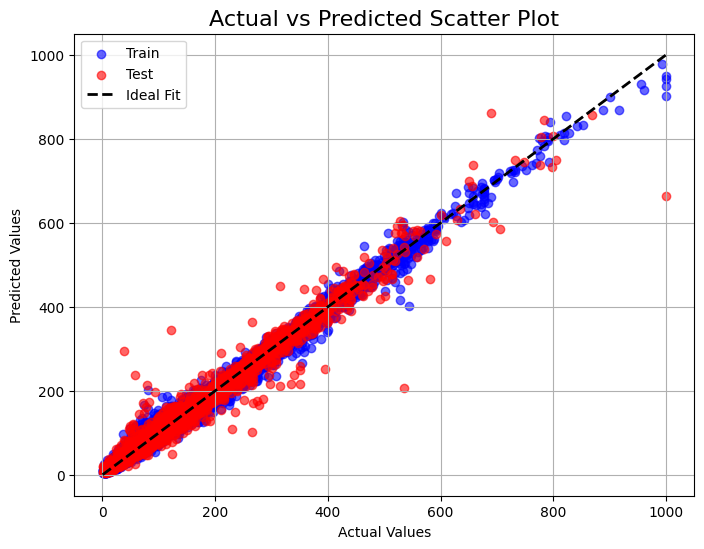

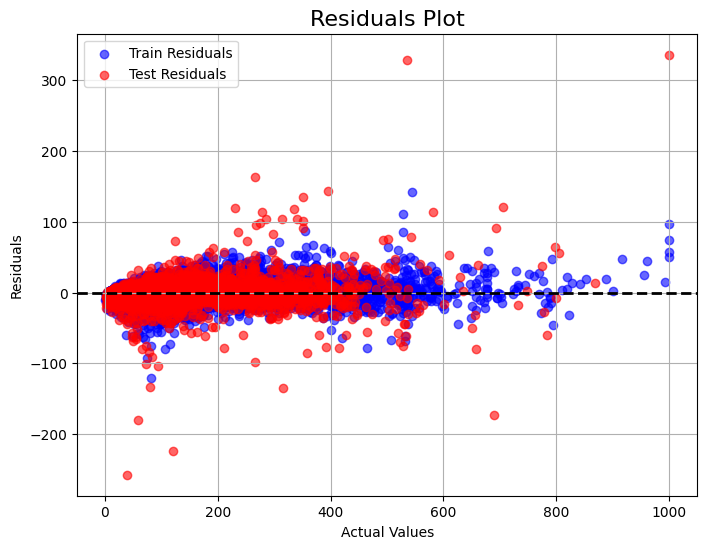

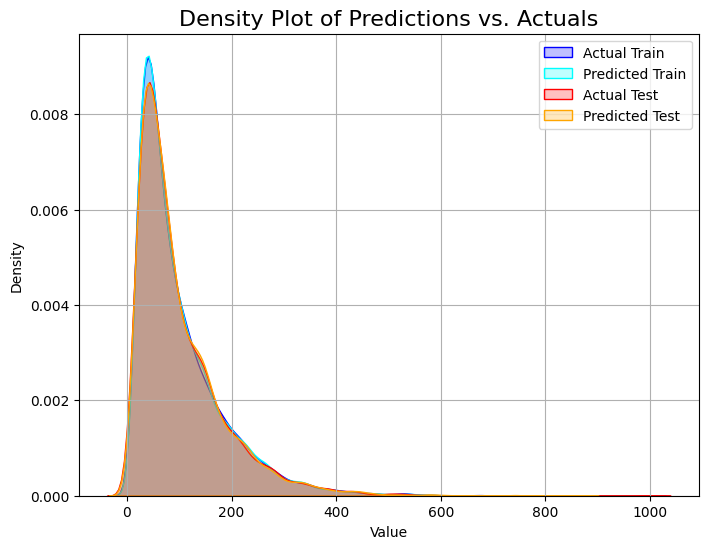

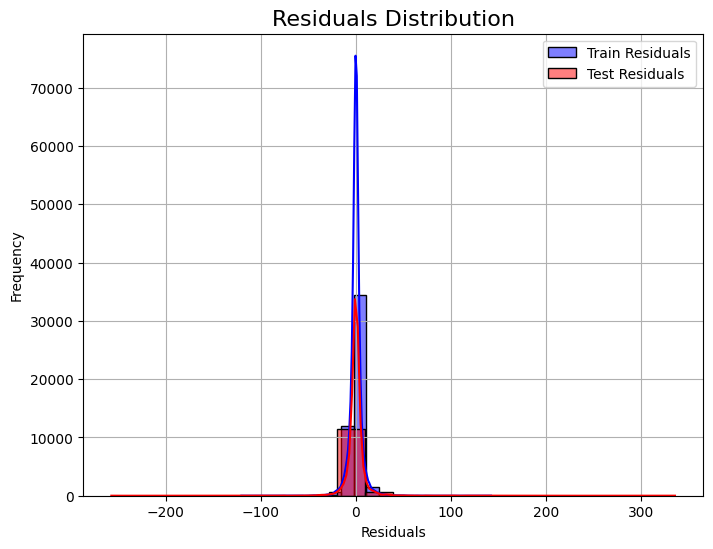

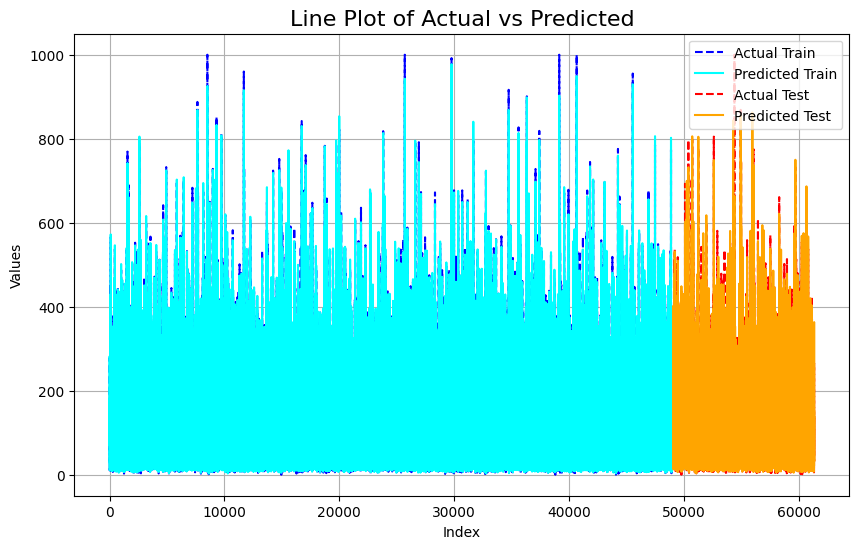

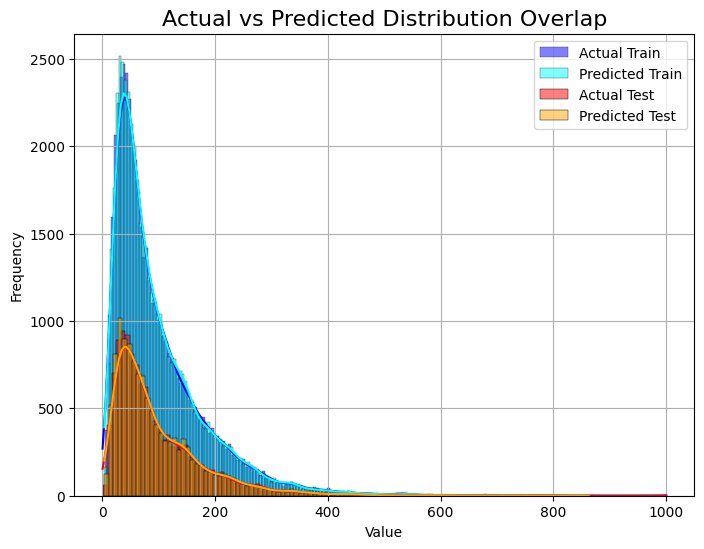

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def plot_actual_vs_predicted(y_train, y_train_pred, y_test, y_test_pred):
    plt.figure(figsize=(8, 6))
    plt.scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    plt.scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    plt.plot([min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
             [min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
             'k--', lw=2, label="Ideal Fit")
    plt.title("Actual vs Predicted Scatter Plot", fontsize=16)
    plt.xlabel("Actual Values")
    plt.ylabel("Predicted Values")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_residuals(y_train, y_train_pred, y_test, y_test_pred):
    plt.figure(figsize=(8, 6))
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    plt.scatter(y_train, train_residuals, color='blue', alpha=0.6, label='Train Residuals')
    plt.scatter(y_test, test_residuals, color='red', alpha=0.6, label='Test Residuals')
    plt.axhline(0, color='k', linestyle='--', lw=2)
    plt.title("Residuals Plot", fontsize=16)
    plt.xlabel("Actual Values")
    plt.ylabel("Residuals")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_density_predictions(y_train, y_train_pred, y_test, y_test_pred):
    plt.figure(figsize=(8, 6))
    sns.kdeplot(y_train, color='blue', fill=True, label="Actual Train")
    sns.kdeplot(y_train_pred, color='cyan', fill=True, label="Predicted Train")
    sns.kdeplot(y_test, color='red', fill=True, label="Actual Test")
    sns.kdeplot(y_test_pred, color='orange', fill=True, label="Predicted Test")
    plt.title("Density Plot of Predictions vs. Actuals", fontsize=16)
    plt.xlabel("Value")
    plt.ylabel("Density")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_error_distribution(y_train, y_train_pred, y_test, y_test_pred):
    plt.figure(figsize=(8, 6))
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    sns.histplot(train_residuals, color="blue", bins=20, label="Train Residuals", kde=True)
    sns.histplot(test_residuals, color="red", bins=20, label="Test Residuals", kde=True)
    plt.title("Residuals Distribution", fontsize=16)
    plt.xlabel("Residuals")
    plt.ylabel("Frequency")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_line_actual_vs_predicted(y_train, y_train_pred, y_test, y_test_pred):
    plt.figure(figsize=(10, 6))
    plt.plot(np.arange(len(y_train)), y_train, color='blue', label="Actual Train", linestyle='--')
    plt.plot(np.arange(len(y_train)), y_train_pred, color='cyan', label="Predicted Train")
    plt.plot(np.arange(len(y_train), len(y_train) + len(y_test)), y_test, color='red', linestyle='--', label="Actual Test")
    plt.plot(np.arange(len(y_train), len(y_train) + len(y_test)), y_test_pred, color='orange', label="Predicted Test")
    plt.title("Line Plot of Actual vs Predicted", fontsize=16)
    plt.xlabel("Index")
    plt.ylabel("Values")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_actual_predicted_overlap(y_train, y_train_pred, y_test, y_test_pred):
    plt.figure(figsize=(8, 6))
    sns.histplot(y_train, color="blue", label="Actual Train", alpha=0.5, kde=True)
    sns.histplot(y_train_pred, color="cyan", label="Predicted Train", alpha=0.5, kde=True)
    sns.histplot(y_test, color="red", label="Actual Test", alpha=0.5, kde=True)
    sns.histplot(y_test_pred, color="orange", label="Predicted Test", alpha=0.5, kde=True)
    plt.title("Actual vs Predicted Distribution Overlap", fontsize=16)
    plt.xlabel("Value")
    plt.ylabel("Frequency")
    plt.legend()
    plt.grid(True)
    plt.show()

# Example usage:
plot_actual_vs_predicted(y_train, y_train_pred, y_test, y_test_pred)
plot_residuals(y_train, y_train_pred, y_test, y_test_pred)
plot_density_predictions(y_train, y_train_pred, y_test, y_test_pred)
plot_error_distribution(y_train, y_train_pred, y_test, y_test_pred)
plot_line_actual_vs_predicted(y_train, y_train_pred, y_test, y_test_pred)
plot_actual_predicted_overlap(y_train, y_train_pred, y_test, y_test_pred)


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def enhanced_visualization(y_train, y_train_pred, y_test, y_test_pred, performance):
    # Print performance metrics
    print("Model Performance:")
    for metric, value in performance.items():
        print(f"{metric}: {value:.4f}")

    # Initialize subplots
    fig, axs = plt.subplots(2, 2, figsize=(18, 10))
    fig.suptitle("Model Evaluation and Residuals Analysis", fontsize=16)

    # R² Scores Bar Plot
    axs[0, 0].bar(['Train R²', 'Test R²'], [performance['Train R²'], performance['Test R²']], color=['skyblue', 'salmon'])
    axs[0, 0].set_title("R² Scores")
    axs[0, 0].set_ylim(0, 1)
    axs[0, 0].set_ylabel("R² Score")

    # Actual vs Predicted Scatter Plot with Regression Line
    axs[0, 1].scatter(y_train, y_train_pred, color='blue', alpha=0.6, label='Train')
    axs[0, 1].scatter(y_test, y_test_pred, color='red', alpha=0.6, label='Test')
    axs[0, 1].plot([min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
                   [min(y_train.min(), y_test.min()), max(y_train.max(), y_test.max())],
                   'k--', lw=2, label="Ideal Fit")
    axs[0, 1].set_title("Actual vs Predicted")
    axs[0, 1].set_xlabel("Actual Values")
    axs[0, 1].set_ylabel("Predicted Values")
    axs[0, 1].legend()

    # Residuals Density Plot
    train_residuals = y_train - y_train_pred
    test_residuals = y_test - y_test_pred
    sns.kdeplot(train_residuals, color='blue', fill=True, ax=axs[1, 0], label='Train Residuals')
    sns.kdeplot(test_residuals, color='red', fill=True, ax=axs[1, 0], label='Test Residuals')
    axs[1, 0].set_title("Residuals Density Plot")
    axs[1, 0].set_xlabel("Residuals")
    axs[1, 0].set_ylabel("Density")
    axs[1, 0].legend()

    # Actual vs Predicted Histograms
    sns.histplot(y_train, color="blue", label="Actual Train", alpha=0.6, kde=True, ax=axs[1, 1])
    sns.histplot(y_train_pred, color="cyan", label="Predicted Train", alpha=0.6, kde=True, ax=axs[1, 1])
    sns.histplot(y_test, color="red", label="Actual Test", alpha=0.6, kde=True, ax=axs[1, 1])
    sns.histplot(y_test_pred, color="orange", label="Predicted Test", alpha=0.6, kde=True, ax=axs[1, 1])
    axs[1, 1].set_title("Actual vs Predicted Distribution")
    axs[1, 1].set_xlabel("Value")
    axs[1, 1].set_ylabel("Frequency")
    axs[1, 1].legend()

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Example usage:
performance = {
    'Train R²': r2_score(y_train, y_train_pred),
    'Test R²': r2_score(y_test, y_test_pred),
    'Train MSE': mean_squared_error(y_train, y_train_pred),
    'Test MSE': mean_squared_error(y_test, y_test_pred),
    'Train MAE': mean_absolute_error(y_train, y_train_pred),
    'Test MAE': mean_absolute_error(y_test, y_test_pred)
}

# Call the enhanced visualization function
enhanced_visualization(y_train, y_train_pred, y_test, y_test_pred, performance)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 30, 64)              │          18,688 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 30, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 32)                  │          12,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 32)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              33 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 31,137 (121.63 KB)

 Trainable params: 31,137 (121.63 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 67s 41ms/step - loss: 0.0075 - val_loss: 0.0033
Epoch 2/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 78s 38ms/step - loss: 0.0049 - val_loss: 0.0032
Epoch 3/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 62s 41ms/step - loss: 0.0044 - val_loss: 0.0027
Epoch 4/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 80s 39ms/step - loss: 0.0043 - val_loss: 0.0028
Epoch 5/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 84s 40ms/step - loss: 0.0041 - val_loss: 0.0025
Epoch 6/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 81s 40ms/step - loss: 0.0040 - val_loss: 0.0025
Epoch 7/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 60s 39ms/step - loss: 0.0039 - val_loss: 0.0028
Epoch 8/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 62s 41ms/step - loss: 0.0038 - val_loss: 0.0024
Epoch 9/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 60s 39ms/step - loss: 0.0036 - val_loss: 0.0032
Epoch 10/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 85s 41ms/step - loss: 0.0035 - val_loss: 0.0030
Epoch 11/20
1533/1533 ━━━━━━━━━━━━━━━━━━━━ 79s 39ms/step - loss: 0.0034 - val_loss: 0.0029
Epoch 12

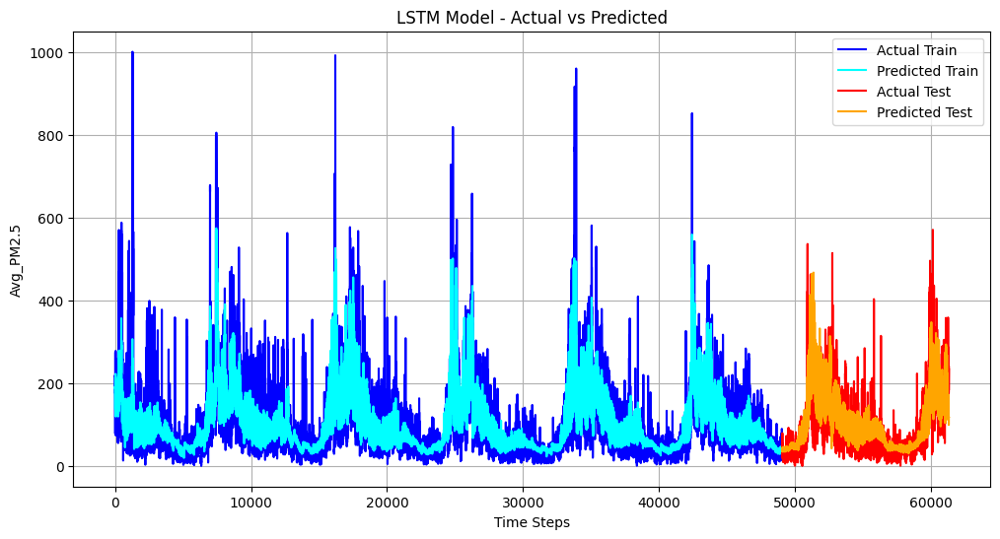

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Normalize features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)
y_normalized = scaler.fit_transform(y.values.reshape(-1, 1))

# Function to create sequences for LSTM
def create_sequences(X, y, time_steps=30):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:i+time_steps])
        y_seq.append(y[i+time_steps])
    return np.array(X_seq), np.array(y_seq)

# Create sequences
time_steps = 30  # Using 30 past observations to predict the next
X_seq, y_seq = create_sequences(X_normalized, y_normalized, time_steps)

# Split into training and testing sets
split_ratio = 0.8
split_index = int(split_ratio * len(X_seq))
X_train, X_test = X_seq[:split_index], X_seq[split_index:]
y_train, y_test = y_seq[:split_index], y_seq[split_index:]

# Define LSTM model
model = Sequential([
    LSTM(64, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.2),
    LSTM(32, return_sequences=False),
    Dropout(0.2),
    Dense(1)
])

model.compile(optimizer='adam', loss='mean_squared_error')
model.summary()

# Train the model
history = model.fit(X_train, y_train, epochs=20, batch_size=32, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Rescale predictions and actual values back to original scale
y_train_pred_rescaled = scaler.inverse_transform(y_train_pred)
y_test_pred_rescaled = scaler.inverse_transform(y_test_pred)
y_train_rescaled = scaler.inverse_transform(y_train)
y_test_rescaled = scaler.inverse_transform(y_test)

# Plot actual vs predicted values
def plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled):
    plt.figure(figsize=(12, 6))

    # Plot training data predictions
    plt.plot(y_train_rescaled, color='blue', label='Actual Train')
    plt.plot(y_train_pred_rescaled, color='cyan', label='Predicted Train')

    # Plot testing data predictions
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_rescaled, color='red', label='Actual Test')
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_pred_rescaled, color='orange', label='Predicted Test')

    plt.title("LSTM Model - Actual vs Predicted")
    plt.xlabel("Time Steps")
    plt.ylabel("Avg_PM2.5")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                          │ (None, 30, 36)              │           6,480 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 30, 36)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_1 (LSTM)                        │ (None, 31)                  │           8,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 31)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │              32 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,944 (58.38 KB)

 Trainable params: 14,944 (58.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 63s 75ms/step - loss: 0.0113 - val_loss: 0.0034
Epoch 2/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 75s 66ms/step - loss: 0.0059 - val_loss: 0.0032
Epoch 3/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 42ms/step - loss: 0.0055 - val_loss: 0.0031
Epoch 4/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 42ms/step - loss: 0.0051 - val_loss: 0.0031
Epoch 5/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 41s 42ms/step - loss: 0.0048 - val_loss: 0.0035
Epoch 6/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 44s 46ms/step - loss: 0.0050 - val_loss: 0.0026
Epoch 7/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 38s 42ms/step - loss: 0.0046 - val_loss: 0.0025
Epoch 8/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 40s 41ms/step - loss: 0.0043 - val_loss: 0.0024
Epoch 9/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 41ms/step - loss: 0.0041 - val_loss: 0.0024
Epoch 10/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 41s 41ms/step - loss: 0.0040 - val_loss: 0.0023
Epoch 11/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 43s 44ms/step - loss: 0.0040 - val_loss: 0.0026
Epoch 12/20
767/767 ━━━━━━━━━━

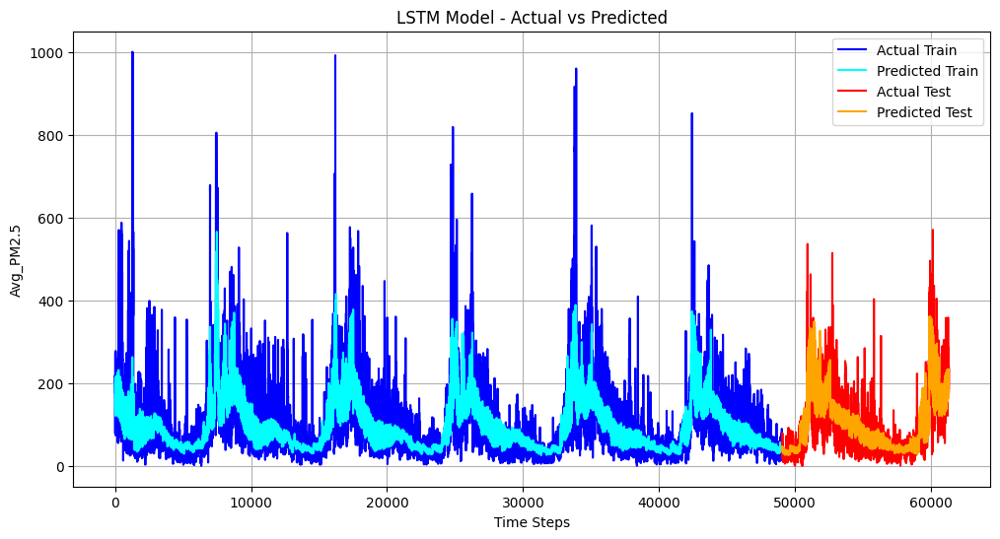

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Normalize features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)
y_normalized = scaler.fit_transform(y.values.reshape(-1, 1))

# Function to create sequences for LSTM
def create_sequences(X, y, time_steps=30):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:i+time_steps])
        y_seq.append(y[i+time_steps])
    return np.array(X_seq), np.array(y_seq)

# Create sequences
time_steps = 30  # Using 30 past observations to predict the next
X_seq, y_seq = create_sequences(X_normalized, y_normalized, time_steps)

# Split into training and testing sets
split_ratio = 0.8
split_index = int(split_ratio * len(X_seq))
X_train, X_test = X_seq[:split_index], X_seq[split_index:]
y_train, y_test = y_seq[:split_index], y_seq[split_index:]

# Define LSTM model with the given parameters
model = Sequential([
    LSTM(36, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.3611),
    LSTM(31, return_sequences=False),
    Dropout(0.2490),
    Dense(1)
])

# Compile model with given learning rate
model.compile(optimizer=Adam(learning_rate=0.0003847625107947734), loss='mean_squared_error')
model.summary()

# Train the model with specified batch size
history = model.fit(X_train, y_train, epochs=20, batch_size=64, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Rescale predictions and actual values back to original scale
y_train_pred_rescaled = scaler.inverse_transform(y_train_pred)
y_test_pred_rescaled = scaler.inverse_transform(y_test_pred)
y_train_rescaled = scaler.inverse_transform(y_train)
y_test_rescaled = scaler.inverse_transform(y_test)

# Plot actual vs predicted values
def plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled):
    plt.figure(figsize=(12, 6))

    # Plot training data predictions
    plt.plot(y_train_rescaled, color='blue', label='Actual Train')
    plt.plot(y_train_pred_rescaled, color='cyan', label='Predicted Train')

    # Plot testing data predictions
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_rescaled, color='red', label='Actual Test')
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_pred_rescaled, color='orange', label='Predicted Test')

    plt.title("LSTM Model - Actual vs Predicted")
    plt.xlabel("Time Steps")
    plt.ylabel("Avg_PM2.5")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled)


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_2 (LSTM)                        │ (None, 30, 36)              │           6,480 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 30, 36)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_3 (LSTM)                        │ (None, 31)                  │           8,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 31)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │              32 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,944 (58.38 KB)

 Trainable params: 14,944 (58.38 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 82s 90ms/step - loss: 0.0120 - val_loss: 0.0047
Epoch 2/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 77s 83ms/step - loss: 0.0051 - val_loss: 0.0044
Epoch 3/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 54s 70ms/step - loss: 0.0045 - val_loss: 0.0043
Epoch 4/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 60s 41ms/step - loss: 0.0044 - val_loss: 0.0041
Epoch 5/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 42s 43ms/step - loss: 0.0042 - val_loss: 0.0040
Epoch 6/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 43s 45ms/step - loss: 0.0042 - val_loss: 0.0040
Epoch 7/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 38s 42ms/step - loss: 0.0040 - val_loss: 0.0039
Epoch 8/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 41s 42ms/step - loss: 0.0040 - val_loss: 0.0038
Epoch 9/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 43s 45ms/step - loss: 0.0040 - val_loss: 0.0038
Epoch 10/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 38s 41ms/step - loss: 0.0038 - val_loss: 0.0038
Epoch 11/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 42ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 12/20
767/767 ━━━━━━━━━━

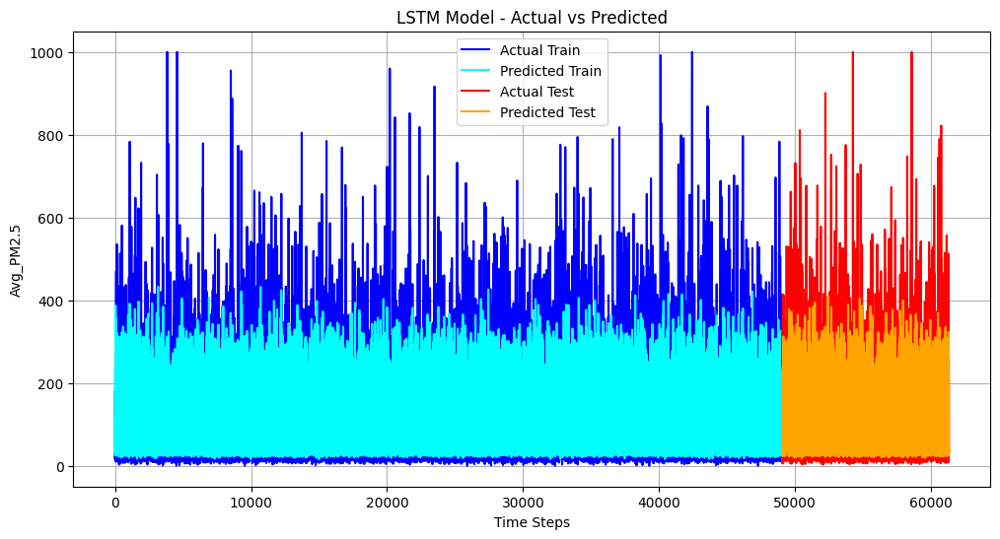

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Normalize features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X)
y_normalized = scaler.fit_transform(y.values.reshape(-1, 1))

# Function to create sequences for LSTM
def create_sequences(X, y, time_steps=30):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:i+time_steps])
        y_seq.append(y[i+time_steps])
    return np.array(X_seq), np.array(y_seq)

# Create sequences
time_steps = 30  # Using 30 past observations to predict the next
X_seq, y_seq = create_sequences(X_normalized, y_normalized, time_steps)

# Random split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_seq, y_seq, test_size=0.2, random_state=42)

# Define LSTM model with the given parameters
model = Sequential([
    LSTM(36, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.3611),
    LSTM(31, return_sequences=False),
    Dropout(0.2490),
    Dense(1)
])

# Compile model with given learning rate
model.compile(optimizer=Adam(learning_rate=0.0003847625107947734), loss='mean_squared_error')
model.summary()

# Train the model with specified batch size
history = model.fit(X_train, y_train, epochs=20, batch_size=64, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Rescale predictions and actual values back to original scale
y_train_pred_rescaled = scaler.inverse_transform(y_train_pred)
y_test_pred_rescaled = scaler.inverse_transform(y_test_pred)
y_train_rescaled = scaler.inverse_transform(y_train)
y_test_rescaled = scaler.inverse_transform(y_test)

# Plot actual vs predicted values
def plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled):
    plt.figure(figsize=(12, 6))

    # Plot training data predictions
    plt.plot(y_train_rescaled, color='blue', label='Actual Train')
    plt.plot(y_train_pred_rescaled, color='cyan', label='Predicted Train')

    # Plot testing data predictions
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_rescaled, color='red', label='Actual Test')
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_pred_rescaled, color='orange', label='Predicted Test')

    plt.title("LSTM Model - Actual vs Predicted")
    plt.xlabel("Time Steps")
    plt.ylabel("Avg_PM2.5")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled)


Correlation with Avg_PM2.5:
 Avg_PM2.5                  1.000000
Sonia_Vihar_PM2.5          0.947420
mandir_marg_PM2.5          0.925478
Sirifort_PM2.5             0.863598
IHBAS_PM2.5                0.838085
Month                      0.117252
Avg_RH (%)                 0.096106
Avg_SO2 (µg/m³)            0.035206
Avg_Xylene (µg/m³)         0.034778
Avg_CO (mg/m³)             0.034660
Avg_PM10 (µg/m³)           0.021817
Avg_NO2 (µg/m³)            0.019715
Avg_VWS (m/s)              0.016822
Avg_Toluene (µg/m³)        0.012039
Avg_WD (deg)               0.009366
Avg_O Xylene (µg/m³)      -0.009964
Avg_Eth-Benzene (µg/m³)   -0.009965
Day                       -0.021698
Avg_SR (W/mt2)            -0.028723
Avg_AT (°C)               -0.067545
Year                      -0.079667
Hour                      -0.097001
Name: Avg_PM2.5, dtype: float64

Selected features by RFE: Index(['Hour', 'Day', 'Month', 'Avg_AT (°C)', 'Avg_VWS (m/s)'], dtype='object')


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ lstm_4 (LSTM)                        │ (None, 30, 36)              │           6,048 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_4 (Dropout)                  │ (None, 30, 36)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ lstm_5 (LSTM)                        │ (None, 31)                  │           8,432 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_5 (Dropout)                  │ (None, 31)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 1)                   │              32 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 14,512 (56.69 KB)

 Trainable params: 14,512 (56.69 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 38s 46ms/step - loss: 0.0165 - val_loss: 0.0034
Epoch 2/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 42ms/step - loss: 0.0061 - val_loss: 0.0035
Epoch 3/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 40s 41ms/step - loss: 0.0055 - val_loss: 0.0032
Epoch 4/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 41s 41ms/step - loss: 0.0051 - val_loss: 0.0029
Epoch 5/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 41s 41ms/step - loss: 0.0049 - val_loss: 0.0034
Epoch 6/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 43s 44ms/step - loss: 0.0047 - val_loss: 0.0029
Epoch 7/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 39s 41ms/step - loss: 0.0047 - val_loss: 0.0025
Epoch 8/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 42ms/step - loss: 0.0046 - val_loss: 0.0027
Epoch 9/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 40s 41ms/step - loss: 0.0044 - val_loss: 0.0022
Epoch 10/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 32s 42ms/step - loss: 0.0043 - val_loss: 0.0034
Epoch 11/20
767/767 ━━━━━━━━━━━━━━━━━━━━ 43s 45ms/step - loss: 0.0044 - val_loss: 0.0025
Epoch 12/20
767/767 ━━━━━━━━━━

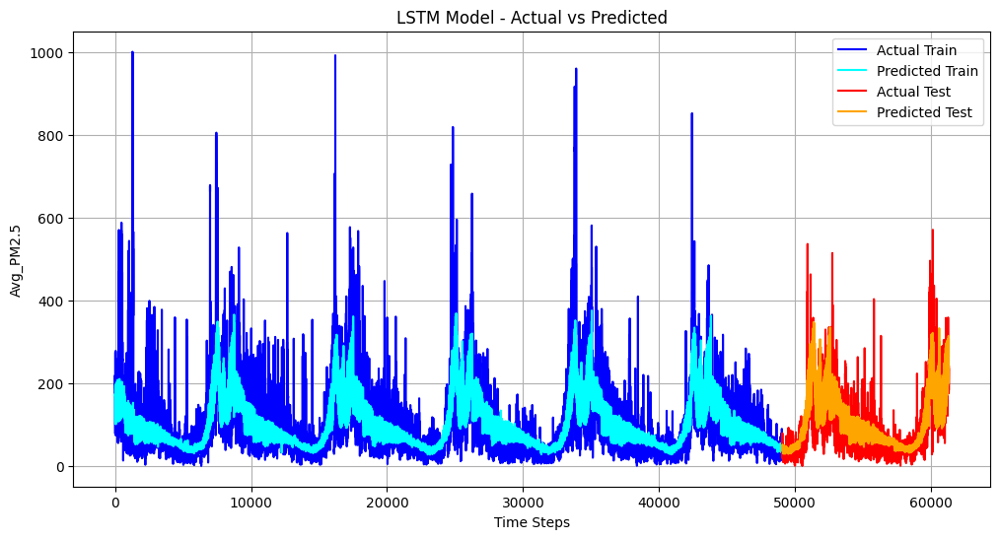

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import RFE
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define initial features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)', 'Avg_WD (deg)']]
y = data['Avg_PM2.5']

# Step 1: Correlation Analysis
correlation_matrix = data.corr()
print("Correlation with Avg_PM2.5:\n", correlation_matrix['Avg_PM2.5'].sort_values(ascending=False))

# Step 2: Recursive Feature Elimination (RFE) with Random Forest
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rfe = RFE(estimator=rf, n_features_to_select=5)  # Select top 5 features
rfe.fit(X, y)
selected_features = X.columns[rfe.support_]
print("\nSelected features by RFE:", selected_features)

# Use only selected features for X
X_selected = data[selected_features]

# Normalize selected features
scaler = MinMaxScaler()
X_normalized = scaler.fit_transform(X_selected)
y_normalized = scaler.fit_transform(y.values.reshape(-1, 1))

# Function to create sequences for LSTM
def create_sequences(X, y, time_steps=30):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:i+time_steps])
        y_seq.append(y[i+time_steps])
    return np.array(X_seq), np.array(y_seq)

# Create sequences
time_steps = 30  # Using 30 past observations to predict the next
X_seq, y_seq = create_sequences(X_normalized, y_normalized, time_steps)

# Split into training and testing sets
split_ratio = 0.8
split_index = int(split_ratio * len(X_seq))
X_train, X_test = X_seq[:split_index], X_seq[split_index:]
y_train, y_test = y_seq[:split_index], y_seq[split_index:]

# Define LSTM model with optimal parameters
model = Sequential([
    LSTM(36, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.3611),
    LSTM(31, return_sequences=False),
    Dropout(0.2490),
    Dense(1)
])

# Compile model with specified learning rate
model.compile(optimizer=Adam(learning_rate=0.0003847625107947734), loss='mean_squared_error')
model.summary()

# Train the model with specified batch size
history = model.fit(X_train, y_train, epochs=20, batch_size=64, validation_data=(X_test, y_test), verbose=1)

# Make predictions
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)

# Rescale predictions and actual values back to original scale
y_train_pred_rescaled = scaler.inverse_transform(y_train_pred)
y_test_pred_rescaled = scaler.inverse_transform(y_test_pred)
y_train_rescaled = scaler.inverse_transform(y_train)
y_test_rescaled = scaler.inverse_transform(y_test)

# Plot actual vs predicted values
def plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled):
    plt.figure(figsize=(12, 6))

    # Plot training data predictions
    plt.plot(y_train_rescaled, color='blue', label='Actual Train')
    plt.plot(y_train_pred_rescaled, color='cyan', label='Predicted Train')

    # Plot testing data predictions
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_rescaled, color='red', label='Actual Test')
    plt.plot(range(len(y_train_rescaled), len(y_train_rescaled) + len(y_test_rescaled)),
             y_test_pred_rescaled, color='orange', label='Predicted Test')

    plt.title("LSTM Model - Actual vs Predicted")
    plt.xlabel("Time Steps")
    plt.ylabel("Avg_PM2.5")
    plt.legend()
    plt.grid(True)
    plt.show()

plot_lstm_predictions(y_train_rescaled, y_train_pred_rescaled, y_test_rescaled, y_test_pred_rescaled)


In [ ]:
from sklearn.metrics import r2_score

# Calculate R^2 score for training and testing sets
train_r2 = r2_score(y_train_rescaled, y_train_pred_rescaled)
test_r2 = r2_score(y_test_rescaled, y_test_pred_rescaled)

# Print R^2 scores
print(f"Train R² Score: {train_r2:.4f}")
print(f"Test R² Score: {test_r2:.4f}")

Train R² Score: 0.5338
Test R² Score: 0.5598



Model Performance:
Train R²: 0.9989
Validation R²: 0.8747
Test R²: 0.8720
Train MSE: 8.1389
Validation MSE: 983.5197
Test MSE: 968.3679
Train MAE: 1.4330
Validation MAE: 17.0834
Test MAE: 17.0340


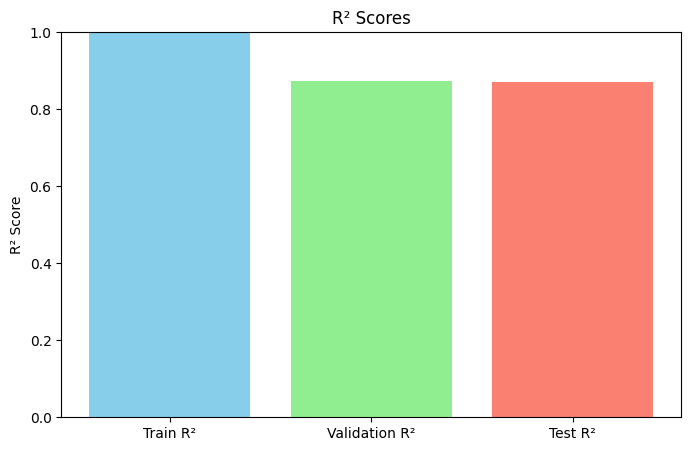

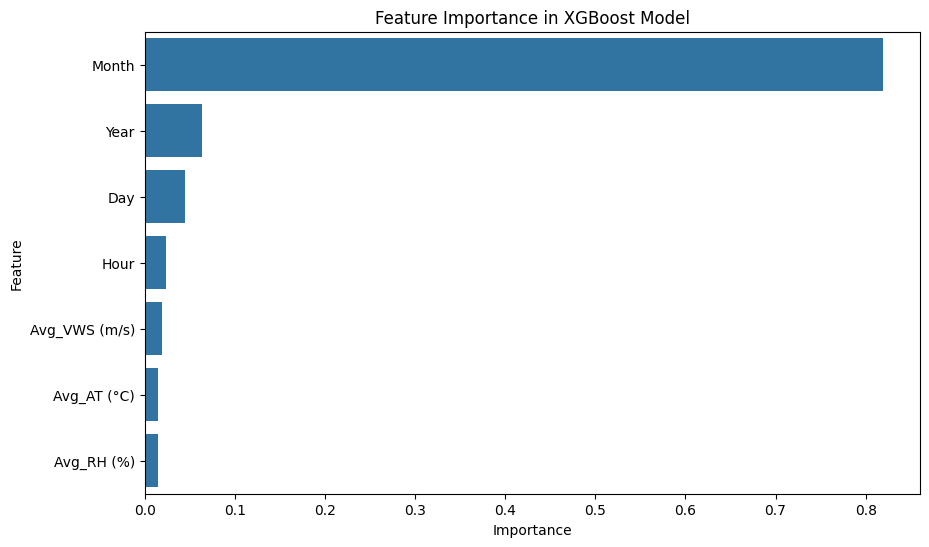

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y = data['Avg_PM2.5']

# Function to apply the 1.5 IQR method and remove outliers
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

# Apply 1.5 IQR to remove outliers from features
X_filtered = remove_outliers(X)
y_filtered = y.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split the filtered data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train, y_temp = train_test_split(X_filtered, y_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model
xgb_model = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model.fit(X_train_normalized, y_train)

# Predictions for train, validation, and test sets
y_train_pred = xgb_model.predict(X_train_normalized)
y_val_pred = xgb_model.predict(X_val_normalized)
y_test_pred = xgb_model.predict(X_test_normalized)

# Calculate performance metrics for each set
performance = {
    'Train R²': r2_score(y_train, y_train_pred),
    'Validation R²': r2_score(y_val, y_val_pred),
    'Test R²': r2_score(y_test, y_test_pred),
    'Train MSE': mean_squared_error(y_train, y_train_pred),
    'Validation MSE': mean_squared_error(y_val, y_val_pred),
    'Test MSE': mean_squared_error(y_test, y_test_pred),
    'Train MAE': mean_absolute_error(y_train, y_train_pred),
    'Validation MAE': mean_absolute_error(y_val, y_val_pred),
    'Test MAE': mean_absolute_error(y_test, y_test_pred)
}

# Print performance metrics
print("\nModel Performance:")
for metric, value in performance.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance['Train R²'], performance['Validation R²'], performance['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance
feature_importance = xgb_model.feature_importances_
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance}).sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df)
plt.title("Feature Importance in XGBoost Model")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()



Model Performance for Avg_PM10:
Train R²: 0.9984
Validation R²: 0.6342
Test R²: 0.6321
Train MSE: 28.0312
Validation MSE: 6370.3321
Test MSE: 6517.1495
Train MAE: 2.9277
Validation MAE: 54.2673
Test MAE: 54.5384


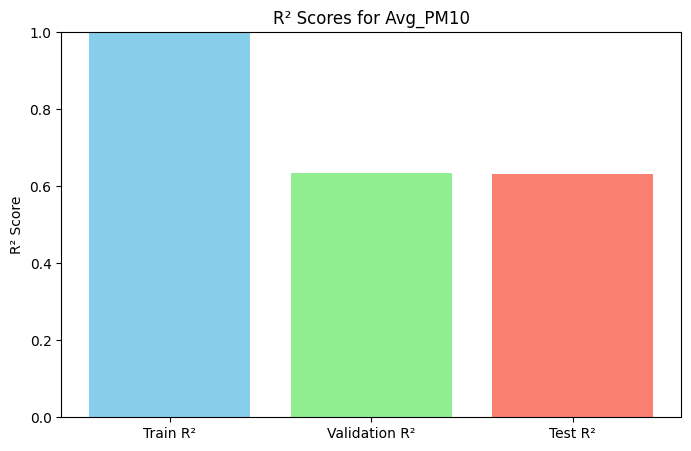

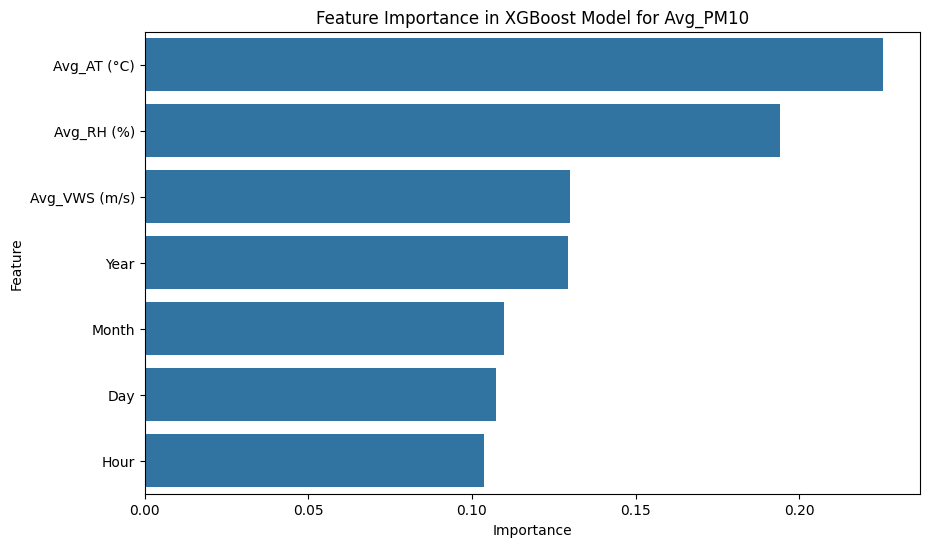

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for Avg_PM10
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_pm10 = data['Avg_PM10 (µg/m³)']

# Function to apply the 1.5 IQR method and remove outliers
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

# Apply 1.5 IQR to remove outliers from features
X_filtered = remove_outliers(X)
y_pm10_filtered = y_pm10.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split the filtered data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train_pm10, y_temp_pm10 = train_test_split(X_filtered, y_pm10_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_pm10, y_test_pm10 = train_test_split(X_temp, y_temp_pm10, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define and train the XGBRegressor model for Avg_PM10
xgb_model_pm10 = XGBRegressor(
    n_estimators=294,
    max_depth=20,
    learning_rate=0.025500916544420573,
    min_child_weight=2,
    subsample=0.7434753286589282,
    random_state=42
)

# Train the model
xgb_model_pm10.fit(X_train_normalized, y_train_pm10)

# Predictions for train, validation, and test sets
y_train_pred_pm10 = xgb_model_pm10.predict(X_train_normalized)
y_val_pred_pm10 = xgb_model_pm10.predict(X_val_normalized)
y_test_pred_pm10 = xgb_model_pm10.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_pm10 = {
    'Train R²': r2_score(y_train_pm10, y_train_pred_pm10),
    'Validation R²': r2_score(y_val_pm10, y_val_pred_pm10),
    'Test R²': r2_score(y_test_pm10, y_test_pred_pm10),
    'Train MSE': mean_squared_error(y_train_pm10, y_train_pred_pm10),
    'Validation MSE': mean_squared_error(y_val_pm10, y_val_pred_pm10),
    'Test MSE': mean_squared_error(y_test_pm10, y_test_pred_pm10),
    'Train MAE': mean_absolute_error(y_train_pm10, y_train_pred_pm10),
    'Validation MAE': mean_absolute_error(y_val_pm10, y_val_pred_pm10),
    'Test MAE': mean_absolute_error(y_test_pm10, y_test_pred_pm10)
}

# Print performance metrics for Avg_PM10
print("\nModel Performance for Avg_PM10:")
for metric, value in performance_pm10.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_PM10
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_pm10['Train R²'], performance_pm10['Validation R²'], performance_pm10['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_PM10")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_PM10
feature_importance_pm10 = xgb_model_pm10.feature_importances_
importance_df_pm10 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_pm10}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_pm10)
plt.title("Feature Importance in XGBoost Model for Avg_PM10")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


In [ ]:
import optuna
from xgboost import XGBRegressor
from sklearn.model_selection import cross_val_score

def objective(trial):
    # Define the hyperparameter space for XGBoost
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    max_depth = trial.suggest_int('max_depth', 3, 20)
    learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3)
    min_child_weight = trial.suggest_int('min_child_weight', 1, 10)
    subsample = trial.suggest_float('subsample', 0.5, 1.0)
    colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1.0)
    gamma = trial.suggest_float('gamma', 0, 5)

    # Initialize and evaluate the model
    xgb = XGBRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        min_child_weight=min_child_weight,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        gamma=gamma,
        random_state=42
    )
    score = cross_val_score(xgb, X_train, y_train, cv=3, scoring='r2').mean()
    return score

# Run optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30)
print("Best parameters found:", study.best_params)


[I 2024-10-26 08:27:29,052] A new study created in memory with name: no-name-89395bcf-2c64-4c23-8a5e-ac86f57a706a
[I 2024-10-26 08:27:36,084] Trial 0 finished with value: 0.5911358972565645 and parameters: {'n_estimators': 75, 'max_depth': 11, 'learning_rate': 0.22576794836323197, 'min_child_weight': 7, 'subsample': 0.8893658681562351, 'colsample_bytree': 0.5880651358771851, 'gamma': 2.5273955114935918}. Best is trial 0 with value: 0.5911358972565645.
[I 2024-10-26 08:27:59,869] Trial 1 finished with value: 0.5118691417558782 and parameters: {'n_estimators': 256, 'max_depth': 9, 'learning_rate': 0.027947322548406164, 'min_child_weight': 10, 'subsample': 0.7780023363522875, 'colsample_bytree': 0.6771145518953471, 'gamma': 1.9736839570155251}. Best is trial 0 with value: 0.5911358972565645.
[I 2024-10-26 08:28:52,631] Trial 2 finished with value: 0.6001326745060068 and parameters: {'n_estimators': 172, 'max_depth': 13, 'learning_rate': 0.23527467741439348, 'min_child_weight': 6, 'subsamp

Best parameters found: {'n_estimators': 249, 'max_depth': 11, 'learning_rate': 0.10455315316438735, 'min_child_weight': 5, 'subsample': 0.6878666230807745, 'colsample_bytree': 0.8066898039732157, 'gamma': 1.2787932566932645}

Model Performance for Avg_PM10 with Optimized Parameters:
Train R²: 0.9777
Validation R²: 0.7083
Test R²: 0.7008
Train MSE: 390.5932
Validation MSE: 5078.6365
Test MSE: 5300.4646
Train MAE: 13.8910
Validation MAE: 50.2659
Test MAE: 50.9176


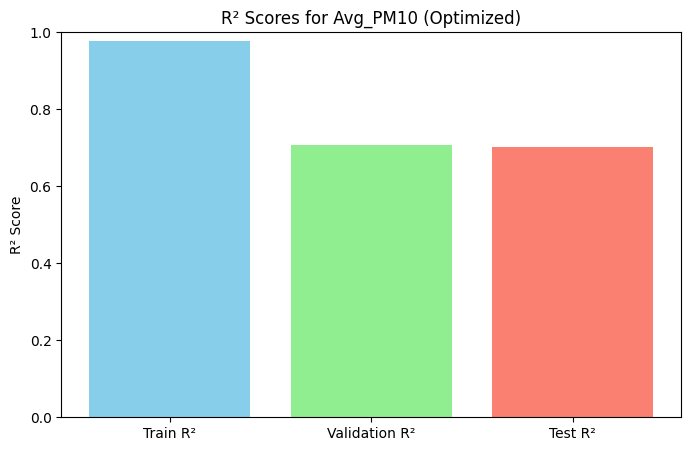

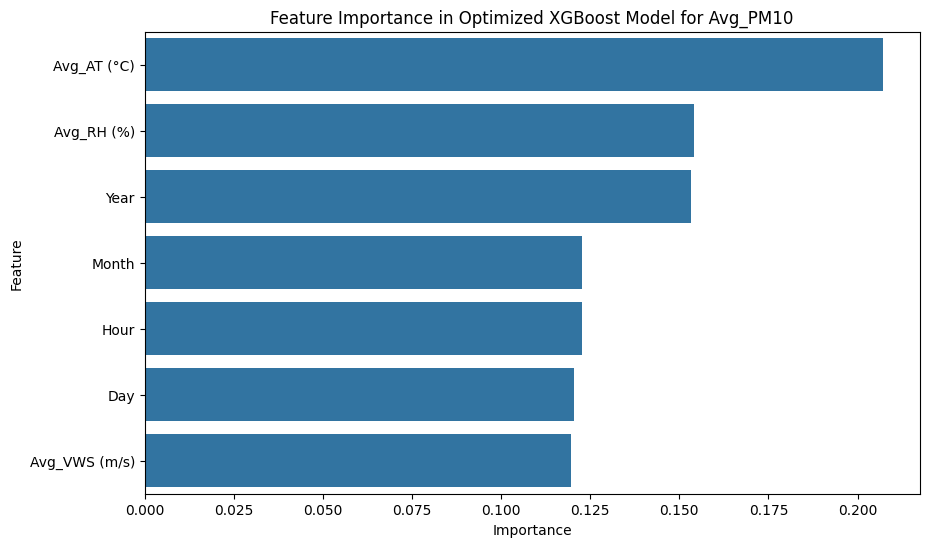

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split, cross_val_score
import optuna

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for Avg_PM10
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_pm10 = data['Avg_PM10 (µg/m³)']

# Function to apply the 1.5 IQR method and remove outliers
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

# Apply 1.5 IQR to remove outliers from features
X_filtered = remove_outliers(X)
y_pm10_filtered = y_pm10.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split the filtered data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train_pm10, y_temp_pm10 = train_test_split(X_filtered, y_pm10_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_pm10, y_test_pm10 = train_test_split(X_temp, y_temp_pm10, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define the objective function for Optuna to optimize XGBoost hyperparameters
def objective(trial):
    # Define the hyperparameter space for XGBoost
    n_estimators = trial.suggest_int('n_estimators', 50, 300)
    max_depth = trial.suggest_int('max_depth', 3, 20)
    learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3)
    min_child_weight = trial.suggest_int('min_child_weight', 1, 10)
    subsample = trial.suggest_float('subsample', 0.5, 1.0)
    colsample_bytree = trial.suggest_float('colsample_bytree', 0.5, 1.0)
    gamma = trial.suggest_float('gamma', 0, 5)

    # Initialize and evaluate the model using cross-validation
    xgb = XGBRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        learning_rate=learning_rate,
        min_child_weight=min_child_weight,
        subsample=subsample,
        colsample_bytree=colsample_bytree,
        gamma=gamma,
        random_state=42
    )
    score = cross_val_score(xgb, X_train_normalized, y_train_pm10, cv=3, scoring='r2').mean()
    return score

# Run optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30)
print("Best parameters found:", study.best_params)

# Train the final model with best parameters from Optuna
best_params = study.best_params
xgb_model_pm10 = XGBRegressor(**best_params, random_state=42)
xgb_model_pm10.fit(X_train_normalized, y_train_pm10)

# Predictions for train, validation, and test sets
y_train_pred_pm10 = xgb_model_pm10.predict(X_train_normalized)
y_val_pred_pm10 = xgb_model_pm10.predict(X_val_normalized)
y_test_pred_pm10 = xgb_model_pm10.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_pm10 = {
    'Train R²': r2_score(y_train_pm10, y_train_pred_pm10),
    'Validation R²': r2_score(y_val_pm10, y_val_pred_pm10),
    'Test R²': r2_score(y_test_pm10, y_test_pred_pm10),
    'Train MSE': mean_squared_error(y_train_pm10, y_train_pred_pm10),
    'Validation MSE': mean_squared_error(y_val_pm10, y_val_pred_pm10),
    'Test MSE': mean_squared_error(y_test_pm10, y_test_pred_pm10),
    'Train MAE': mean_absolute_error(y_train_pm10, y_train_pred_pm10),
    'Validation MAE': mean_absolute_error(y_val_pm10, y_val_pred_pm10),
    'Test MAE': mean_absolute_error(y_test_pm10, y_test_pred_pm10)
}

# Print performance metrics for Avg_PM10
print("\nModel Performance for Avg_PM10 with Optimized Parameters:")
for metric, value in performance_pm10.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_PM10
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_pm10['Train R²'], performance_pm10['Validation R²'], performance_pm10['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_PM10 (Optimized)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_PM10
feature_importance_pm10 = xgb_model_pm10.feature_importances_
importance_df_pm10 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_pm10}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_pm10)
plt.title("Feature Importance in Optimized XGBoost Model for Avg_PM10")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()



Model Performance for Avg_PM10 with Optimized Parameters:
Train R²: 0.9777
Validation R²: 0.7083
Test R²: 0.7008
Train MSE: 390.5932
Validation MSE: 5078.6365
Test MSE: 5300.4646
Train MAE: 13.8910
Validation MAE: 50.2659
Test MAE: 50.9176


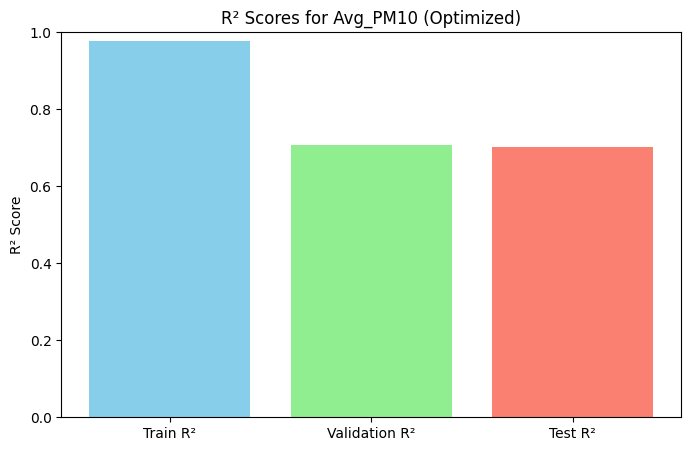

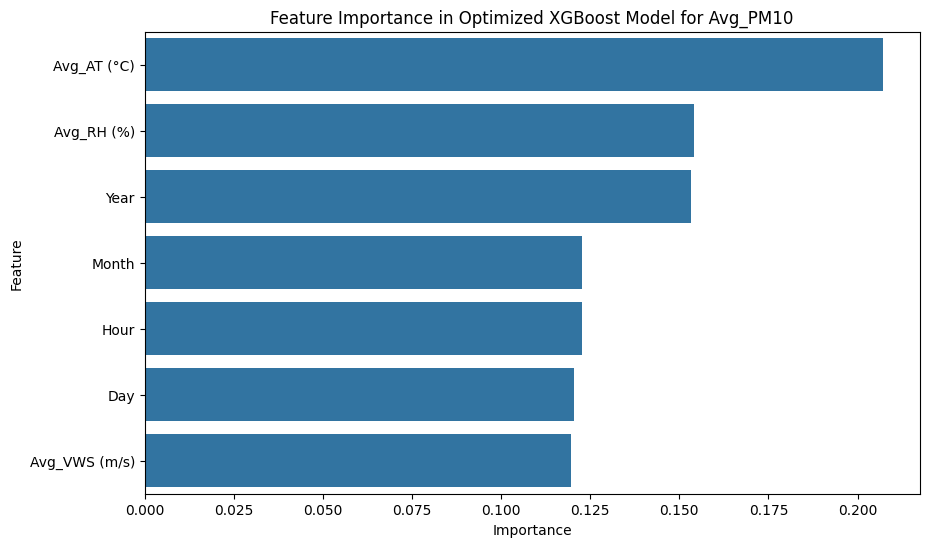

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for Avg_PM10
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_pm10 = data['Avg_PM10 (µg/m³)']

# Function to apply the 1.5 IQR method and remove outliers
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

# Apply 1.5 IQR to remove outliers from features
X_filtered = remove_outliers(X)
y_pm10_filtered = y_pm10.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split the filtered data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train_pm10, y_temp_pm10 = train_test_split(X_filtered, y_pm10_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_pm10, y_test_pm10 = train_test_split(X_temp, y_temp_pm10, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Initialize and train the XGBRegressor with optimized parameters
xgb_model_pm10 = XGBRegressor(
    n_estimators=249,
    max_depth=11,
    learning_rate=0.10455315316438735,
    min_child_weight=5,
    subsample=0.6878666230807745,
    colsample_bytree=0.8066898039732157,
    gamma=1.2787932566932645,
    random_state=42
)

xgb_model_pm10.fit(X_train_normalized, y_train_pm10)

# Predictions for train, validation, and test sets
y_train_pred_pm10 = xgb_model_pm10.predict(X_train_normalized)
y_val_pred_pm10 = xgb_model_pm10.predict(X_val_normalized)
y_test_pred_pm10 = xgb_model_pm10.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_pm10 = {
    'Train R²': r2_score(y_train_pm10, y_train_pred_pm10),
    'Validation R²': r2_score(y_val_pm10, y_val_pred_pm10),
    'Test R²': r2_score(y_test_pm10, y_test_pred_pm10),
    'Train MSE': mean_squared_error(y_train_pm10, y_train_pred_pm10),
    'Validation MSE': mean_squared_error(y_val_pm10, y_val_pred_pm10),
    'Test MSE': mean_squared_error(y_test_pm10, y_test_pred_pm10),
    'Train MAE': mean_absolute_error(y_train_pm10, y_train_pred_pm10),
    'Validation MAE': mean_absolute_error(y_val_pm10, y_val_pred_pm10),
    'Test MAE': mean_absolute_error(y_test_pm10, y_test_pred_pm10)
}

# Print performance metrics for Avg_PM10 with optimized parameters
print("\nModel Performance for Avg_PM10 with Optimized Parameters:")
for metric, value in performance_pm10.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_PM10
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_pm10['Train R²'], performance_pm10['Validation R²'], performance_pm10['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_PM10 (Optimized)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_PM10
feature_importance_pm10 = xgb_model_pm10.feature_importances_
importance_df_pm10 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_pm10}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_pm10)
plt.title("Feature Importance in Optimized XGBoost Model for Avg_PM10")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [08:41:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "n_estimators" } are not used.

  warnings.warn(smsg, UserWarning)



Model Performance for Avg_PM10 with Adjusted Parameters:
Train R²: 0.5837
Validation R²: 0.5054
Test R²: 0.4965
Train MSE: 7299.5713
Validation MSE: 8613.2006
Test MSE: 8919.5739
Train MAE: 61.2756
Validation MAE: 66.9214
Test MAE: 67.8068


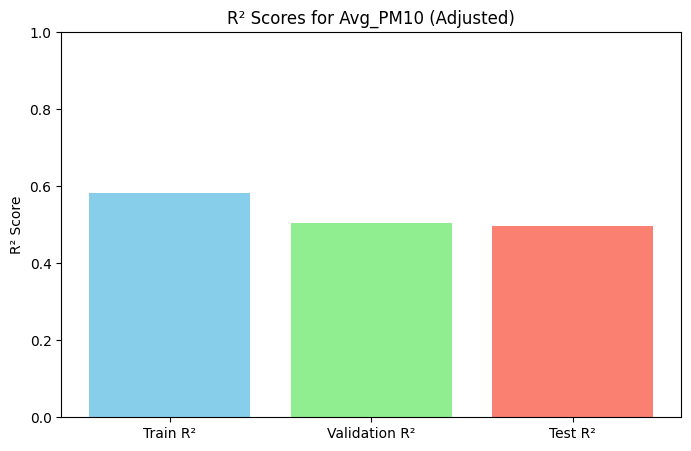

In [ ]:
import xgboost as xgb
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import pandas as pd

# Convert data into DMatrix format
dtrain = xgb.DMatrix(X_train_normalized, label=y_train_pm10)
dval = xgb.DMatrix(X_val_normalized, label=y_val_pm10)
dtest = xgb.DMatrix(X_test_normalized, label=y_test_pm10)

# Set parameters for the XGBoost model
params = {
    'objective': 'reg:squarederror',
    'n_estimators': 500,
    'max_depth': 6,  # Reduced depth
    'learning_rate': 0.03,  # Lowered learning rate
    'min_child_weight': 5,
    'subsample': 0.6878666230807745,
    'colsample_bytree': 0.8066898039732157,
    'gamma': 1.2787932566932645,
    'reg_alpha': 5,  # Increased regularization
    'reg_lambda': 5,
    'seed': 42,
    'eval_metric': 'rmse'
}

# Train the model with early stopping
evals = [(dtrain, 'train'), (dval, 'eval')]
xgb_model_pm10 = xgb.train(
    params, dtrain, num_boost_round=500, evals=evals, early_stopping_rounds=20, verbose_eval=False
)

# Predictions for train, validation, and test sets
y_train_pred_pm10 = xgb_model_pm10.predict(dtrain)
y_val_pred_pm10 = xgb_model_pm10.predict(dval)
y_test_pred_pm10 = xgb_model_pm10.predict(dtest)

# Calculate performance metrics for each set
performance_pm10 = {
    'Train R²': r2_score(y_train_pm10, y_train_pred_pm10),
    'Validation R²': r2_score(y_val_pm10, y_val_pred_pm10),
    'Test R²': r2_score(y_test_pm10, y_test_pred_pm10),
    'Train MSE': mean_squared_error(y_train_pm10, y_train_pred_pm10),
    'Validation MSE': mean_squared_error(y_val_pm10, y_val_pred_pm10),
    'Test MSE': mean_squared_error(y_test_pm10, y_test_pred_pm10),
    'Train MAE': mean_absolute_error(y_train_pm10, y_train_pred_pm10),
    'Validation MAE': mean_absolute_error(y_val_pm10, y_val_pred_pm10),
    'Test MAE': mean_absolute_error(y_test_pm10, y_test_pred_pm10)
}

# Print performance metrics for Avg_PM10 with adjusted parameters
print("\nModel Performance for Avg_PM10 with Adjusted Parameters:")
for metric, value in performance_pm10.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_PM10
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_pm10['Train R²'], performance_pm10['Validation R²'], performance_pm10['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_PM10 (Adjusted)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()


In [ ]:
pip install optuna

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 362.8/362.8 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.2/233.2 kB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 5.7 MB/s eta 0:00:00



Model Performance for Avg_SO2 with Optimized Parameters:
Train R²: 0.9538
Validation R²: 0.4518
Test R²: 0.4448
Train MSE: 2.0813
Validation MSE: 25.2071
Test MSE: 25.5384
Train MAE: 0.9864
Validation MAE: 3.2190
Test MAE: 3.2094


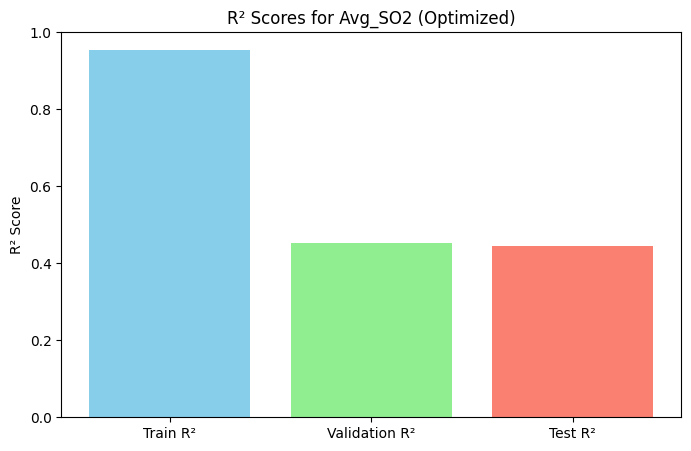

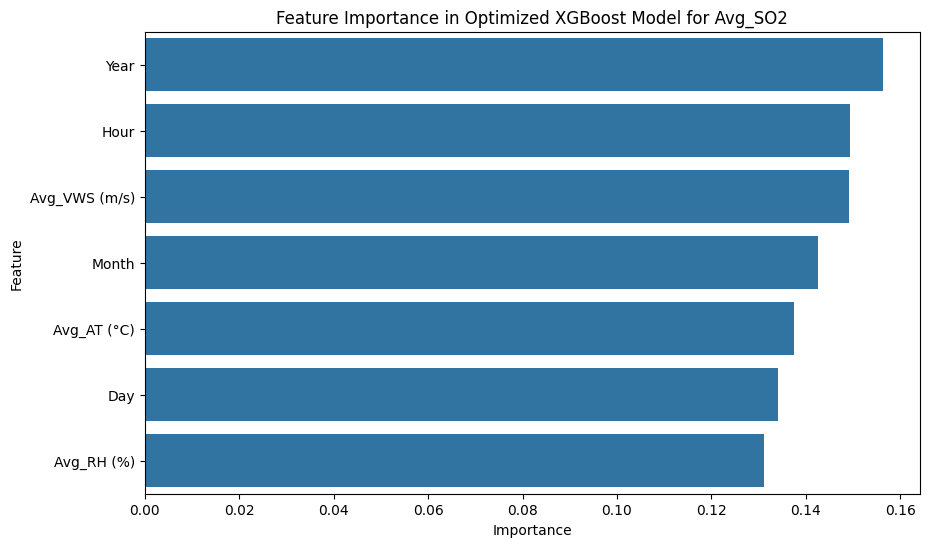

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from xgboost import XGBRegressor
from sklearn.model_selection import train_test_split

# Load the dataset
file_path = '/content/Book5 (1) (1).xlsx'  # Adjust the path as needed
data = pd.read_excel(file_path)

# Convert 'Timestamp' to datetime and set it as the index
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)

# Interpolate missing values linearly
data.interpolate(method='linear', inplace=True)

# Extract datetime features
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for Avg_SO2
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_so2 = data['Avg_SO2 (µg/m³)']

# Function to apply the 1.5 IQR method and remove outliers
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

# Apply 1.5 IQR to remove outliers from features
X_filtered = remove_outliers(X)
y_so2_filtered = y_so2.loc[X_filtered.index]  # Filter y to match X after outlier removal

# Split the filtered data into training (60%), validation (20%), and test (20%) sets
X_train, X_temp, y_train_so2, y_temp_so2 = train_test_split(X_filtered, y_so2_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_so2, y_test_so2 = train_test_split(X_temp, y_temp_so2, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Initialize and train the XGBRegressor with optimized parameters
xgb_model_so2 = XGBRegressor(
    n_estimators=249,
    max_depth=11,
    learning_rate=0.10455315316438735,
    min_child_weight=5,
    subsample=0.6878666230807745,
    colsample_bytree=0.8066898039732157,
    gamma=1.2787932566932645,
    random_state=42
)

xgb_model_so2.fit(X_train_normalized, y_train_so2)

# Predictions for train, validation, and test sets
y_train_pred_so2 = xgb_model_so2.predict(X_train_normalized)
y_val_pred_so2 = xgb_model_so2.predict(X_val_normalized)
y_test_pred_so2 = xgb_model_so2.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_so2 = {
    'Train R²': r2_score(y_train_so2, y_train_pred_so2),
    'Validation R²': r2_score(y_val_so2, y_val_pred_so2),
    'Test R²': r2_score(y_test_so2, y_test_pred_so2),
    'Train MSE': mean_squared_error(y_train_so2, y_train_pred_so2),
    'Validation MSE': mean_squared_error(y_val_so2, y_val_pred_so2),
    'Test MSE': mean_squared_error(y_test_so2, y_test_pred_so2),
    'Train MAE': mean_absolute_error(y_train_so2, y_train_pred_so2),
    'Validation MAE': mean_absolute_error(y_val_so2, y_val_pred_so2),
    'Test MAE': mean_absolute_error(y_test_so2, y_test_pred_so2)
}

# Print performance metrics for Avg_SO2 with optimized parameters
print("\nModel Performance for Avg_SO2 with Optimized Parameters:")
for metric, value in performance_so2.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_SO2
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_so2['Train R²'], performance_so2['Validation R²'], performance_so2['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_SO2 (Optimized)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_SO2
feature_importance_so2 = xgb_model_so2.feature_importances_
importance_df_so2 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_so2}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_SO2
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_so2)
plt.title("Feature Importance in Optimized XGBoost Model for Avg_SO2")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


[I 2024-10-26 08:51:56,051] A new study created in memory with name: no-name-792bb90f-8196-405d-a42b-1dca8d604adc
[I 2024-10-26 08:52:16,417] Trial 0 finished with value: 0.3004983099396696 and parameters: {'n_estimators': 102, 'max_depth': 14, 'learning_rate': 0.08394004490297101, 'min_child_weight': 3, 'subsample': 0.7699487105840636, 'colsample_bytree': 0.5456027201822211, 'gamma': 2.049929261501275, 'reg_alpha': 0.5888123106434238, 'reg_lambda': 0.05939118149332523}. Best is trial 0 with value: 0.3004983099396696.
[I 2024-10-26 08:52:21,063] Trial 1 finished with value: 0.13476532063721738 and parameters: {'n_estimators': 235, 'max_depth': 3, 'learning_rate': 0.04715767184469095, 'min_child_weight': 5, 'subsample': 0.8382811714129008, 'colsample_bytree': 0.5496168920898626, 'gamma': 3.2588106829254677, 'reg_alpha': 0.2463664108112753, 'reg_lambda': 0.6396505935651203}. Best is trial 0 with value: 0.3004983099396696.
[I 2024-10-26 08:52:27,518] Trial 2 finished with value: 0.1961675

Best parameters found: {'n_estimators': 254, 'max_depth': 11, 'learning_rate': 0.08499477196356457, 'min_child_weight': 6, 'subsample': 0.7899549614453103, 'colsample_bytree': 0.9999277046745856, 'gamma': 3.208997094664201, 'reg_alpha': 0.693348103664008, 'reg_lambda': 0.2216034529357201}

Model Performance for Avg_SO2 with Optimized Parameters:
Train R²: 0.9369
Validation R²: 0.4644
Test R²: 0.4548
Train MSE: 2.8392
Validation MSE: 24.6283
Test MSE: 25.0805
Train MAE: 1.1424
Validation MAE: 3.1592
Test MAE: 3.1593


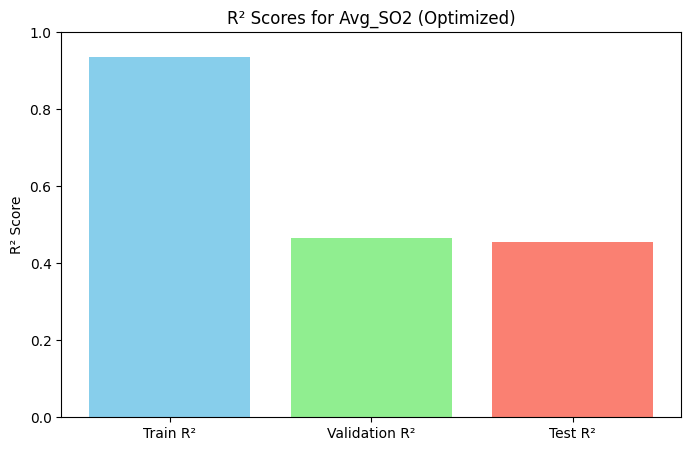

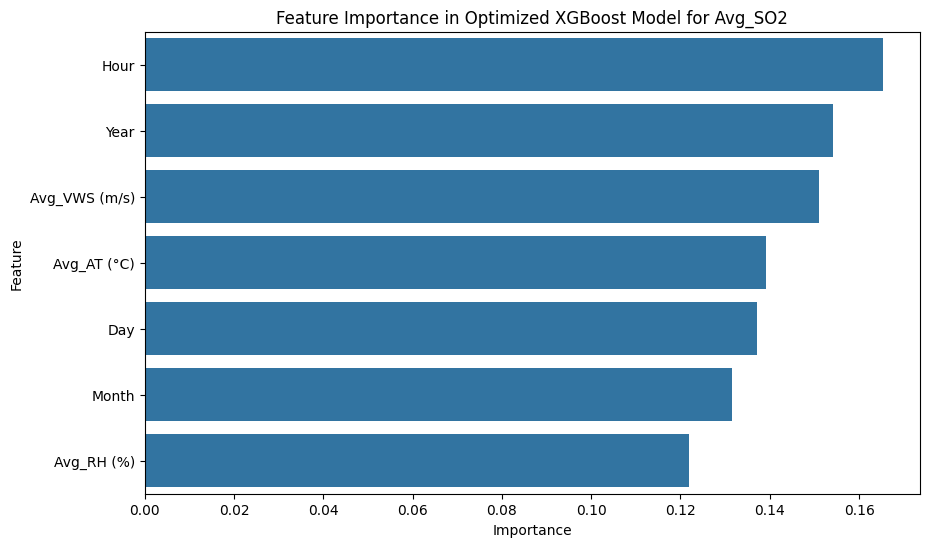

In [ ]:
import optuna
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
import pandas as pd
import numpy as np

# Load and preprocess the dataset (same steps as before)
file_path = '/content/Book5 (1) (1).xlsx'
data = pd.read_excel(file_path)
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)
data.interpolate(method='linear', inplace=True)
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_so2 = data['Avg_SO2 (µg/m³)']

# Apply 1.5 IQR to remove outliers from features
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

X_filtered = remove_outliers(X)
y_so2_filtered = y_so2.loc[X_filtered.index]

# Split data into training, validation, and test sets
X_train, X_temp, y_train_so2, y_temp_so2 = train_test_split(X_filtered, y_so2_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_so2, y_test_so2 = train_test_split(X_temp, y_temp_so2, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define the objective function for Optuna to optimize XGBoost hyperparameters
def objective(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 300),
        'max_depth': trial.suggest_int('max_depth', 3, 20),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'gamma': trial.suggest_float('gamma', 0, 5),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 1.0),
        'random_state': 42
    }

    # Initialize and evaluate the model
    xgb = XGBRegressor(**params)
    score = cross_val_score(xgb, X_train_normalized, y_train_so2, cv=3, scoring='r2').mean()
    return score

# Run optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)
best_params = study.best_params
print("Best parameters found:", best_params)

# Train the model with best parameters from Optuna
xgb_model_so2 = XGBRegressor(**best_params)
xgb_model_so2.fit(X_train_normalized, y_train_so2)

# Predictions for train, validation, and test sets
y_train_pred_so2 = xgb_model_so2.predict(X_train_normalized)
y_val_pred_so2 = xgb_model_so2.predict(X_val_normalized)
y_test_pred_so2 = xgb_model_so2.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_so2 = {
    'Train R²': r2_score(y_train_so2, y_train_pred_so2),
    'Validation R²': r2_score(y_val_so2, y_val_pred_so2),
    'Test R²': r2_score(y_test_so2, y_test_pred_so2),
    'Train MSE': mean_squared_error(y_train_so2, y_train_pred_so2),
    'Validation MSE': mean_squared_error(y_val_so2, y_val_pred_so2),
    'Test MSE': mean_squared_error(y_test_so2, y_test_pred_so2),
    'Train MAE': mean_absolute_error(y_train_so2, y_train_pred_so2),
    'Validation MAE': mean_absolute_error(y_val_so2, y_val_pred_so2),
    'Test MAE': mean_absolute_error(y_test_so2, y_test_pred_so2)
}

# Print performance metrics for Avg_SO2 with optimized parameters
print("\nModel Performance for Avg_SO2 with Optimized Parameters:")
for metric, value in performance_so2.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_SO2
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_so2['Train R²'], performance_so2['Validation R²'], performance_so2['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_SO2 (Optimized)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_SO2
feature_importance_so2 = xgb_model_so2.feature_importances_
importance_df_so2 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_so2}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_SO2
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_so2)
plt.title("Feature Importance in Optimized XGBoost Model for Avg_SO2")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


In [ ]:
# Load and preprocess the dataset
import pandas as pd
file_path = '/content/aqi_calculated_dataset.xlsx'
data = pd.read_excel(file_path)
data.head()

,Timestamp,Sirifort_PM2.5,IHBAS_PM2.5,Sonia_Vihar_PM2.5,mandir_marg_PM2.5,Avg_PM2.5,Avg_PM10 (µg/m³),Avg_NO2 (µg/m³),Avg_AT (°C),Avg_VWS (m/s),...,Avg_Eth-Benzene (µg/m³),Avg_CO (mg/m³),Avg_RH (%),Avg_Xylene (µg/m³),Avg_WD (deg),Avg_Toluene (µg/m³),PM2.5_AQI,PM10_AQI,SO2_AQI,Max_AQI
0,2017-01-01 00:00:00,272.83,115.87,NaN,227.83,205.510000,302.83,68.926667,12.890,0.35,...,NaN,3.88,92.500000,NaN,133.416667,12.82,365.856512,252.830000,17.60000,365.856512
1,2017-01-01 01:00:00,233.47,115.15,NaN,224.17,190.930000,255.00,56.870000,12.230,0.39,...,NaN,2.92,92.836667,NaN,105.013333,11.83,354.667209,205.000000,14.12500,354.667209
2,2017-01-01 02:00:00,206.17,116.53,NaN,200.50,174.400000,240.00,52.853333,12.065,0.37,...,NaN,1.08,93.656667,NaN,109.826667,8.95,341.981395,193.355705,8.81250,341.981395
3,2017-01-01 03:00:00,195.85,114.00,NaN,154.83,154.893333,211.67,44.416667,10.980,0.40,...,NaN,0.98,93.010000,NaN,129.800000,7.94,327.011163,174.532416,10.05000,327.011163
4,2017-01-01 04:00:00,186.70,113.70,NaN,164.00,154.800000,205.67,35.743333,10.170,0.39,...,NaN,1.42,93.703333,NaN,182.590000,7.98,326.939535,170.545839,13.65625,326.939535


[I 2024-10-26 09:13:11,918] A new study created in memory with name: no-name-ea08636e-b5d5-49c3-8fdc-884b90e7f415
[I 2024-10-26 09:13:47,151] Trial 0 finished with value: 0.6197191714631628 and parameters: {'n_estimators': 132, 'max_depth': 18, 'learning_rate': 0.09128643193416394, 'min_child_weight': 6, 'subsample': 0.6485237578129877, 'colsample_bytree': 0.6468339081438275, 'gamma': 1.223855897001647, 'reg_alpha': 0.25894369427462105, 'reg_lambda': 0.06713631717860413}. Best is trial 0 with value: 0.6197191714631628.
[I 2024-10-26 09:13:59,817] Trial 1 finished with value: 0.6017184432990935 and parameters: {'n_estimators': 215, 'max_depth': 9, 'learning_rate': 0.08017506766294989, 'min_child_weight': 10, 'subsample': 0.6772697029733555, 'colsample_bytree': 0.5739180092974007, 'gamma': 1.2751590620231512, 'reg_alpha': 0.5183220128056915, 'reg_lambda': 0.6330498240351606}. Best is trial 0 with value: 0.6197191714631628.
[I 2024-10-26 09:14:11,740] Trial 2 finished with value: 0.617800

Best parameters found: {'n_estimators': 220, 'max_depth': 16, 'learning_rate': 0.04089110281005787, 'min_child_weight': 8, 'subsample': 0.8945129803374527, 'colsample_bytree': 0.8915782727496953, 'gamma': 4.322800173944445, 'reg_alpha': 0.5365855908200534, 'reg_lambda': 0.14938757834297423}

Model Performance for AQI with Optimized Parameters:
Train R²: 0.9721
Validation R²: 0.6909
Test R²: 0.6944
Train MSE: 350.2952
Validation MSE: 3930.5021
Test MSE: 3809.1004
Train MAE: 12.3620
Validation MAE: 43.3810
Test MAE: 42.6987


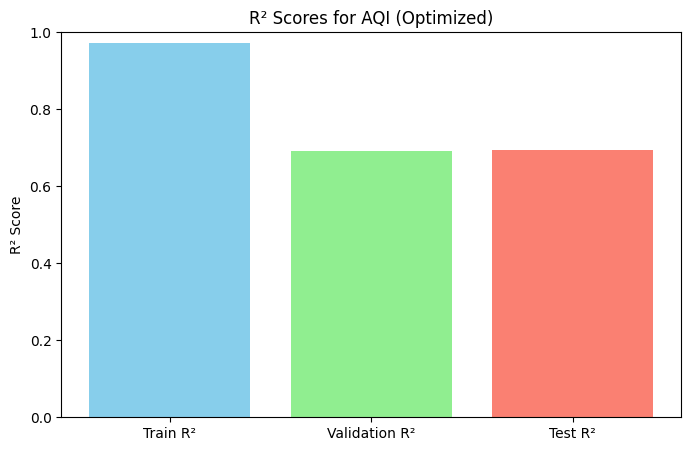

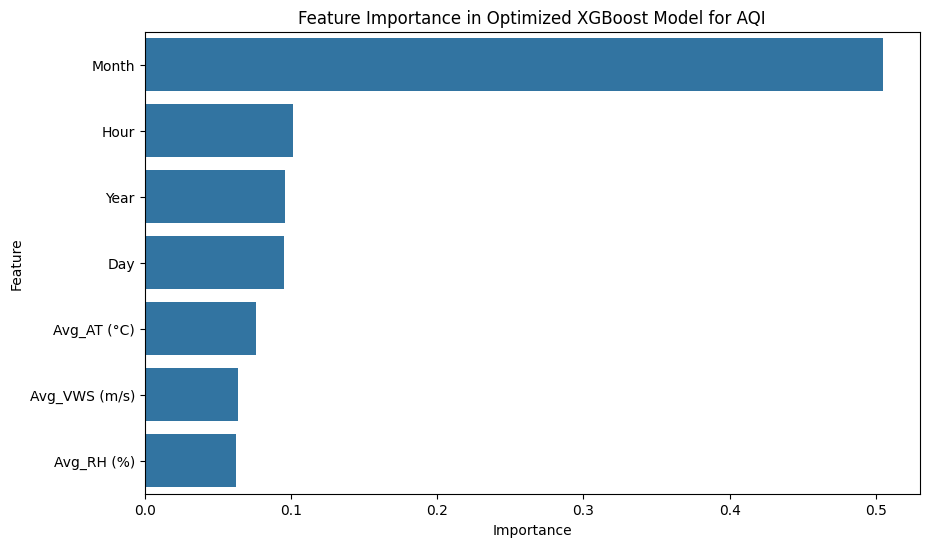

In [ ]:
import optuna
from sklearn.model_selection import cross_val_score
from xgboost import XGBRegressor
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split

# Load and preprocess the dataset
file_path = '/content/aqi_calculated_dataset.xlsx'
data = pd.read_excel(file_path)
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)
data.interpolate(method='linear', inplace=True)
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for AQI
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_aqi = data['Max_AQI']

# Apply 1.5 IQR to remove outliers from features
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

X_filtered = remove_outliers(X)
y_aqi_filtered = y_aqi.loc[X_filtered.index]

# Split data into training, validation, and test sets
X_train, X_temp, y_train_aqi, y_temp_aqi = train_test_split(X_filtered, y_aqi_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_aqi, y_test_aqi = train_test_split(X_temp, y_temp_aqi, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define the objective function for Optuna to optimize XGBoost hyperparameters
def objective(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 300),
        'max_depth': trial.suggest_int('max_depth', 3, 20),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 0.3),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
        'gamma': trial.suggest_float('gamma', 0, 5),
        'reg_alpha': trial.suggest_float('reg_alpha', 0.0, 1.0),
        'reg_lambda': trial.suggest_float('reg_lambda', 0.0, 1.0),
        'random_state': 42
    }

    # Initialize and evaluate the model
    xgb = XGBRegressor(**params)
    score = cross_val_score(xgb, X_train_normalized, y_train_aqi, cv=3, scoring='r2').mean()
    return score

# Run optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)
best_params = study.best_params
print("Best parameters found:", best_params)

# Train the model with best parameters from Optuna
xgb_model_aqi = XGBRegressor(**best_params)
xgb_model_aqi.fit(X_train_normalized, y_train_aqi)

# Predictions for train, validation, and test sets
y_train_pred_aqi = xgb_model_aqi.predict(X_train_normalized)
y_val_pred_aqi = xgb_model_aqi.predict(X_val_normalized)
y_test_pred_aqi = xgb_model_aqi.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_aqi = {
    'Train R²': r2_score(y_train_aqi, y_train_pred_aqi),
    'Validation R²': r2_score(y_val_aqi, y_val_pred_aqi),
    'Test R²': r2_score(y_test_aqi, y_test_pred_aqi),
    'Train MSE': mean_squared_error(y_train_aqi, y_train_pred_aqi),
    'Validation MSE': mean_squared_error(y_val_aqi, y_val_pred_aqi),
    'Test MSE': mean_squared_error(y_test_aqi, y_test_pred_aqi),
    'Train MAE': mean_absolute_error(y_train_aqi, y_train_pred_aqi),
    'Validation MAE': mean_absolute_error(y_val_aqi, y_val_pred_aqi),
    'Test MAE': mean_absolute_error(y_test_aqi, y_test_pred_aqi)
}

# Print performance metrics for AQI with optimized parameters
print("\nModel Performance for AQI with Optimized Parameters:")
for metric, value in performance_aqi.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for AQI
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_aqi['Train R²'], performance_aqi['Validation R²'], performance_aqi['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for AQI (Optimized)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for AQI
feature_importance_aqi = xgb_model_aqi.feature_importances_
importance_df_aqi = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_aqi}).sort_values(by='Importance', ascending=False)

# Plot feature importance for AQI
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_aqi)
plt.title("Feature Importance in Optimized XGBoost Model for AQI")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


In [ ]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import pandas as pd

# Assuming the data has been preprocessed as before, with X_filtered, y_aqi_filtered
# We split the data into train, validation, and test sets, and normalize

# Splitting and normalizing as before (reuse X_train, X_val, etc.)
X_train, X_temp, y_train_aqi, y_temp_aqi = train_test_split(X_filtered, y_aqi_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_aqi, y_test_aqi = train_test_split(X_temp, y_temp_aqi, test_size=0.5, random_state=42)
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define models to test
models = {
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'Support Vector Regressor': SVR(kernel='rbf', C=1.0, epsilon=0.2),
    'K-Nearest Neighbors': KNeighborsRegressor(n_neighbors=5),
    'Linear Regression': LinearRegression()
}

# Dictionary to store results
results = {}

# Train and evaluate each model
for model_name, model in models.items():
    # Train
    model.fit(X_train_normalized, y_train_aqi)

    # Predict
    y_val_pred = model.predict(X_val_normalized)
    y_test_pred = model.predict(X_test_normalized)

    # Calculate performance metrics
    results[model_name] = {
        'Validation R²': r2_score(y_val_aqi, y_val_pred),
        'Test R²': r2_score(y_test_aqi, y_test_pred),
        'Validation MSE': mean_squared_error(y_val_aqi, y_val_pred),
        'Test MSE': mean_squared_error(y_test_aqi, y_test_pred),
        'Validation MAE': mean_absolute_error(y_val_aqi, y_val_pred),
        'Test MAE': mean_absolute_error(y_test_aqi, y_test_pred)
    }

# Print results
print("\nModel Performance Comparison for AQI Prediction:")
for model_name, metrics in results.items():
    print(f"\n{model_name}:")
    for metric, value in metrics.items():
        print(f"{metric}: {value:.4f}")




Model Performance Comparison for AQI Prediction:

Random Forest:
Validation R²: 0.6586
Test R²: 0.6684
Validation MSE: 4341.1333
Test MSE: 4132.7462
Validation MAE: 45.9283
Test MAE: 44.9886

Gradient Boosting:
Validation R²: 0.4248
Test R²: 0.4406
Validation MSE: 7314.4960
Test MSE: 6971.3211
Validation MAE: 66.7770
Test MAE: 65.5290

Support Vector Regressor:
Validation R²: 0.3148
Test R²: 0.3315
Validation MSE: 8713.4859
Test MSE: 8331.8178
Validation MAE: 74.7096
Test MAE: 73.1885

K-Nearest Neighbors:
Validation R²: 0.6090
Test R²: 0.6158
Validation MSE: 4972.4873
Test MSE: 4787.7331
Validation MAE: 49.2626
Test MAE: 48.7855

Linear Regression:
Validation R²: 0.0595
Test R²: 0.0577
Validation MSE: 11959.3513
Test MSE: 11743.3700
Validation MAE: 93.7936
Test MAE: 92.9612



Model Performance for Avg_PM10 with Random Forest:
Train R²: 0.7972
Validation R²: 0.5026
Test R²: 0.5055
Train MSE: 3556.0495
Validation MSE: 8661.8931
Test MSE: 8758.7202
Train MAE: 42.8502
Validation MAE: 66.4068
Test MAE: 66.4548


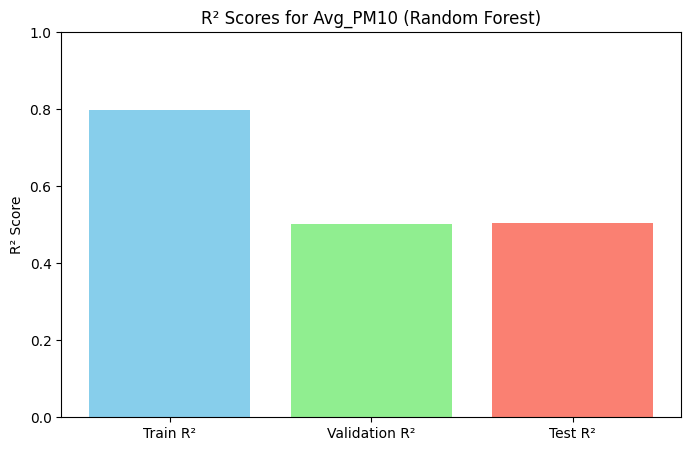

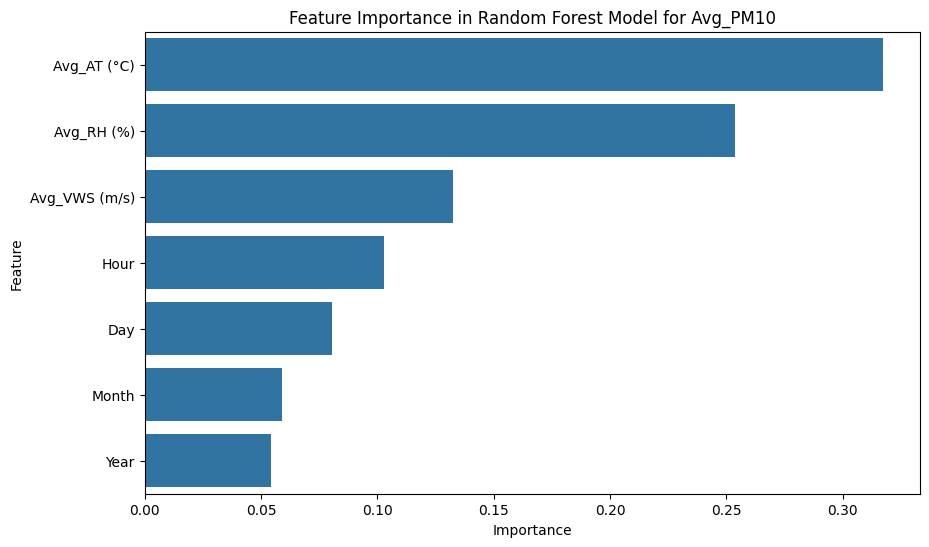

In [ ]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import seaborn as sns
import matplotlib.pyplot as plt

# Load the dataset and preprocess
file_path = '/content/Book5 (1) (1).xlsx'
data = pd.read_excel(file_path)
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)
data.interpolate(method='linear', inplace=True)
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for Avg_PM10
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_pm10 = data['Avg_PM10 (µg/m³)']

# Apply 1.5 IQR to remove outliers from features
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

X_filtered = remove_outliers(X)
y_pm10_filtered = y_pm10.loc[X_filtered.index]

# Split data into training, validation, and test sets (60%, 20%, 20%)
X_train, X_temp, y_train_pm10, y_temp_pm10 = train_test_split(X_filtered, y_pm10_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_pm10, y_test_pm10 = train_test_split(X_temp, y_temp_pm10, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Initialize and train the Random Forest Regressor
rf_model_pm10 = RandomForestRegressor(n_estimators=100, max_depth=15, random_state=42)
rf_model_pm10.fit(X_train_normalized, y_train_pm10)

# Predictions for train, validation, and test sets
y_train_pred_pm10 = rf_model_pm10.predict(X_train_normalized)
y_val_pred_pm10 = rf_model_pm10.predict(X_val_normalized)
y_test_pred_pm10 = rf_model_pm10.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_pm10 = {
    'Train R²': r2_score(y_train_pm10, y_train_pred_pm10),
    'Validation R²': r2_score(y_val_pm10, y_val_pred_pm10),
    'Test R²': r2_score(y_test_pm10, y_test_pred_pm10),
    'Train MSE': mean_squared_error(y_train_pm10, y_train_pred_pm10),
    'Validation MSE': mean_squared_error(y_val_pm10, y_val_pred_pm10),
    'Test MSE': mean_squared_error(y_test_pm10, y_test_pred_pm10),
    'Train MAE': mean_absolute_error(y_train_pm10, y_train_pred_pm10),
    'Validation MAE': mean_absolute_error(y_val_pm10, y_val_pred_pm10),
    'Test MAE': mean_absolute_error(y_test_pm10, y_test_pred_pm10)
}

# Print performance metrics for Avg_PM10 with Random Forest
print("\nModel Performance for Avg_PM10 with Random Forest:")
for metric, value in performance_pm10.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets for Avg_PM10
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_pm10['Train R²'], performance_pm10['Validation R²'], performance_pm10['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_PM10 (Random Forest)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_PM10
feature_importance_pm10 = rf_model_pm10.feature_importances_
importance_df_pm10 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_pm10}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_pm10)
plt.title("Feature Importance in Random Forest Model for Avg_PM10")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


[I 2024-10-26 09:54:40,177] A new study created in memory with name: no-name-c49b3684-49c2-4a15-8b3c-ccf651570557
[I 2024-10-26 09:56:04,819] Trial 0 finished with value: 0.4253681818776083 and parameters: {'n_estimators': 250, 'max_depth': 16, 'min_samples_split': 18, 'min_samples_leaf': 10, 'max_features': 0.7391782551624013}. Best is trial 0 with value: 0.4253681818776083.
[I 2024-10-26 09:57:12,033] Trial 1 finished with value: 0.4293775685451429 and parameters: {'n_estimators': 297, 'max_depth': 16, 'min_samples_split': 14, 'min_samples_leaf': 9, 'max_features': 0.6890983659353541}. Best is trial 1 with value: 0.4293775685451429.
[I 2024-10-26 09:57:21,357] Trial 2 finished with value: 0.3248176683938397 and parameters: {'n_estimators': 64, 'max_depth': 6, 'min_samples_split': 13, 'min_samples_leaf': 1, 'max_features': 0.8938653608124825}. Best is trial 1 with value: 0.4293775685451429.
[I 2024-10-26 09:57:56,646] Trial 3 finished with value: 0.4419785384511125 and parameters: {'n

Best parameters found for Random Forest: {'n_estimators': 210, 'max_depth': 19, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': 0.8107141390666387}

Model Performance for Avg_PM10 with Optimized Random Forest:
Train R²: 0.8608
Validation R²: 0.5415
Test R²: 0.5448
Train MSE: 2440.9376
Validation MSE: 7983.8059
Test MSE: 8062.9255
Train MAE: 33.7236
Validation MAE: 63.1187
Test MAE: 63.1819


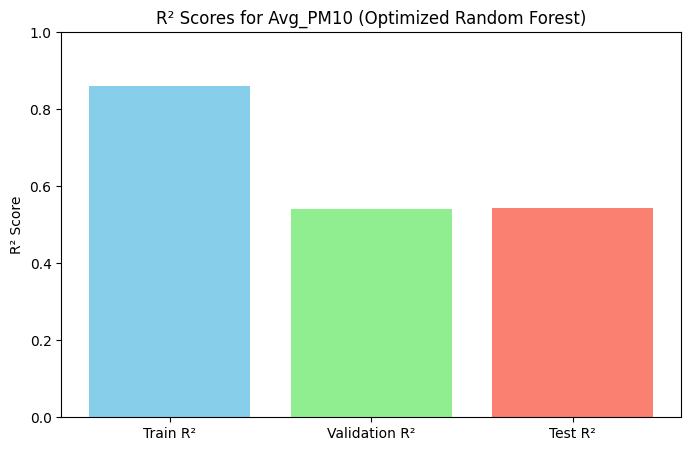

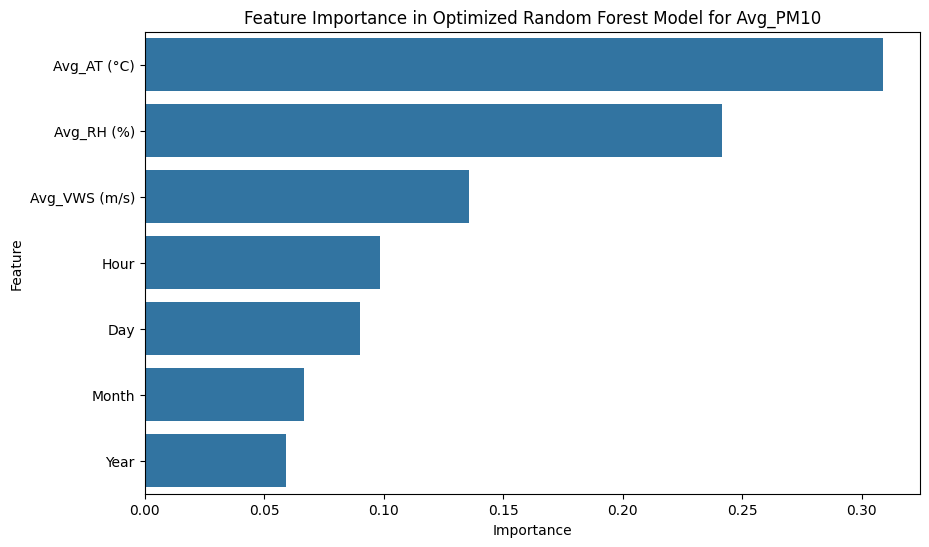

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
import optuna

# Load the dataset and preprocess
file_path = '/content/Book5 (1) (1).xlsx'  # Update with your local file path
data = pd.read_excel(file_path)
data['Timestamp'] = pd.to_datetime(data['Timestamp'], errors='coerce')
data.set_index('Timestamp', inplace=True)
data.interpolate(method='linear', inplace=True)
data['Hour'] = data.index.hour
data['Day'] = data.index.day
data['Month'] = data.index.month
data['Year'] = data.index.year

# Define features and target variable for Avg_PM10
X = data[['Hour', 'Day', 'Month', 'Year', 'Avg_AT (°C)', 'Avg_RH (%)', 'Avg_VWS (m/s)']]
y_pm10 = data['Avg_PM10 (µg/m³)']

# Apply 1.5 IQR to remove outliers
def remove_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return df[~((df < lower_bound) | (df > upper_bound)).any(axis=1)]

X_filtered = remove_outliers(X)
y_pm10_filtered = y_pm10.loc[X_filtered.index]

# Split data into train, validation, and test sets
X_train, X_temp, y_train_pm10, y_temp_pm10 = train_test_split(X_filtered, y_pm10_filtered, test_size=0.4, random_state=42)
X_val, X_test, y_val_pm10, y_test_pm10 = train_test_split(X_temp, y_temp_pm10, test_size=0.5, random_state=42)

# Normalize features
scaler = MinMaxScaler()
X_train_normalized = scaler.fit_transform(X_train)
X_val_normalized = scaler.transform(X_val)
X_test_normalized = scaler.transform(X_test)

# Define the objective function for Optuna to optimize Random Forest hyperparameters
def objective(trial):
    params = {
        'n_estimators': trial.suggest_int('n_estimators', 50, 300),
        'max_depth': trial.suggest_int('max_depth', 3, 20),
        'min_samples_split': trial.suggest_int('min_samples_split', 2, 20),
        'min_samples_leaf': trial.suggest_int('min_samples_leaf', 1, 10),
        'max_features': trial.suggest_float('max_features', 0.5, 1.0),
        'random_state': 42
    }
    rf = RandomForestRegressor(**params)
    score = cross_val_score(rf, X_train_normalized, y_train_pm10, cv=3, scoring='r2').mean()
    return score

# Run optimization with Optuna
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)
best_params_rf = study.best_params
print("Best parameters found for Random Forest:", best_params_rf)

# Initialize and train the model with best parameters
rf_model_pm10 = RandomForestRegressor(**best_params_rf)
rf_model_pm10.fit(X_train_normalized, y_train_pm10)

# Predictions for train, validation, and test sets
y_train_pred_pm10 = rf_model_pm10.predict(X_train_normalized)
y_val_pred_pm10 = rf_model_pm10.predict(X_val_normalized)
y_test_pred_pm10 = rf_model_pm10.predict(X_test_normalized)

# Calculate performance metrics for each set
performance_pm10 = {
    'Train R²': r2_score(y_train_pm10, y_train_pred_pm10),
    'Validation R²': r2_score(y_val_pm10, y_val_pred_pm10),
    'Test R²': r2_score(y_test_pm10, y_test_pred_pm10),
    'Train MSE': mean_squared_error(y_train_pm10, y_train_pred_pm10),
    'Validation MSE': mean_squared_error(y_val_pm10, y_val_pred_pm10),
    'Test MSE': mean_squared_error(y_test_pm10, y_test_pred_pm10),
    'Train MAE': mean_absolute_error(y_train_pm10, y_train_pred_pm10),
    'Validation MAE': mean_absolute_error(y_val_pm10, y_val_pred_pm10),
    'Test MAE': mean_absolute_error(y_test_pm10, y_test_pred_pm10)
}

# Print performance metrics
print("\nModel Performance for Avg_PM10 with Optimized Random Forest:")
for metric, value in performance_pm10.items():
    print(f"{metric}: {value:.4f}")

# Plot R² scores for train, validation, and test sets
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(['Train R²', 'Validation R²', 'Test R²'], [performance_pm10['Train R²'], performance_pm10['Validation R²'], performance_pm10['Test R²']], color=['skyblue', 'lightgreen', 'salmon'])
ax.set_title("R² Scores for Avg_PM10 (Optimized Random Forest)")
ax.set_ylim(0, 1)
ax.set_ylabel("R² Score")
plt.show()

# Feature Importance for Avg_PM10
feature_importance_pm10 = rf_model_pm10.feature_importances_
importance_df_pm10 = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance_pm10}).sort_values(by='Importance', ascending=False)

# Plot feature importance for Avg_PM10
plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=importance_df_pm10)
plt.title("Feature Importance in Optimized Random Forest Model for Avg_PM10")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.show()


In [ ]:
!pip install keras-tuner


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 4.4 MB/s eta 0:00:00


In [ ]:
!pip install optuna  # Ensure Optuna is installed
import optuna
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.optimizers import Adam

def create_sequences(X, y, time_steps=30):
    X_seq, y_seq = [], []
    for i in range(len(X) - time_steps):
        X_seq.append(X[i:i + time_steps])
        y_seq.append(y[i + time_steps])
    return np.array(X_seq), np.array(y_seq)

# Your preprocessed data loading here (assuming data, X, y, etc. as in previous steps)

# Split data into training and testing
X_train, X_test, y_train, y_test = train_test_split(X_seq, y_seq, test_size=0.2, random_state=42)

# Define an objective function to tune with Optuna
def objective(trial):
    model = Sequential()

    # Optuna suggests the hyperparameters to tune
    units_1 = trial.suggest_int('units_1', 32, 128, step=32)
    units_2 = trial.suggest_int('units_2', 32, 128, step=32)
    dropout_1 = trial.suggest_float('dropout_1', 0.2, 0.5, step=0.1)
    dropout_2 = trial.suggest_float('dropout_2', 0.2, 0.5, step=0.1)
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-4, 1e-2)

    # Build LSTM model with suggested parameters
    model.add(LSTM(units_1, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(dropout_1))
    model.add(LSTM(units_2, return_sequences=False))
    model.add(Dropout(dropout_2))
    model.add(Dense(1))

    model.compile(optimizer=Adam(learning_rate=learning_rate), loss='mean_squared_error')
    model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test), verbose=0)  # 10 epochs for faster search

    # Evaluate model on validation data
    loss = model.evaluate(X_test, y_test, verbose=0)
    return loss  # Minimize validation loss

# Optimize with Optuna
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=20)  # Adjust n_trials as needed for speed

print("Best hyperparameters found:", study.best_params)


[I 2024-10-26 14:28:56,211] A new study created in memory with name: no-name-cebace16-2573-4fae-b3ea-53558c907c1f
<ipython-input-44-c0d27e9a4d4b>:28: FutureWarning: suggest_loguniform has been deprecated in v3.0.0. This feature will be removed in v6.0.0. See https://github.com/optuna/optuna/releases/tag/v3.0.0. Use suggest_float(..., log=True) instead.
  learning_rate = trial.suggest_loguniform('learning_rate', 1e-4, 1e-2)
[I 2024-10-26 14:43:00,930] Trial 0 finished with value: 0.003157753497362137 and parameters: {'units_1': 96, 'units_2': 32, 'dropout_1': 0.30000000000000004, 'dropout_2': 0.30000000000000004, 'learning_rate': 0.003290142385802181}. Best is trial 0 with value: 0.003157753497362137.
[I 2024-10-26 15:15:45,853] Trial 1 finished with value: 0.003832112066447735 and parameters: {'units_1': 128, 'units_2': 128, 'dropout_1': 0.2, 'dropout_2': 0.4, 'learning_rate': 0.0008950968352661016}. Best is trial 0 with value: 0.003157753497362137.
[I 2024-10-26 15:27:56,969] Trial 2 

In [ ]:
pip install hijri-converter


In [ ]:
import pandas as pd
from hijri_converter import convert

# Load your data
data = pd.read_excel("/content/Book5 (1) (1).xlsx")

# Ensure the 'Timestamp' column is in datetime format
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Convert each Gregorian date to Hijri date
data['Lunar_Date'] = data['Timestamp'].apply(lambda x: convert.Gregorian(x.year, x.month, x.day).to_hijri().isoformat())

# Save or view the updated data
data.to_excel("updated_file_with_lunar_dates.xlsx", index=False)


In [ ]:
import pandas as pd
from hijri_converter import convert

# Load your data
data = pd.read_excel("/content/Book5 (1) (1).xlsx")

# Ensure the 'Timestamp' column is in datetime format
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Convert each Gregorian date to Hijri date
data['Hijri_Date'] = data['Timestamp'].apply(lambda x: convert.Gregorian(x.year, x.month, x.day).to_hijri().isoformat())

# Approximate Vikram Samvat by adding 57 years to the Gregorian year
data['Vikram_Samvat_Date'] = data['Timestamp'].apply(lambda x: f"{x.year + 57}-{x.month:02d}-{x.day:02d}")

# Save or view the updated data
data.to_excel("updated_file_with_hijri_and_vikram_samvat_dates.xlsx", index=False)


In [ ]:
pip install requests


In [ ]:
import pandas as pd
import datetime
from math import floor

# Load your data
data = pd.read_excel("/content/Book5 (1) (1).xlsx")
data['Timestamp'] = pd.to_datetime(data['Timestamp'])

# Define a function to approximate Vara (weekday)
def get_vara(date):
    days = ["Sunday", "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday"]
    return days[date.weekday()]

# Define a function to approximate Tithi (lunar day)
def get_tithi(date):
    # Calculate an approximate lunar day based on the moon phase
    new_moon_date = datetime.datetime(2024, 2, 20)  # Use a known recent new moon as a reference
    lunar_day = (date - new_moon_date).days % 30  # 30 Tithis in a lunar month
    tithis = [
        "Pratipada", "Dwitiya", "Tritiya", "Chaturthi", "Panchami", "Shashthi",
        "Saptami", "Ashtami", "Navami", "Dashami", "Ekadashi", "Dwadashi",
        "Trayodashi", "Chaturdashi", "Purnima", "Pratipada", "Dwitiya", "Tritiya",
        "Chaturthi", "Panchami", "Shashthi", "Saptami", "Ashtami", "Navami",
        "Dashami", "Ekadashi", "Dwadashi", "Trayodashi", "Chaturdashi", "Amavasya"
    ]
    return tithis[lunar_day]

# Apply the functions to get Vara and Tithi
data['Vara'] = data['Timestamp'].apply(get_vara)
data['Tithi'] = data['Timestamp'].apply(get_tithi)

# Save the updated data with Vara and Tithi
data.to_excel("updated_file_with_vara_tithi.xlsx", index=False)
